In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from sklearn.linear_model import LinearRegression
from datetime import date, timedelta
from scipy.optimize import leastsq
#from sklearn.linear_model import LinearRegression
from matplotlib.dates import DateFormatter
from scipy.stats import chisquare

#from datetime import date, timedelta
yesterday = date.today() - timedelta(days=1)
d1 = yesterday.strftime("%Y-%m-%d")
countriesEU = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania",\
               "Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands",\
               "Denmark","Poland","Estonia","Portugal","Finland","Romania","France",\
               "Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
#x = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
d0 = date(2020, 3, 29)
d2 = date.today()
deltaT = d2 - d0
print(deltaT.days)
dT = deltaT.days
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
RkoreaCoeffs=[ 0.36242246,  2.56241634,  1.84890887,  0.13324732]
%matplotlib inline
expPopWorld = 2.67152730e+06
def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

def linreg(dfLT,population):
    
    dfLT['date'] = pd.to_datetime(dfLT['date'])
    yy = np.log(dfLT['cases'].values*10000./population)
    xx = np.array(range(dfLT['cases'].size)).reshape((-1, 1))
    model1 = LinearRegression().fit(xx, yy)
    r_sq1 = model1.score(xx, yy)
    return model1, r_sq1, dfLT

def plotpred(dfLT1, population, dateStart, dateEnd, filename, model1, country,level):
    
    #fig, ax = plt.subplots(figsize=(12, 12))
    plt.plot(dfLT1['date'].values,dfLT1['cases']*10000./population)
    date_form = DateFormatter("%m-%d")
    ax = plt.axes()
    ax.xaxis.set_major_formatter(date_form)
    ix1 = pd.date_range(dateStart, dateEnd, freq='D')
    ss1 = pd.DataFrame({'date': ix1},index=range(len(ix1)))
    y_pred1 = np.exp(model1.intercept_ + model1.coef_ * range(len(ix1)))
    ax.plot(ss1['date'].values,y_pred1)
    plt.xticks(rotation=90)
    plt.title(country)
    plt.ylabel('Tolat COVID-19 cases per 10000')
    ax.fill_between(ss1['date'].values, 1,level, facecolor='red', alpha=0.3)
    ax.fill_between(ss1['date'].values, yc,1, facecolor='m', alpha=0.3)
    ax.fill_between(ss1['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
    plt.xlabel('Date')
    #plt.yscale('log')
    plt.yscale('log')
    plt.grid()
    plt.savefig(filename)
    plt.show()
    ss1a = pd.DataFrame({'cases': (y_pred1*population/10000).astype(int)},index=range(len(y_pred1)))
    ss1t = pd.concat([ss1,ss1a], axis=1)
    return ss1t

def forecast(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases',pMAPE=True):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))#+coeffs[0]*.25/(1 + np.exp( - coeffs[1] * (t - 3.5*coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    if pMAPE:
        print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logistic')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecast2(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'bi-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: bi-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("bi-logistic approximation splitting point: %d"%(vL))
    print(output0)
    print(output)
    return x

def forecast3(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))+coeffsUS[3]/(1 + np.exp( - coeffsUS[4] * (t - coeffsUS[5])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendS1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: tri-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('forecast rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("tri-logistic approximation splitting points: %d,%d"%(vL[0],vL[1]))
    print(output0)
    print(output1)
    print(output)
    
    return x

def trend3(dfLV,dfLT1,dfES,lLV,lLT,lES,pLV,pLT,pES):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #dfLT1 = pd.read_csv("~/Desktop/coronaLT1.csv",",")
    y = np.log(np.diff(dfLT1["cases"].values)[:]/dfLT1["cases"].values[1:]**2)
    x = np.array(range(len(dfLT1["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLT)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLT) 
    plt.plot(range(len(x)+pLT),y_pred12,label='%s tr'%(lLT))

    y = np.log(np.diff(dfES["cases"].values)[:]/dfES["cases"].values[1:]**2)
    x = np.array(range(len(dfES["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lES)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pES) 
    plt.plot(range(len(x)+pES),y_pred12,label='%s tr'%(lES))
    plt.xlabel('t, days')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s%s%s.png"%(lLV,lLT,lES))
    plt.show()
    
def trend(dfLV,lLV,pLV):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    plt.xlabel('t [days]')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s.png"%(lLV))
    plt.show()

def trendS(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendS0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend0 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x[:vL])+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL])+pLV,y_pred12, output

def trendS1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output
    
def forecastR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t, output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: Richards')
    print('coeffs: ',x)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1])) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print (output)
    return x

def forecast2R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] *coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])-coeffs2[0]/(1 + np.exp( - coeffs2[3] *coeffs2[1] * (tt - coeffs2[2])))**(1./coeffs2[3])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: bi-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print(output)
    return x

def forecast3R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] * coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7] * coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(waveform_1-model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel-6*diffStd0*np.ones(len(tt)),allmodel+6*diffStd0*np.ones(len(tt)), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model']) 
    ax2.set_xlabel('t, days')
    ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(np.diff(waveform_1)-np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)-3*diffStd*np.ones(len(tt)-1), np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t [days]')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s_R.png"%(Cntr))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    rint('model: tri-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    print('\t total death: ', int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0]))
    print(output)
    return x

def get_cases(df,threshold):    
    dfA = df[df[['Country','TotCasesper1Mpop']].TotCasesper1Mpop>=threshold]
    #y = df[df['Country','TotCasesper1Mpop'].TotCasesper1Mpop>=56.]
    dfA = dfA.sort_values(by=['TotCasesper1Mpop'], ascending=False)
    country = dfA['Country']
    #country = country.tolist()
    cases = dfA['TotCasesper1Mpop']/100
    #case = cases.tolist()
    return country, cases

def stat_picture(country, cases, high=35, picname="pictures/coronage0.png"):
# Import the necessary packages and modules


    # Prepare the data
    #x = dfA['Country']
    fig = plt.figure( figsize=(6, high))
    fig.subplots_adjust(bottom=0.2, left=0.1)
    # Plot the data
    y_pos = cases
    #barh(y_pos, performance, xerr=error, align='center')
    plt.barh(country,y_pos)
    #plt.xticks(rotation=90)
    plt.xlabel('COVID-19 cases per 10000')
    # Add a legend
    plt.legend()
    ax = plt.axes() 
    x = range(len(country))
    ax.fill_betweenx(x, 1,1000, facecolor='red', alpha=0.3)
    yc = 0.56
    ax.fill_betweenx(x, yc,1, facecolor='m', alpha=0.3)
    ax.fill_betweenx(x, 1e-4,yc, facecolor='y', alpha=0.3)
    plt.vlines(yc, 0, len(country)-1, colors='g', linestyles='solid')
    #plt.ylim([1e-2,60])
    ax.xaxis.grid() # horizontal lines
    #ax.xaxis.grid() # vertical lines

    ax.set_yticks(range(len(country)))
    ax.set_yticklabels(country)
    #ax.invert_yaxis()
    plt.xscale("log")
    # Show the plot

    plt.savefig(picname, bbox_inches='tight')
    plt.show()
    
def read_df(dfRM,lRM):
    dfRM = pd.read_csv("data/corona%s.csv"%(lRM),",")
    dfRM['date'] = pd.to_datetime(dfRM['date'])
    print("%s\n"%(lRM),dfRM.tail())
    return dfRM

102


In [2]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

def forecastRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    locStr = 'upper left'
    if Cntr in ['New Zealand']:
        locStr = 'lower right'
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc=locStr) 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecastRRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]) )))#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2RRR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * ((t- coeffsUS[2])*(t- coeffsUS[3]))))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    24.31714688, 0.00530186**2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RRR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))+coeffsUS[4]/(1 + np.exp( - coeffsUS[5] * (t - coeffsUS[6])* (t - coeffsUS[7])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.01 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSQ1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def trendSQ(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL:], y[vL:]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSQ0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[:vL], y[:vL]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL]),y_pred12, output

def trendSQ1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL[1], np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL[1]]),y_pred12, output

def trendSS(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS0(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS1(dfLV,vL=[0,1],pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

In [3]:
def forecastQR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * coeffs[4] * ((t- coeffs[2])**0.5*(t- coeffs[3])**0.5 )))**(1./coeffs[4])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3],xcoef[4]*x[4]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3],xcoef[4]*x_1[4]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'RichardsQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_QR.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_QR.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: RichardsQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x


def forecast2RR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL,nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-Richards approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases',zoom=1.):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7]*coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop/4,  2.61212092e+01, -9.65961409e-01,  5.96529356e-03], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    if zoom != 1.:
        ax3.set_ylim([0,zoom])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL[1],nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL[0],nu=x[3])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSS1(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2QR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])+coeffsUS[0]/(1 + np.exp( - coeffsUS[4]*coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))**(1./coeffsUS[4])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

In [23]:
dfp = pd.read_csv("data/population.csv",",")
#dfp[dfp['Country (or dependency)']=='China'].Population.tolist()[0]
dfp.head()

,Country (or dependency),Population,Yearly Change,Net Change,Density (P/Km²),Land Area (Km²),Migrants (net),Fert. Rate,Med. Age,Urban Pop %,World Share
0,World,7774108745,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,European Union,445250514,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,China,1439323776,0.39 %,5540090.0,153.0,9388211.0,-348399.0,1.7,38,61 %,18.47 %
3,India,1380004385,0.99 %,13586631.0,464.0,2973190.0,-532687.0,2.2,28,35 %,17.70 %
4,United States,331002651,0.59 %,1937734.0,36.0,9147420.0,954806.0,1.8,38,83 %,4.25 %


In [24]:
popEU = sum(dfp[dfp["Country (or dependency)"].isin(countriesEU) ].Population)

In [25]:
#df = pd.read_csv("~/Desktop/coronaAllT.csv","\t")
df = pd.read_csv("data/coronaAll_%s.csv"%(d1),",")
dfAll = df#pd.read_csv("~/Desktop/coronaAll_2020-03-28.csv",",")

In [26]:
df.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,NaN,\n,NaN,NaN,1828572,North America,North America,NaN,7610.0,814.0,"+4,396",NaN,18703.0,NaN,3701165,180463.0,1692130.0,NaN,NaN
1,NaN,\n,NaN,NaN,805321,South America,South America,NaN,1439.0,47.0,"+35,030",NaN,13628.0,NaN,2672044,98611.0,1768112.0,NaN,NaN
2,NaN,\n,NaN,NaN,798216,Asia,Asia,NaN,6011.0,76.0,"+4,531",NaN,19590.0,NaN,2741795,65592.0,1877987.0,NaN,NaN
3,NaN,\n,NaN,NaN,857147,Europe,Europe,NaN,NaN,NaN,900,NaN,5395.0,NaN,2518507,195050.0,1466310.0,NaN,NaN
4,NaN,\n,NaN,NaN,257762,Africa,Africa,NaN,2.0,NaN,5,NaN,964.0,NaN,525894,12270.0,255862.0,NaN,NaN


In [27]:
df.tail()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
225,NaN,,NaN,NaN,857147,Europe,Total:,NaN,NaN,NaN,NaN,NaN,5395.0,NaN,2518507,195050.0,1466310.0,NaN,NaN
226,NaN,,NaN,NaN,257762,Africa,Total:,NaN,2.0,NaN,NaN,NaN,964.0,NaN,525894,12270.0,255862.0,NaN,NaN
227,NaN,,NaN,NaN,1412,Australia/Oceania,Total:,NaN,176.0,NaN,NaN,NaN,10.0,NaN,10714,128.0,9174.0,NaN,NaN
228,NaN,,NaN,NaN,55,NaN,Total:,NaN,NaN,NaN,NaN,NaN,4.0,NaN,721,15.0,651.0,NaN,NaN
229,NaN,NaN,NaN,NaN,162308,Europe,European Union,301.2147,0.0,0.0,NaN,NaN,2121.0,70147.08129,1317853,134116.0,637245.0,31233024.0,2959.801187


In [28]:
dfAll.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,NaN,\n,NaN,NaN,1828572,North America,North America,NaN,7610.0,814.0,"+4,396",NaN,18703.0,NaN,3701165,180463.0,1692130.0,NaN,NaN
1,NaN,\n,NaN,NaN,805321,South America,South America,NaN,1439.0,47.0,"+35,030",NaN,13628.0,NaN,2672044,98611.0,1768112.0,NaN,NaN
2,NaN,\n,NaN,NaN,798216,Asia,Asia,NaN,6011.0,76.0,"+4,531",NaN,19590.0,NaN,2741795,65592.0,1877987.0,NaN,NaN
3,NaN,\n,NaN,NaN,857147,Europe,Europe,NaN,NaN,NaN,900,NaN,5395.0,NaN,2518507,195050.0,1466310.0,NaN,NaN
4,NaN,\n,NaN,NaN,257762,Africa,Africa,NaN,2.0,NaN,5,NaN,964.0,NaN,525894,12270.0,255862.0,NaN,NaN


In [29]:
dfAll.fillna(0, inplace=True)
dfAll[dfAll["Country"]=="Lithuania"]

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
121,115.0,"1,468","34,444",6,223,Europe,Lithuania,29.0,0.0,0.0,0,"2,721,108",15.0,164637.0,1854,79.0,1552.0,447994.0,681.0


No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


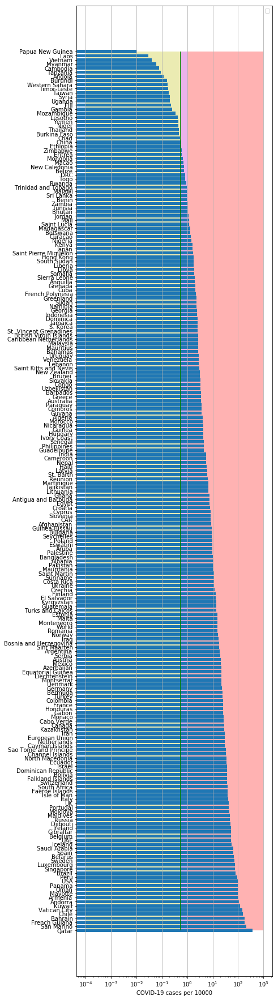

In [30]:
country, cases = get_cases(df,0.01)
country.values, cases.values
stat_picture(country.values, cases.values, high=35, picname="pictures/coronage0.png")

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


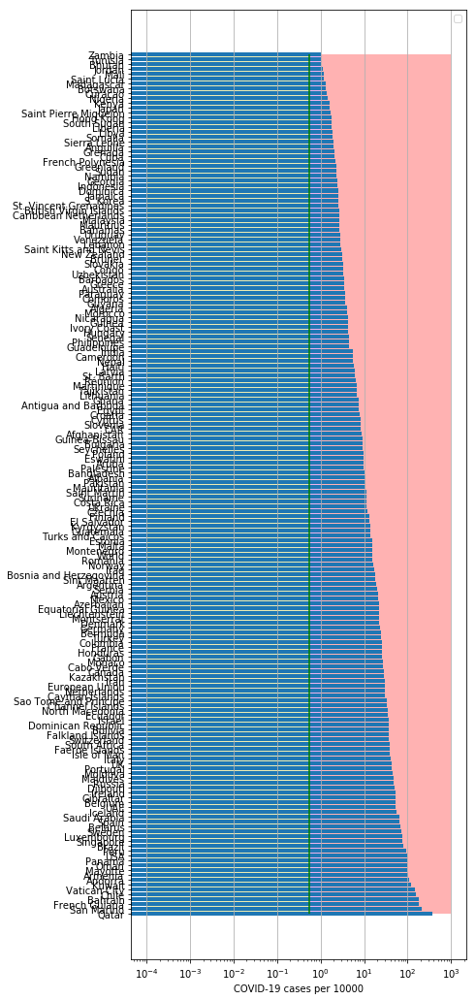

In [31]:
country, cases = get_cases(df,100.0)
stat_picture(country.values, cases.values, high=20, picname="pictures/coronage1.png")

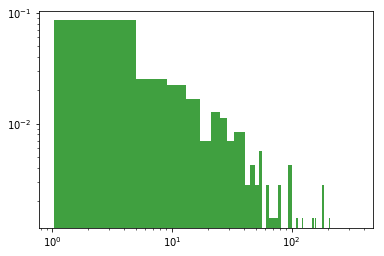

In [32]:
n, bins, patches = plt.hist(cases, 90, density=True,facecolor='g', alpha=0.75)
plt.yscale("log")
plt.xscale("log")

In [33]:
dfSP = read_df(pd.DataFrame(),"SP")
dfGB = read_df(pd.DataFrame(),"GB")
dfIT = read_df(pd.DataFrame(),"IT")
dfLT = read_df(pd.DataFrame(),"LT")
dfUkr = read_df(pd.DataFrame(),"Ukr")
dfUS = read_df(pd.DataFrame(),"US")
dfCN = read_df(pd.DataFrame(),"CN")
dfFR = read_df(pd.DataFrame(),"FR")
dfKR = read_df(pd.DataFrame(),"KR")
dfW = read_df(pd.DataFrame(),"World")
dfDK = read_df(pd.DataFrame(),"DK")
dfNG = read_df(pd.DataFrame(),"NG")
dfGR = read_df(pd.DataFrame(),"GR")
dfES = read_df(pd.DataFrame(),"ES")
dfSW = read_df(pd.DataFrame(),"SW")
dfPL = read_df(pd.DataFrame(),"PL")
dfIS = read_df(pd.DataFrame(),"IS")
dfUR = read_df(pd.DataFrame(),"Ukr")
dfSZ = read_df(pd.DataFrame(),"SZ")
dfIN = read_df(pd.DataFrame(),"IN")
#dfKRA = read_df(pd.DataFrame(),"KRA")
dfRS = read_df(pd.DataFrame(),"RS")
dfJP = read_df(pd.DataFrame(),"JP")
dfNL = read_df(pd.DataFrame(),"NL")
dfAT = read_df(pd.DataFrame(),"AT")
dfBG = read_df(pd.DataFrame(),"BG")
dfSG = read_df(pd.DataFrame(),"SG")
dfLV = read_df(pd.DataFrame(),"LV")
dfCA = read_df(pd.DataFrame(),"CA")
dfPT = read_df(pd.DataFrame(),"PT")
dfTR = read_df(pd.DataFrame(),"TR")
dfBZ = read_df(pd.DataFrame(),"BZ")
dfAS = read_df(pd.DataFrame(),"AS")
dfML = read_df(pd.DataFrame(),"ML")
dfZL = read_df(pd.DataFrame(),"ZL")
dfBR = read_df(pd.DataFrame(),"BR")
dfIR = read_df(pd.DataFrame(),"IR")
dfCL = read_df(pd.DataFrame(),"CL")
dfCH = read_df(pd.DataFrame(),"CH")
dfRM = read_df(pd.DataFrame(),"RM")
dfFI = read_df(pd.DataFrame(),"FI")
dfID = read_df(pd.DataFrame(),"ID")
dfED = read_df(pd.DataFrame(),"ED")
dfPH = read_df(pd.DataFrame(),"PH")
#dfPK = read_df(pd.DataFrame(),"PK")
dfLX = read_df(pd.DataFrame(),"LX")
dfTH = read_df(pd.DataFrame(),"TH")
dfIE = read_df(pd.DataFrame(),"IE")
dfMX = read_df(pd.DataFrame(),"MX")
dfPM = read_df(pd.DataFrame(),"PM")
dfPU = read_df(pd.DataFrame(),"PU")
dfSB = read_df(pd.DataFrame(),"SB")
dfAG = read_df(pd.DataFrame(),"AG")
dfCT = read_df(pd.DataFrame(),"CT")
dfEG = read_df(pd.DataFrame(),"EG")
dfSV = read_df(pd.DataFrame(),"SV")
dfMR = read_df(pd.DataFrame(),"MR")
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIC = read_df(pd.DataFrame(),"IC")
dfQR = read_df(pd.DataFrame(),"QR")
dfCB = read_df(pd.DataFrame(),"CB")
dfBL = read_df(pd.DataFrame(),"BL")
dfAG = read_df(pd.DataFrame(),"AR")
dfEU = read_df(pd.DataFrame(),"EU")
dfMT = read_df(pd.DataFrame(),"MT")
dfCP = read_df(pd.DataFrame(),"CP")

SP
           date   cases  active    death
130 2020-07-04  298039       0  28385.0
131 2020-07-05  298453       0  28385.0
132 2020-07-06  298869       0  28388.0
133 2020-07-07  299210       0  28392.0
134 2020-07-08  299593       0  28396.0
GB
           date   cases  active    death
129 2020-07-04  284900       0  44198.0
130 2020-07-05  285416       0  44220.0
131 2020-07-06  285768       0  44236.0
132 2020-07-07  286349       0  44391.0
133 2020-07-08  286979       0  44517.0
IT
           date   cases  active    death
132 2020-07-04  241419   14621  34854.0
133 2020-07-05  241611   14642  34861.0
134 2020-07-06  241819   14709  34869.0
135 2020-07-07  241956   14242  34899.0
136 2020-07-08  242149   13595  34914.0
LT
           date   cases  active  death     tests
117 2020-07-04  1836.0     201   79.0  442242.0
118 2020-07-05  1841.0     215   79.0  443242.0
119 2020-07-06  1844.0     218   79.0  444407.0
120 2020-07-07  1854.0     223   79.0  447994.0
121 2020-07-08  1854.0  

           date  cases   active  death
116 2020-07-04  36983  18502.0  720.0
117 2020-07-05  38149  19416.0  747.0
118 2020-07-06  39334  20528.0  770.0
119 2020-07-07  40291  20766.0  799.0
120 2020-07-08  41251  20963.0  819.0
PU
           date   cases   active    death
119 2020-07-04  299080  99047.0  10412.0
120 2020-07-05  302718  98172.0  10589.0
121 2020-07-06  305703  97312.0  10772.0
122 2020-07-07  309278  97388.0  10952.0
123 2020-07-08  312911  97030.0  11133.0
SB
           date  cases  active  death
116 2020-07-04  15829  2459.0  306.0
117 2020-07-05  16131  2756.0  311.0
118 2020-07-06  16420  2737.0  317.0
119 2020-07-07  16719  3023.0  330.0
120 2020-07-08  17076  3369.0  341.0
AG
           date    cases   active   death
122 2020-07-04  75376.0  47965.0  1481.0
123 2020-07-05  77815.0  48711.0  1507.0
124 2020-07-06  80447.0  50334.0  1582.0
125 2020-07-07  83426.0  51687.0  1644.0
126 2020-07-08  87030.0  48834.0  1694.0
CT
           date   cases  active  death
126

In [34]:
dfBL = dfBL.fillna(0)
dfRM = dfRM.fillna(0)
dfSV = dfSV.fillna(0)
dfCT = dfCT.fillna(0)
#dfAR = dfAR.fillna(0)
dfSB = dfSB.fillna(0)
dfCP = dfCP.fillna(0)
dfID = dfID.fillna(0)
dfAG = dfAG.fillna(0)
dfMX = dfMX.fillna(0)
dfPU = dfPU.fillna(0)
dfIQ = dfIQ.fillna(0)
dfIE = dfIE.fillna(0)
dfPH = dfPH.fillna(0)
dfTH = dfTH.fillna(0)
dfMR = dfMR.fillna(0)
dfCP = dfCP.fillna(0)

In [35]:
from sklearn.linear_model import LinearRegression
populationSp = dfp[dfp['Country (or dependency)']=='Spain'].Population.tolist()[0]
y = np.log(dfSP['cases'].values*10000./populationSp)
x = np.array(range(dfSP['cases'].size)).reshape((-1, 1))
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)


coefficient of determination: 0.5530085243653393
intercept: -0.43072616004499853
slope: [0.04744428]


/usr/local/lib/python3.5/dist-packages/pandas/plotting/_converter.py:129: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


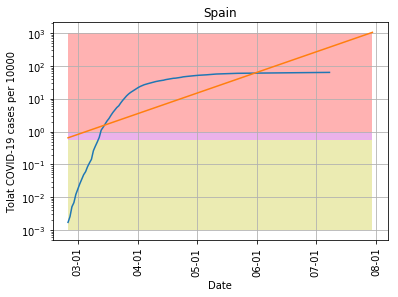

In [36]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
yc = 0.56
plt.plot(dfSP['date'].values,dfSP['cases']*10000./populationSp)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix = pd.date_range('2020-02-25', '2020-07-30', freq='D')
ss = pd.DataFrame({'date': ix})
y_pred = np.exp(model.intercept_ + model.coef_ * range(len(ix)))
ax.plot(ss['date'].values,y_pred)
plt.xticks(rotation=90)
plt.title('Spain')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaSP.png")
plt.show()

In [37]:
populationUK = dfp[dfp['Country (or dependency)']=='United Kingdom'].Population.tolist()[0]
model1, r_sql, dfGB1 = linreg(dfGB,populationUK)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.6910722286035197
intercept: -2.099925180972553
slope: [0.05874361]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


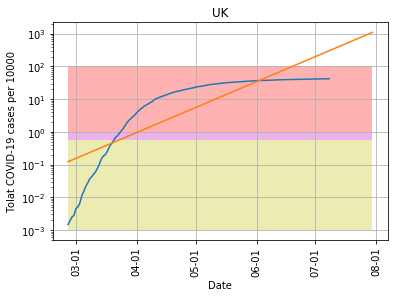

In [38]:
ss1t = plotpred(dfGB1,populationUK,'2020-02-26', '2020-07-30', "pictures/coronaGB.png", model1, 'UK',100)

In [39]:
populationIT = dfp[dfp['Country (or dependency)']=='Italy'].Population.tolist()[0]
coefIT = 4.0378751-0.3
yy1 = np.log(coefIT-np.log(dfIT['cases'].values*10000./populationIT))
xx1 = np.array(range(dfIT['cases'].size)).reshape((-1, 1))
model11 = LinearRegression().fit(xx1, yy1)
r_sq1 = model11.score(xx1, yy1)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9490423653692159
intercept: 1.4029883961562937
slope: [-0.03752917]


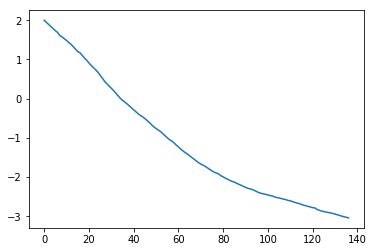

In [40]:
plt.plot(xx1,yy1)

/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


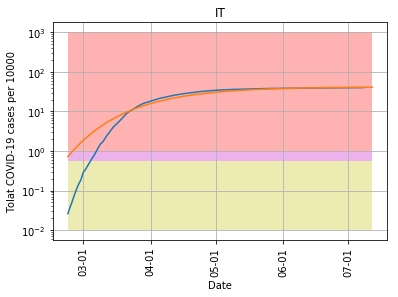

In [41]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
plt.plot(dfIT['date'].values,dfIT['cases']*10000./populationIT)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix11 = pd.date_range('2020-02-23', '2020-07-12', freq='D')
ss11 = pd.DataFrame({'date': ix11})
y_pred11 = np.exp(coefIT-np.exp(model11.intercept_ + model11.coef_ * range(len(ix11))))
ax.plot(ss11['date'].values,y_pred11)
plt.xticks(rotation=90)
plt.title('IT')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss11['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss11['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss11['date'].values, 1e-2,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
#plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaIT.png")
plt.show()

In [42]:
cs=y_pred11[-1]/10000.*populationIT

In [43]:
cs

248649.86850262224

In [44]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
model1, r_sql, dfLT1 = linreg(dfLT[1:],populationLT)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.4866331570811141
intercept: -0.7842021746807246
slope: [0.03082173]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


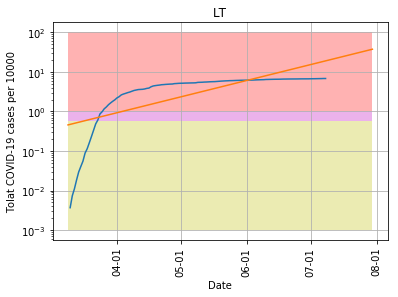

In [45]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
ss1t = plotpred(dfLT[1:],populationLT,'2020-03-09', '2020-07-30', "pictures/coronaLT.png", model1, 'LT',100)

In [46]:
populationUKr = dfp[dfp['Country (or dependency)']=='Ukraine'].Population.tolist()[0]
model11, r_sql, dfUkr1 = linreg(dfUkr, populationUKr)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.7431119053663524
intercept: -3.8594977659515233
slope: [0.06544528]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


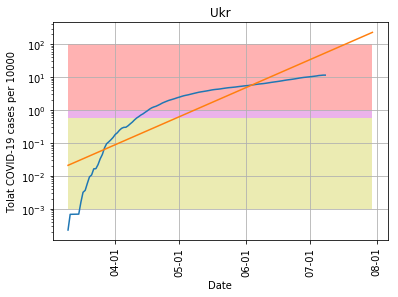

In [47]:
ss1t1 = plotpred(dfUkr1,populationUKr,'2020-03-10', '2020-07-30', "pictures/coronaUkr.png", model11, 'Ukr',100)

No handles with labels found to put in legend.
/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


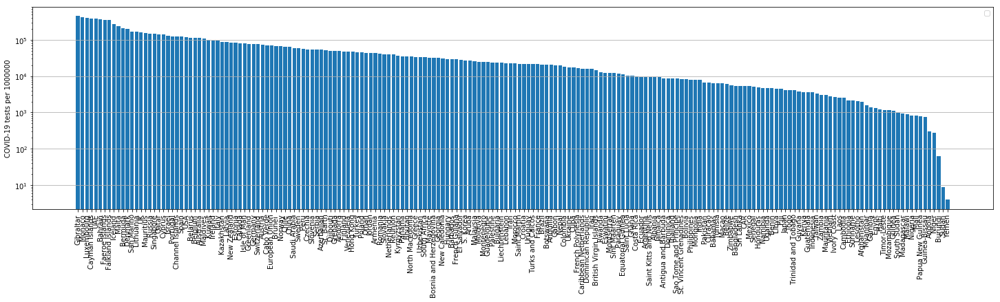

In [48]:
# Prepare the data
dfTs = dfAll
dfTs = dfTs.sort_values(by=['Testsper1Mpop'], ascending=False)
dfTs = dfTs[dfTs['Testsper1Mpop']>0]
x = dfTs['Country']
y = dfTs['Testsper1Mpop']
fig = plt.figure( figsize=(25, 6))
fig.subplots_adjust(bottom=0.2)
# Plot the data
plt.bar(x, y)

plt.xticks(rotation=90)
plt.ylabel('COVID-19 tests per 1000000')
# Add a legend
plt.legend()
ax = plt.axes() 
#ax.fill_between(x, 1,10, facecolor='red', alpha=0.3)
yc = 0.56
#ax.fill_between(x, yc,1, facecolor='m', alpha=0.3)
#ax.fill_between(x, 1e-4,yc, facecolor='y', alpha=0.3)
#plt.hlines(yc, 0, len(df)-1, colors='g', linestyles='solid')
#plt.ylim([1e-4,10])
ax.yaxis.grid() # horizontal lines
#ax.xaxis.grid() # vertical lines
plt.yscale("log")
# Show the plot
plt.savefig("pictures/coronaTests.png")
plt.show()

In [49]:
populationUS= dfp[dfp['Country (or dependency)']=='United States'].Population.tolist()[0]
model11, r_sql, dfUS1 = linreg(dfUS, populationUS)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.6767440578626434
intercept: -1.484707994953847
slope: [0.059867]


/usr/local/lib/python3.5/dist-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


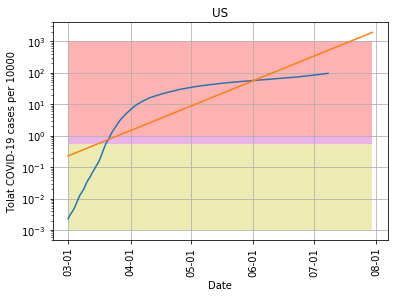

In [50]:
ss1t = plotpred(dfUS1,populationUS,'2020-03-01', '2020-07-30', "pictures/coronaUS.png", model11, 'US',1000)

In [51]:
dfAll[dfAll["Country"]=="Latvia"]
dfAll.fillna(0, inplace=True)

North America
            Country         0
229  European Union  0.101769


(0, 0.15)

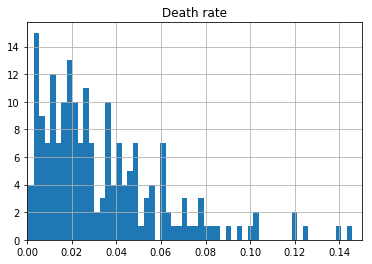

In [52]:
dfT1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
print(dfTT.Country[0])
print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
hist = dfTTh[dfTTh[0]>0].hist(bins=9*12)
plt.title("Death rate")
plt.xlim([0,0.15])

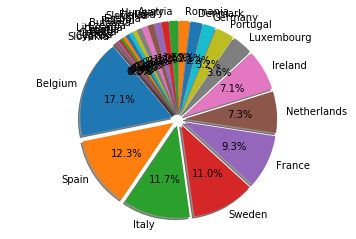

In [53]:
cLst = countriesEU
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
#dfD1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["Deathsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfTTh = dfTT.sort_values(by=["Deathsper1Mpop"], ascending=False)
dfTTh.rename(columns={0: "DeathRate"})
#hist = dfTTh.hist(bins=9*16)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])
#plt.show()
#import matplotlib.pyplot as plt

labels = dfTTh.Country.tolist()#'apple', 'banana', 'cherry', 'durian', 'elderberries', 'figs', 'grapes'
sizes = dfTTh.Deathsper1Mpop.values#[32, 20, 15, 10, 10, 8, 5]

p = plt.pie(sizes, labels=labels, explode=(.07,)*len(sizes), autopct='%1.1f%%', startangle=130, shadow=True)
plt.axis('equal')

            
plt.show()

In [54]:
dfTTh.head()

,Country,Deathsper1Mpop
35,Belgium,843.0
13,Spain,607.0
17,Italy,577.0
30,Sweden,543.0
24,France,459.0


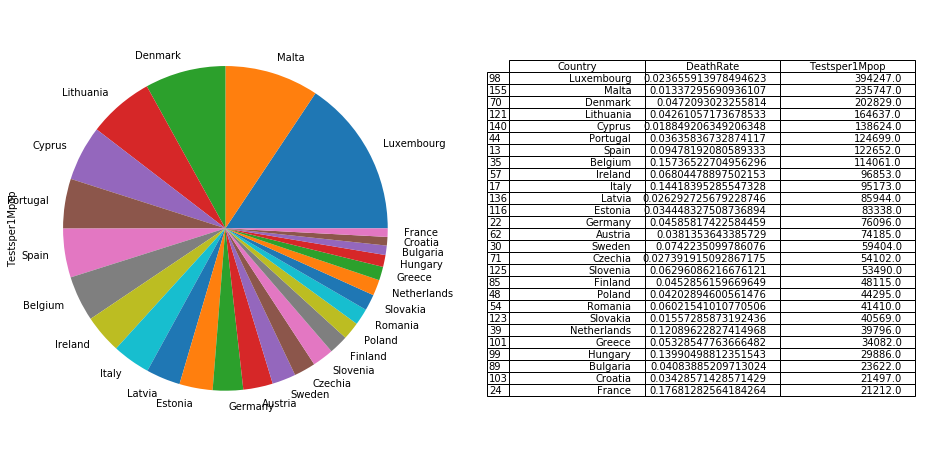

In [55]:
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=["Testsper1Mpop"], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
#import matplotlib.pyplot as plt
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfTTh.plot.pie(y=["Testsper1Mpop"],ax=ax1,labels=dfTTh['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfTTh, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate2.png")
plt.show()

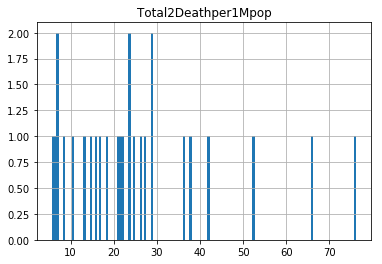

In [56]:
dfD1 = dfAll[dfAll['Country'].isin(cLst)]#[dfAll["Total Cases"]>0]
dfDD = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"],dfD1["Deathsper1Mpop"]], axis=1)
dfDD2 = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"]/dfD1["Testsper1Mpop"]], axis=1)
dfDD = dfDD[dfDD["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfDD1 = pd.concat([dfDD["Country"],dfDD["TotCasesper1Mpop"]/dfDD["Deathsper1Mpop"]], axis=1)
dfDDh = dfDD1.sort_values(by=[0], ascending=False)
dfDDh=dfDDh.rename(columns={0:"Total2Deathper1Mpop"})
dfDDh2=dfDD2.rename(columns={0:"Cases2Testsper1Mpop"})
hist = dfDDh.hist(bins=9*15)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])

In [57]:
dfDD.head()

,Country,TotCasesper1Mpop,Deathsper1Mpop
13,Spain,6408.0,607.0
17,Italy,4005.0,577.0
22,Germany,2372.0,109.0
24,France,2596.0,459.0
30,Sweden,7312.0,543.0


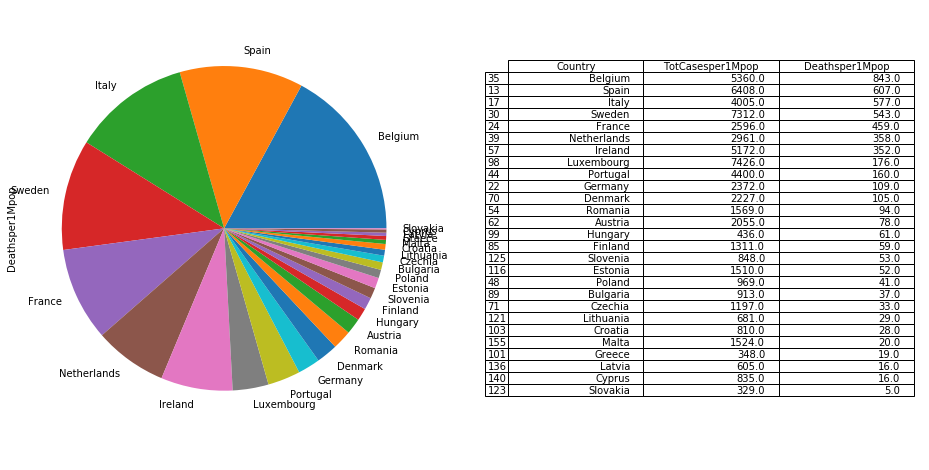

In [58]:
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDD = dfDD.sort_values(by=['Deathsper1Mpop'], ascending=False)
dfDD.plot.pie(y='Deathsper1Mpop',ax=ax1,labels=dfDD['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDD, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate1.png")
plt.show()

In [59]:
dfAll.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,0.0,\n,0,0,1828572,North America,North America,0.0,7610.0,814.0,"+4,396",0,18703.0,0.0,3701165,180463.0,1692130.0,0.0,0.0
1,0.0,\n,0,0,805321,South America,South America,0.0,1439.0,47.0,"+35,030",0,13628.0,0.0,2672044,98611.0,1768112.0,0.0,0.0
2,0.0,\n,0,0,798216,Asia,Asia,0.0,6011.0,76.0,"+4,531",0,19590.0,0.0,2741795,65592.0,1877987.0,0.0,0.0
3,0.0,\n,0,0,857147,Europe,Europe,0.0,0.0,0.0,900,0,5395.0,0.0,2518507,195050.0,1466310.0,0.0,0.0
4,0.0,\n,0,0,257762,Africa,Africa,0.0,2.0,0.0,5,0,964.0,0.0,525894,12270.0,255862.0,0.0,0.0


In [60]:
dfDDh2.head()

,Country,Cases2Testsper1Mpop
13,Spain,0.052245
17,Italy,0.042081
22,Germany,0.031171
24,France,0.122384
30,Sweden,0.123089


In [61]:
dfDDh2 = dfDDh2.sort_values(by=["Cases2Testsper1Mpop"], ascending=False)

     Country  Cases2Testsper1Mpop
      Sweden             0.123089
      France             0.122384
 Netherlands             0.074404
     Ireland             0.053401
       Spain             0.052245
     Belgium             0.046992
       Italy             0.042081
    Bulgaria             0.038650
     Romania             0.037889
     Croatia             0.037680
    Portugal             0.035285
     Germany             0.031171
     Austria             0.027701
     Finland             0.027247
     Czechia             0.022125
      Poland             0.021876
  Luxembourg             0.018836
     Estonia             0.018119
    Slovenia             0.015853
     Hungary             0.014589
     Denmark             0.010980
      Greece             0.010211
    Slovakia             0.008110
      Latvia             0.007039
       Malta             0.006465
      Cyprus             0.006023
   Lithuania             0.004136


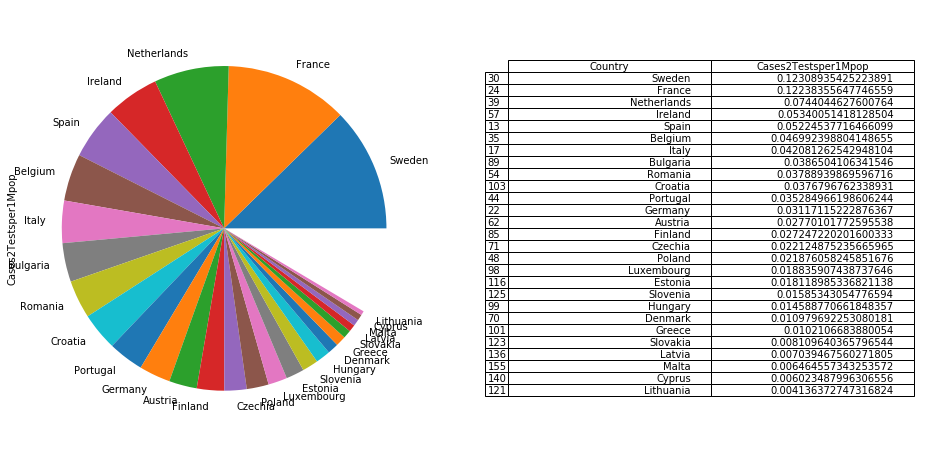

In [62]:
print (dfDDh2[dfDDh2["Cases2Testsper1Mpop"]<1000].to_string(index=False))
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDDh2.plot.pie(y='Cases2Testsper1Mpop',ax=ax1,labels=dfDDh2['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDDh2, loc='center')
#tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.show()

In [63]:
dfT1 = dfAll
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
dfTT[dfTT[0]>=0.000001].sort_values(by=[0], ascending=True)
#dfTT[dfTT.Country=="France"]

,Country,0,Testsper1Mpop
43,Singapore,0.000574,148072.00000
27,Qatar,0.001359,141106.00000
66,Nepal,0.002131,19861.00000
134,Rwanda,0.002513,13036.00000
52,Bahrain,0.003168,370605.00000
168,Botswana,0.003185,20346.00000
96,Palestine,0.003977,24017.00000
94,French Guiana,0.004030,29143.00000
73,Uzbekistan,0.004174,33492.00000
92,Costa Rica,0.004284,9981.00000


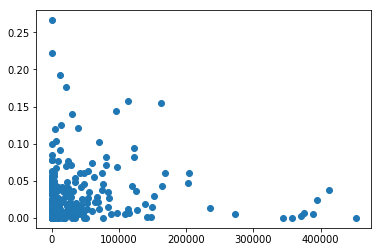

In [64]:
plt.plot(dfTTh["Testsper1Mpop"],dfTTh['DeathRate'],'o')

/usr/local/lib/python3.5/dist-packages/matplotlib/patches.py:694: RuntimeWarning: invalid value encountered in double_scalars
  self._x1 = self._x0 + self._width
/usr/local/lib/python3.5/dist-packages/matplotlib/projections/polar.py:67: RuntimeWarning: invalid value encountered in less
  mask = r < 0


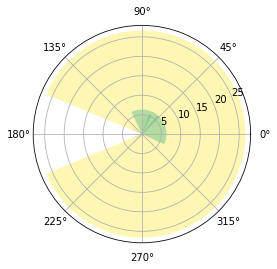

In [65]:
import numpy as np
import matplotlib.pyplot as plt


# Fixing random state for reproducibility
np.random.seed(19680801)

# Compute pie slices
N = len(dfTTh)
theta = np.linspace(0.0, 2*np.pi, N, endpoint=False)
radii = 100 * dfTTh['DeathRate']
width = 2*np.pi* 3.5/ dfTTh["Testsper1Mpop"]
colors = plt.cm.viridis(radii / 10.)

ax = plt.subplot(111, projection='polar')
ax.bar(theta, radii, width=width, bottom=0.0, color=colors, alpha=0.35)

plt.show()

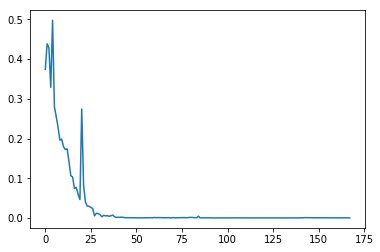

In [66]:
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)))

In [67]:
#np.diff(np.log(dfCN["cases"].values))

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:1: RuntimeWarning: divide by zero encountered in log
  """Entry point for launching an IPython kernel.


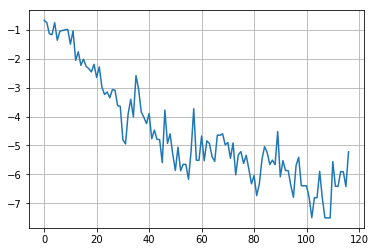

In [68]:
plt.plot(range(len(dfLT["cases"].values[3:])-1),np.log(np.diff(np.log(dfLT["cases"].values[3:]))))
plt.grid()

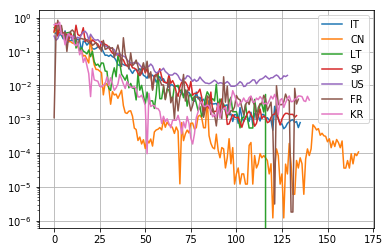

In [69]:
plt.plot(range(len(dfIT["cases"].values)-1),np.diff(np.log(dfIT["cases"].values))[:],label='IT')
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)),label='CN')
plt.plot(range(len(dfLT["cases"].values)-4),np.diff(np.log(dfLT["cases"].values))[3:],label='LT')
plt.plot(range(len(dfSP["cases"].values)-1),np.diff(np.log(dfSP["cases"].values)),label='SP')
plt.plot(range(len(dfUS["cases"].values)-1),np.diff(np.log(dfUS["cases"].values)),label='US')
plt.plot(range(len(dfFR["cases"].values)-10),np.diff(np.log(dfFR["cases"].values))[9:],label='FR')
plt.plot(range(len(dfKR["cases"].values)-4),np.diff(np.log(dfKR["cases"].values))[3:],label='KR')
plt.yscale('log')
plt.grid()
plt.legend()
plt.show()

129 129
coefficient of determination: 0.7562485036404394
intercept: -10.651268788598511
slope: [-0.08605661]


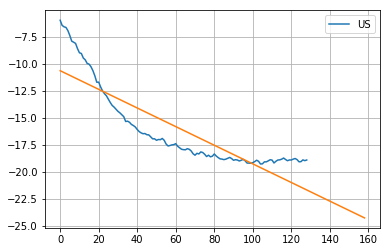

In [70]:
y = np.log(np.diff(dfUS["cases"].values)[:]/dfUS["cases"].values[1:]**2)
x = np.array(range(len(dfUS["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='US')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+30) 
plt.plot(range(len(x)+30),y_pred11)
plt.grid()
plt.legend()
plt.savefig("pictures/logdiffUS.png")
plt.show()

In [71]:
#np.diff(dfIT["cases"])

136 136
coefficient of determination: 0.870205160336924
intercept: -10.666885174887721
slope: [-0.08029363]


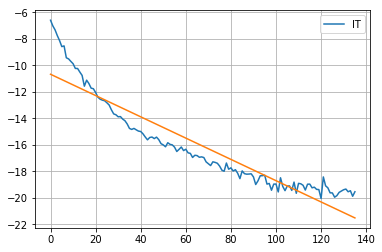

In [72]:
y = np.log(np.diff(dfIT["cases"].values)[:]/dfIT["cases"].values[1:]**2)
x = np.array(range(len(dfIT["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='IT')
y_pred12 = model.intercept_ + model.coef_ * range(len(x)) 
plt.plot(x,y_pred12)
plt.grid()
plt.legend()
plt.show()

In [73]:
#model11.coef_

In [74]:
#np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)

118 118
coefficient of determination: 0.8725966490988426
intercept: -15.624826376734386
slope: [-0.04846268]


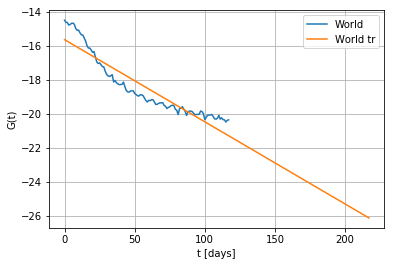

In [75]:
y = np.log(np.diff(dfW["cases"].values)[50:]/dfW["cases"].values[51:]**2)
x = np.array(range(len(dfW["cases"].values[50:])-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='World')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+100)
plt.plot(range(len(x)+100),y_pred11,label='World tr')
plt.legend()
plt.xlabel('t [days]')
plt.ylabel('G(t)')
plt.grid()
plt.savefig("pictures/logdifflogcoronaW.png")

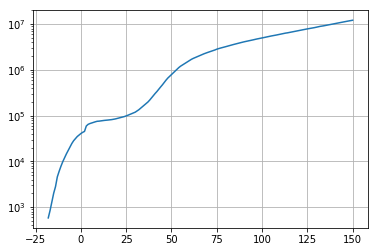

In [76]:
waveform_1 = dfW['cases'].values
waveform_A = dfW['active'].values
t = np.arange(-18,len(waveform_1)-18)
plt.plot(t, waveform_1) 
plt.yscale("log")
plt.grid()
plt.show()

In [77]:
dfW['cases'].values

array([     580,      845,     1317,     2015,     2800,     4581,
           6058,     7813,     9823,    11950,    14553,    17391,
          20630,    24545,    28266,    31439,    34876,    37552,
          40553,    43099,    45134,    59287,    64438,    67100,
          69197,    71329,    73332,    75184,    75700,    76677,
          77673,    78651,    79205,    80087,    80828,    81820,
          83112,    84615,    86604,    88585,    90443,    93016,
          95314,    98425,   102050,   106099,   109991,   114381,
         118948,   126214,   134576,   145483,   156653,   169593,
         182490,   198238,   218822,   244933,   275597,   305036,
         337489,   378860,   422629,   471035,   531864,   596366,
         663079,   723279,   784738,   858355,   936237,  1016330,
        1117928,  1203058,  1274578,  1347566,  1432869,  1519195,
        1605277,  1700004,  1780713,  1853505,  1925330,  2000065,
        2084633,  2183942,  2252370,  2332650,  2407467,  2482

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in true_divide
  after removing the cwd from sys.path.
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


[ 2.90376511e+07  9.53276613e-01 -1.74942551e+02  1.40225355e-02]


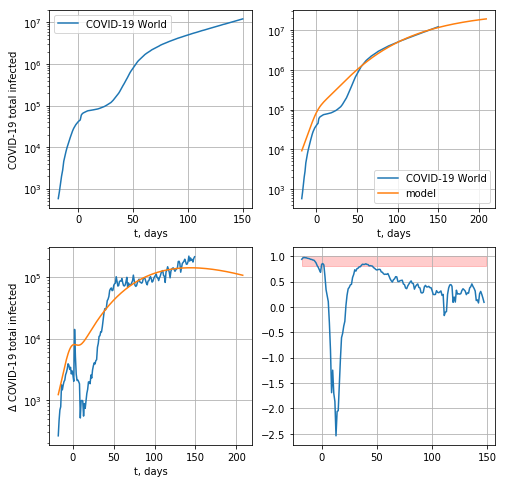

212864.53010239382


In [78]:
def model(t, coeffs):
    coeffsCN = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
    #coeffsCN = [2.06174475e+06, 1.67277852e-01, 5.36255447e+01]
    return coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]) + coeffsCN[0]/(1 + np.exp( - coeffsCN[1] * (t - coeffsCN[2])))

x0 = np.array([2.06174475e+06, 1.67277852e-01, 5.36255447e+01, 0.9 ], dtype=float)
#x0 = np.array([8.08757112e+04,  2.24114193e-01, -6.94900467e-01 ], dtype=float)
def residuals(coeffs, y, t):
    return y - model(t, coeffs)
from scipy.optimize import leastsq
x, flag = leastsq(residuals, x0, args=(waveform_1, t))
print(x)
tt = np.arange(-18,len(waveform_1)-18+59)
fig, ((ax3,ax1),(ax2,ax4)) = plt.subplots(2,2,figsize=(8,8), sharex=False, sharey=False)
ax3.plot(t, waveform_1) 
ax3.legend(['COVID-19 World']) 
ax3.set_xlabel('t, days')
ax3.set_yscale("log")
ax3.set_ylabel(r'COVID-19 total infected')
ax3.grid()
ax1.plot(t, waveform_1, tt, model(tt, x)) 
ax1.legend(['COVID-19 World', 'model']) 
ax1.set_xlabel('t, days')
ax1.set_yscale("log")
ax1.grid()
ax2.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(model(tt, x)))
ax2.set_ylabel(r'$\Delta$ COVID-19 total infected')
ax2.set_yscale("log")
ax2.grid()
ax2.set_xlabel('t, days')
z = np.diff(moving_average(waveform_A, n=3) )/np.diff(moving_average(waveform_1, n=3))
ax4.plot(t[:-3],z)
#ax4.axhline(y=2.2587741081036339/2, color='r')
ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
#ax4.set_yscale("log")
ax4.grid()
plt.savefig("pictures/covidworld.png")

plt.show()
print(np.std(residuals(x, waveform_1, t)))
#expPopWorld = x[0]
expPopWorld = 2.67152730e+06

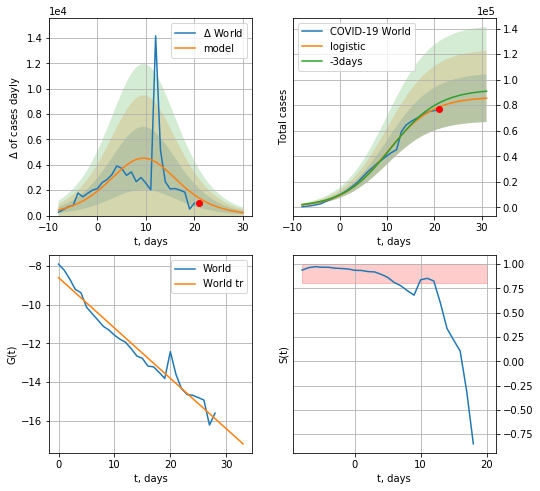

World data at: 2020-07-08
+3 day model MAPE: 0.04256770161128604
model: logistic
coeffs:  [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.2178111789766563
forecast at the end of period: +10 days
	 deltaDaycases:  239
	 total cases:  85429 ± 18607
	 total death:  3875 ± 2532
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


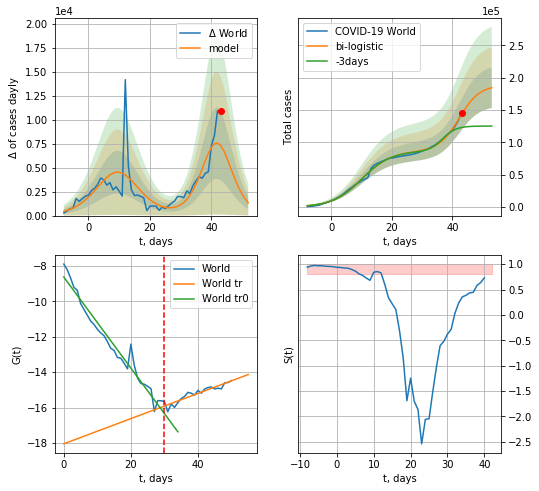

World data at: 2020-07-08
+3 day model MAPE: 0.2157297639626565
model: bi-logistic
coeffs:  [1.02227608e+05 2.95650820e-01 4.22366999e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.16992860985061978
forecast at the end of period: +10 days
	 deltaDaycases:  1329
	 total cases:  184617 ± 31371
	 total death:  8375 ± 4269
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.868835
 intercept: -18.049568
 slope: 0.071157


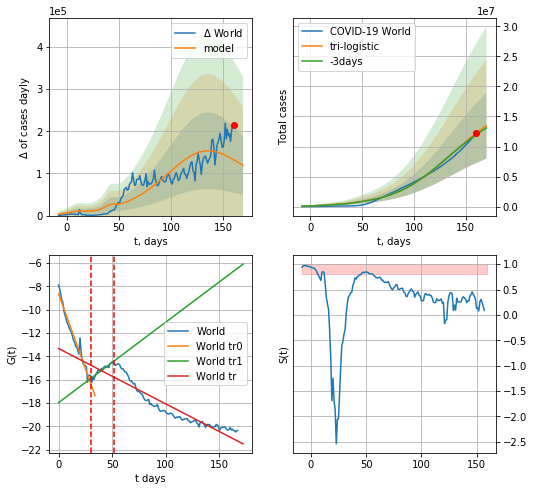

World data at: 2020-07-08
+3 day model MAPE: 0.02111660770794181
model: tri-logistic
coeffs:  [1.53306645e+07 3.72674533e-02 1.32413645e+02] [8.64735804e+04 2.09600360e-01 9.98515269e+00 1.02227608e+05
 2.95650820e-01 4.22366999e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.40669130850783863
forecast at the end of period: +10 days
	 deltaDaycases:  118602
	 total cases:  13469878 ± 5478082
	 total death:  611059 ± 745537
tri-logistic approximation splitting points: 30,52
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend1 coefficient of determination: 0.872494
 intercept: -17.970431
 slope: 0.068998
trend coefficient of determination: 0.868599
 intercept: -13.330961
 slope: -0.047457


In [79]:
vL = 30
x = forecast("World",dfW[:vL],d1,7*16-dT,1.0,False)
xx = forecast2("World",dfW[:52],d1,7*16-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("World",dfW,d1,7*16-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,52])

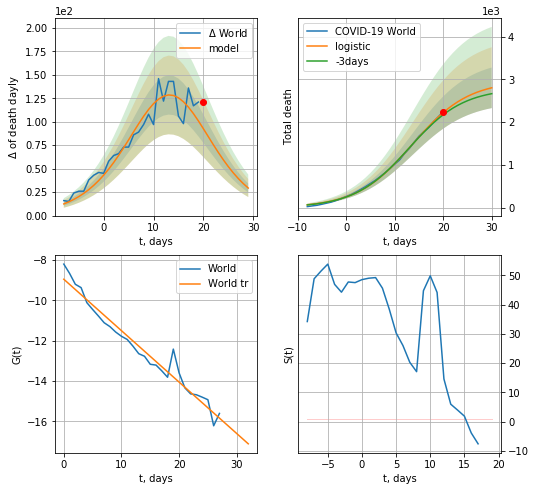

World data at: 2020-07-08
+3 day model MAPE: 0.027312192470115494
model: logistic
coeffs:  [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.16928081921473714
forecast at the end of period: +10 days
	 total death:  2803 ± 474
trend coefficient of determination: 0.959176
 intercept: -8.958870
 slope: -0.254930


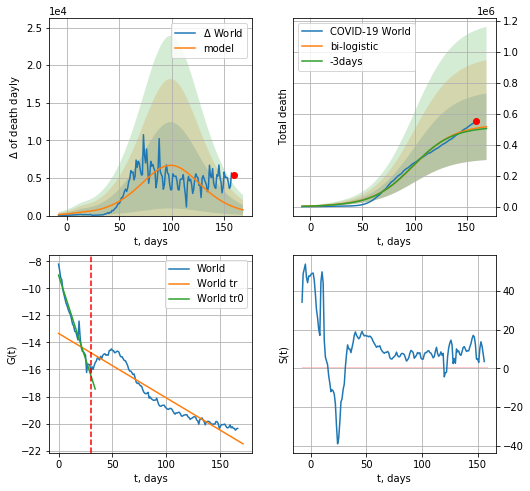

World data at: 2020-07-08
+3 day model MAPE: 0.02037752551968037
model: bi-logistic
coeffs:  [5.28083643e+05 5.06747916e-02 9.93803851e+01] [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.41687478614106876
forecast at the end of period: +10 days
	 deltaDaydeath:  759
	 total death:  515988 ± 215102
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.960969
 intercept: -9.026339
 slope: -0.247583
trend coefficient of determination: 0.896779
 intercept: -13.332739
 slope: -0.047729


In [80]:
vL = 30
vL1=52
x = forecast("World",dfW[1:vL],d1,7*16-dT,1.0,False,cases='death')
xx = forecast2("World",dfW[1:],d1,7*16-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("World",dfW,d1,7*20-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

In [81]:
#vL = 30
#x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
#xx = forecast2("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.7],vL=vL)
#trend(dfW,"W",10)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


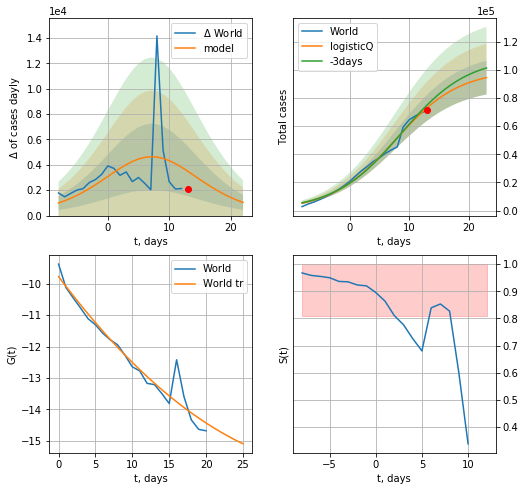

World data at: 2020-07-08
+3 day model MAPE: 0.031802
model: logisticQ
coeffs: [ 9.98643255e+04  1.79652646e-05  7.63889680e+00 -1.03375904e+04]
rational stdev: 0.126959
forecast at the end of period: +10 days
	 deltaDaycases: 1037
	 total cases: 94450 ± 11991
	 total death: 4284 ± 1631
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


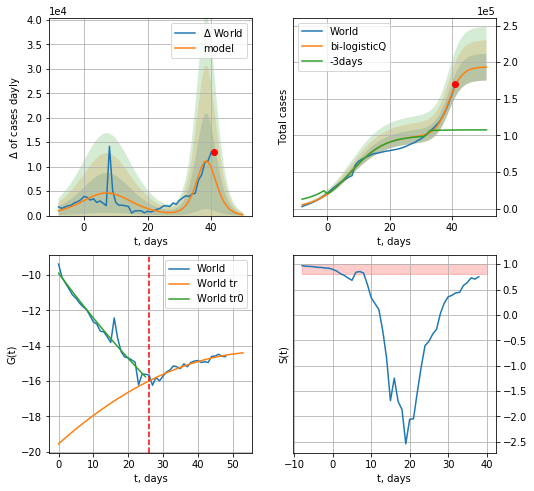

World data at: 2020-07-08
+3 day model MAPE: 0.635593
model: bi-logisticQ
coeffs: [ 9.37578627e+04  2.55228565e-05  3.89552969e+01 -1.87082152e+04]
rational stdev: 0.094698
forecast at the end of period: +10 days
	 deltaDaycases: 185
	 total cases: 193299 ± 18305
	 total death: 8768 ± 2490
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.893677
 intercept_: -19.558019139425994
 coeffs_: [ 0.          0.17538587 -0.00147405]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


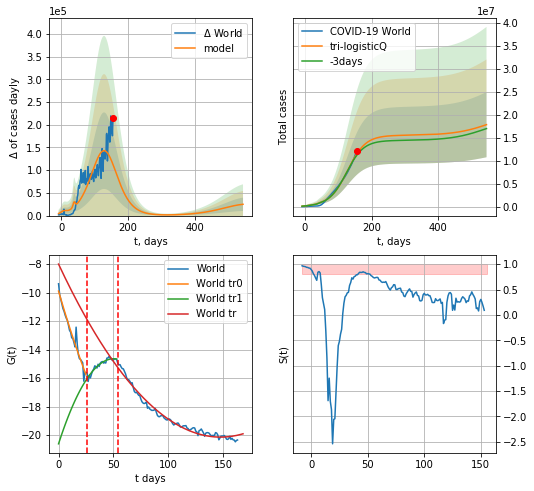

World data at: 2020-07-08
+3 day model MAPE: 0.027570
model: tri-logisticQ
coeffs: [ 1.53073363e+07  2.19856053e-07  1.28365064e+02 -1.69640235e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.397439
forecast at the end of period: +388 days
	 deltaDaycases: 24872
	 total cases: 17820352 ± 7082501
	 total death: 808418 ± 963890
tri-logisticQ approximation splitting points: 26,54
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.900515
 intercept_: -20.622215746086294
 coeffs_: [ 0.          0.23801537 -0.00236922]
trend coefficient of determination: 0.978917
 intercept_: -7.992902346570419
 coeffs_: [ 0.         -0.16481501  0.00055855]


In [82]:
vL=30 - 4
vL1=59 - 5
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
x = forecastRRR("World",dfW[4:vL],d1,7*16-dT,1.0,False)
xx = forecast2RRR("World",dfW[4:vL1],d1,7*16-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*70-dT, xx, shift=1.,addpred=True,xcoef=koreaCoeffs,vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


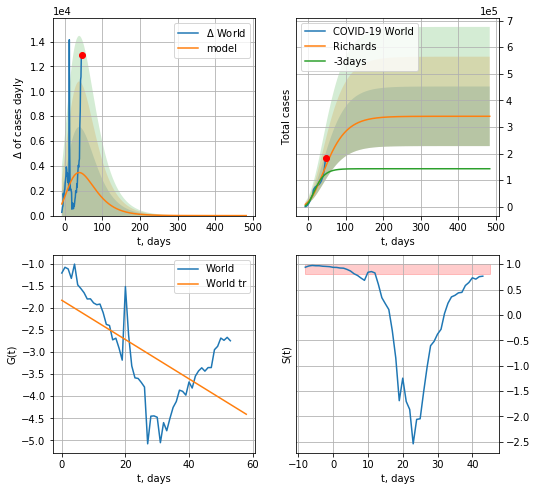

World data at: 2020-07-08
+3 day model MAPE: 0.241624
model: Richards
coeffs: [ 3.40077948e+05  3.51040118e+00 -1.35212982e+02  7.92067107e-03]
rational stdev: 0.329278
forecast at the end of period: +438 days
	 deltaDaycases: 0
	 total cases: 340076 ± 111979
	 total death: 15427 ± 15239
trend coefficient of determination: 0.389866
 intercept: -1.829818
 slope: -0.044449


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


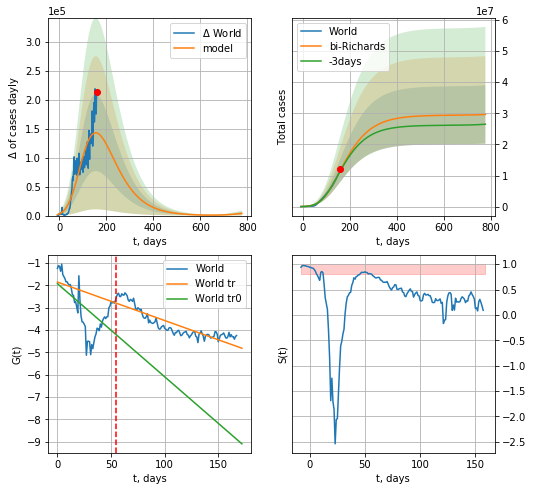

World data at: 2020-07-08
+3 day model MAPE: 0.017465
model: bi-Richards
coeffs: [ 2.90858421e+07  1.04931736e+00 -1.68342115e+02  1.28048269e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.316823
forecast at the end of period: +618 days
	 deltaDaycases: 3740
	 total cases: 29622612 ± 9385117
	 total death: 1343827 ± 1277264
bi-Richards approximation splitting point: 55
trend coefficient of determination: 0.358395
 intercept: -1.927908
 slope: -0.041673
trend coefficient of determination: 0.773934
 intercept: -1.856063
 slope: -0.017217


In [83]:
vL = 55
x = forecastRR("World",dfW[:vL],d1,60*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[:],d1,80*9-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

169


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


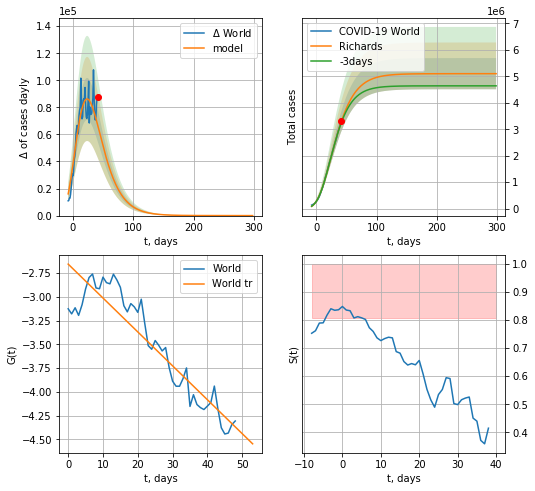

World data at: 2020-07-08
+3 day model MAPE: 0.014871
model: Richards
coeffs: [ 5.10254335e+06  1.04395582e+00 -4.20545297e+01  4.49970923e-02]
rational stdev: 0.115529
forecast at the end of period: +258 days
	 deltaDaycases: 0
	 total cases: 5102530 ± 589488
	 total death: 231475 ± 80225
trend coefficient of determination: 0.854892
 intercept: -2.655636
 slope: -0.035656


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


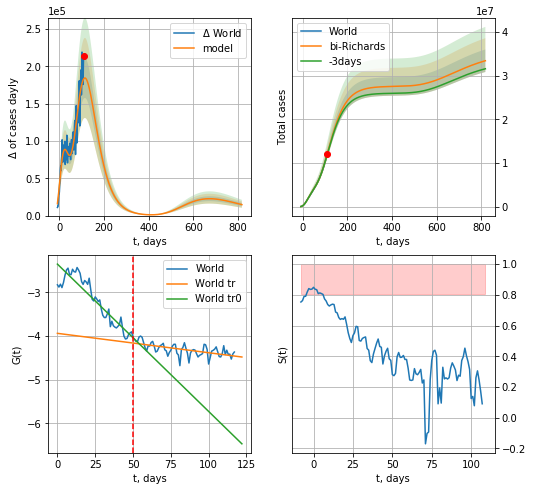

World data at: 2020-07-08
+3 day model MAPE: 0.005908
model: bi-Richards
coeffs: [ 2.24394413e+07  1.10815819e+00 -5.91798394e+01  2.00264679e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.077113
forecast at the end of period: +708 days
	 deltaDaycases: 14720
	 total cases: 33374849 ± 2573637
	 total death: 1514046 ± 350258
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.844157
 intercept: -2.354425
 slope: -0.033733
trend coefficient of determination: 0.368433
 intercept: -3.939730
 slope: -0.004442


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


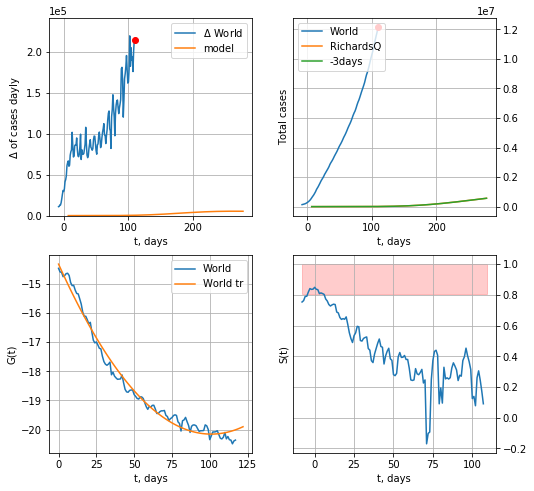

World data at: 2020-07-08
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 1.29689889e+06  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +168 days
	 deltaDaycases: 5292


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [84]:
print (len(dfW))
vL = 100
x = forecastRR("World",dfW[50:vL],d1,40*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[50:],d1,90*9-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-50)
x = forecastQR("World",dfW[50:],d1,30*9-dT,1.0,addpred=False)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


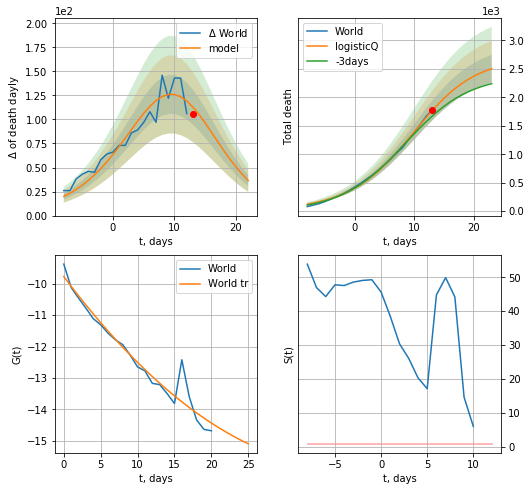

World data at: 2020-07-08
+3 day model MAPE: 0.067194
model: logisticQ
coeffs: [ 2.67019299e+03  8.28077677e-04  9.49653382e+00 -2.18469917e+02]
rational stdev: 0.098000
forecast at the end of period: +10 days
	 total death: 2502 ± 245
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


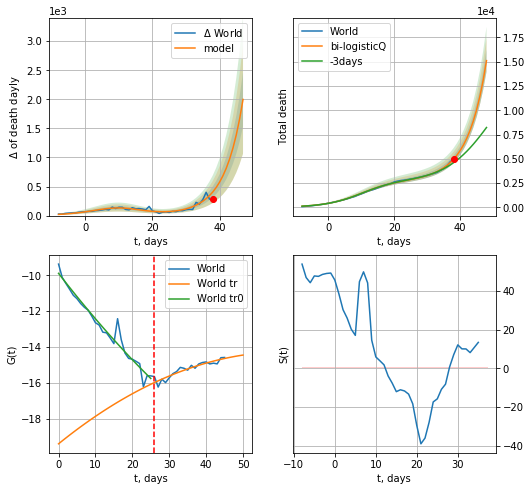

World data at: 2020-07-08
+3 day model MAPE: 0.105655
model: bi-logisticQ
coeffs: [ 6.42204134e+06  6.90051546e-04  7.95652837e+01 -2.38689793e+02]
rational stdev: 0.076590
forecast at the end of period: +10 days
	 total death: 15110 ± 1157
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.866834
 intercept_: -19.41123113056416
 coeffs_: [ 0.          0.16686573 -0.0013545 ]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp


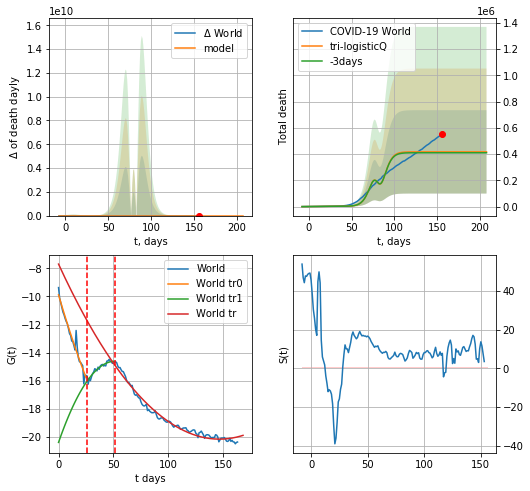

World data at: 2020-07-08
+3 day model MAPE: 0.016495
model: tri-logisticQ
coeffs: [-6.00797674e+06  1.27745698e-03 -1.08057390e+02  7.95127076e+01]
rational stdev: 0.760921
forecast at the end of period: +52 days
	 total death: 416734 ± 317102
tri-logisticQ approximation splitting points: 26,51
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.890965
 intercept_: -20.382525077358043
 coeffs_: [ 0.          0.22422642 -0.00217733]
trend coefficient of determination: 0.981210
 intercept_: -7.70502251702878
 coeffs_: [ 0.         -0.16992129  0.00058   ]


In [85]:
vL=30 - 4
vL1=51
x = forecastRRR("World",dfW[4:vL],d1,7*16-dT,1.0,False,cases='death')
xx = forecast2RRR("World",dfW[4:vL1],d1,7*16-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*22-dT, xx, shift=1.,addpred=False,xcoef=[.35,.5,4.,1.],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


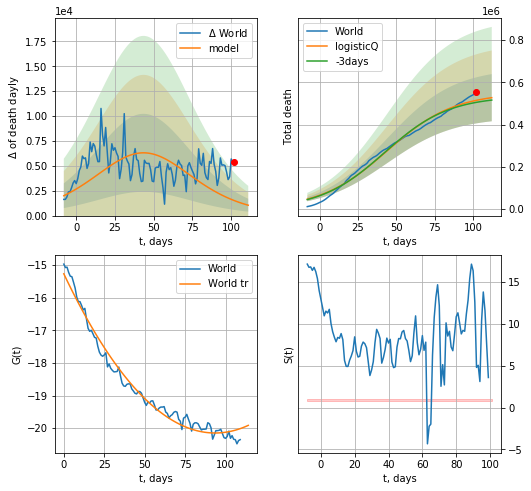

World data at: 2020-07-08
+3 day model MAPE: 0.019109
model: logisticQ
coeffs: [ 5.50266320e+05  2.16997496e-07  4.39033361e+01 -2.11155668e+05]
rational stdev: 0.211908
forecast at the end of period: +10 days
	 total death: 527037 ± 111683
trend coefficient of determination: 0.978917
 intercept_: -15.263621417059397
 coeffs_: [ 0.         -0.10452203  0.00055882]


In [86]:
x = forecastRRR("World",dfW[58:],d1,7*16-dT,1.0,False,cases='death')

In [87]:
#trend(dfSP,'SP',10)

In [88]:
#vL = len(dfSP[:])-16-dT
#x = forecast('Spain',dfSP[:vL],d1,30-dT,1.0)
#xx = forecast2('Spain',dfSP,d1,7*6-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.8],vL=vL)

SP
           date   cases  active    death
130 2020-07-04  298039       0  28385.0
131 2020-07-05  298453       0  28385.0
132 2020-07-06  298869       0  28388.0
133 2020-07-07  299210       0  28392.0
134 2020-07-08  299593       0  28396.0


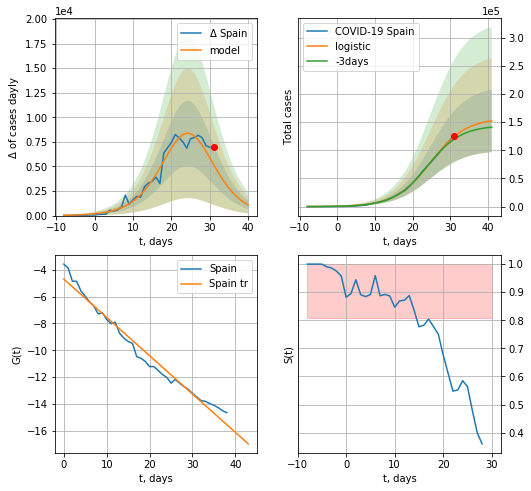

Spain data at: 2020-07-08
+3 day model MAPE: 0.04562669977631666
model: logistic
coeffs:  [1.56957534e+05 2.13812412e-01 2.47399190e+01]
rational stdev:  0.3648922799171356
forecast at the end of period: +10 days
	 deltaDaycases:  1080
	 total cases:  152251 ± 55555
	 total death:  14430 ± 15796
trend coefficient of determination: 0.974785
 intercept: -4.699916
 slope: -0.285083


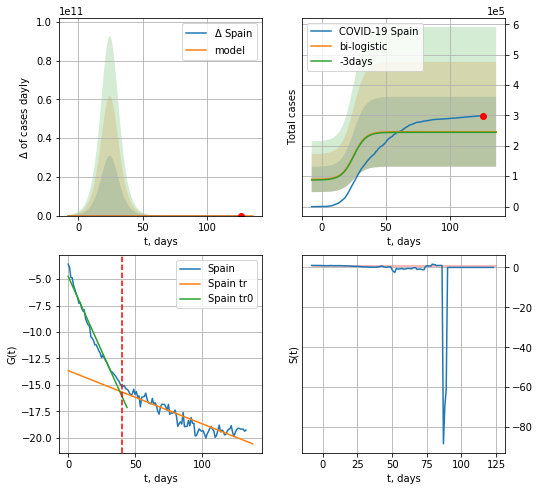

Spain data at: 2020-07-08
+3 day model MAPE: 0.008223109550815193
model: bi-logistic
coeffs:  [ 7.15340045e+04 -6.24135553e+00  1.61780583e+02] [1.56957534e+05 2.13812412e-01 2.47399190e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.46662462970908164
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  246375 ± 114964
	 total death:  23351 ± 32688
bi-logistic approximation splitting point: 40
trend0 coefficient of determination: 0.974598
 intercept: -4.739484
 slope: -0.281959
trend coefficient of determination: 0.843965
 intercept: -13.655104
 slope: -0.050133


In [89]:
dfSP = read_df(pd.DataFrame(),"SP")
vL = 40#len(dfSP[:])-7-dT
x = forecast('Spain',dfSP[:vL],d1,7*16-dT,1.0,cases='cases')
xx = forecast2('Spain',dfSP[:],d1,7*16-dT,x,1.0,addpred=True,xcoef=[.25,1.,1.6],vL=vL,cases='cases')

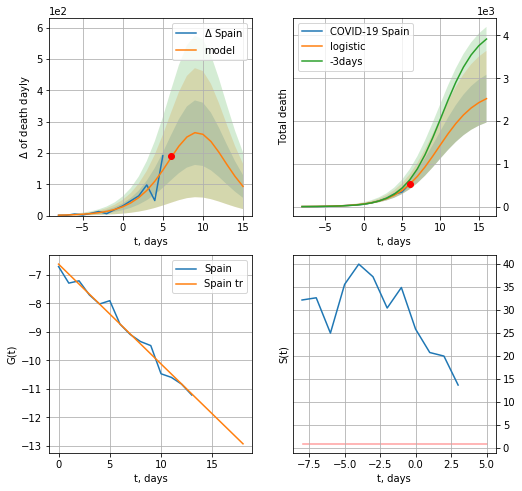

Spain data at: 2020-07-08
+3 day model MAPE: 0.1992580202993838
model: logistic
coeffs:  [2.74529349e+03 3.87912491e-01 9.73356455e+00]
rational stdev:  0.22139705331908888
forecast at the end of period: +10 days
	 total death:  2523 ± 558
trend coefficient of determination: 0.980020
 intercept: -6.621221
 slope: -0.350134


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:245: RuntimeWarning: invalid value encountered in true_divide


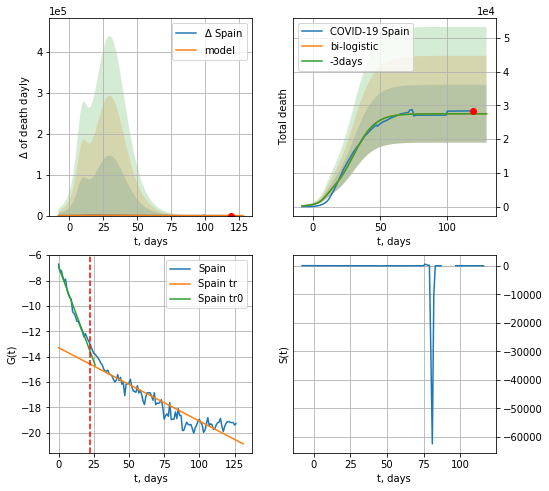

Spain data at: 2020-07-08
+3 day model MAPE: 0.0016565673532850675
model: bi-logistic
coeffs:  [2.48164714e+04 1.24341398e-01 3.01267366e+01] [2.74529349e+03 3.87912491e-01 9.73356455e+00]
rational stdev:  0.3112322443789131
forecast at the end of period: +10 days
	 deltaDaydeath:  0
	 total death:  27561 ± 8578
bi-logistic approximation splitting point: 22
trend0 coefficient of determination: 0.976968
 intercept: -6.910878
 slope: -0.297821
trend coefficient of determination: 0.870562
 intercept: -13.292366
 slope: -0.057795


In [90]:
vL = 22#len(dfSP[:])-7-dT
#dfSP = read_df(pd.DataFrame(),"SP")
x = forecast('Spain',dfSP[7:vL],d1,7*16-dT,1.0,cases='death')
xx = forecast2('Spain',dfSP[7:],d1,7*16-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.8],vL=vL,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


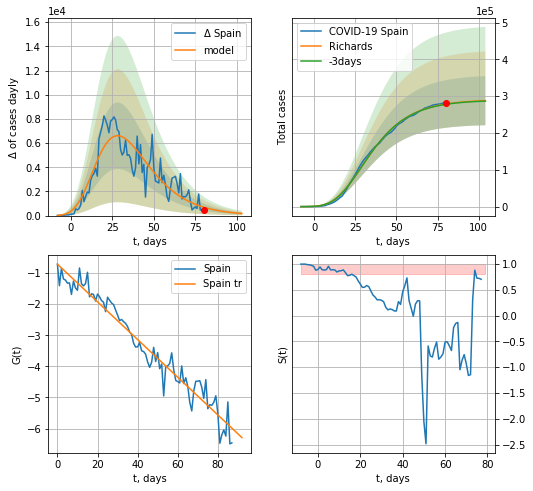

Spain data at: 2020-07-08
+3 day model MAPE: 0.003583
model: Richards
coeffs: [ 2.90610625e+05  9.41852610e+00 -5.22377391e+01  6.58781579e-03]
rational stdev: 0.231944
forecast at the end of period: +24 days
	 deltaDaycases: 172
	 total cases: 287904 ± 66777
	 total death: 27288 ± 18987
trend coefficient of determination: 0.950823
 intercept: -0.716096
 slope: -0.060553


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


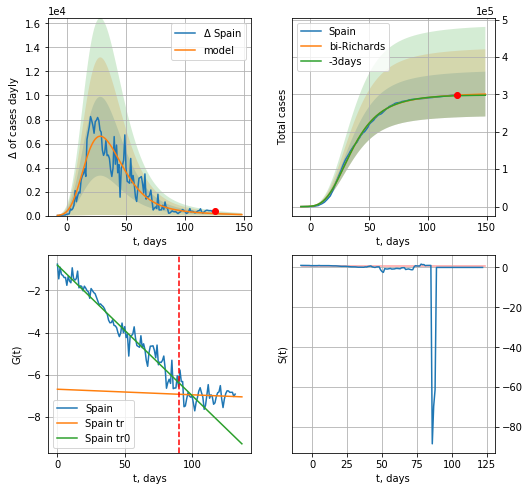

Spain data at: 2020-07-08
+3 day model MAPE: 0.004995
model: bi-Richards
coeffs: [ 1.29678378e+04  1.65903954e+00 -2.03231090e+01  1.94095899e-02]
rational stdev: 0.199010
forecast at the end of period: +24 days
	 deltaDaycases: 85
	 total cases: 300847 ± 59871
	 total death: 28514 ± 17023
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.955481
 intercept: -0.803649
 slope: -0.061725
trend coefficient of determination: 0.007538
 intercept: -6.676730
 slope: -0.002634


In [91]:
vL = 90+1
x = forecastRR('Spain',dfSP[1:vL-1],d1,7*18-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Spain',dfSP[1:],d1,7*18-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-1)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


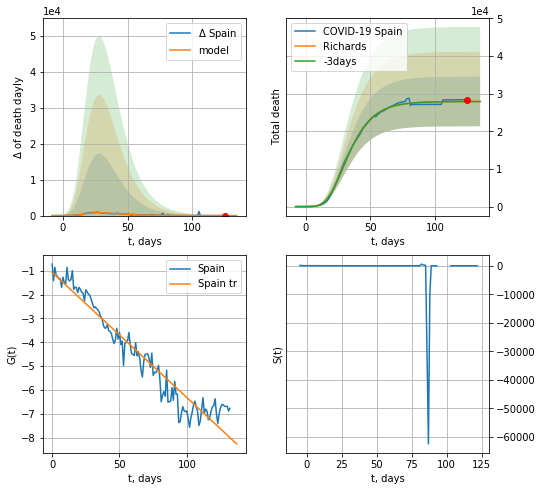

Spain data at: 2020-07-08
+3 day model MAPE: 0.001087
model: Richards
coeffs: [ 2.79297967e+04  9.31173876e+00 -3.18994858e+01  8.46454111e-03]
rational stdev: 0.236194
forecast at the end of period: +10 days
	 total death: 27923 ± 6595
trend coefficient of determination: 0.934336
 intercept: -1.067889
 slope: -0.052482


In [92]:
x = forecastRR('Spain',dfSP[1:],d1,7*16-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


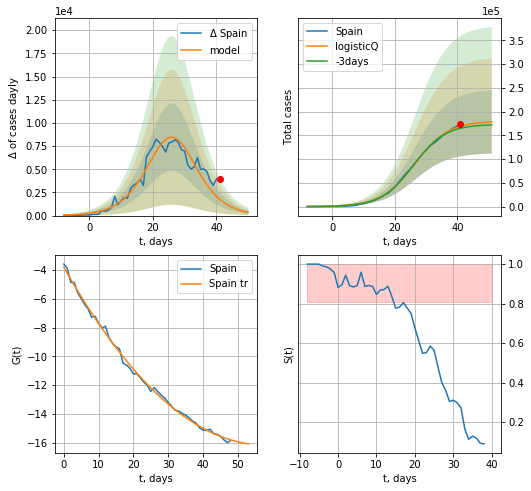

Spain data at: 2020-07-08
+3 day model MAPE: 0.028163
model: logisticQ
coeffs: [ 1.79944314e+05  4.82942779e-06  2.63952863e+01 -3.89581546e+04]
rational stdev: 0.373922
forecast at the end of period: +10 days
	 deltaDaycases: 354
	 total cases: 178215 ± 66638
	 total death: 16891 ± 18947
trend coefficient of determination: 0.997334
 intercept_: -3.7990007659330134
 coeffs_: [ 0.         -0.42831531  0.00370949]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


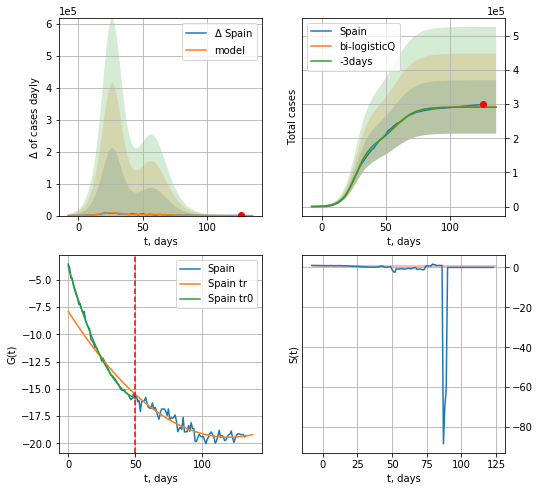

Spain data at: 2020-07-08
+3 day model MAPE: 0.002155
model: bi-logisticQ
coeffs: [ 1.12037220e+05  3.84461263e-07  5.75087050e+01 -3.24631994e+05]
rational stdev: 0.267514
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 291975 ± 78107
	 total death: 27673 ± 22208
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.997131
 intercept_: -3.7751216617675887
 coeffs_: [ 0.         -0.43240435  0.00381547]
trend coefficient of determination: 0.892768
 intercept_: -7.911150247150891
 coeffs_: [ 0.         -0.19094857  0.00079141]


In [93]:
x = forecastRRR('Spain',dfSP[:50],d1,7*16-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[:],d1,7*16-dT,x,1.0,addpred=False,xcoef=koreaCoeffs,vL=50)#[.35,.5,3.,1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


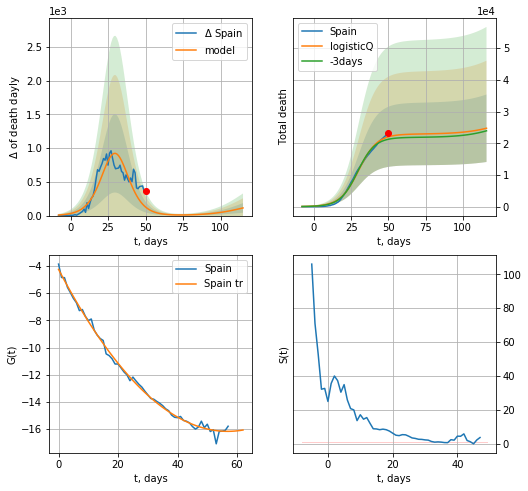

Spain data at: 2020-07-08
+3 day model MAPE: 0.037624
model: logisticQ
coeffs: [ 2.28798062e+04  1.92571131e-06  3.00460867e+01 -8.38155043e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.430820
forecast at the end of period: +66 days
	 total death: 24734 ± 10655
trend coefficient of determination: 0.995937
 intercept_: -4.2575122176431694
 coeffs_: [ 0.         -0.41856419  0.00368029]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:294: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:347: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:347: RuntimeWarning: invalid value encountered in true_divide


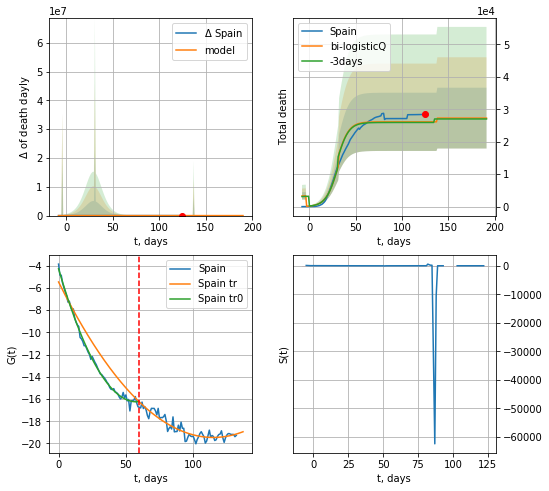

Spain data at: 2020-07-08
+3 day model MAPE: 0.007655
model: bi-logisticQ
coeffs: [3244.74431785   10.31374143   31.49443828   -3.83230706]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.343412
forecast at the end of period: +66 days
	 total death: 27273 ± 9366
bi-logisticQ approximation splitting point: 60
trend coefficient of determination: 0.995783
 intercept_: -4.28878212009627
 coeffs_: [ 0.         -0.41413346  0.00358475]
trend coefficient of determination: 0.854425
 intercept_: -5.478615670285832
 coeffs_: [ 0.         -0.24326039  0.00105821]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [94]:
x = forecastRRR('Spain',dfSP[1:60],d1,7*24-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[1:],d1,7*24-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,cases='death',vL=60)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


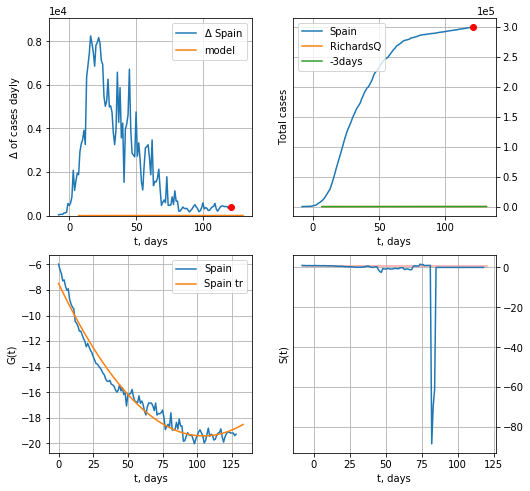

Spain data at: 2020-07-08
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 7.79976480e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +10 days
	 deltaDaycases: 5


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [95]:
x = forecastQR('Spain',dfSP[5:],d1,7*16-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])

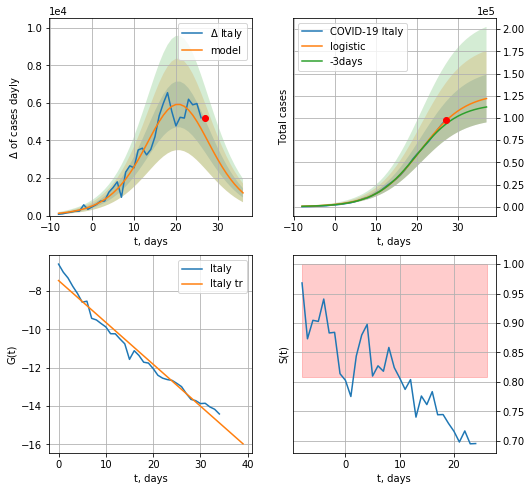

Italy data at: 2020-07-08
+3 day model MAPE: 0.045578378390248614
model: logistic
coeffs:  [1.28139025e+05 1.85112183e-01 2.10100292e+01]
rational stdev:  0.22065596678975638
forecast at the end of period: +10 days
	 deltaDaycases:  1208
	 total cases:  121825 ± 26881
	 total death:  17565 ± 11627
trend coefficient of determination: 0.974872
 intercept: -7.448746
 slope: -0.218671


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:189: RuntimeWarning: overflow encountered in exp


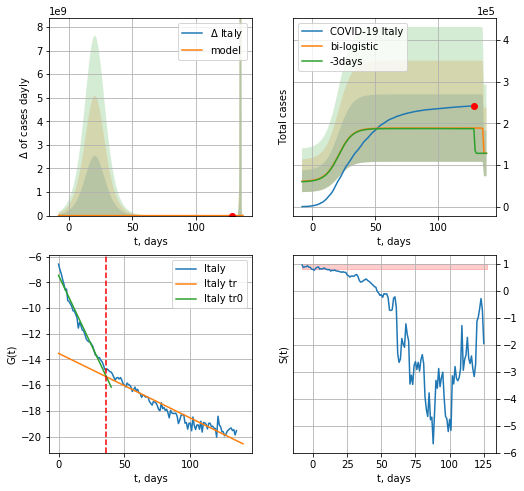

Italy data at: 2020-07-08
+3 day model MAPE: 0.4065441340969632
model: bi-logistic
coeffs:  [ 6.06078551e+04 -9.58925794e+00  1.35391512e+02] [1.28139025e+05 1.85112183e-01 2.10100292e+01]
rational stdev:  0.4291472800333034
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  128139 ± 54990
	 total death:  18475 ± 23785
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975965
 intercept: -7.466589
 slope: -0.217097
trend coefficient of determination: 0.924358
 intercept: -13.527677
 slope: -0.050229


In [96]:
vL = 36#len(dfIT)-6-dT
x = forecast('Italy',dfIT[:vL],d1,16*7-dT,1.0)
xx = forecast2('Italy',dfIT,d1,16*7-dT,x,1.0,vL=vL)

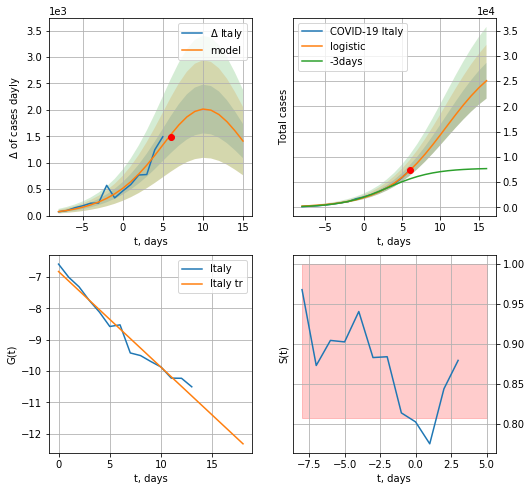

Italy data at: 2020-07-08
+3 day model MAPE: 0.44264442257961345
model: logistic
coeffs:  [3.14978181e+04 2.56455869e-01 1.06869163e+01]
rational stdev:  0.14147817336323687
forecast at the end of period: +10 days
	 deltaDaycases:  1410
	 total cases:  25077 ± 3547
	 total death:  3615 ± 1534
trend coefficient of determination: 0.972594
 intercept: -6.827533
 slope: -0.305163


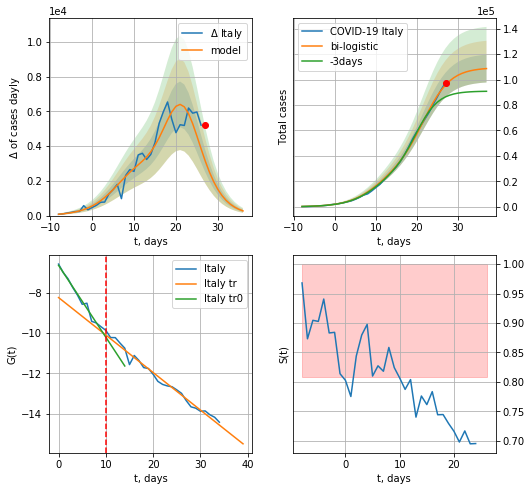

Italy data at: 2020-07-08
+3 day model MAPE: 0.1273932560599292
model: bi-logistic
coeffs:  [7.78644605e+04 3.07215535e-01 2.18188307e+01] [3.14978181e+04 2.56455869e-01 1.06869163e+01]
rational stdev:  0.10049358500066935
forecast at the end of period: +10 days
	 deltaDaycases:  269
	 total cases:  108597 ± 10913
	 total death:  15658 ± 4720
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


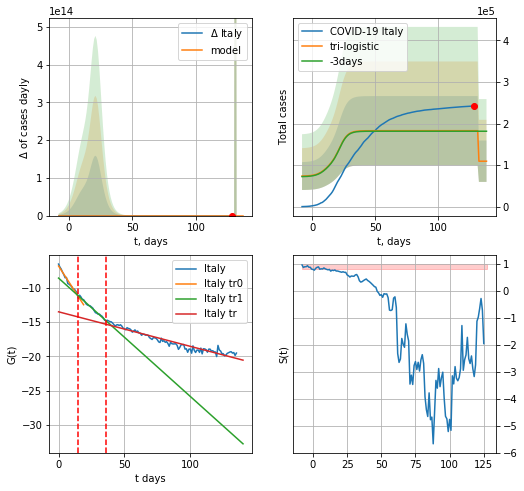

Italy data at: 2020-07-08
+3 day model MAPE: 0.007304493799233881
model: tri-logistic
coeffs:  [ 7.34116515e+04 -5.17172859e+01  1.31592719e+02] [3.14978181e+04 2.56455869e-01 1.06869163e+01 7.78644605e+04
 3.07215535e-01 2.18188307e+01]
forecast rational stdev:  0.4551587122568482
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  109362 ± 49777
	 total death:  15768 ± 21530
tri-logistic approximation splitting points: 15,36
trend0 coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498
trend1 coefficient of determination: 0.980669
 intercept: -8.621660
 slope: -0.172200
trend coefficient of determination: 0.924358
 intercept: -13.527677
 slope: -0.050229


In [97]:
vL = 15#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*16-dT,1.0)
xx = forecast2('Italy',dfIT[:vL1],d1,7*16-dT,x,1.0)#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*16-dT, xx, shift=1.,addpred=False,xcoef=[.35,1.,1.5],vL=[vL,vL1])

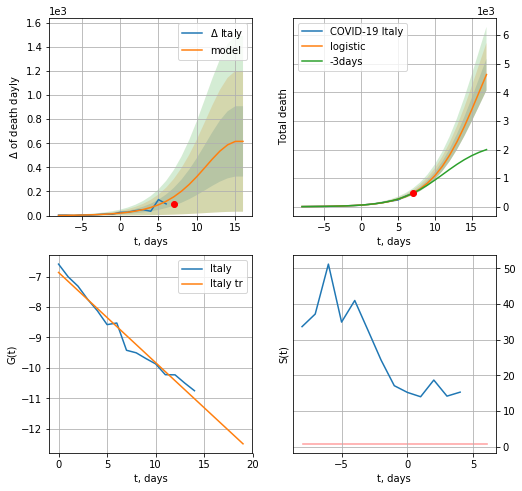

Italy data at: 2020-07-08
+3 day model MAPE: 0.04050471838994123
model: logistic
coeffs:  [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12009380059110428
forecast at the end of period: +10 days
	 total death:  4623 ± 555
trend coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498


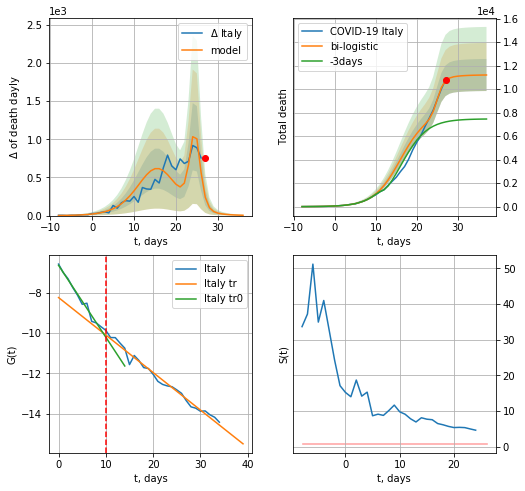

Italy data at: 2020-07-08
+3 day model MAPE: 0.5045455507817326
model: bi-logistic
coeffs:  [3.18991891e+03 1.24679374e+00 2.50159525e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01]
rational stdev:  0.12176249997037505
forecast at the end of period: +10 days
	 deltaDaydeath:  4
	 total death:  11199 ± 1363
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


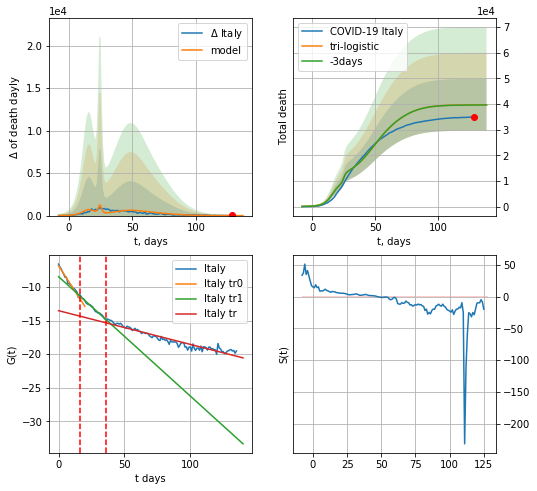

Italy data at: 2020-07-08
+3 day model MAPE: 0.0021180285252102404
model: tri-logistic
coeffs:  [2.28093120e+04 1.02162702e-01 4.79311381e+01] [8.02160580e+03 3.09188022e-01 1.60041165e+01 3.18991891e+03
 1.24679374e+00 2.50159525e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.25477783366559387
forecast at the end of period: +10 days
	 deltaDaydeath:  0
	 total death:  39714 ± 10118
tri-logistic approximation splitting points: 16,36
trend0 coefficient of determination: 0.976775
 intercept: -6.838969
 slope: -0.302094
trend1 coefficient of determination: 0.986358
 intercept: -8.457993
 slope: -0.177909
trend coefficient of determination: 0.924358
 intercept: -13.527677
 slope: -0.050229


In [98]:
vL = 16#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*16-dT,1.0,cases='death')
xx = forecast2('Italy',dfIT[:vL1],d1,7*16-dT,x,1.0,cases='death')#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*16-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


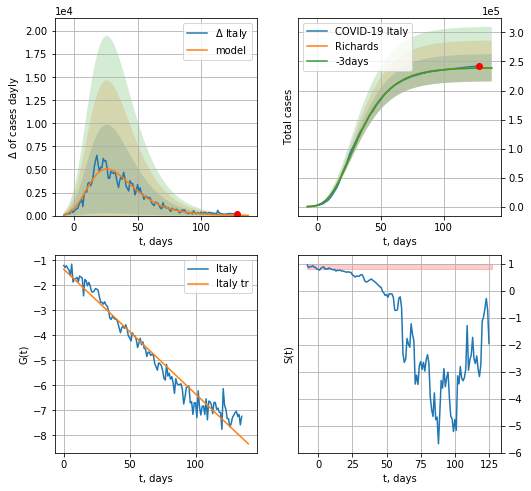

Italy data at: 2020-07-08
+3 day model MAPE: 0.001058
model: Richards
coeffs: [ 2.39452206e+05  7.02170300e+00 -5.70859066e+01  8.20328297e-03]
rational stdev: 0.098185
forecast at the end of period: +10 days
	 deltaDaycases: 22
	 total cases: 239067 ± 23472
	 total death: 34469 ± 10152
trend coefficient of determination: 0.966253
 intercept: -1.356556
 slope: -0.049856


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


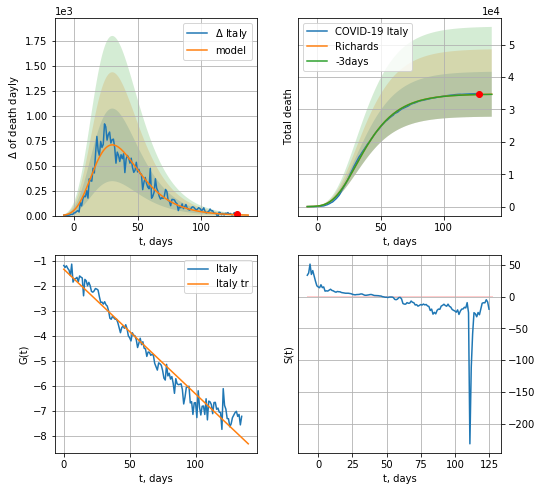

Italy data at: 2020-07-08
+3 day model MAPE: 0.000729
model: Richards
coeffs: [ 3.47742359e+04  8.23657153e+00 -5.93091823e+01  6.74887846e-03]
rational stdev: 0.199857
forecast at the end of period: +10 days
	 total death: 34685 ± 6932
trend coefficient of determination: 0.966289
 intercept: -1.342903
 slope: -0.049811


In [99]:
vL=95
x = forecastRR('Italy',dfIT[:],d1,16*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Italy',dfIT[:],d1,16*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRR('Italy',dfIT[:],d1,16*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


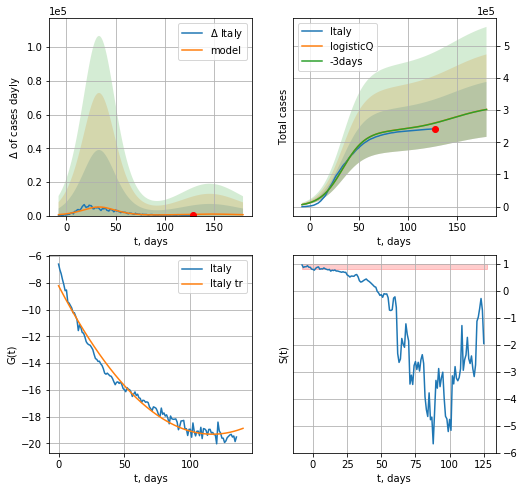

Italy data at: 2020-07-08
+3 day model MAPE: 0.001247
model: logisticQ
coeffs: [ 2.34608488e+05  2.46874282e-07  3.34304895e+01 -3.51072554e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.282630
forecast at the end of period: +52 days
	 deltaDaycases: 549
	 total cases: 302482 ± 85490
	 total death: 43613 ± 36979
trend coefficient of determination: 0.980690
 intercept_: -8.210485962770257
 coeffs_: [ 0.         -0.19028349  0.00081475]


In [100]:
x = forecastRRR('Italy',dfIT[:],d1,7*22-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


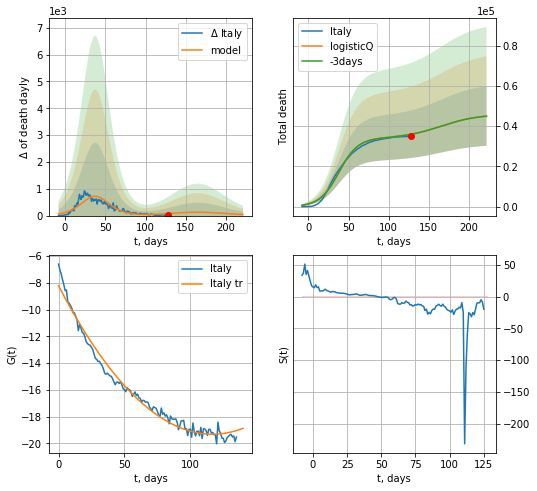

Italy data at: 2020-07-08
+3 day model MAPE: 0.001672
model: logisticQ
coeffs: [ 3.39561831e+04  2.26125199e-07  3.78819278e+01 -3.73474969e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.328257
forecast at the end of period: +94 days
	 total death: 44997 ± 14770
trend coefficient of determination: 0.980690
 intercept_: -8.210485962770257
 coeffs_: [ 0.         -0.19028349  0.00081475]


In [101]:
x = forecastRRR('Italy',dfIT[:],d1,7*28-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

In [102]:
dT

102

FR
           date     cases  active    death
140 2020-07-04  166960.3   60007  29893.0
141 2020-07-05  166960.6   60007  29893.0
142 2020-07-06  168335.0   61107  29920.0
143 2020-07-07  168810.0   61222  29933.0
144 2020-07-08  169473.0   61523  29965.0


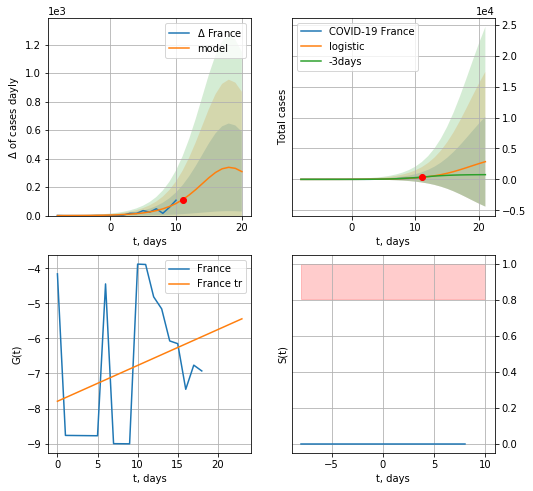

France data at: 2020-07-08
+3 day model MAPE: 0.04053337370546569
model: logistic
coeffs:  [4.17383165e+03 3.25568771e-01 1.85949028e+01]
rational stdev:  2.5390562100826064
forecast at the end of period: +10 days
	 deltaDaycases:  308
	 total cases:  2864 ± 7273
	 total death:  506 ± 3854
trend coefficient of determination: 0.083417
 intercept: -7.793073
 slope: 0.102246


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


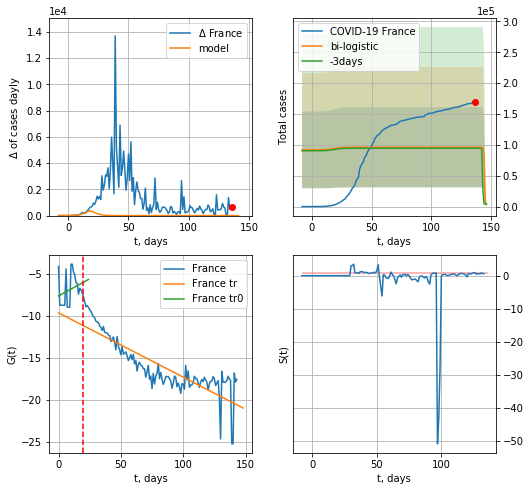

France data at: 2020-07-08
+3 day model MAPE: 0.016243380225191166
model: bi-logistic
coeffs:  [ 9.19642238e+04 -5.51536529e+00  1.44325580e+02] [4.17383165e+03 3.25568771e-01 1.85949028e+01]
rational stdev:  0.6760858199829405
forecast at the end of period: +10 days
	 deltaDaycases:  -2167
	 total cases:  4182 ± 2827
	 total death:  739 ± 1498
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.062178
 intercept: -7.670498
 slope: 0.081817
trend coefficient of determination: 0.726968
 intercept: -9.678197
 slope: -0.076453


In [103]:
# prideta 1990 2020-04-17
# prideta 3824 2020-04-18
dfFR = read_df(pd.DataFrame(),"FR")
vL=20
x = forecast('France',dfFR[:vL],d1,16*7-dT,1.0)
xx = forecast2('France',dfFR,d1,16*7-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.5],vL=vL)

In [104]:
#vL=len(dfFR)-9-5-dT
#x = forecast('France',dfFR[10:-9-dT],d1,7*5-dT-4,1.0)
#xx = forecast2('France',dfFR[10:],d1,7*7-dT-4,x,1.0,addpred=True,xcoef=[.25,1.,1.4],vL=vL)

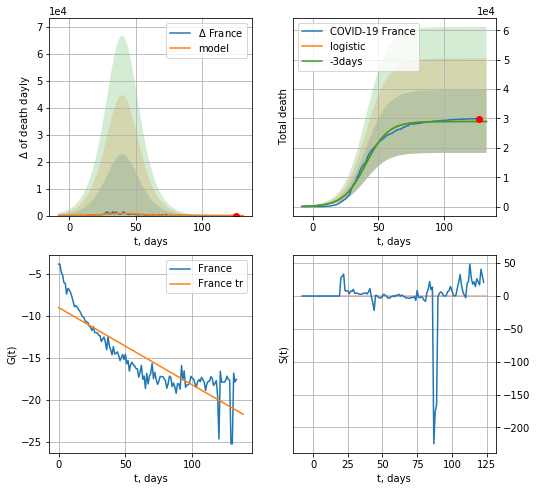

France data at: 2020-07-08
+3 day model MAPE: 0.0019916258013514556
model: logistic
coeffs:  [2.90059316e+04 1.17582437e-01 4.04482550e+01]
rational stdev:  0.36961628841080757
forecast at the end of period: +6 days
	 total death:  29005 ± 10720
trend coefficient of determination: 0.758600
 intercept: -9.046774
 slope: -0.091893


In [105]:
#dfFR = read_df(pd.DataFrame(),"FR")
x = forecast('France',dfFR[10:],d1,7*16-dT-4,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


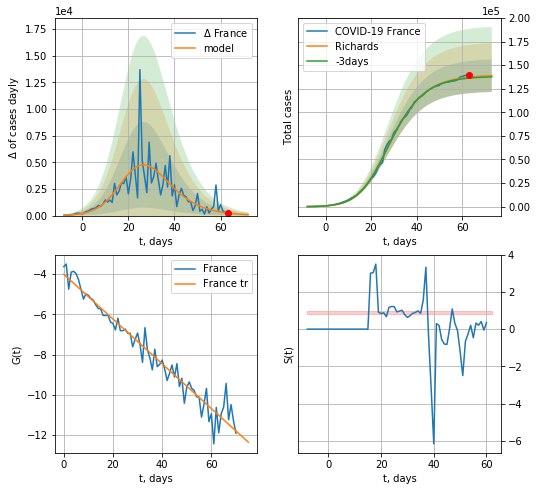

France data at: 2020-07-08
+3 day model MAPE: 0.007986
model: Richards
coeffs: [1.39530079e+05 2.42709630e-01 2.04374273e+01 4.70589839e-01]
rational stdev: 0.124192
forecast at the end of period: +10 days
	 deltaDaycases: 87
	 total cases: 138800 ± 17237
	 total death: 24541 ± 9143
trend coefficient of determination: 0.951177
 intercept: -4.003023
 slope: -0.111381


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


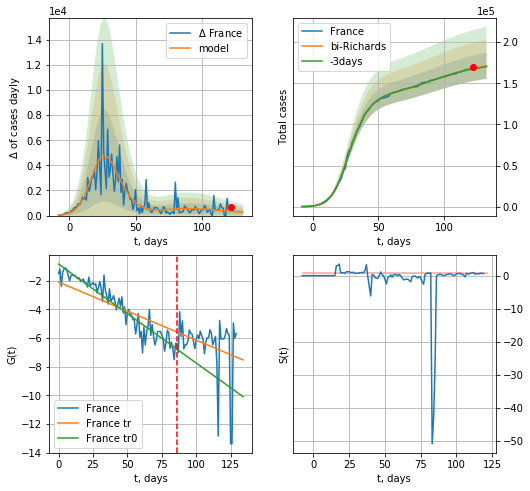

France data at: 2020-07-08
+3 day model MAPE: 0.004296
model: bi-Richards
coeffs: [ 3.92171862e+04  3.00438765e+00 -2.24127472e+01  1.27089862e-02]
rational stdev: 0.092168
forecast at the end of period: +10 days
	 deltaDaycases: 264
	 total cases: 171123 ± 15772
	 total death: 30256 ± 8365
bi-Richards approximation splitting point: 86
trend coefficient of determination: 0.904654
 intercept: -0.853324
 slope: -0.068960
trend coefficient of determination: 0.071422
 intercept: -2.105841
 slope: -0.040519


In [106]:
vL = 86+14
x = forecastRR('France',dfFR[14:vL-14],d1,16*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('France',dfFR[14:],d1,16*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-14)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


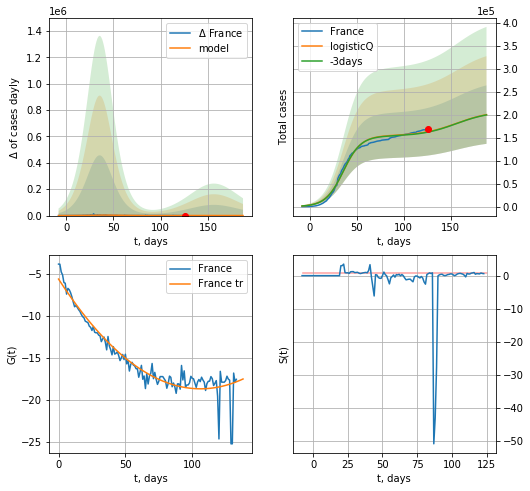

France data at: 2020-07-08
+3 day model MAPE: 0.005255
model: logisticQ
coeffs: [ 1.54027722e+05  2.10289289e-07  3.59368504e+01 -5.04578777e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.317783
forecast at the end of period: +62 days
	 deltaDaycases: 394
	 total cases: 199970 ± 63547
	 total death: 35357 ± 33707
trend coefficient of determination: 0.902501
 intercept_: -5.662153320271008
 coeffs_: [ 0.         -0.24574169  0.00115677]


In [107]:
x = forecastRRR('France',dfFR[10:],d1,24*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


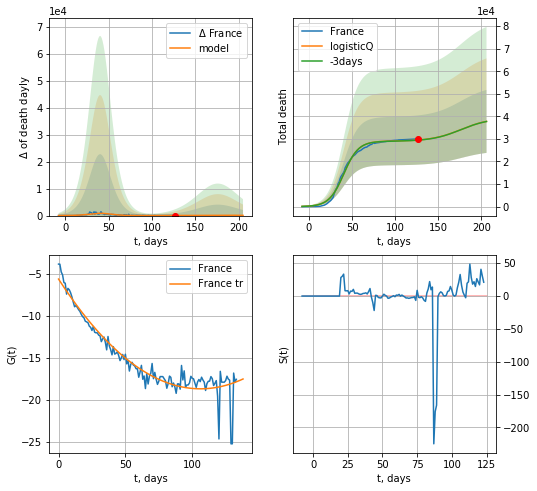

France data at: 2020-07-08
+3 day model MAPE: 0.002018
model: logisticQ
coeffs: [ 2.90059013e+04  3.54356557e-07  4.04489589e+01 -3.31674966e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.369674
forecast at the end of period: +80 days
	 total death: 37766 ± 13961
trend coefficient of determination: 0.902501
 intercept_: -5.662153320271008
 coeffs_: [ 0.         -0.24574169  0.00115677]


In [108]:
x = forecastRRR('France',dfFR[10:],d1,26*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1.])

In [109]:
#x = forecastR('France',dfFR[:],d1,8*7-dT-4,1.0,addpred=True,xcoef=[0.25,1.,20.,1])

In [110]:
#trend3(dfGR,dfUS,dfGB[:],'GR','US','GB',40,40,40)

GR
           date   cases  active   death
131 2020-07-04  197418    7037  9081.0
132 2020-07-05  197558    6272  9086.0
133 2020-07-06  198064    6272  9092.0
134 2020-07-07  198355    6552  9103.0
135 2020-07-08  198765    6050  9115.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


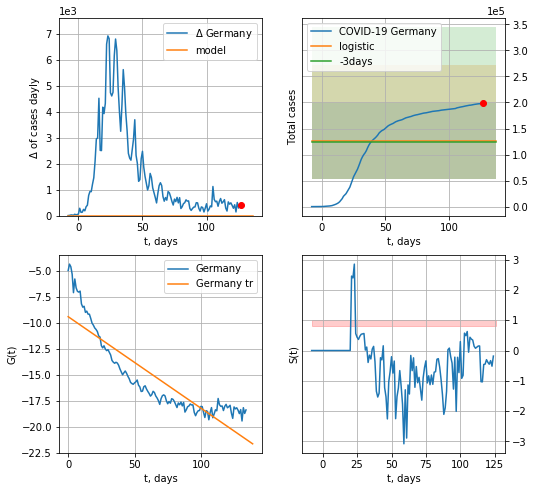

Germany data at: 2020-07-08
+3 day model MAPE: 0.012957380572265857
model: logistic
coeffs:  [ 1.26600213e+05 -4.89370648e+00  1.45621639e+02]
rational stdev:  0.5753947092477331
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  126600 ± 72845
	 total death:  5805 ± 10020
trend coefficient of determination: 0.783326
 intercept: -9.415009
 slope: -0.087963


In [111]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[:],d1,7*16-dT,1.0)
#xx = forecast2('Germany',dfGR,d1,7*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


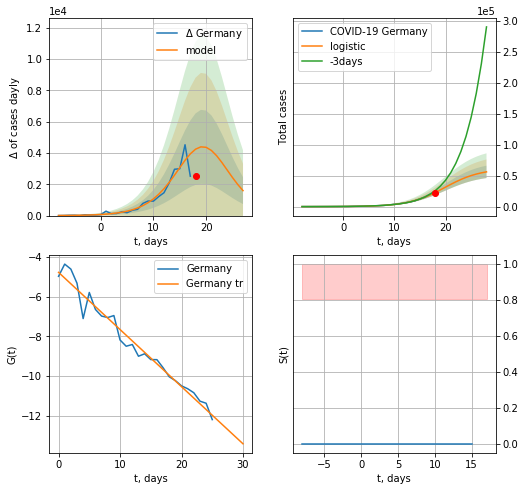

Germany data at: 2020-07-08
+3 day model MAPE: 0.18326880785963318
model: logistic
coeffs:  [6.15503822e+04 2.86340376e-01 1.98405527e+01]
rational stdev:  0.17812668621755098
forecast at the end of period: +10 days
	 deltaDaycases:  1593
	 total cases:  56124 ± 9997
	 total death:  2573 ± 1374
trend coefficient of determination: 0.966755
 intercept: -4.774386
 slope: -0.288157


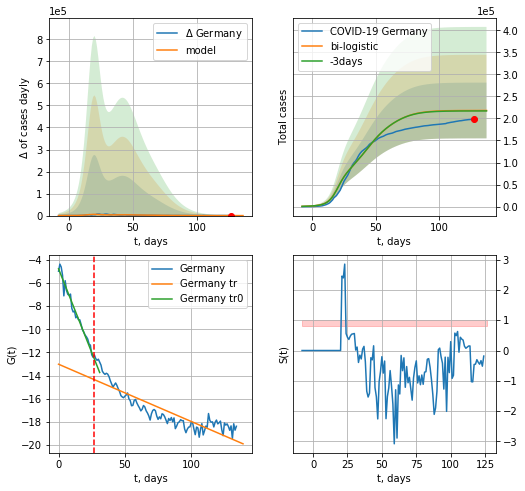

Germany data at: 2020-07-08
+3 day model MAPE: 0.004653892253247558
model: bi-logistic
coeffs:  [1.25260199e+05 1.07821792e-01 4.18268017e+01] [6.15503822e+04 2.86340376e-01 1.98405527e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.28976136687347964
forecast at the end of period: +10 days
	 deltaDaycases:  2
	 total cases:  218104 ± 63198
	 total death:  10001 ± 8693
bi-logistic approximation splitting point: 27
trend0 coefficient of determination: 0.970316
 intercept: -4.764587
 slope: -0.289333
trend coefficient of determination: 0.777506
 intercept: -13.017081
 slope: -0.049529


In [112]:
vL = 27
x = forecast('Germany',dfGR[:vL],d1,16*7-dT,1.0)#,addpred=True,xcoef=[0.25,1.,2.0,1])
xx = forecast2('Germany',dfGR,d1,7*16-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.6],vL=vL)

GR
           date   cases  active   death
131 2020-07-04  197418    7037  9081.0
132 2020-07-05  197558    6272  9086.0
133 2020-07-06  198064    6272  9092.0
134 2020-07-07  198355    6552  9103.0
135 2020-07-08  198765    6050  9115.0


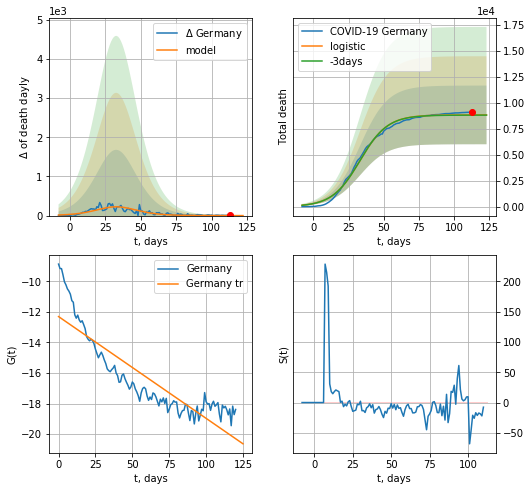

Germany data at: 2020-07-08
+3 day model MAPE: 0.0023143121128309484
model: logistic
coeffs:  [8.83658804e+03 1.01720601e-01 3.30879801e+01]
rational stdev:  0.31978861532666447
forecast at the end of period: +10 days
	 total death:  8835 ± 2825
trend coefficient of determination: 0.779253
 intercept: -12.309802
 slope: -0.066568


In [113]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[14:],d1,16*7-dT,1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


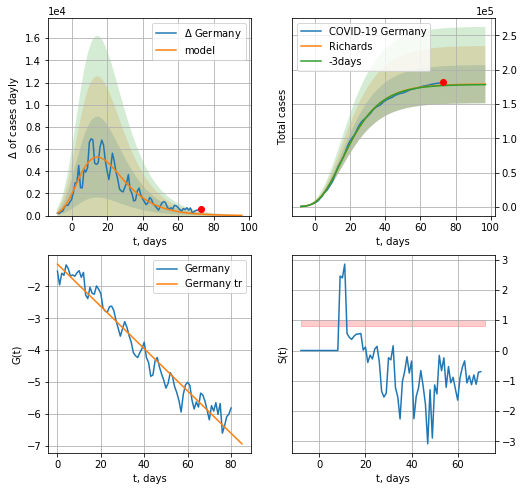

Germany data at: 2020-07-08
+3 day model MAPE: 0.003916
model: Richards
coeffs: [ 1.79110364e+05  9.11571266e+00 -4.38812227e+01  8.82260552e-03]
rational stdev: 0.155516
forecast at the end of period: +24 days
	 deltaDaycases: 20
	 total cases: 178866 ± 27816
	 total death: 8202 ± 3826
trend coefficient of determination: 0.956452
 intercept: -1.304650
 slope: -0.066180


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


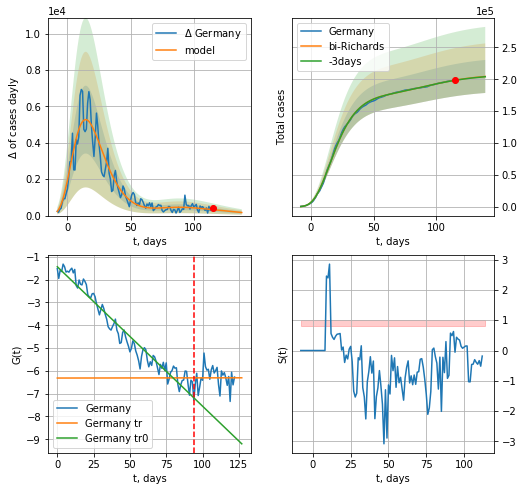

Germany data at: 2020-07-08
+3 day model MAPE: 0.000842
model: bi-Richards
coeffs: [ 2.99107850e+04  5.29027091e+00 -3.29457531e+01  7.35513254e-03]
rational stdev: 0.126699
forecast at the end of period: +24 days
	 deltaDaycases: 169
	 total cases: 204365 ± 25893
	 total death: 9371 ± 3561
bi-Richards approximation splitting point: 94
trend coefficient of determination: 0.950728
 intercept: -1.432847
 slope: -0.061162
trend coefficient of determination: 0.000002
 intercept: -6.315523
 slope: 0.000081


In [114]:
vL = 94+12
x = forecastRR('Germany',dfGR[12:vL-12],d1,18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Germany',dfGR[12:],d1,18*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


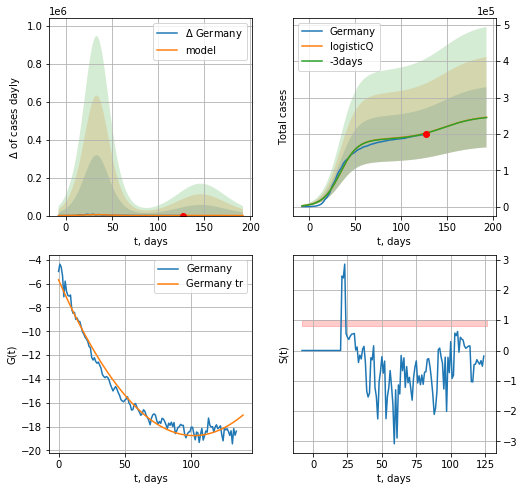

Germany data at: 2020-07-08
+3 day model MAPE: 0.002871
model: logisticQ
coeffs: [ 1.85255791e+05  2.15948053e-07  3.36514300e+01 -4.86299572e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.337298
forecast at the end of period: +66 days
	 deltaDaycases: 259
	 total cases: 245645 ± 82855
	 total death: 11264 ± 11397
trend coefficient of determination: 0.978020
 intercept_: -5.678100827625126
 coeffs_: [ 0.         -0.25654789  0.00125811]


In [115]:
x = forecastRRR('Germany',dfGR[:],d1,24*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.0,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


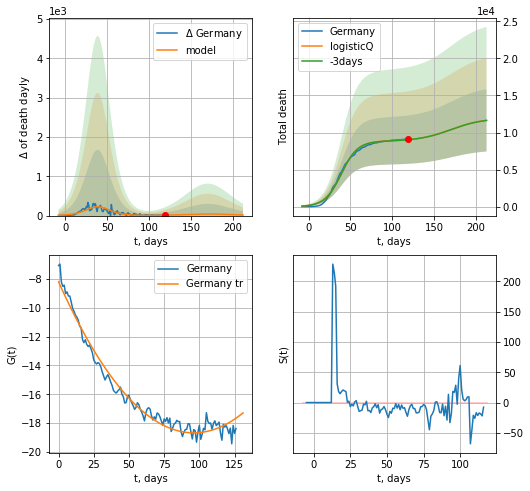

Germany data at: 2020-07-08
+3 day model MAPE: 0.002274
model: logisticQ
coeffs: [ 8.83518954e+03  3.79240597e-07  3.90863194e+01 -2.68584570e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.360786
forecast at the end of period: +94 days
	 total death: 11648 ± 4202
trend coefficient of determination: 0.974376
 intercept_: -8.185667758118736
 coeffs_: [ 0.         -0.2186031   0.00113783]


In [116]:
x = forecastRRR('Germany',dfGR[8:],d1,28*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.0,1])

US
           date    cases   active     death
125 2020-07-04  2935770  1543047  132318.0
126 2020-07-05  2983155  1560897  132571.0
127 2020-07-06  3041035  1582988  132981.0
128 2020-07-07  3097084  1608249  133972.0
129 2020-07-08  3158932  1631391  134862.0


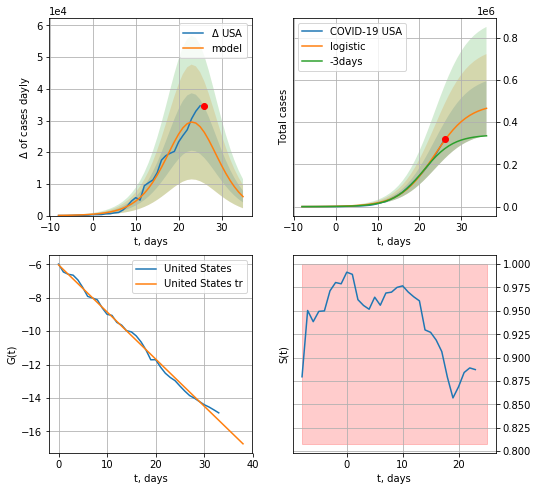

USA data at: 2020-07-08
+3 day model MAPE: 0.17962965715206392
model: logistic
coeffs:  [4.89025783e+05 2.41973857e-01 2.36121759e+01]
rational stdev:  0.2760702577358041
forecast at the end of period: +10 days
	 deltaDaycases:  5983
	 total cases:  465778 ± 128587
	 total death:  19885 ± 16468
trend coefficient of determination: 0.995387
 intercept: -6.036925
 slope: -0.281840


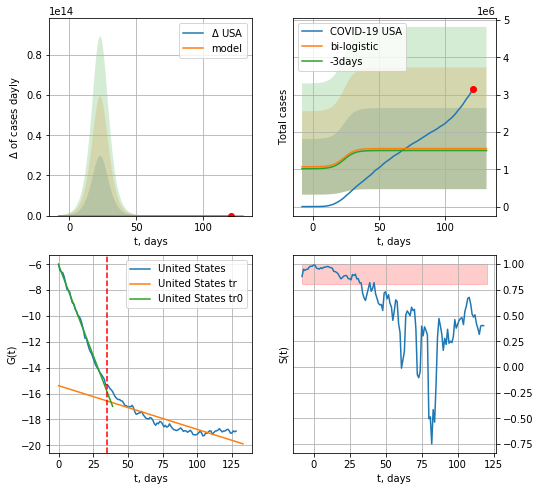

USA data at: 2020-07-08
+3 day model MAPE: 0.03453841729459149
model: bi-logistic
coeffs:  [ 8.52386045e+05 -1.08206917e+01  2.68798978e+02] [4.89025783e+05 2.41973857e-01 2.36121759e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
rational stdev:  0.6987996217076599
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  1554508 ± 1086289
	 total death:  66365 ± 139127
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.995488
 intercept: -6.051468
 slope: -0.280518
trend coefficient of determination: 0.786930
 intercept: -15.390530
 slope: -0.033818


In [117]:
vL=35
dfUS = read_df(pd.DataFrame(),"US")
x = forecast('USA',dfUS[:vL],d1,16*7-dT,1.0,addpred=False,xcoef=[0.25,1.,2.])
xx = forecast2('USA',dfUS[:],d1,16*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.5],vL=vL)

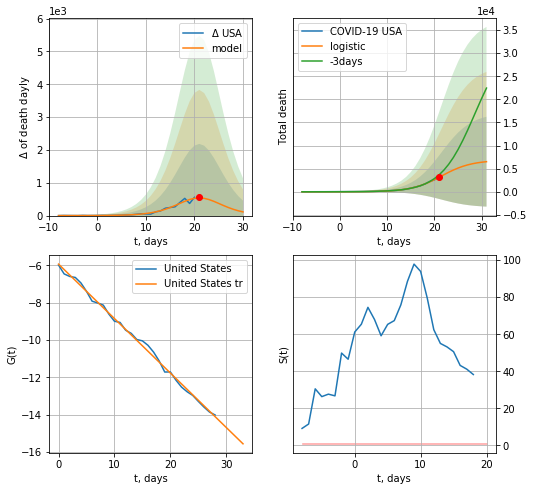

USA data at: 2020-07-08
+3 day model MAPE: 0.214213224760407
model: logistic
coeffs:  [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  1.4929056707100332
forecast at the end of period: +10 days
	 total death:  6512 ± 9721
trend coefficient of determination: 0.996549
 intercept: -5.938291
 slope: -0.291586


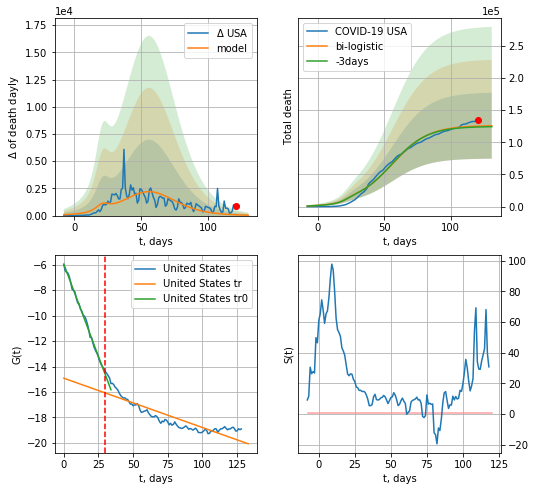

USA data at: 2020-07-08
+3 day model MAPE: 0.011221650221534553
model: bi-logistic
coeffs:  [1.19412143e+05 7.36657368e-02 5.61311355e+01] [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  0.40733577294022466
forecast at the end of period: +10 days
	 deltaDaydeath:  36
	 total death:  125767 ± 51229
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.996707
 intercept: -5.949158
 slope: -0.290421
trend coefficient of determination: 0.784115
 intercept: -14.914619
 slope: -0.038760


In [118]:
vL=30
x = forecast('USA',dfUS[:vL],d1,7*16-dT,1.0,cases='death')
xx = forecast2('USA',dfUS,d1,7*16-dT,x,1.0,cases='death',vL=vL)
#x = forecast('USA',dfUS[:],d1,28*3-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


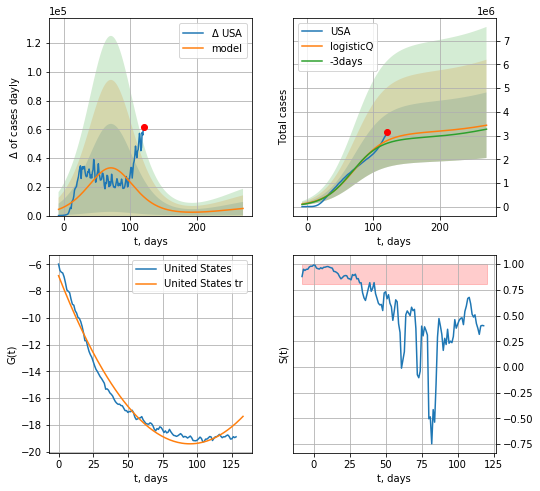

USA data at: 2020-07-08
+3 day model MAPE: 0.044132
model: logisticQ
coeffs: [ 3.10597373e+06  1.31505533e-07  7.12557277e+01 -3.23975574e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.402613
forecast at the end of period: +150 days
	 deltaDaycases: 4955
	 total cases: 3435123 ± 1383026
	 total death: 146653 ± 177133
trend coefficient of determination: 0.978401
 intercept_: -6.857383408331465
 coeffs_: [ 0.         -0.26529829  0.00140034]


In [119]:
x = forecastRRR('USA',dfUS[:],d1,7*36-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


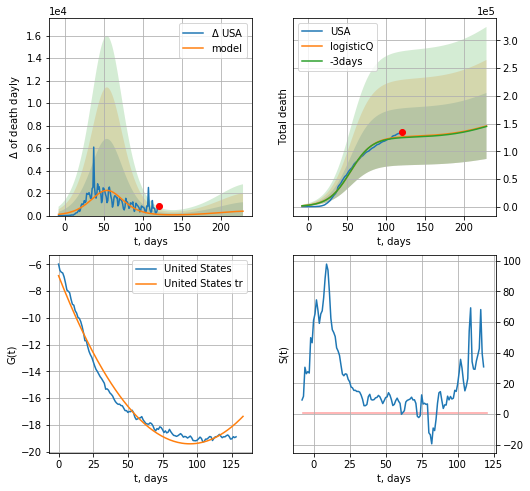

USA data at: 2020-07-08
+3 day model MAPE: 0.011025
model: logisticQ
coeffs: [ 1.26338931e+05  2.09535848e-07  5.42985098e+01 -3.37773505e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.409187
forecast at the end of period: +108 days
	 total death: 145676 ± 59608
trend coefficient of determination: 0.978401
 intercept_: -6.857383408331465
 coeffs_: [ 0.         -0.26529829  0.00140034]


In [120]:
x = forecastRRR('USA',dfUS[:],d1,7*30-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.,1.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


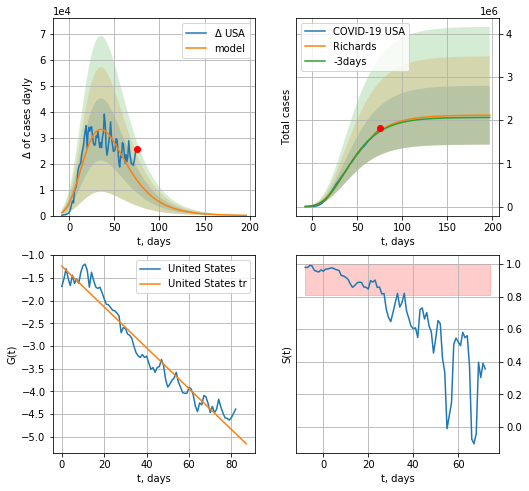

USA data at: 2020-07-08
+3 day model MAPE: 0.011173
model: Richards
coeffs: [ 2.11547108e+06  4.55700208e+00 -7.32276786e+01  9.40292240e-03]
rational stdev: 0.321873
forecast at the end of period: +122 days
	 deltaDaycases: 92
	 total cases: 2113366 ± 680234
	 total death: 90224 ± 87121
trend coefficient of determination: 0.952323
 intercept: -1.242025
 slope: -0.044961


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


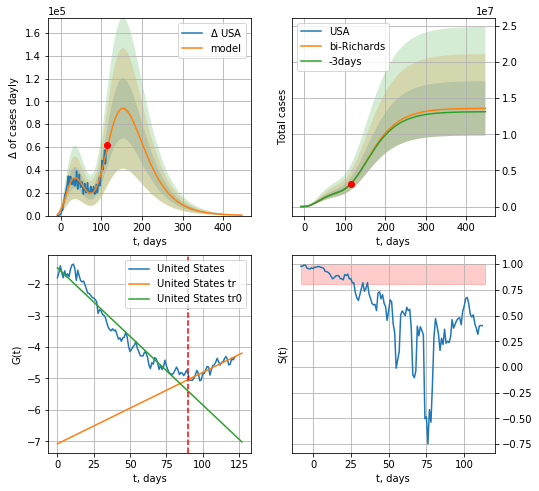

USA data at: 2020-07-08
+3 day model MAPE: 0.001520
model: bi-Richards
coeffs: [ 1.14887443e+07  8.36298411e-01 -7.51640718e+00  2.67471288e-02]
rational stdev: 0.276260
forecast at the end of period: +332 days
	 deltaDaycases: 372
	 total cases: 13587724 ± 3753742
	 total death: 580090 ± 480766
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.944896
 intercept: -1.479622
 slope: -0.043617
trend coefficient of determination: 0.788201
 intercept: -7.079803
 slope: 0.022706


In [121]:
iL = 6
vL = 90+iL
x = forecastRR('USA',dfUS[iL:vL-iL],d1,7*32-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('USA',dfUS[iL:],d1,7*62-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


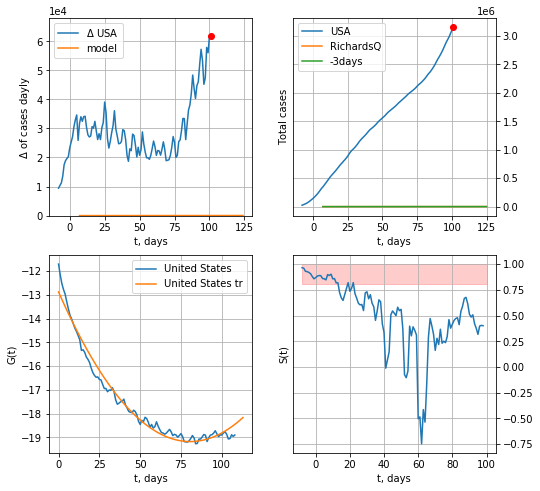

USA data at: 2020-07-08
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 5.52188019e+04  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +24 days
	 deltaDaycases: 30


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [122]:
x = forecastQR('USA',dfUS[20:],d1,7*18-dT,1.0,addpred=False,xcoef=[0.35,.5,3.,1.,1.])

GB
           date   cases  active    death
129 2020-07-04  284900       0  44198.0
130 2020-07-05  285416       0  44220.0
131 2020-07-06  285768       0  44236.0
132 2020-07-07  286349       0  44391.0
133 2020-07-08  286979       0  44517.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


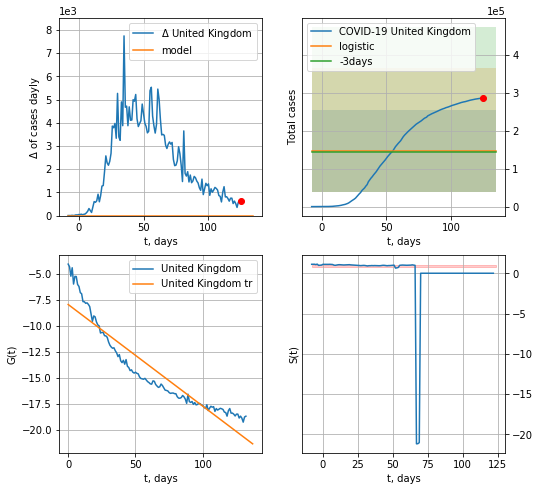

United Kingdom data at: 2020-07-08
+3 day model MAPE: 0.022277719304386927
model: logistic
coeffs:  [ 1.46734037e+05 -8.43330090e+00  2.18998269e+02]
rational stdev:  0.7440641486278121
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  146734 ± 109179
	 total death:  22761 ± 50806
trend coefficient of determination: 0.875878
 intercept: -7.923247
 slope: -0.098015


In [123]:
dfGB = read_df(pd.DataFrame(),"GB")
x = forecast('United Kingdom',dfGB[:],d1,7*16-dT,1.)
#x = forecast('United Kingdom',dfGB[:-8-dT],d1,4*7-dT,1.)
#xx = forecast2('United Kingdom',dfGB[:],d1,4*7-dT,x,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


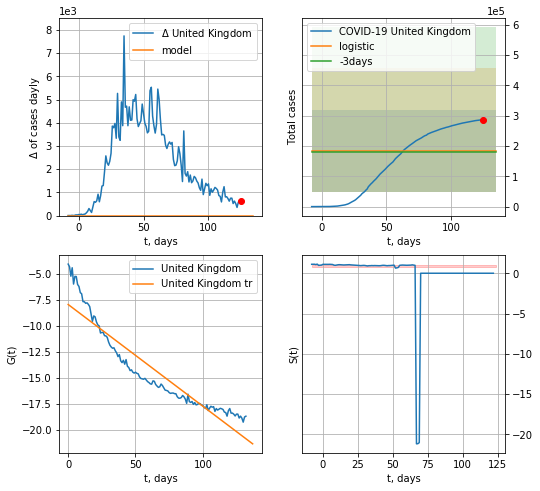

United Kingdom data at: 2020-07-08
+3 day model MAPE: 0.022277719304386844
model: logistic
coeffs:  [ 1.46734037e+05 -8.43330090e+00  2.18998269e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.7440641486278121
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  183417 ± 136474
	 total death:  28452 ± 63510
trend coefficient of determination: 0.875878
 intercept: -7.923247
 slope: -0.098015


In [124]:
x = forecast('United Kingdom',dfGB[:],d1,16*7-dT,1.,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: divide by zero encountered in true_divide


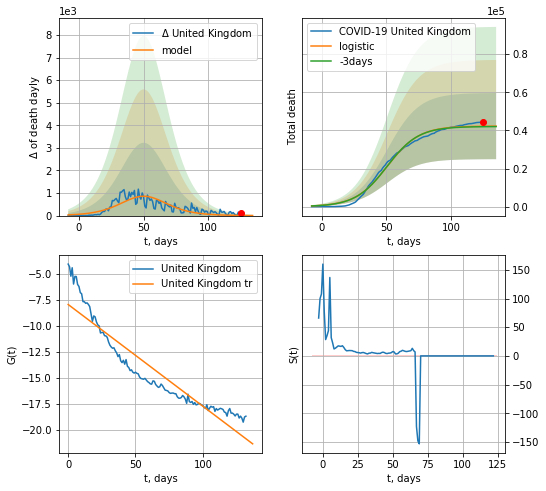

United Kingdom data at: 2020-07-08
+3 day model MAPE: 0.005700111180000216
model: logistic
coeffs:  [4.22954533e+04 8.12260740e-02 5.05778229e+01]
rational stdev:  0.41086264468749945
forecast at the end of period: +10 days
	 total death:  42251 ± 17359
trend coefficient of determination: 0.875878
 intercept: -7.923247
 slope: -0.098015


In [125]:
x = forecast('United Kingdom',dfGB[:],d1,16*7-dT,1.,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


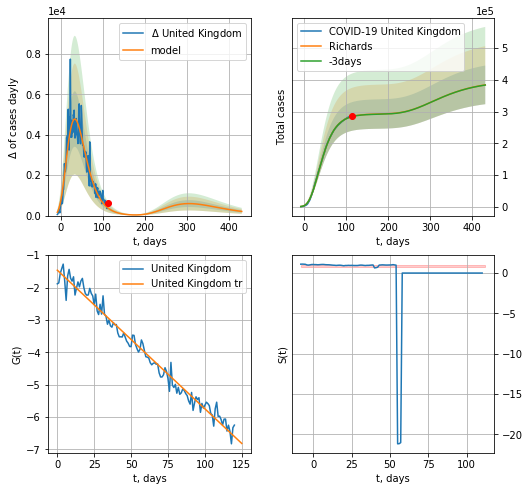

United Kingdom data at: 2020-07-08
+3 day model MAPE: 0.001533
model: Richards
coeffs: [ 2.92389069e+05  4.25481495e+00 -6.80357477e+01  1.04986577e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.158611
forecast at the end of period: +318 days
	 deltaDaycases: 205
	 total cases: 383908 ± 60892
	 total death: 59553 ± 28337
trend coefficient of determination: 0.978170
 intercept: -1.463513
 slope: -0.042850


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


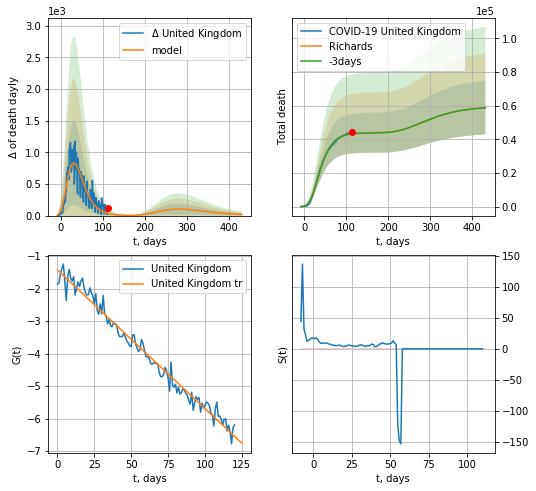

United Kingdom data at: 2020-07-08
+3 day model MAPE: 0.003414
model: Richards
coeffs: [ 4.39740216e+04  8.60489892e+00 -6.77726713e+01  5.99684188e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.271566
forecast at the end of period: +318 days
	 total death: 58844 ± 15980
trend coefficient of determination: 0.978084
 intercept: -1.423299
 slope: -0.042669


In [126]:
x = forecastRR('United Kingdom',dfGB[12:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRR('United Kingdom',dfGB[12:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


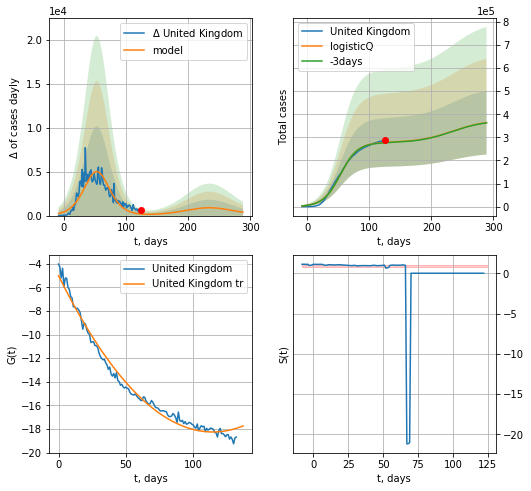

United Kingdom data at: 2020-07-08
+3 day model MAPE: 0.004825
model: logisticQ
coeffs: [ 2.77618571e+05  2.44104500e-07  5.37689889e+01 -2.96398603e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.379495
forecast at the end of period: +164 days
	 deltaDaycases: 384
	 total cases: 364110 ± 138178
	 total death: 56481 ± 64302
trend coefficient of determination: 0.985538
 intercept_: -5.01279266368269
 coeffs_: [ 0.         -0.23132038  0.0010099 ]


In [127]:
x = forecastRRR('United Kingdom',dfGB[:],d1,38*7-dT,1.,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


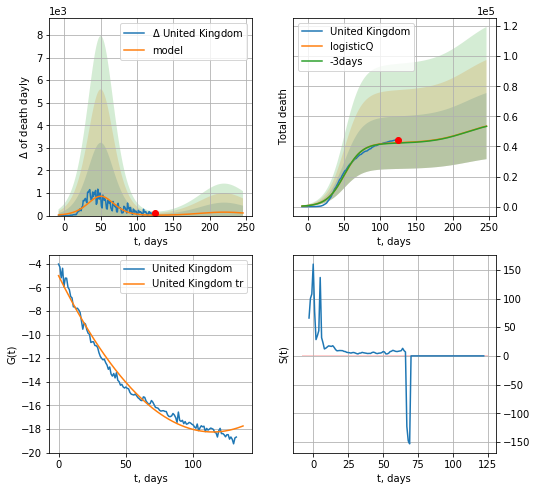

United Kingdom data at: 2020-07-08
+3 day model MAPE: 0.005768
model: logisticQ
coeffs: [ 4.22950452e+04  2.13130388e-07  5.05785811e+01 -3.80961457e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.410886
forecast at the end of period: +122 days
	 total death: 53490 ± 21978
trend coefficient of determination: 0.985538
 intercept_: -5.01279266368269
 coeffs_: [ 0.         -0.23132038  0.0010099 ]


In [128]:
x = forecastRRR('United Kingdom',dfGB[:],d1,32*7-dT,1.,addpred=True,xcoef=koreaCoeffs,cases='death')

In [129]:
#x = forecastQR('United Kingdom',dfGB[:],d1,18*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1,1])

In [130]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,2.4,1])

In [131]:
#trend3(dfDK,dfNG,dfSW[:],'DK','NG','SW',40,40,40)

In [132]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,4.,1])

In [133]:
#x = forecast('Denmark',dfDK[:15],d1,2*7-dT,1.0)
#xx = forecast2('Denmark',dfDK[:],d1,4*7-dT, x,1.0)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3('Denmark',dfDK[:],d1,14-dT, xx)

In [134]:
dT

102

DK
           date    cases  active  death
128 2020-07-04  12832.3     409  606.0
129 2020-07-05  12832.6     409  606.0
130 2020-07-06  12878.0     336  607.0
131 2020-07-07  12888.0     296  609.0
132 2020-07-08  12900.0     290  609.0


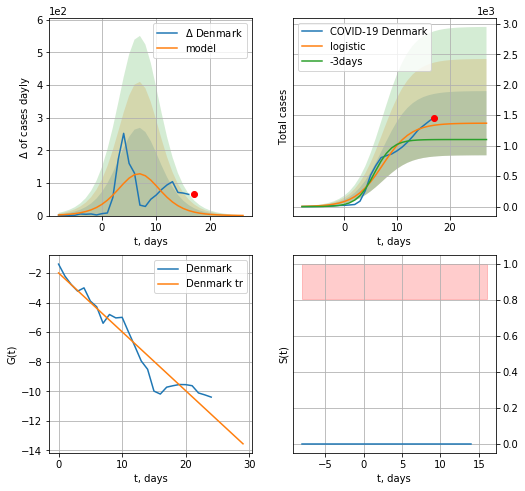

Denmark data at: 2020-07-08
+3 day model MAPE: 0.22309164372685597
model: logistic
coeffs:  [1.36966073e+03 3.75718860e-01 7.30059729e+00]
rational stdev:  0.38476605910227335
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  1368 ± 526
	 total death:  64 ± 73
trend coefficient of determination: 0.928037
 intercept: -1.984791
 slope: -0.399221


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:189: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


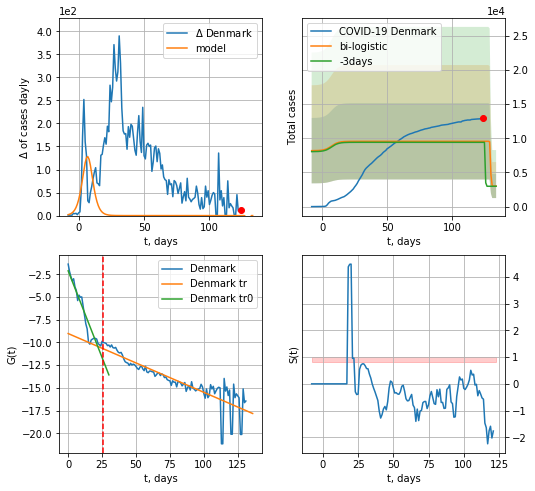

Denmark data at: 2020-07-08
+3 day model MAPE: 0.015831731557577573
model: bi-logistic
coeffs:  [ 6.54880631e+03 -5.57824251e+00  1.29801223e+02] [1.36966073e+03 3.75718860e-01 7.30059729e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.5840643445512322
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  3006 ± 1756
	 total death:  141 ± 247
bi-logistic approximation splitting point: 26
trend0 coefficient of determination: 0.914728
 intercept: -2.128126
 slope: -0.381304
trend coefficient of determination: 0.752265
 intercept: -9.023917
 slope: -0.064647


In [135]:
dfDK = read_df(pd.DataFrame(),"DK")
vL = 26
x = forecast('Denmark',dfDK[:vL],d1,7*16-dT,1.0)
xx = forecast2('Denmark',dfDK[:],d1,16*7-dT, x,1.0,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


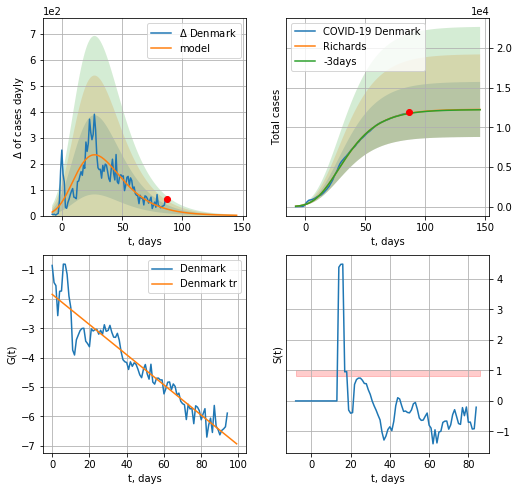

Denmark data at: 2020-07-08
+3 day model MAPE: 0.002072
model: Richards
coeffs: [ 1.22659587e+04  7.57412632e-01 -2.17374814e+01  7.08529608e-02]
rational stdev: 0.283101
forecast at the end of period: +59 days
	 deltaDaycases: 1
	 total cases: 12244 ± 3466
	 total death: 578 ± 490
trend coefficient of determination: 0.907675
 intercept: -1.842227
 slope: -0.051439


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


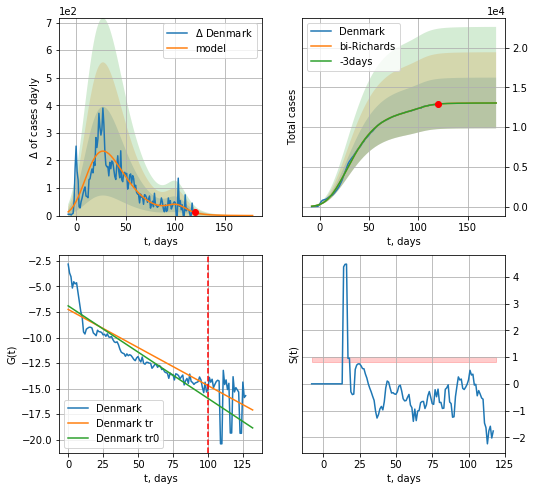

Denmark data at: 2020-07-08
+3 day model MAPE: 0.000175
model: bi-Richards
coeffs: [7.71771586e+02 1.57592325e-01 1.01266667e+02 9.20524742e-01]
rational stdev: 0.244584
forecast at the end of period: +59 days
	 deltaDaycases: 0
	 total cases: 13034 ± 3187
	 total death: 615 ± 451
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.858041
 intercept: -6.897607
 slope: -0.090531
trend coefficient of determination: 0.076717
 intercept: -7.249638
 slope: -0.074539


In [136]:
vL = 100+4
x = forecastRR('Denmark',dfDK[4:vL-4],d1,23*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Denmark',dfDK[4:],d1,23*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-4)
#x2 = forecast2R('Denmark',dfDK[:],d1,16*7-dT,x,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


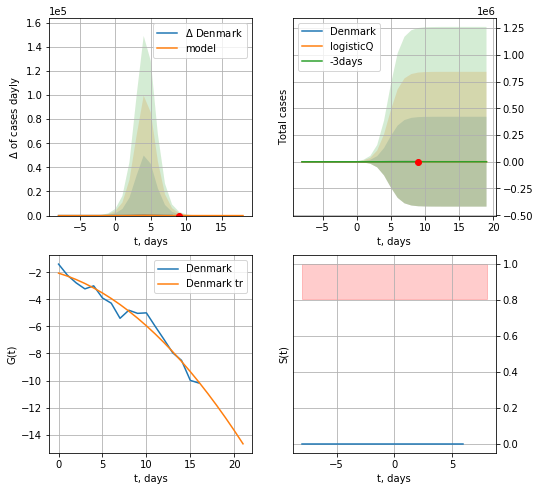

Denmark data at: 2020-07-08
+3 day model MAPE: 2.879608
model: logisticQ
coeffs: [ 8.62480490e+02  2.49401516e-04  4.73670538e+00 -4.50088701e+03]
rational stdev: 487.269302
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 862 ± 420260
	 total death: 40 ± 58472
trend coefficient of determination: 0.965266
 intercept_: -2.0557034713075613
 coeffs_: [ 0.         -0.1970759  -0.01925246]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


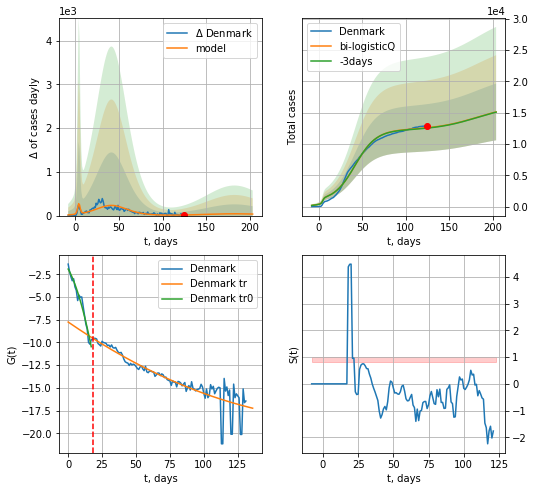

Denmark data at: 2020-07-08
+3 day model MAPE: 0.004525
model: bi-logisticQ
coeffs: [ 1.13938381e+04  1.71368016e-07  4.18915154e+01 -4.76461315e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.299378
forecast at the end of period: +80 days
	 deltaDaycases: 34
	 total cases: 15108 ± 4523
	 total death: 713 ± 640
bi-logisticQ approximation splitting point: 18
trend coefficient of determination: 0.963211
 intercept_: -1.9308894789691964
 coeffs_: [ 0.         -0.26605777 -0.01390014]
trend coefficient of determination: 0.806727
 intercept_: -7.756665387599391
 coeffs_: [ 0.         -0.10286942  0.00024397]


In [137]:
x = forecastRRR('Denmark',dfDK[:18],d1,16*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[0.35,0.5,4.5,1.])
x = forecast2RRR('Denmark',dfDK[:],d1,26*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=18)

NG
           date   cases  active  death
129 2020-07-04  8926.0     537  251.0
130 2020-07-05  8930.0     541  251.0
131 2020-07-06  8936.0     547  251.0
132 2020-07-07  8947.0     558  251.0
133 2020-07-08  8950.0     561  251.0


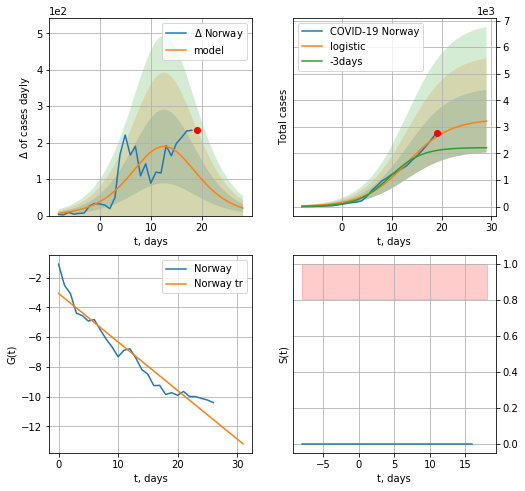

Norway data at: 2020-07-08
+3 day model MAPE: 0.2814819001616187
model: logistic
coeffs:  [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.3674391911615601
forecast at the end of period: +10 days
	 deltaDaycases:  20
	 total cases:  3216 ± 1181
	 total death:  90 ± 99
trend coefficient of determination: 0.927855
 intercept: -3.067798
 slope: -0.326083


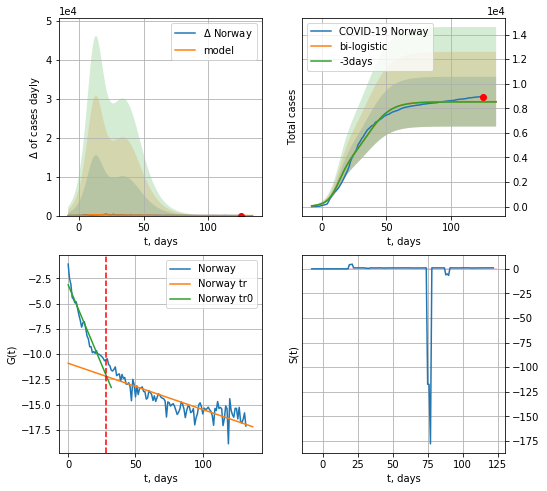

Norway data at: 2020-07-08
+3 day model MAPE: 0.002936763716147093
model: bi-logistic
coeffs:  [5.24504792e+03 1.11455877e-01 3.58384150e+01] [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.23733842323195847
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  8542 ± 2027
	 total death:  239 ± 170
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.748079
 intercept: -10.896914
 slope: -0.045755


In [138]:
dfNG = read_df(pd.DataFrame(),"NG")
vL=28
x = forecast('Norway',dfNG[:vL],d1,7*16-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,16*7-dT,x,1.0,vL=vL)
#xx = np.concatenate((x, xx), axis=0)

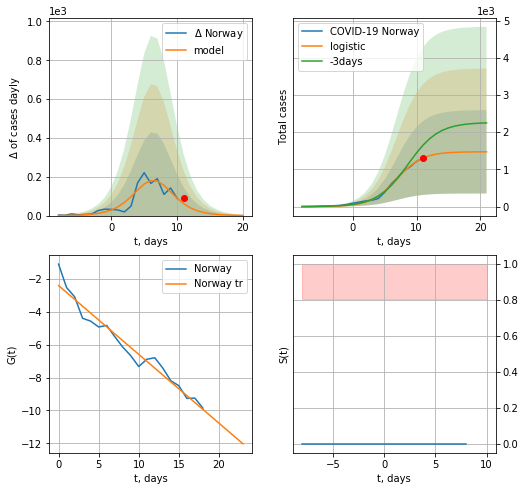

Norway data at: 2020-07-08
+3 day model MAPE: 0.247655347933597
model: logistic
coeffs:  [1.47478891e+03 4.95866797e-01 6.87524749e+00]
rational stdev:  0.7596156049961639
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  1473 ± 1119
	 total death:  41 ± 93
trend coefficient of determination: 0.956890
 intercept: -2.403448
 slope: -0.418410


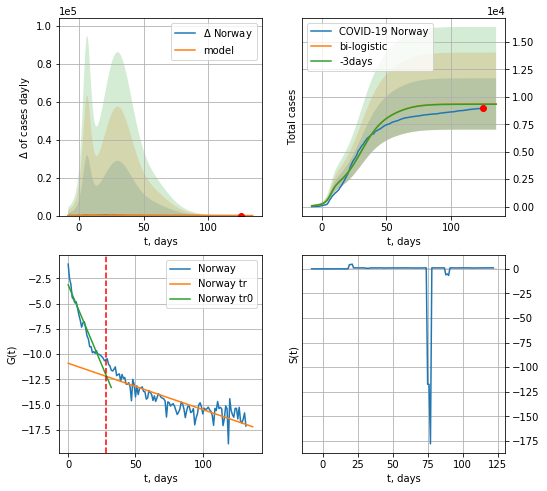

Norway data at: 2020-07-08
+3 day model MAPE: 0.003042666860249537
model: bi-logistic
coeffs:  [7.00647465e+03 1.16659515e-01 3.03318611e+01] [1.47478891e+03 4.95866797e-01 6.87524749e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.25002671660299586
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  9356 ± 2339
	 total death:  262 ± 196
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.748079
 intercept: -10.896914
 slope: -0.045755


In [139]:
vL = 28#len(dfNG)-13-dT
x = forecast('Norway',dfNG[:-12-dT],d1,7*16-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,16*7-dT,x,1.0,addpred=True,xcoef=[0.25/2,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


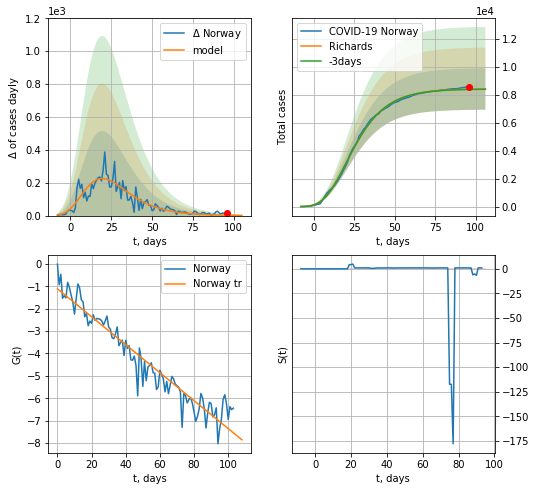

Norway data at: 2020-07-08
+3 day model MAPE: 0.002094
model: Richards
coeffs: [ 8.43838842e+03  7.14084289e+00 -4.28210769e+01  1.02282394e-02]
rational stdev: 0.175948
forecast at the end of period: +10 days
	 deltaDaycases: 1
	 total cases: 8422 ± 1481
	 total death: 236 ± 124
trend coefficient of determination: 0.922155
 intercept: -1.112087
 slope: -0.062445


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


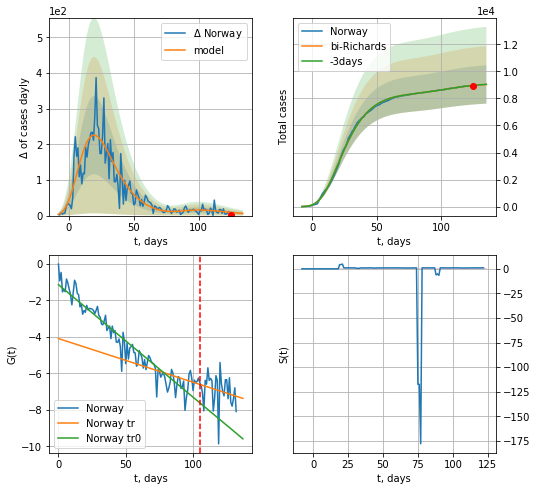

Norway data at: 2020-07-08
+3 day model MAPE: 0.000466
model: bi-Richards
coeffs: [7.08196383e+02 5.32686902e+00 1.99129898e+01 1.03037793e-02]
rational stdev: 0.157012
forecast at the end of period: +10 days
	 deltaDaycases: 5
	 total cases: 9030 ± 1417
	 total death: 253 ± 119
bi-Richards approximation splitting point: 105
trend coefficient of determination: 0.918521
 intercept: -1.137422
 slope: -0.061723
trend coefficient of determination: 0.047174
 intercept: -4.094130
 slope: -0.023952


In [140]:
vL = 105
x = forecastRR('Norway',dfNG[:vL],d1,16*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Norway',dfNG[:],d1,16*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Norway',dfNG[:],d1,8*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


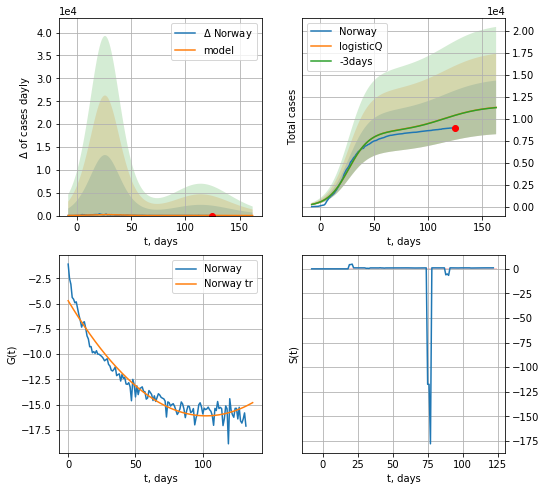

Norway data at: 2020-07-08
+3 day model MAPE: 0.001118
model: logisticQ
coeffs: [ 8.49359781e+03  2.41972284e-07  2.63249362e+01 -4.25423186e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.270475
forecast at the end of period: +38 days
	 deltaDaycases: 11
	 total cases: 11273 ± 3049
	 total death: 316 ± 256
trend coefficient of determination: 0.938176
 intercept_: -4.717494326399782
 coeffs_: [ 0.         -0.22223468  0.00108558]


In [141]:
x = forecastRRR('Norway',dfNG[:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


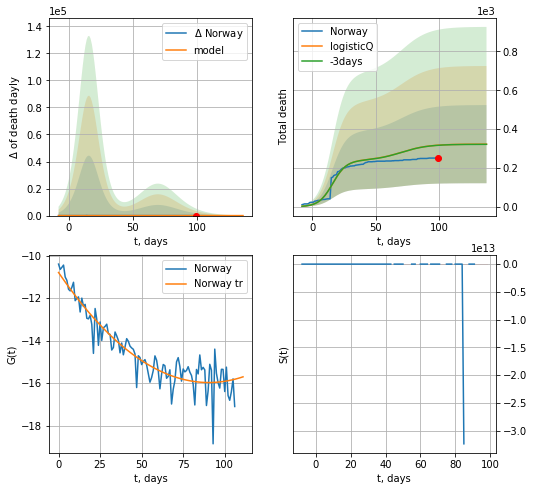

Norway data at: 2020-07-08
+3 day model MAPE: 0.002109
model: logisticQ
coeffs: [ 2.38426009e+02  1.06567077e-06  1.60696484e+01 -1.74257820e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.623800
forecast at the end of period: +38 days
	 total death: 322 ± 201
trend coefficient of determination: 0.862782
 intercept_: -10.79582472166203
 coeffs_: [ 0.         -0.11451395  0.00063331]


In [142]:
x = forecastRRR('Norway',dfNG[26:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

SW
           date    cases  active   death
130 2020-07-04  71419.3       0  5420.0
131 2020-07-05  71419.6       0  5420.0
132 2020-07-06  73061.0       0  5433.0
133 2020-07-07  73344.0       0  5447.0
134 2020-07-08  73858.0       0  5482.0


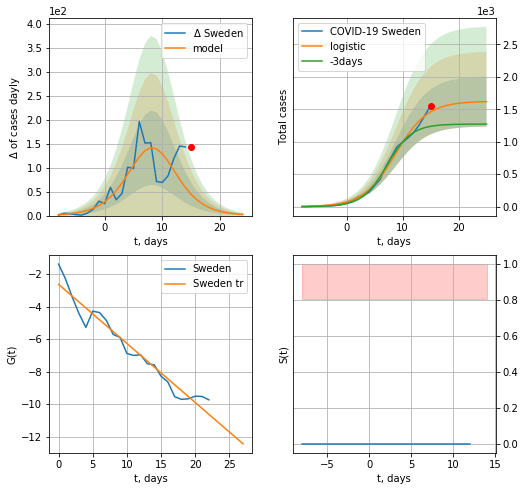

Sweden data at: 2020-07-08
+3 day model MAPE: 0.2037446768613992
model: logistic
coeffs:  [1.62331286e+03 3.49719159e-01 8.72648648e+00]
rational stdev:  0.23715803800431418
forecast at the end of period: +10 days
	 deltaDaycases:  2
	 total cases:  1617 ± 383
	 total death:  120 ± 85
trend coefficient of determination: 0.947996
 intercept: -2.632493
 slope: -0.363132


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


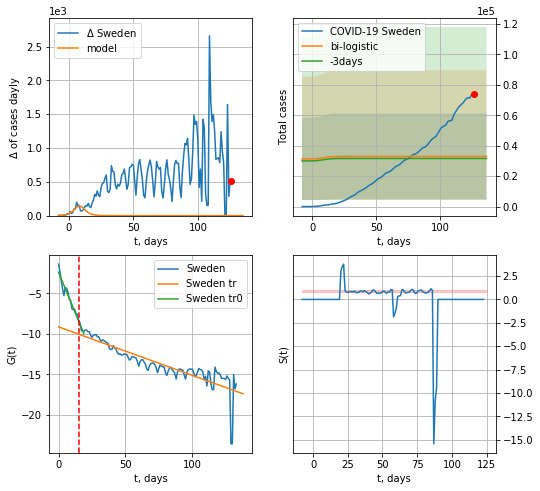

Sweden data at: 2020-07-08
+3 day model MAPE: 0.04200438157798846
model: bi-logistic
coeffs:  [ 2.50548133e+04 -9.99178289e+00  2.53497832e+02] [1.62331286e+03 3.49719159e-01 8.72648648e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.8612285772057025
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  32941 ± 28370
	 total death:  2445 ± 6317
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.908377
 intercept: -2.385275
 slope: -0.400494
trend coefficient of determination: 0.758431
 intercept: -9.129919
 slope: -0.059778


In [143]:
vL = 15#len(dfSW)-12-dT
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[:-9-dT],d1,7*16-dT,1.0)
xx = forecast2('Sweden',dfSW[:],d1,7*16-dT,x,1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

SW
           date    cases  active   death
130 2020-07-04  71419.3       0  5420.0
131 2020-07-05  71419.6       0  5420.0
132 2020-07-06  73061.0       0  5433.0
133 2020-07-07  73344.0       0  5447.0
134 2020-07-08  73858.0       0  5482.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


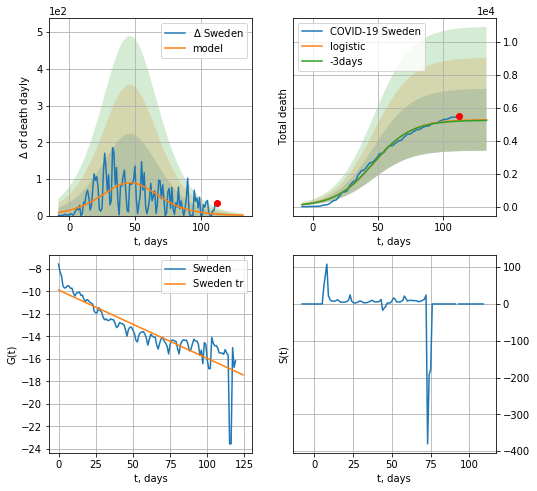

Sweden data at: 2020-07-08
+3 day model MAPE: 0.007651877189969495
model: logistic
coeffs:  [5.27786414e+03 6.80023442e-02 4.66537823e+01]
rational stdev:  0.3562209319480061
forecast at the end of period: +21 days
	 total death:  5263 ± 1874
trend coefficient of determination: 0.762794
 intercept: -9.888275
 slope: -0.060763


In [144]:
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[14:],d1,3*7,shift=1.0,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


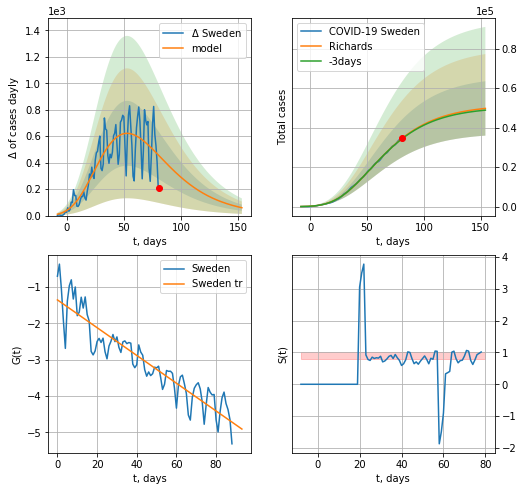

Sweden data at: 2020-07-08
+3 day model MAPE: 0.006125
model: Richards
coeffs: [ 5.15411678e+04  1.71360194e+00 -6.59040825e+01  1.93271263e-02]
rational stdev: 0.276754
forecast at the end of period: +73 days
	 deltaDaycases: 59
	 total cases: 49741 ± 13766
	 total death: 3691 ± 3064
trend coefficient of determination: 0.852284
 intercept: -1.357303
 slope: -0.038160


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


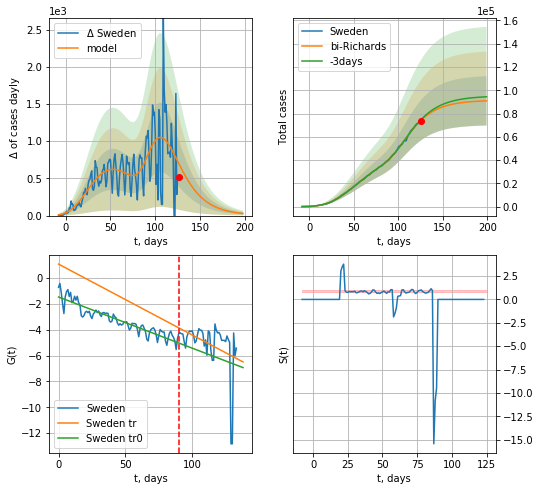

Sweden data at: 2020-07-08
+3 day model MAPE: 0.008496
model: bi-Richards
coeffs: [4.00361013e+04 1.38948543e+00 5.18619554e+01 4.05164219e-02]
rational stdev: 0.233006
forecast at the end of period: +73 days
	 deltaDaycases: 28
	 total cases: 90917 ± 21184
	 total death: 6748 ± 4716
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.860340
 intercept: -1.465753
 slope: -0.039611
trend coefficient of determination: 0.146574
 intercept: 1.080170
 slope: -0.054874


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


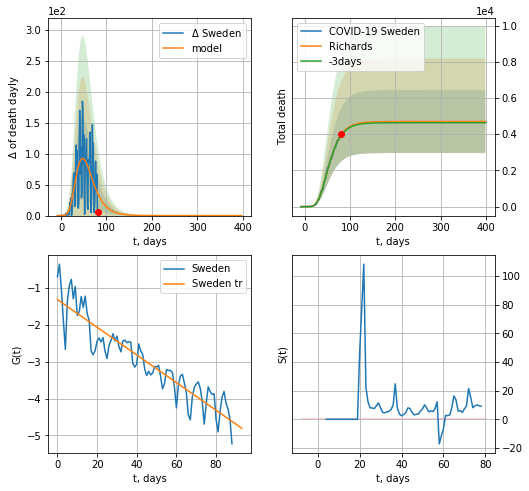

Sweden data at: 2020-07-08
+3 day model MAPE: 0.006769
model: Richards
coeffs: [ 4.70128038e+03  4.77681479e+00 -3.56595016e+01  1.12330349e-02]
rational stdev: 0.370514
forecast at the end of period: +318 days
	 total death: 4701 ± 1741
trend coefficient of determination: 0.849510
 intercept: -1.318621
 slope: -0.037513


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:209: RuntimeWarning: invalid value encountered in true_divide


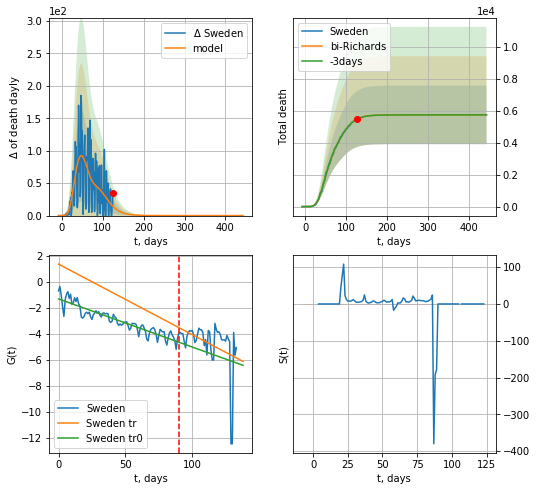

Sweden data at: 2020-07-08
+3 day model MAPE: 0.000246
model: bi-Richards
coeffs: [1.04159814e+03 6.48320324e+00 1.04397779e+01 8.40452732e-03]
rational stdev: 0.319391
forecast at the end of period: +318 days
	 total death: 5742 ± 1834
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.850626
 intercept: -1.311305
 slope: -0.037075
trend coefficient of determination: 0.143966
 intercept: 1.366891
 slope: -0.054310


In [145]:
vL = 90
x = forecastRR('Sweden',dfSW[:vL],d1,25*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Sweden',dfSW[:],d1,25*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRR('Sweden',dfSW[:vL],d1,60*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death')
xx = forecast2RR('Sweden',dfSW[:],d1,60*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death',vL=vL)
#x = forecastQR('Sweden',dfSW[:],d1,16*7-dT,1.0)
#xx = forecast2R('Sweden',dfSW[:],d1,12*7-dT,x,1.0)#,addpred=True,xcoef=[0.25,1.,2.3,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


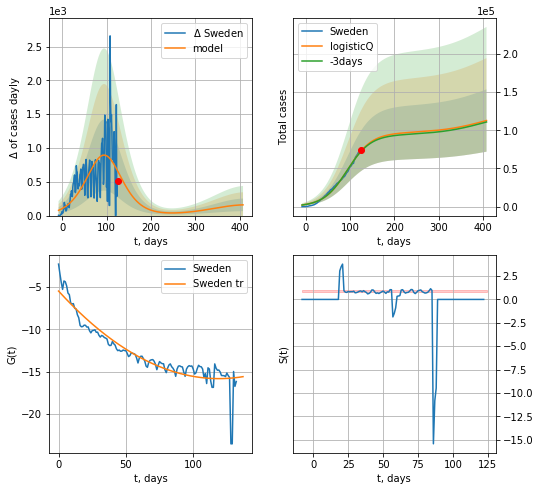

Sweden data at: 2020-07-08
+3 day model MAPE: 0.009477
model: logisticQ
coeffs: [ 9.64636907e+04  2.45515913e-07  9.48045861e+01 -1.50721840e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.362424
forecast at the end of period: +283 days
	 deltaDaycases: 158
	 total cases: 112716 ± 40851
	 total death: 8366 ± 9096
trend coefficient of determination: 0.860812
 intercept_: -5.471578553841927
 coeffs_: [ 0.         -0.17410356  0.00073085]


In [146]:
x = forecastRRR('Sweden',dfSW[1:],d1,55*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


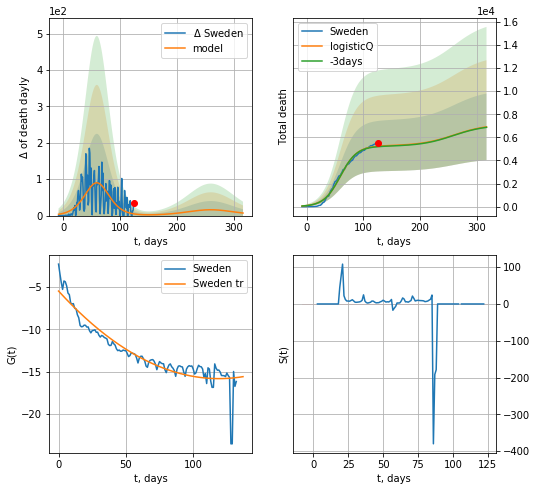

Sweden data at: 2020-07-08
+3 day model MAPE: 0.007747
model: logisticQ
coeffs: [ 5.27089533e+03  2.10261082e-07  5.96078112e+01 -3.25320747e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.417881
forecast at the end of period: +192 days
	 total death: 6908 ± 2887
trend coefficient of determination: 0.860812
 intercept_: -5.471578553841927
 coeffs_: [ 0.         -0.17410356  0.00073085]


In [147]:
x = forecastRRR('Sweden',dfSW[1:],d1,42*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')

CN
           date    cases  active   death
164 2020-07-04  83553.0     403  4634.0
165 2020-07-05  83557.0     405  4634.0
166 2020-07-06  83565.0     403  4634.0
167 2020-07-07  83572.0     390  4634.0
168 2020-07-08  83581.0     357  4634.0


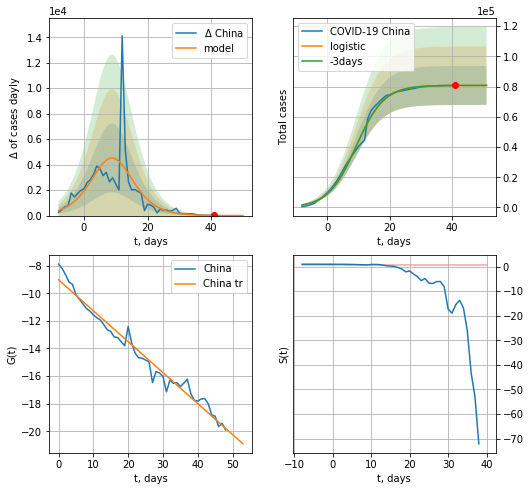

China data at: 2020-07-08
+3 day model MAPE: 0.00012785692335583266
model: logistic
coeffs:  [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.15971316009002232
forecast at the end of period: +10 days
	 deltaDaycases:  1
	 total cases:  80803 ± 12905
	 total death:  4479 ± 2146
trend coefficient of determination: 0.972183
 intercept: -9.021396
 slope: -0.224243


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


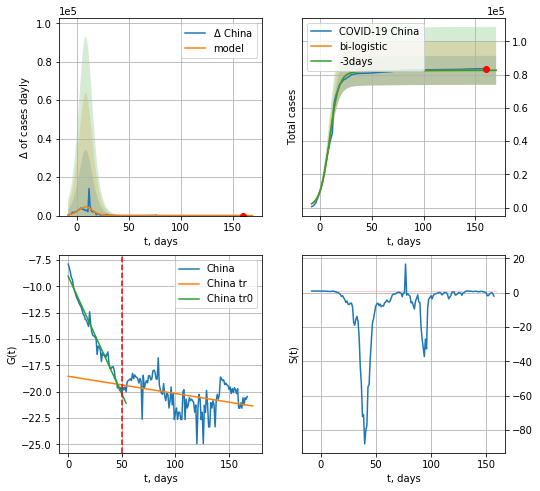

China data at: 2020-07-08
+3 day model MAPE: 0.0003616682529653054
model: bi-logistic
coeffs:  [1.82681079e+03 2.51517285e-02 1.20517059e+01] [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.10545445733918077
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  82603 ± 8710
	 total death:  4579 ± 1448
bi-logistic approximation splitting point: 50
trend0 coefficient of determination: 0.973282
 intercept: -9.036652
 slope: -0.223289
trend coefficient of determination: 0.145365
 intercept: -18.538928
 slope: -0.016417


In [148]:
dfCN = read_df(pd.DataFrame(),"CN")
try:
    x = forecast('China',dfCN[:50],d1,7*16-dT,1.0)
    #xx = forecast('China',dfCN[21:-32],d1,17)
    #xx = np.concatenate((x, xx), axis=0)
    xx = forecast2('China',dfCN[:],d1,16*7-dT,x,1.0,vL=50)
except:
    print ("Exception occurs")

In [149]:
#dfTT[dfTT.Country=='%s'%('China')][0].values[0]

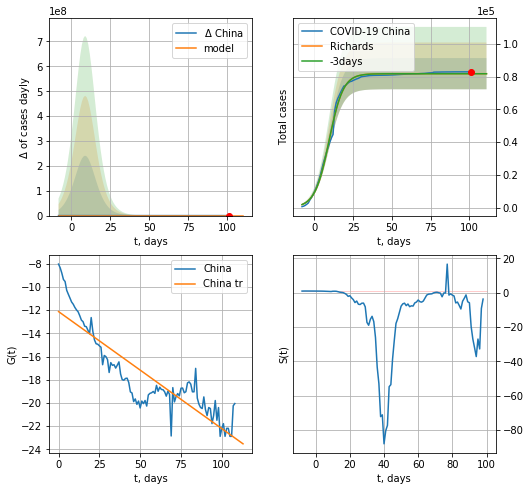

China data at: 2020-07-08
+3 day model MAPE: 0.000627
model: Richards
coeffs: [8.17736185e+04 2.15574478e-01 9.59539597e+00 1.02116157e+00]
rational stdev: 0.116457
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 81773 ± 9523
	 total death: 4533 ± 1583
trend coefficient of determination: 0.785239
 intercept: -12.125053
 slope: -0.100960


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


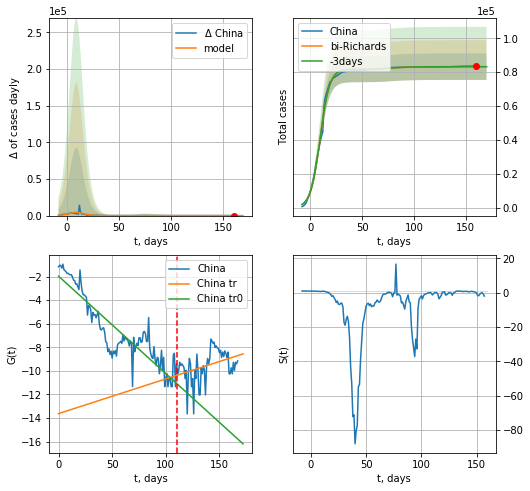

China data at: 2020-07-08
+3 day model MAPE: 0.000487
model: bi-Richards
coeffs: [1.45555670e+03 5.52028501e+01 2.34361032e-01 1.54307424e-03]
rational stdev: 0.094061
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 83228 ± 7828
	 total death: 4614 ± 1301
bi-Richards approximation splitting point: 110
trend coefficient of determination: 0.821006
 intercept: -1.968923
 slope: -0.082659
trend coefficient of determination: 0.138465
 intercept: -13.625191
 slope: 0.029441


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power


In [150]:
vL = 110
x = forecastRR('China',dfCN[:vL],d1,16*7-dT,1.0)
xx = forecast2RR('China',dfCN[:],d1,16*7-dT,x,1.0,vL=vL)
#x = forecastQR('China',dfCN[:],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
#xx = forecast2R('China',dfCN[:],d1,6*7-dT,x,1.0)

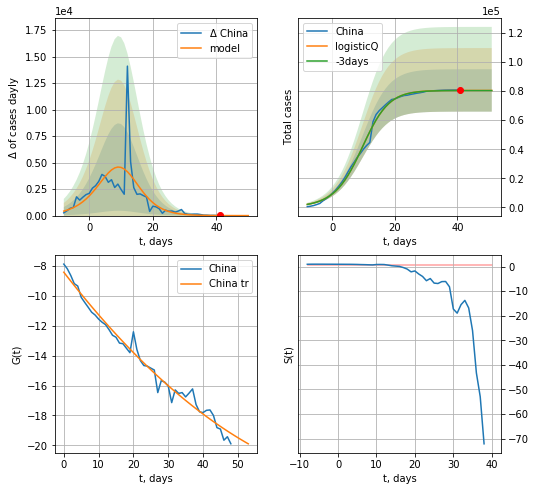

China data at: 2020-07-08
+3 day model MAPE: 0.001323
model: logisticQ
coeffs: [ 8.04175259e+04  1.07650457e-03  9.35257488e+00 -2.02425652e+02]
rational stdev: 0.181019
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 80416 ± 14556
	 total death: 4458 ± 2420
trend coefficient of determination: 0.979964
 intercept_: -8.428864441790822
 coeffs_: [ 0.         -0.29994819  0.00157784]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


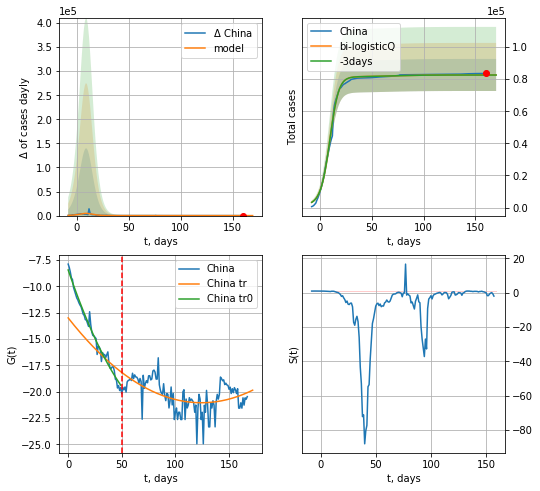

China data at: 2020-07-08
+3 day model MAPE: 0.000400
model: bi-logisticQ
coeffs: [ 2.22986290e+03  3.91304757e-04  2.47790350e+01 -4.32455345e-02]
rational stdev: 0.120873
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 82647 ± 9989
	 total death: 4582 ± 1661
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.980847
 intercept_: -8.442415731989867
 coeffs_: [ 0.         -0.29762768  0.00151769]
trend coefficient of determination: 0.282018
 intercept_: -12.996449481150133
 coeffs_: [ 0.         -0.12975379  0.00052229]


In [151]:
x = forecastRRR('China',dfCN[:50],d1,7*16-dT,1.0)
xx=forecast2RRR('China',dfCN[:],d1,16*7-dT,x,1.0,vL=50)

In [152]:
#x = forecastQR('China',dfCN[50:],d1,6*7-dT,1.0)

KR
           date  cases  active  death
140 2020-07-04  13091   976.0  283.0
141 2020-07-05  13137  1005.0  284.0
142 2020-07-06  13181   982.0  285.0
143 2020-07-07  13244   989.0  285.0
144 2020-07-08  13293   987.0  287.0


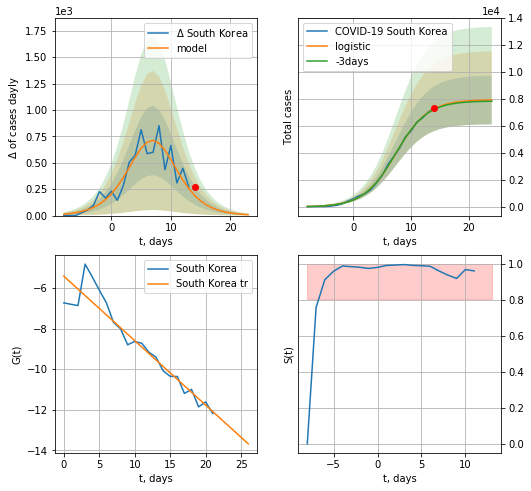

South Korea data at: 2020-07-08
model: logistic
coeffs:  [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.2275932520547523
forecast at the end of period: +10 days
	 deltaDaycases:  8
	 total cases:  7921 ± 1802
	 total death:  171 ± 116
trend coefficient of determination: 0.904554
 intercept: -5.419235
 slope: -0.317547


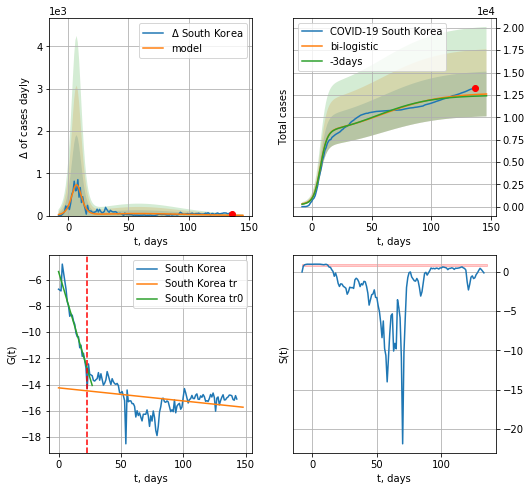

South Korea data at: 2020-07-08
+3 day model MAPE: 0.014467405830100602
model: bi-logistic
coeffs:  [4.79653525e+03 4.05560887e-02 5.89019921e+01] [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.19821876773768254
forecast at the end of period: +10 days
	 deltaDaycases:  5
	 total cases:  12601 ± 2497
	 total death:  272 ± 161
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.916463
 intercept: -5.394262
 slope: -0.321115
trend coefficient of determination: 0.110130
 intercept: -14.246743
 slope: -0.009957


In [153]:
dfKR = read_df(pd.DataFrame(),"KR")
x = forecast('South Korea',dfKR[:23],d1,7*16-dT,1.0,pMAPE=False)
xx=forecast2('South Korea',dfKR[:],d1,16*7-dT,x,1.0,vL=23)

In [154]:
#vL = 30
#x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
#x1 = forecastRRR('South Korea',dfKR[39:],d1,12*7-dT,1.0)
#xx = np.concatenate((x, x1), axis=0)
#xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

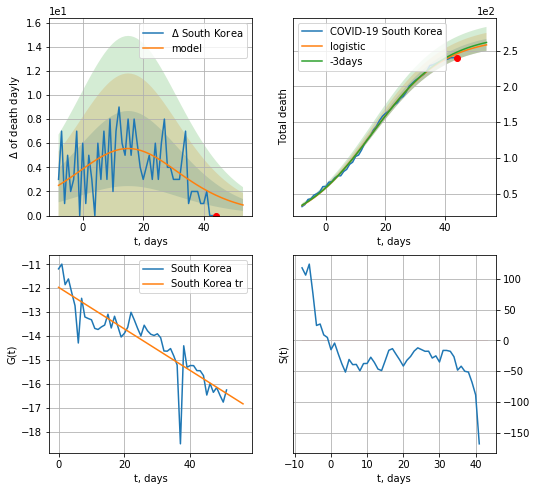

South Korea data at: 2020-07-08
model: logistic
coeffs:  [2.68513907e+02 8.28168908e-02 1.55065021e+01]
rational stdev:  0.03241893689547546
forecast at the end of period: +10 days
	 total death:  257 ± 8
trend coefficient of determination: 0.782213
 intercept: -11.965009
 slope: -0.087016


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:245: RuntimeWarning: divide by zero encountered in true_divide


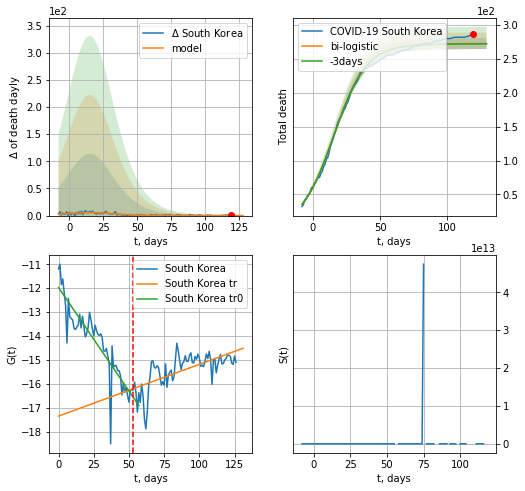

South Korea data at: 2020-07-08
+3 day model MAPE: 0.0018456980132403008
model: bi-logistic
coeffs:  [ 4.53633573  0.02287514 10.15489986] [2.68513907e+02 8.28168908e-02 1.55065021e+01]
rational stdev:  0.029910353836802343
forecast at the end of period: +10 days
	 deltaDaydeath:  0
	 total death:  272 ± 8
bi-logistic approximation splitting point: 53
trend0 coefficient of determination: 0.789613
 intercept: -11.973248
 slope: -0.086531
trend coefficient of determination: 0.437150
 intercept: -17.351373
 slope: 0.021651


In [155]:
x = forecast('South Korea',dfKR[17:70],d1,16*7-dT,1.0,cases='death',pMAPE=False)
xx=forecast2('South Korea',dfKR[17:],d1,16*7-dT,x,1.0,vL=70-17,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


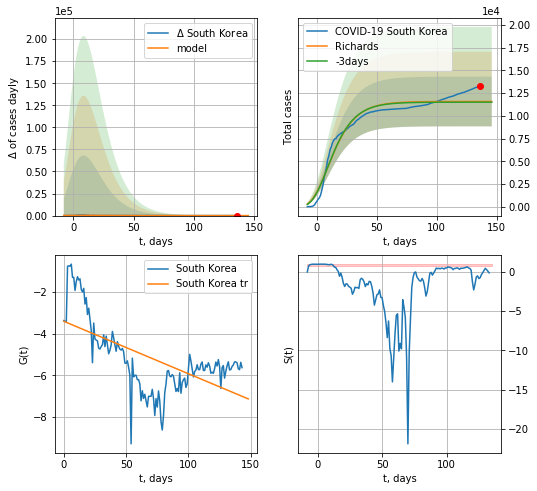

South Korea data at: 2020-07-08
+3 day model MAPE: 0.006658
model: Richards
coeffs: [ 1.15888089e+04  2.61706292e+01 -6.68224229e+01  2.94355788e-03]
rational stdev: 0.235832
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 11588 ± 2732
	 total death: 250 ± 176
trend coefficient of determination: 0.377334
 intercept: -3.411070
 slope: -0.025127


In [156]:
x = forecastRR('South Korea',dfKR[:],d1,16*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


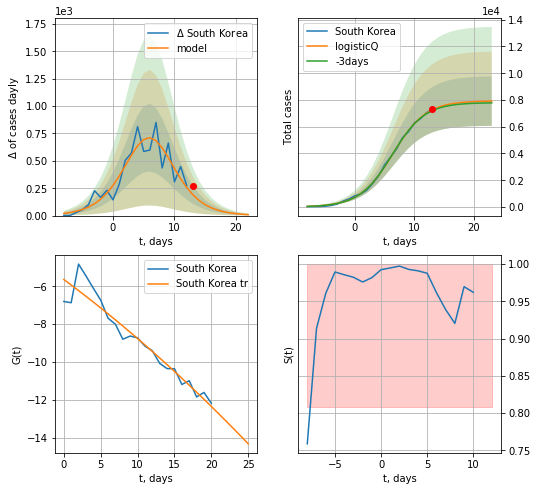

South Korea data at: 2020-07-08
+3 day model MAPE: 0.011158
model: logisticQ
coeffs: [ 7.93644801e+03  5.70813767e-05  6.37140978e+00 -6.30171017e+03]
rational stdev: 0.233522
forecast at the end of period: +10 days
	 deltaDaycases: 8
	 total cases: 7916 ± 1848
	 total death: 170 ± 119
trend coefficient of determination: 0.923340
 intercept_: -5.639271391154587
 coeffs_: [ 0.         -0.28882126 -0.00235709]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:333: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


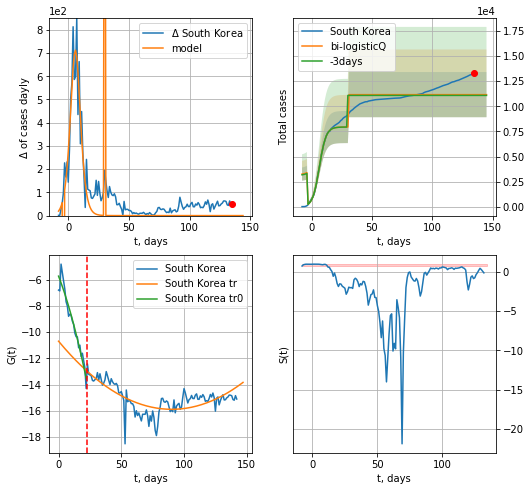

South Korea data at: 2020-07-08
+3 day model MAPE: 0.006913
model: bi-logisticQ
coeffs: [3217.92327183   12.0008775    30.07653278   -3.79972241]
rational stdev: 0.201119
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 11154 ± 2243
	 total death: 240 ± 144
bi-logisticQ approximation splitting point: 23
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]
trend coefficient of determination: 0.529898
 intercept_: -10.695447646247448
 coeffs_: [ 0.         -0.11492305  0.00063663]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [157]:
vL=23
x = forecastRRR('South Korea',dfKR[1:vL],d1,16*7-dT,1.0)
xx=forecast2RRR('South Korea',dfKR[1:],d1,16*7-dT,x,1.0,vL=vL)

In [158]:
#x = forecastRR('South Korea',dfKR[68:],d1,10*7-dT,1.0)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


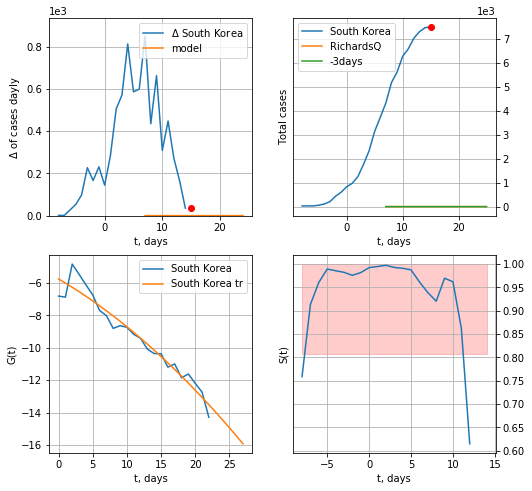

South Korea data at: 2020-07-08
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 8.55287099e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +10 days
	 deltaDaycases: 0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [159]:
vL=25
x = forecastQR('South Korea',dfKR[1:vL],d1,16*7-dT,1.0)
xx=forecast2QR('South Korea',dfKR[1:],d1,16*7-dT,x,1.0,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


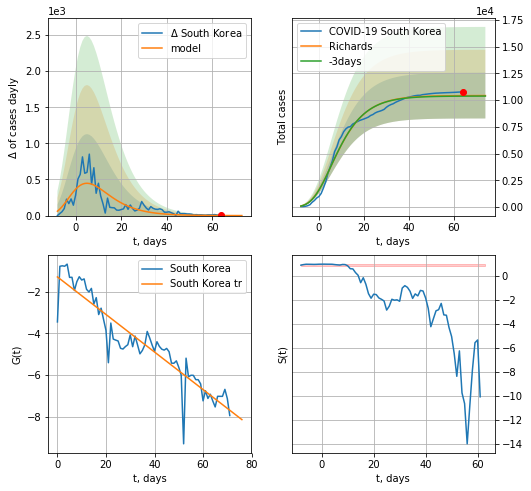

South Korea data at: 2020-07-08
+3 day model MAPE: 0.004451
model: Richards
coeffs: [ 1.04318163e+04  3.06447185e+01 -4.21690973e+01  3.81700530e-03]
rational stdev: 0.205493
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 10428 ± 2142
	 total death: 225 ± 138
trend coefficient of determination: 0.863609
 intercept: -1.289365
 slope: -0.090003


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


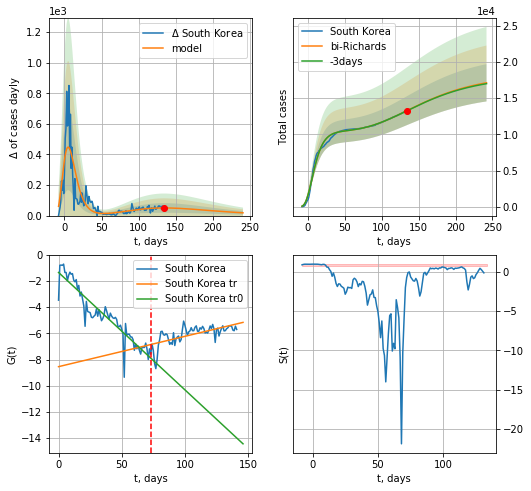

South Korea data at: 2020-07-08
+3 day model MAPE: 0.000946
model: bi-Richards
coeffs: [ 7.80958009e+03  1.60133541e+00 -1.23143546e+02  1.09244645e-02]
rational stdev: 0.150163
forecast at the end of period: +108 days
	 deltaDaycases: 18
	 total cases: 17127 ± 2571
	 total death: 369 ± 166
bi-Richards approximation splitting point: 73
trend coefficient of determination: 0.865911
 intercept: -1.357103
 slope: -0.089578
trend coefficient of determination: 0.439082
 intercept: -8.546373
 slope: 0.023145


In [160]:
vL = 2
vL1 = 75
x = forecastRR('South Korea',dfKR[vL:vL1],d1,16*7-dT,1.0)
xx=forecast2RR('South Korea',dfKR[vL:],d1,30*7-dT,x,1.0,vL=vL1-vL)
#xx = np.concatenate((x, xx), axis=0)
#print (xx)
#xxx=forecast3RR('South Korea',dfKR[1:],d1,12*7-dT,xx,1.0,vL=[vL,vL1],zoom=1e3)

In [161]:
a = np.array([ 7.90607495e+03,  3.14377481e-03, -1.32150046e+02,  5.22462480e+00, 7.59593205e-01])
b = np.array([ 2.91876181e+03,  1.43325056e-01, -3.99886263e+01, -3.39427361e+02, 1.77367535e-03])
QRkoreaCoeffs=b/a
QRkoreaCoeffs,RkoreaCoeffs,koreaCoeffs

(array([ 3.69179628e-01,  4.55901153e+01,  3.02600169e-01, -6.49668395e+01,
         2.33503320e-03]),
 [0.36242246, 2.56241634, 1.84890887, 0.13324732],
 [0.35416971, 0.02606324, 4.35859408, 19.30413219])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


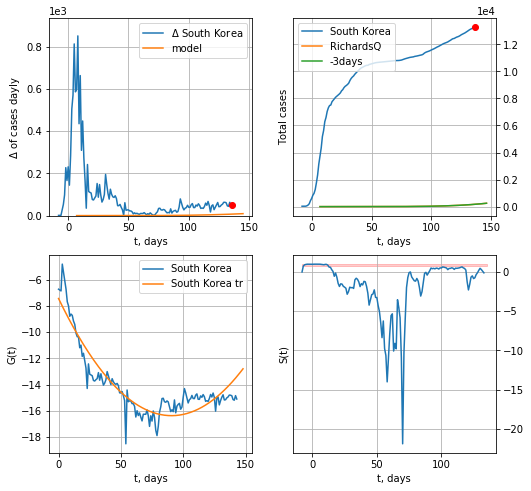

South Korea data at: 2020-07-08
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 8.55287099e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +10 days
	 deltaDaycases: 9


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [162]:
x = forecastQR('South Korea',dfKR[:],d1,16*7-dT,1.0)

SG
           date    cases  active  death
163 2020-07-04  44664.0    4521   26.0
164 2020-07-05  44983.0    4516   26.0
165 2020-07-06  45140.0    4397   26.0
166 2020-07-07  45298.0    4270   26.0
167 2020-07-08  45298.0    3949   26.0


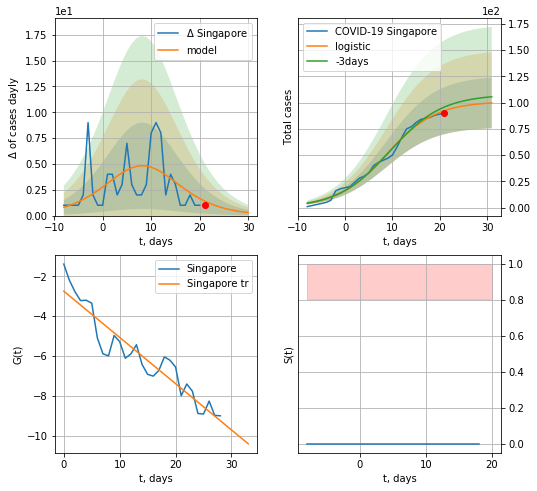

Singapore data at: 2020-07-08
+3 day model MAPE: 0.03963437966370839
model: logistic
coeffs:  [101.02990869   0.19128696   8.67555654]
rational stdev:  0.24212715882466435
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  99 ± 24
	 total death:  0 ± 0
trend coefficient of determination: 0.887345
 intercept: -2.744831
 slope: -0.232145


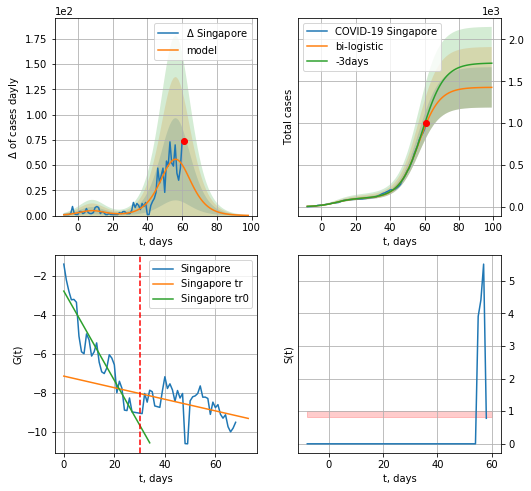

Singapore data at: 2020-07-08
+3 day model MAPE: 0.06119828055586902
model: bi-logistic
coeffs:  [1.32695355e+03 1.68329223e-01 5.66911530e+01] [101.02990869   0.19128696   8.67555654]
rational stdev:  0.16894112354758975
forecast at the end of period: +38 days
	 deltaDaycases:  0
	 total cases:  1426 ± 241
	 total death:  0 ± 0
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend coefficient of determination: 0.177815
 intercept: -7.138791
 slope: -0.029776
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


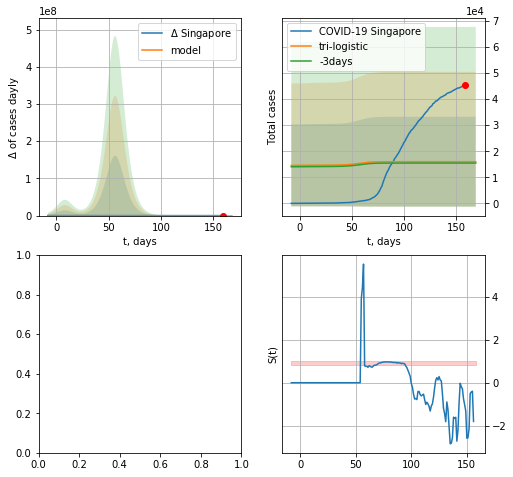

In [163]:
vL = 30
vL1 = 70
try:
    dfSG = read_df(pd.DataFrame(),"SG")
    x = forecast('Singapore',dfSG[:vL],d1,7*16-dT,1.0)
    xx = forecast2('Singapore',dfSG[:vL1],d1,20*7-dT,x,1.0,vL=vL)
    xx = np.concatenate((x, xx), axis=0)
    xxx = forecast3("Singapore",dfSG,d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


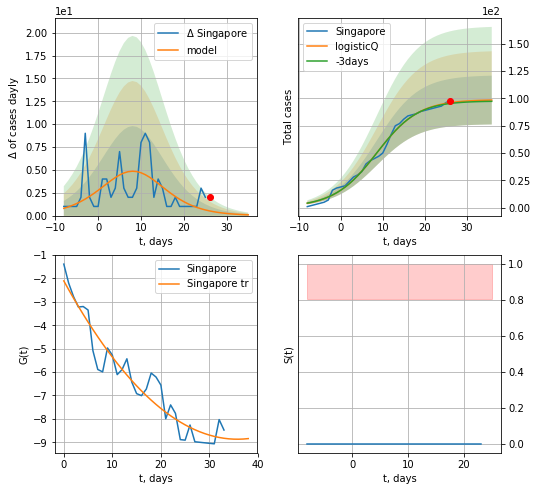

Singapore data at: 2020-07-08
+3 day model MAPE: 0.008158
model: logisticQ
coeffs: [ 9.88556757e+01  2.70682558e-04  8.43151542e+00 -7.17677228e+02]
rational stdev: 0.226599
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 98 ± 22
	 total death: 0 ± 0
trend coefficient of determination: 0.918167
 intercept_: -2.103369555726971
 coeffs_: [ 0.         -0.37832792  0.00528917]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:571: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

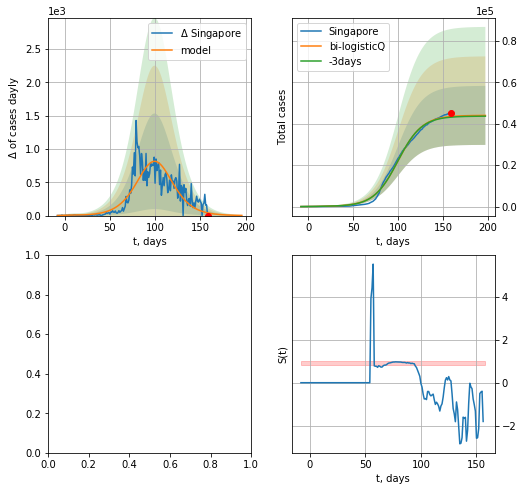

In [164]:
vL = 35
x = forecastRRR('Singapore',dfSG[:vL],d1,7*16-dT,1.0)
xx = forecast2RRR('Singapore',dfSG[:],d1,20*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

In [ ]:
#vL = 31
#x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
#xx = forecast2('Singapore',dfSG[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

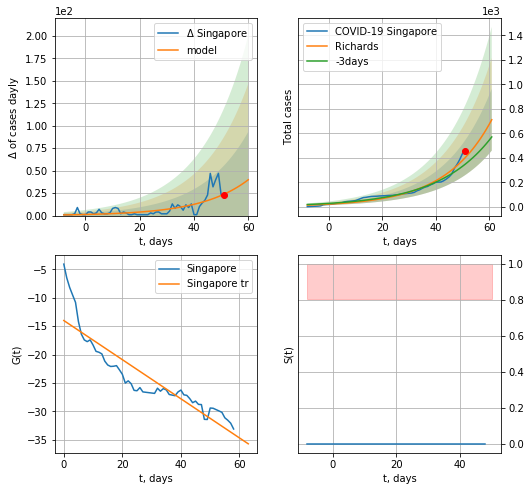

Singapore data at: 2020-07-08
+3 day model MAPE: 0.162175
model: Richards
coeffs: [9.30440928e+03 5.77261259e-02 1.05546035e+02 4.91744477e+00]
rational stdev: 0.355378
forecast at the end of period: +10 days
	 deltaDaycases: 39
	 total cases: 711 ± 252
	 total death: 0 ± 0
trend coefficient of determination: 0.813965
 intercept: -14.017324
 slope: -0.343928


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:647: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

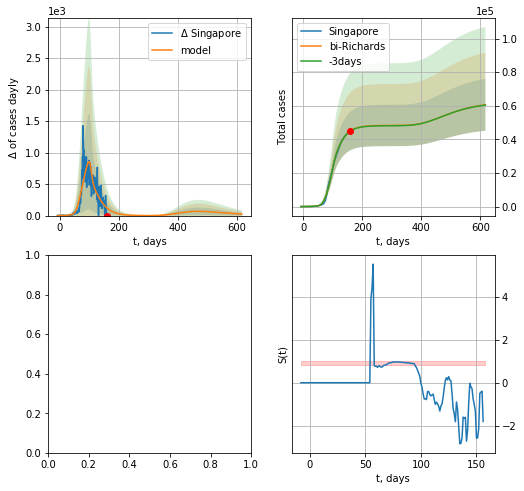

In [165]:
vL = 60
x = forecastRR('Singapore',dfSG[:vL],d1,16*7-dT,1.0)
x = forecast2RR('Singapore',dfSG[:],d1,80*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
#xx = forecast2R('Singapore',dfSG[:],d1,28*7-dT,x,1.0)
x = forecastQR('Singapore',dfSG[60:],d1,16*7-dT,1.0)

ES
           date   cases  active  death
114 2020-07-04  1993.0      54   69.0
115 2020-07-05  1994.0      50   69.0
116 2020-07-06  1995.0      46   69.0
117 2020-07-07  2003.0      52   69.0
118 2020-07-08  2003.0      52   69.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


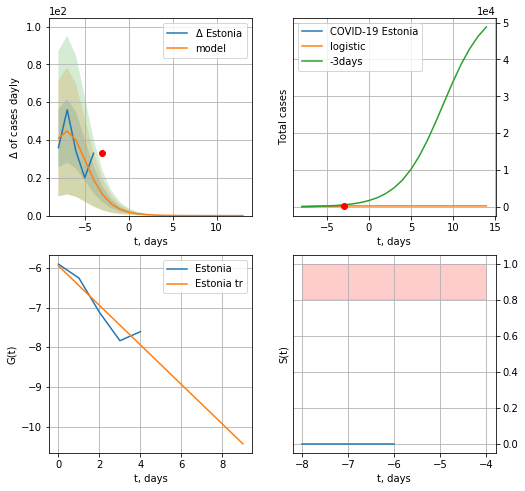

Estonia data at: 2020-07-08
+3 day model MAPE: 0.6707560476295664
model: logistic
coeffs:  [277.64023436   0.65084323  -6.57074778]
rational stdev:  0.028784635346108894
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  277 ± 7
	 total death:  9 ± 0
trend coefficient of determination: 0.881874
 intercept: -5.949047
 slope: -0.498463
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


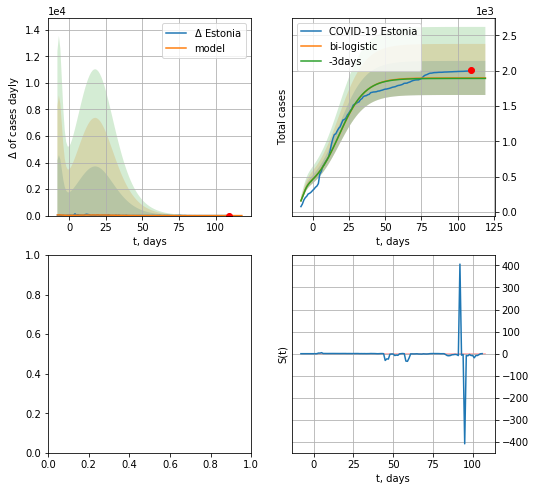

In [166]:
shift = 1.0
try:
    dfES = read_df(pd.DataFrame(),"ES")
    x = forecast('Estonia',dfES[1:7],d1,17,1.)
    xx = forecast2('Estonia',dfES[1:],d1,16*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.5],vL=7)
except:
    print ("Exception occurs")

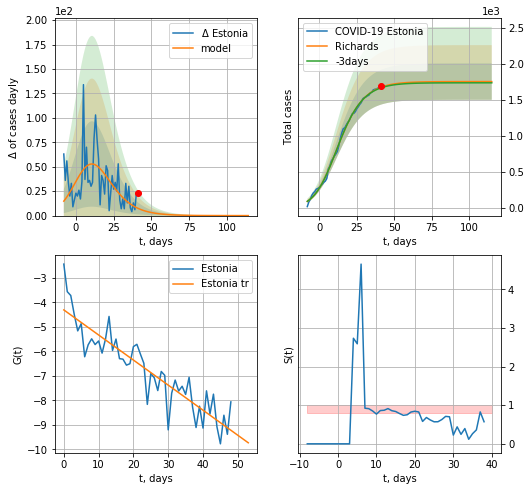

Estonia data at: 2020-07-07
+3 day model MAPE: 0.005500
model: Richards
coeffs: [1.74994618e+03 2.01777902e-01 4.40550518e+00 5.06367091e-01]
rational stdev: 0.144467
forecast at the end of period: +74 days
	 deltaDaycases: 0
	 total cases: 1749 ± 252
	 total death: 60 ± 26
trend coefficient of determination: 0.813896
 intercept: -4.307388
 slope: -0.102288


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


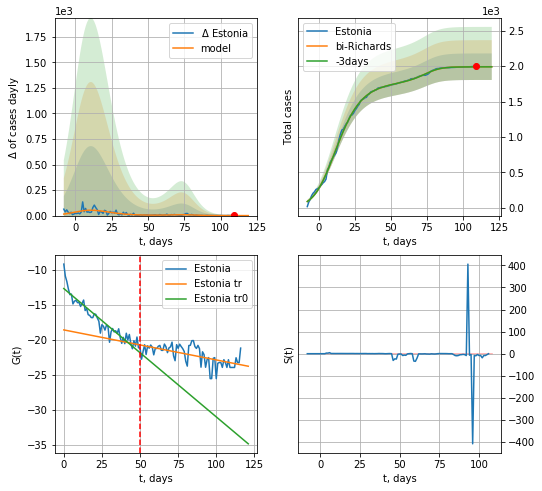

Estonia data at: 2020-07-07
+3 day model MAPE: 0.001000
model: bi-Richards
coeffs: [2.41458928e+02 9.43335676e-02 7.74171831e+01 2.06076903e+00]
rational stdev: 0.094058
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 1991 ± 187
	 total death: 68 ± 19
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.887453
 intercept: -12.707554
 slope: -0.182694
trend coefficient of determination: 0.370478
 intercept: -18.596020
 slope: -0.042749


In [382]:
vL=50
x = forecastRR('Estonia',dfES[:vL],d1,7*25-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
#x = forecastQR('Estonia',dfES[10:],d1,7*10-dT,1.)
xx = forecast2RR('Estonia',dfES[:],d1,7*16-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


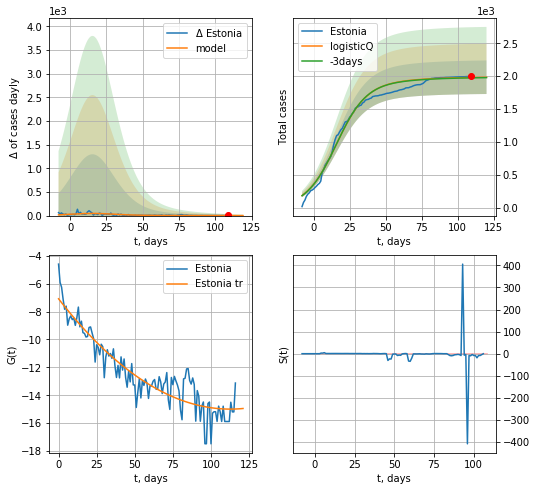

Estonia data at: 2020-07-07
+3 day model MAPE: 0.003010
model: logisticQ
coeffs: [ 1.90529740e+03  1.68354748e-07  1.57741239e+01 -5.62241457e+05]
S.Korea scenario coeffs: [0.04375, 0.5, 4.0, 1]
rational stdev: 0.128616
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 1983 ± 255
	 total death: 68 ± 26
trend coefficient of determination: 0.851850
 intercept_: -7.082929635234729
 coeffs_: [ 0.         -0.14050418  0.00062371]


In [383]:
x = forecastRRR('Estonia',dfES[:],d1,7*16-dT,1.,addpred=True,xcoef=[0.35/8,.5,4.,1])

LV
           date   cases  active  death
119 2020-07-04  1123.0      93   30.0
120 2020-07-05  1127.0      97   30.0
121 2020-07-06  1134.0      96   30.0
122 2020-07-07  1141.0     103   30.0
123 2020-07-08  1141.0     103   30.0


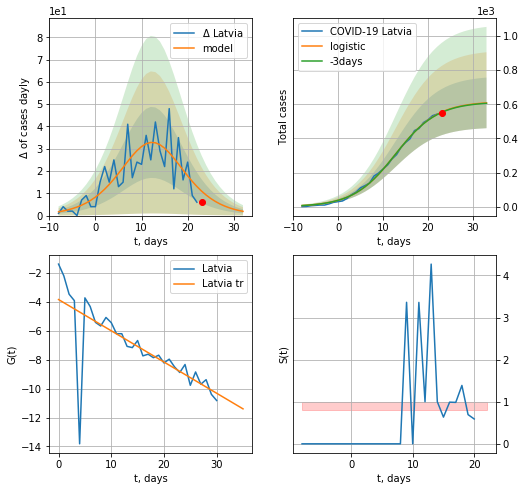

Latvia data at: 2020-07-08
+3 day model MAPE: 0.0032633377916749073
model: logistic
coeffs:  [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.24373797630646024
forecast at the end of period: +10 days
	 deltaDaycases:  1
	 total cases:  607 ± 148
	 total death:  15 ± 10
trend coefficient of determination: 0.538666
 intercept: -3.837099
 slope: -0.216023
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


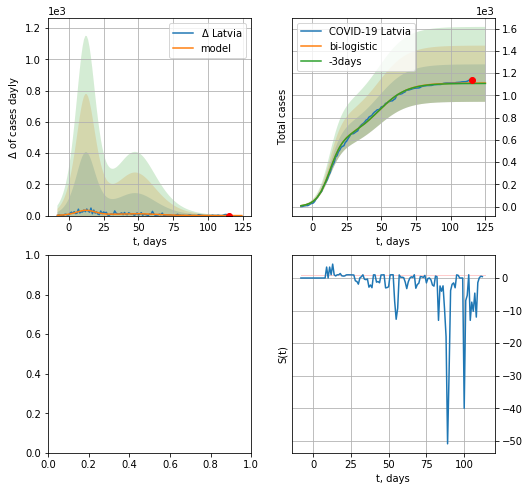

In [167]:
vL=32
dfLV = read_df(pd.DataFrame(),"LV")
try:
    x = forecast('Latvia',dfLV[:vL],d1,16*7-dT,1.)
    xx=forecast2('Latvia',dfLV[:],d1,16*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.],vL=vL)
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


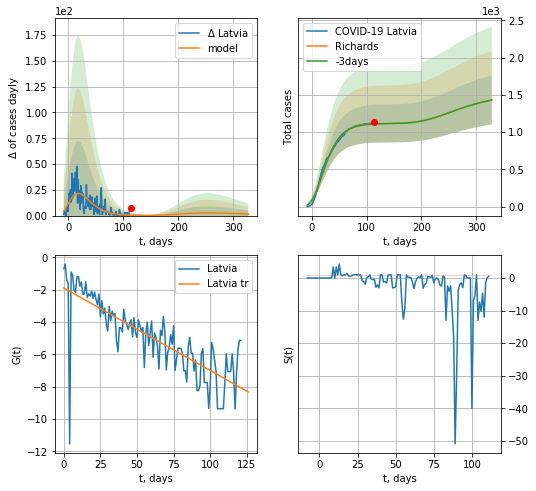

Latvia data at: 2020-07-07
+3 day model MAPE: 0.002079
model: Richards
coeffs: [ 1.11854783e+03  9.15092395e+00 -8.00512286e+01  5.72648112e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.228389
forecast at the end of period: +214 days
	 deltaDaycases: 1
	 total cases: 1430 ± 326
	 total death: 37 ± 25
trend coefficient of determination: 0.637448
 intercept: -1.890555
 slope: -0.051006


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


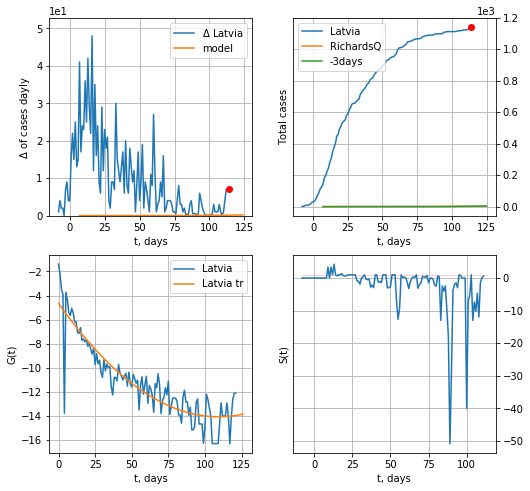

Latvia data at: 2020-07-07
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 3.14660905e+02  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +11 days
	 deltaDaycases: 0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [388]:
x = forecastRR('Latvia',dfLV[:],d1,7*45-dT,1.,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Latvia',dfLV[:],d1,7*16-dT,1.)
#xx=forecast2R('Latvia',dfLV[:],d1,10*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


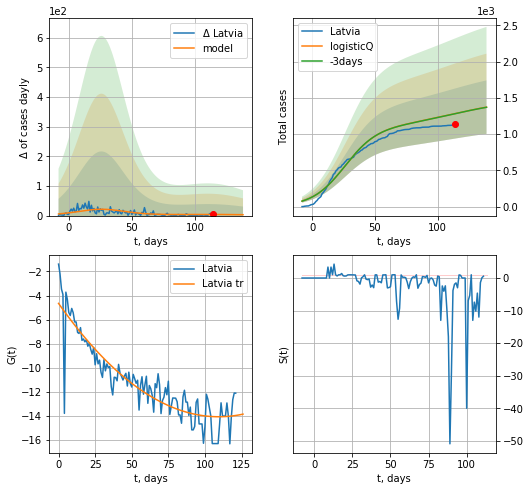

Latvia data at: 2020-07-07
+3 day model MAPE: 0.001449
model: logisticQ
coeffs: [ 1.09286299e+03  1.72538402e-07  2.61409951e+01 -4.45639008e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.268760
forecast at the end of period: +25 days
	 deltaDaycases: 3
	 total cases: 1373 ± 369
	 total death: 36 ± 29
trend coefficient of determination: 0.814729
 intercept_: -4.65693155659587
 coeffs_: [ 0.         -0.17253665  0.00078856]


In [389]:
#trend3(dfCA[12:],dfPT,dfTR[4:],'CA','PT','TR',40,40,40)
x = forecastRRR('Latvia',dfLV[:],d1,7*18-dT,1.,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


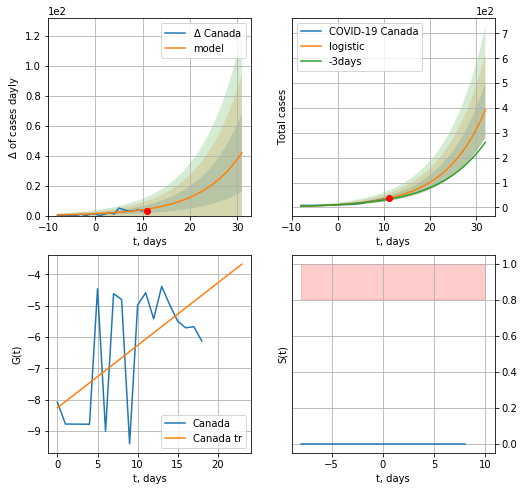

Canada data at: 2020-07-08
+3 day model MAPE: 0.14132705134128837
model: logistic
coeffs:  [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2833741000964234
forecast at the end of period: +21 days
	 deltaDaycases:  41
	 total cases:  392 ± 111
	 total death:  32 ± 27
trend coefficient of determination: 0.348503
 intercept: -8.254919
 slope: 0.199271


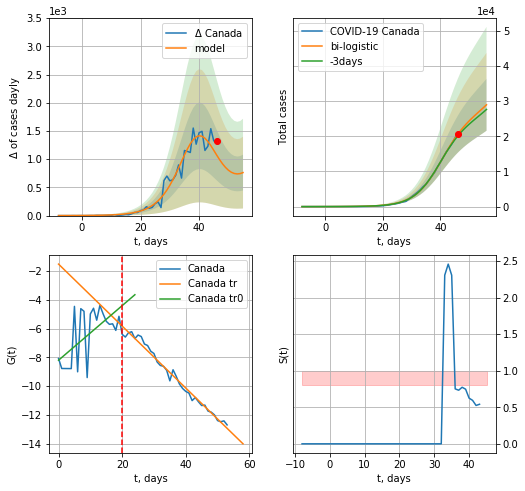

Canada data at: 2020-07-08
+3 day model MAPE: 0.02936701556145869
model: bi-logistic
coeffs:  [2.40154010e+04 2.16961372e-01 4.02658693e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01]
rational stdev:  0.2549294046309869
forecast at the end of period: +10 days
	 deltaDaycases:  762
	 total cases:  28940 ± 7377
	 total death:  2375 ± 1816
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend coefficient of determination: 0.982767
 intercept: -1.518979
 slope: -0.215271


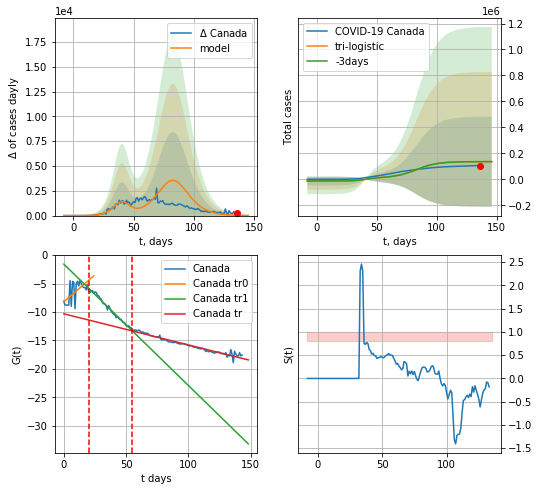

Canada data at: 2020-07-08
+3 day model MAPE: 0.004577660391571911
model: tri-logistic
coeffs:  [-1.32703323e+04  1.69575313e+00 -2.82075933e+01] [1.25340432e+05 1.13222117e-01 8.29016731e+01 2.40154010e+04
 2.16961372e-01 4.02658693e+01]
forecast rational stdev:  2.543977424637005
forecast at the end of period: +10 days
	 deltaDaycases:  11
	 total cases:  135986 ± 345946
	 total death:  11162 ± 85187
tri-logistic approximation splitting points: 20,55
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend1 coefficient of determination: 0.983223
 intercept: -1.572806
 slope: -0.213535
trend coefficient of determination: 0.955840
 intercept: -10.313081
 slope: -0.054746


In [168]:
vL=20
vL1=55
x = forecast('Canada',dfCA[:vL],d1,3*7,1.)
xx=forecast2('Canada',dfCA[:vL1],d1,16*7-dT,x,1.,vL=vL)#,addpred=True,xcoef=[0.25,1.,2.]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Canada",dfCA[:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

CA
           date     cases  active   death
140 2020-07-04  105317.0   27653  8674.0
141 2020-07-05  105536.0   27613  8684.0
142 2020-07-06  105935.0   27672  8693.0
143 2020-07-07  106167.0   27573  8711.0
144 2020-07-08  106434.0   27450  8737.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


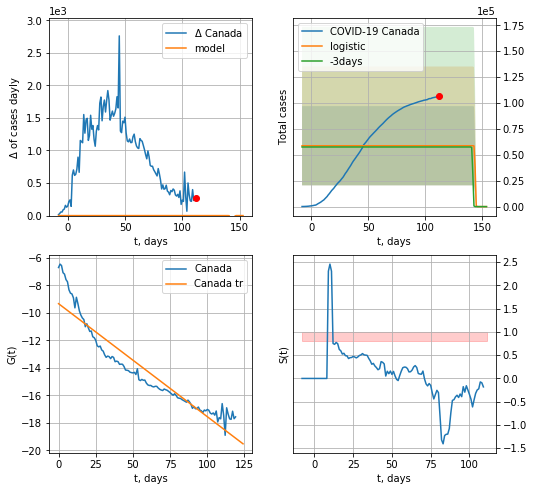

Canada data at: 2020-07-08
+3 day model MAPE: 0.020967089873930752
model: logistic
coeffs:  [ 5.87346446e+04 -4.86848616e+00  1.44124366e+02]
rational stdev:  0.6507053556261986
forecast at the end of period: +42 days
	 deltaDaycases:  0
	 total cases:  0 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.889298
 intercept: -9.324956
 slope: -0.082258


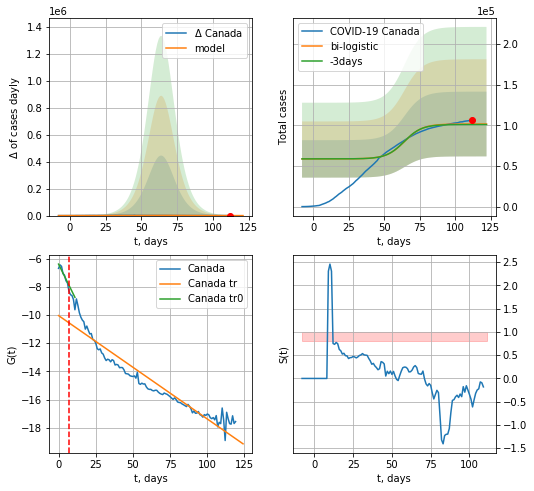

Canada data at: 2020-07-08
+3 day model MAPE: 0.006291795224518937
model: bi-logistic
coeffs:  [4.28305577e+04 1.58451157e-01 6.42197119e+01] [ 5.87346446e+04 -4.86848616e+00  1.44124366e+02]
rational stdev:  0.39163475988781693
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  101560 ± 39774
	 total death:  8336 ± 9794
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.859073
 intercept: -6.392122
 slope: -0.214001
trend coefficient of determination: 0.911018
 intercept: -10.042548
 slope: -0.073363


In [169]:
dfCA = read_df(pd.DataFrame(),"CA")
x = forecast('Canada',dfCA[24:],d1,6*7,1.,cases='cases')
xx=forecast2('Canada',dfCA[24:],d1,16*7-dT,x,1.,vL=31-24,cases='cases')

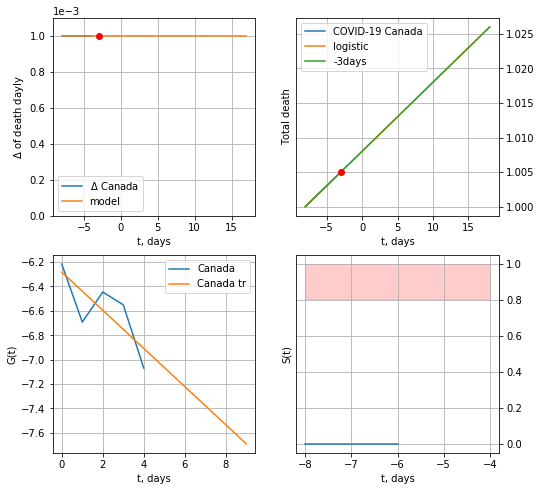

Canada data at: 2020-07-08
+3 day model MAPE: 5.06934136593531e-07
model: logistic
coeffs:  [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  1.4705534785239981e-08
forecast at the end of period: +21 days
	 total death:  1 ± 0
trend coefficient of determination: 0.608158
 intercept: -6.282802
 slope: -0.156326


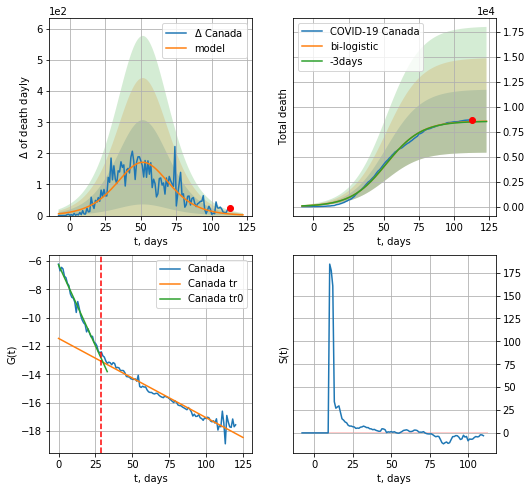

Canada data at: 2020-07-08
+3 day model MAPE: 0.0034797579838602814
model: bi-logistic
coeffs:  [8.59258378e+03 7.97561016e-02 5.18730569e+01] [2.01698683e+00 1.98322956e-03 4.93279263e-01]
rational stdev:  0.3683108808761803
forecast at the end of period: +10 days
	 deltaDaydeath:  2
	 total death:  8564 ± 3154
bi-logistic approximation splitting point: 29
trend0 coefficient of determination: 0.986075
 intercept: -6.260314
 slope: -0.228750
trend coefficient of determination: 0.957217
 intercept: -11.462656
 slope: -0.055960


In [170]:
vL=29
vL1=50
x = forecast('Canada',dfCA[23:vL],d1,3*7,1.,cases='death')
xx=forecast2('Canada',dfCA[23:],d1,16*7-dT,x,1.,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,2.]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Canada",dfCA[24:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


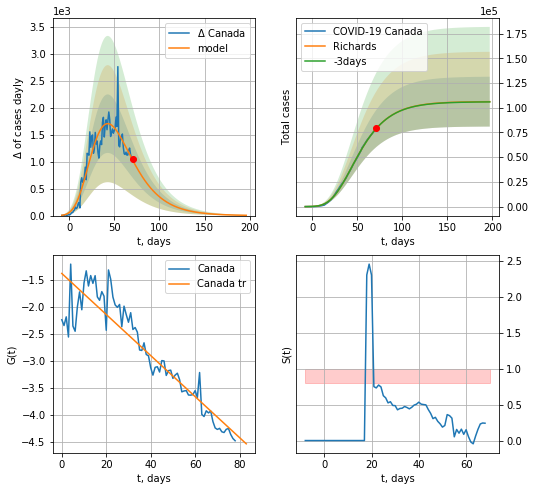

Canada data at: 2020-07-08
+3 day model MAPE: 0.000409
model: Richards
coeffs: [ 1.06255446e+05  3.22299303e+00 -5.46558779e+01  1.36160595e-02]
rational stdev: 0.237359
forecast at the end of period: +126 days
	 deltaDaycases: 5
	 total cases: 106130 ± 25191
	 total death: 8712 ± 6203
trend coefficient of determination: 0.858553
 intercept: -1.383516
 slope: -0.038052


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power


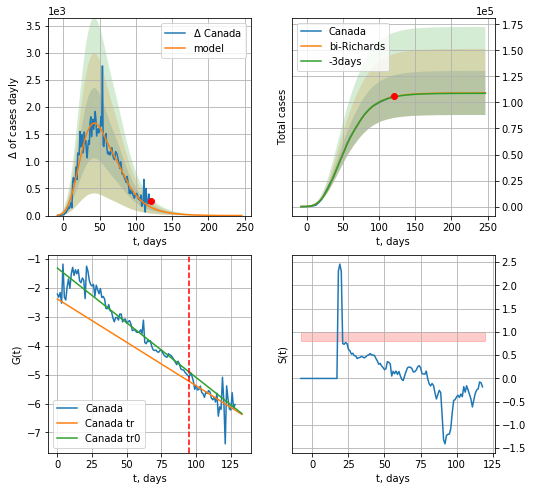

Canada data at: 2020-07-08
+3 day model MAPE: 0.002919
model: bi-Richards
coeffs: [2.83830713e+03 2.48134049e+01 1.69094204e+01 3.66373449e-03]
rational stdev: 0.193691
forecast at the end of period: +126 days
	 deltaDaycases: 0
	 total cases: 109079 ± 21127
	 total death: 8954 ± 5202
bi-Richards approximation splitting point: 95
trend coefficient of determination: 0.909063
 intercept: -1.310186
 slope: -0.037860
trend coefficient of determination: 0.403257
 intercept: -2.377548
 slope: -0.030035


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


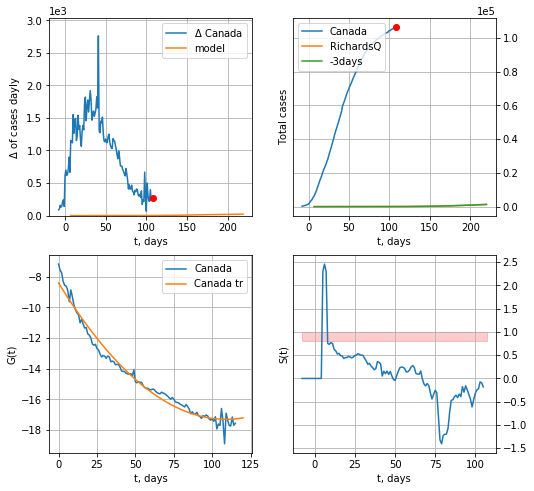

Canada data at: 2020-07-08
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 6.29625328e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +112 days
	 deltaDaycases: 22


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [171]:
iL = 15
vL = 95 + iL
x = forecastRR('Canada',dfCA[iL:vL-iL],d1,18*7,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Canada',dfCA[iL:],d1,18*7,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
x = forecastQR('Canada',dfCA[28:],d1,16*7,1.)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


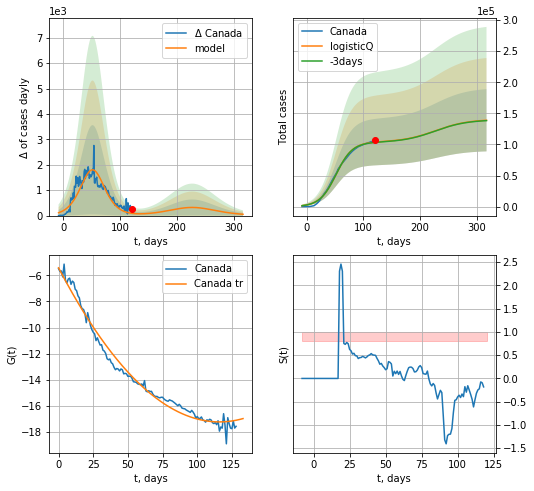

Canada data at: 2020-07-08
+3 day model MAPE: 0.004645
model: logisticQ
coeffs: [ 1.03663818e+05  2.98718996e-07  5.21084675e+01 -2.32367029e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.360274
forecast at the end of period: +196 days
	 deltaDaycases: 51
	 total cases: 138853 ± 50025
	 total death: 11398 ± 12319
trend coefficient of determination: 0.983045
 intercept_: -5.428240053635447
 coeffs_: [ 0.         -0.2035635   0.00087792]


In [172]:
x = forecastRRR('Canada',dfCA[15:],d1,7*28,1.,addpred=True,xcoef=koreaCoeffs)

PT
           date  cases  active   death
124 2020-07-04  43569   13192  1605.0
125 2020-07-05  43897   13266  1614.0
126 2020-07-06  44129   13343  1620.0
127 2020-07-07  44416   13342  1629.0
128 2020-07-08  44859   13514  1631.0


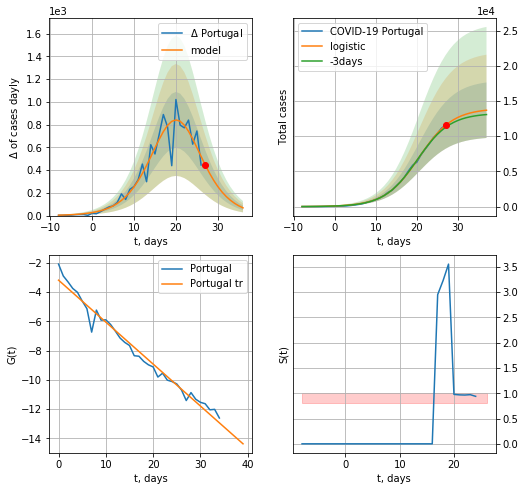

Portugal data at: 2020-07-08
+3 day model MAPE: 0.028768813359110825
model: logistic
coeffs:  [1.39435560e+04 2.41732854e-01 2.05234131e+01]
rational stdev:  0.2880659201380634
forecast at the end of period: +10 days
	 deltaDaycases:  68
	 total cases:  13688 ± 3943
	 total death:  497 ± 429
trend coefficient of determination: 0.976552
 intercept: -3.178197
 slope: -0.287215


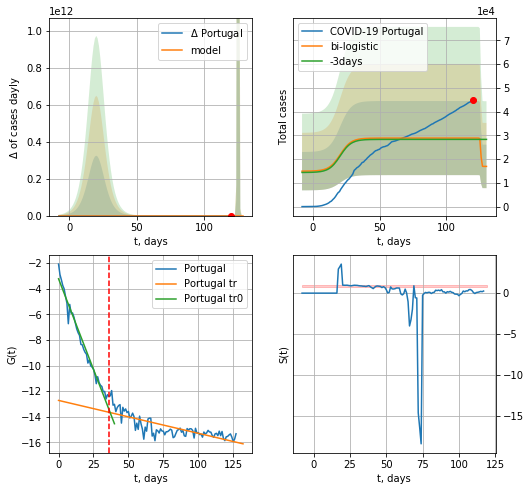

Portugal data at: 2020-07-08
+3 day model MAPE: 0.019555835071124194
model: bi-logistic
coeffs:  [ 1.19286161e+04 -4.74979105e+00  1.25841922e+02] [1.39435560e+04 2.41732854e-01 2.05234131e+01]
scenario coeffs:  [0.25, 1.0, 1.2]
rational stdev:  0.5406072592821843
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  16925 ± 9150
	 total death:  615 ± 997
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975262
 intercept: -3.226992
 slope: -0.282910
trend coefficient of determination: 0.611149
 intercept: -12.723686
 slope: -0.025680


In [173]:
vL = 36
dfPT = read_df(pd.DataFrame(),"PT")
x = forecast('Portugal',dfPT[:vL],d1,16*7-dT,1.)
xx=forecast2('Portugal',dfPT[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.2],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


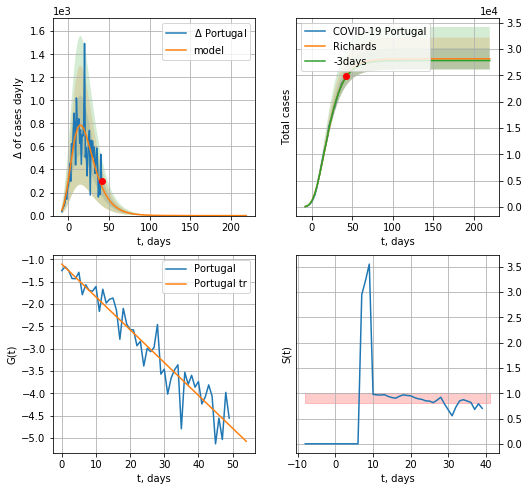

Portugal data at: 2020-07-08
+3 day model MAPE: 0.006186
model: Richards
coeffs: [ 2.81616178e+04  5.39214197e+00 -4.03941749e+01  1.41510332e-02]
rational stdev: 0.071740
forecast at the end of period: +178 days
	 deltaDaycases: 0
	 total cases: 28161 ± 2020
	 total death: 1023 ± 220
trend coefficient of determination: 0.913504
 intercept: -1.105984
 slope: -0.073555


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


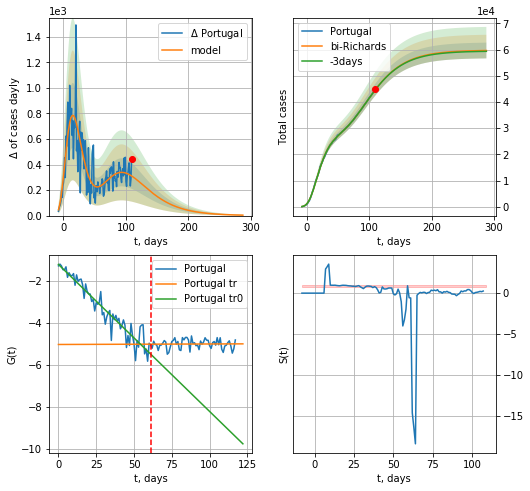

Portugal data at: 2020-07-08
+3 day model MAPE: 0.000719
model: bi-Richards
coeffs: [ 3.15836461e+04  1.61093385e+00 -4.37550880e+01  1.79822212e-02]
rational stdev: 0.050317
forecast at the end of period: +178 days
	 deltaDaycases: 3
	 total cases: 59627 ± 3000
	 total death: 2167 ± 327
bi-Richards approximation splitting point: 61
trend coefficient of determination: 0.904402
 intercept: -1.198804
 slope: -0.070291
trend coefficient of determination: 0.000333
 intercept: -5.026013
 slope: 0.000242


In [174]:
vL=61+10
x = forecastRR('Portugal',dfPT[10:vL-10],d1,40*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Portugal',dfPT[10:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


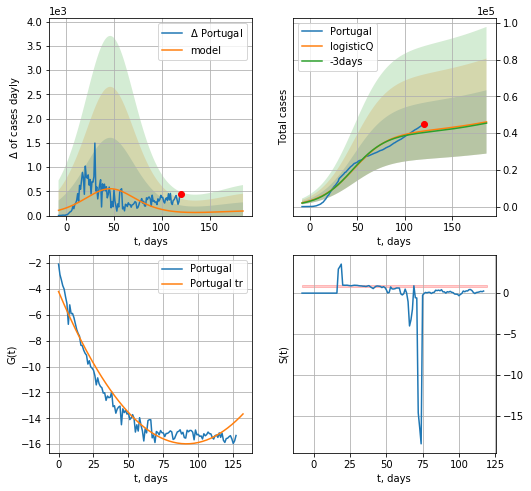

Portugal data at: 2020-07-08
+3 day model MAPE: 0.020382
model: logisticQ
coeffs: [ 4.05042247e+04  9.70657320e-08  4.63281062e+01 -5.57901866e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.373981
forecast at the end of period: +66 days
	 deltaDaycases: 94
	 total cases: 46123 ± 17249
	 total death: 1676 ± 1880
trend coefficient of determination: 0.955375
 intercept_: -4.198438843442533
 coeffs_: [ 0.         -0.25737579  0.00140664]


In [175]:
x = forecastRRR('Portugal',dfPT[:],d1,24*7-dT,1.,addpred=True,xcoef=koreaCoeffs)

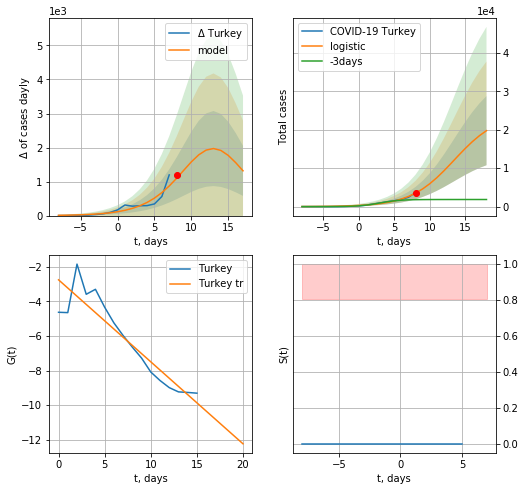

Turkey data at: 2020-07-08
+3 day model MAPE: 1.5246814929812549
model: logistic
coeffs:  [2.42672036e+04 3.25610640e-01 1.34529779e+01]
rational stdev:  0.45520286558776807
forecast at the end of period: +10 days
	 deltaDaycases:  1316
	 total cases:  19769 ± 8999
	 total death:  499 ± 681
trend coefficient of determination: 0.850665
 intercept: -2.746555
 slope: -0.474541


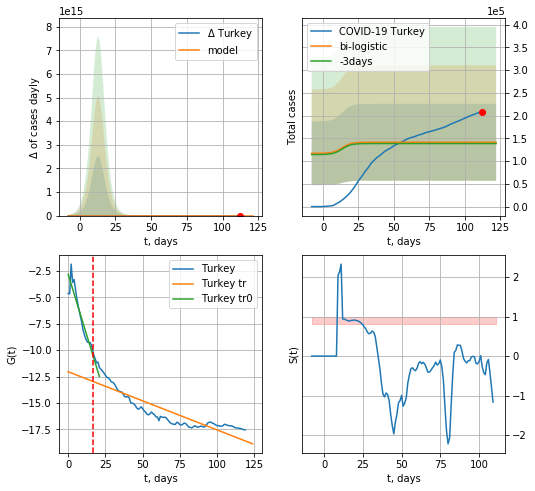

Turkey data at: 2020-07-08
+3 day model MAPE: 0.020598166319841925
model: bi-logistic
coeffs:  [ 9.37731662e+04 -5.47382446e+00  9.76176935e+02] [2.42672036e+04 3.25610640e-01 1.34529779e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.5974429567720326
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  141483 ± 84528
	 total death:  3576 ± 6409
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.862807
 intercept: -2.813054
 slope: -0.461241
trend coefficient of determination: 0.775770
 intercept: -12.041630
 slope: -0.055100


In [176]:
vL=17
x = forecast('Turkey',dfTR[:vL],d1,7*16-dT,1.)
xx=forecast2('Turkey',dfTR[:],d1,16*7-dT,x,1.,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


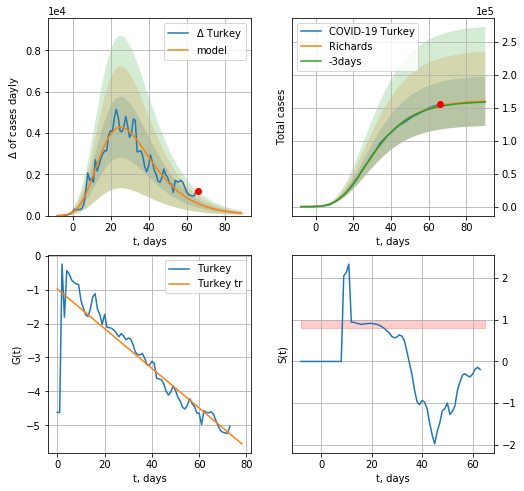

Turkey data at: 2020-07-08
+3 day model MAPE: 0.006544
model: Richards
coeffs: [ 1.61234317e+05  5.77708690e+00 -3.44331101e+01  1.25674474e-02]
rational stdev: 0.235071
forecast at the end of period: +24 days
	 deltaDaycases: 114
	 total cases: 159711 ± 37543
	 total death: 4037 ± 2846
trend coefficient of determination: 0.775257
 intercept: -0.978832
 slope: -0.058549


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


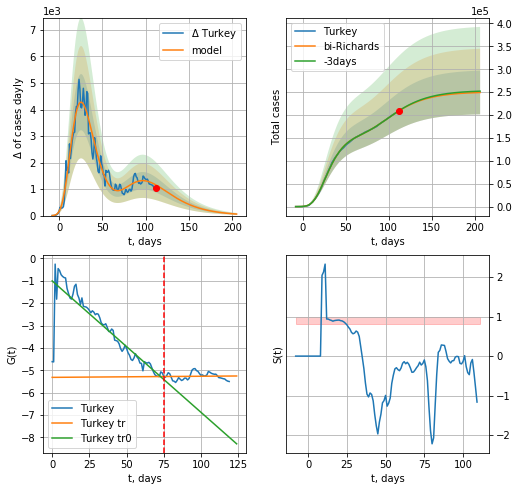

Turkey data at: 2020-07-08
+3 day model MAPE: 0.001651
model: bi-Richards
coeffs: [ 8.95084871e+04  2.36222362e+00 -7.43201945e+00  1.62989645e-02]
rational stdev: 0.191533
forecast at the end of period: +94 days
	 deltaDaycases: 57
	 total cases: 249272 ± 47743
	 total death: 6301 ± 3620
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.784458
 intercept: -1.005972
 slope: -0.058721
trend coefficient of determination: 0.001640
 intercept: -5.316576
 slope: 0.000494


In [177]:
vL = 75
x = forecastRR('Turkey',dfTR[:vL],d1,18*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Turkey',dfTR[:],d1,28*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


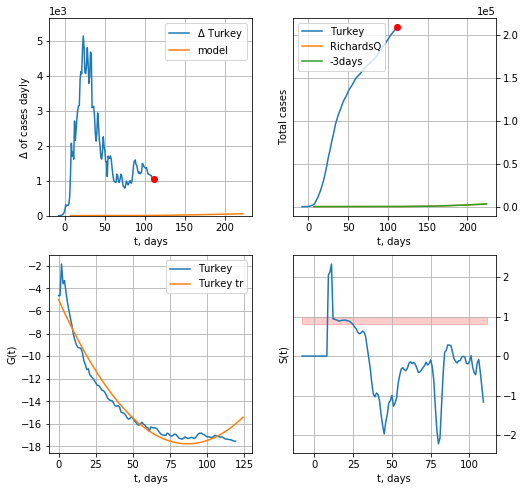

Turkey data at: 2020-07-08
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 1.40696826e+04  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +112 days
	 deltaDaycases: 51


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [178]:
x = forecastQR('Turkey',dfTR[:],d1,16*7,1.,addpred=False,xcoef=[0.35,.5,3,1,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


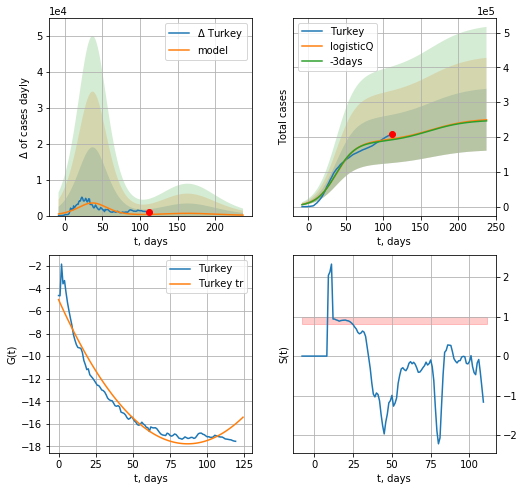

Turkey data at: 2020-07-08
+3 day model MAPE: 0.013532
model: logisticQ
coeffs: [ 1.87024937e+05  1.22649268e-07  3.75957741e+01 -6.09312462e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.356470
forecast at the end of period: +126 days
	 deltaDaycases: 138
	 total cases: 249421 ± 88911
	 total death: 6305 ± 6742
trend coefficient of determination: 0.952968
 intercept_: -4.98445724115548
 coeffs_: [ 0.         -0.2949025   0.00169997]


In [179]:
x = forecastRRR('Turkey',dfTR[:],d1,18*7,1.,addpred=True,xcoef=koreaCoeffs)

#xx=forecast2R('Turkey',dfTR[:],d1,14*7-dT,x,1.)

In [180]:
dfTT[dfTT.Country=='%s'%("Latvia")][0].values[0]

0.026292725679228746

In [181]:
#trend3(dfPL[1:],dfIS[7:],dfSW,'PL','IS','SW',40,40,40)

PL
           date    cases  active   death
122 2020-07-04  35719.0   11080  1512.0
123 2020-07-05  36155.0   10668  1521.0
124 2020-07-06  36412.0   10646  1528.0
125 2020-07-07  36689.0   10269  1542.0
126 2020-07-08  36689.0   10269  1542.0


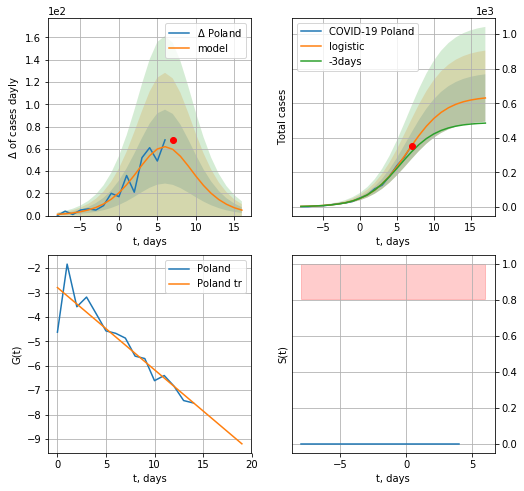

Poland data at: 2020-07-08
+3 day model MAPE: 0.14646234511665837
model: logistic
coeffs:  [6.41107567e+02 3.87606719e-01 6.46563498e+00]
rational stdev:  0.21770687952847212
forecast at the end of period: +10 days
	 deltaDaycases:  4
	 total cases:  630 ± 137
	 total death:  26 ± 16
trend coefficient of determination: 0.843228
 intercept: -2.795749
 slope: -0.337043


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

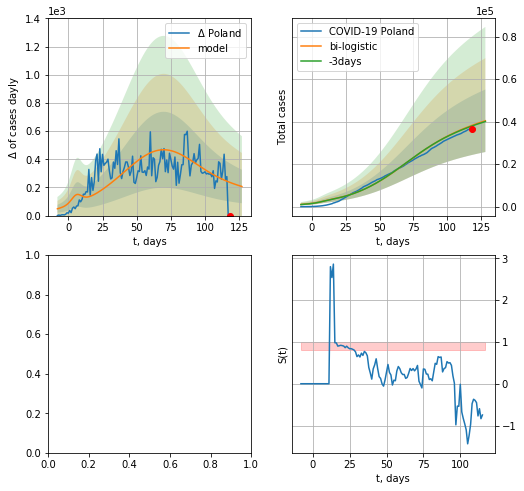

In [182]:
vL=16
vL1=38
dfPL = read_df(pd.DataFrame(),"PL")
x =  forecast('Poland',dfPL[:vL],d1,7*16-dT,1.)
xx = forecast2('Poland',dfPL[:],d1,16*7-dT,x,1.,vL=vL,addpred=True,xcoef=[0.25,1.,2.])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Poland",dfPL,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.5,1.,1.3],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


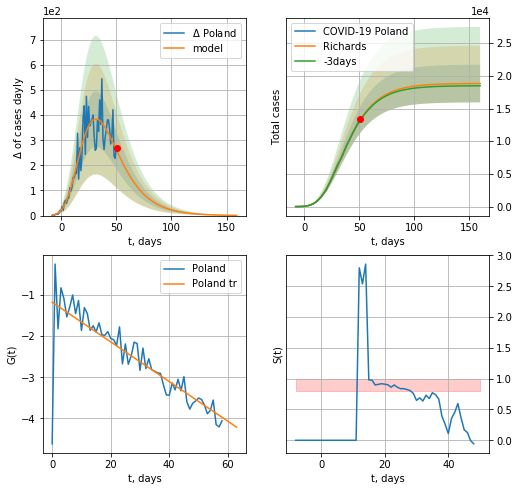

Poland data at: 2020-07-07
+3 day model MAPE: 0.005819
model: Richards
coeffs: [ 1.88418055e+04  3.45583442e+00 -4.15713344e+01  1.61921023e-02]
rational stdev: 0.153201
forecast at the end of period: +109 days
	 deltaDaycases: 0
	 total cases: 18827 ± 2884
	 total death: 790 ± 363
trend coefficient of determination: 0.708781
 intercept: -1.177313
 slope: -0.048172


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


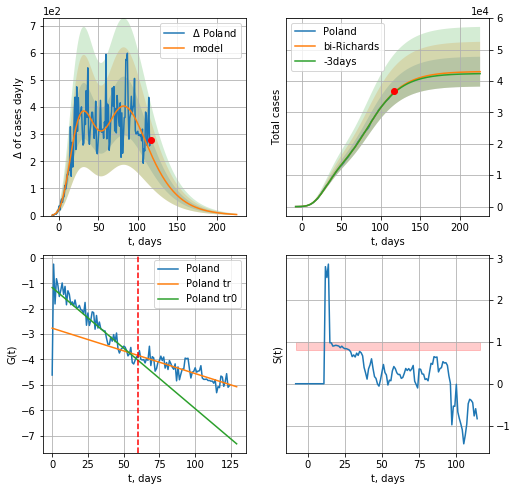

Poland data at: 2020-07-07
+3 day model MAPE: 0.004458
model: bi-Richards
coeffs: [ 2.42221946e+04  2.93128912e+00 -1.96890473e+01  1.36253558e-02]
rational stdev: 0.110626
forecast at the end of period: +109 days
	 deltaDaycases: 3
	 total cases: 42966 ± 4753
	 total death: 1803 ± 598
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.714028
 intercept: -1.171516
 slope: -0.047682
trend coefficient of determination: 0.689573
 intercept: -2.770375
 slope: -0.017865


In [385]:
vL = 60
x =  forecastRR('Poland',dfPL[:vL],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx =  forecast2RR('Poland',dfPL[:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#xx = forecast2R('Poland',dfPL[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


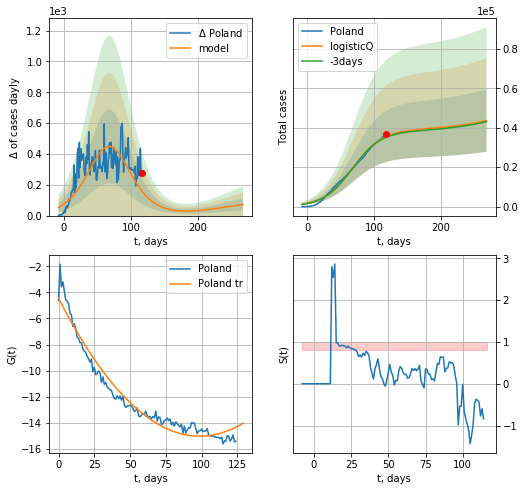

Poland data at: 2020-07-07
+3 day model MAPE: 0.012082
model: logisticQ
coeffs: [ 3.89311975e+04  2.33062380e-07  6.78854415e+01 -1.97114208e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.362898
forecast at the end of period: +151 days
	 deltaDaycases: 71
	 total cases: 43673 ± 15848
	 total death: 1832 ± 1994
trend coefficient of determination: 0.957468
 intercept_: -4.446224567331528
 coeffs_: [ 0.         -0.21414679  0.00108448]


In [386]:
x =  forecastRRR('Poland',dfPL[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

IS
           date    cases  active  death
133 2020-07-04  29170.0   11024  330.0
134 2020-07-05  30162.0   11856  332.0
135 2020-07-06  31186.0   12717  338.0
136 2020-07-07  32222.0   13653  342.0
137 2020-07-08  33557.0   14875  344.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


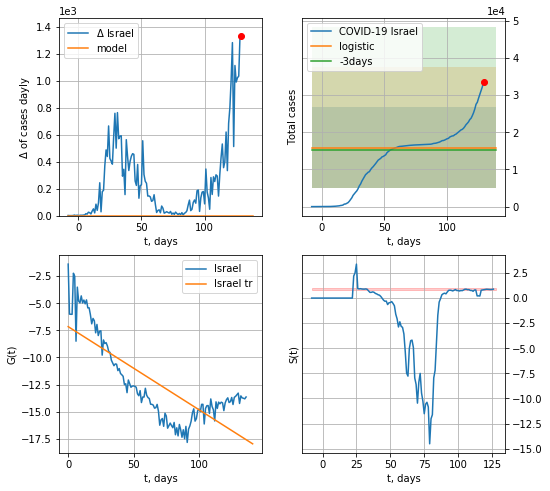

Israel data at: 2020-07-08
+3 day model MAPE: 0.035639134851408384
model: logistic
coeffs:  [ 1.26822686e+04 -5.42362336e+00  1.48402797e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.6833146097680594
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  15852 ± 10832
	 total death:  162 ± 332
trend coefficient of determination: 0.615508
 intercept: -7.156028
 slope: -0.076677


In [183]:
dfIS = read_df(pd.DataFrame(),"IS")
try:
    x = forecast('Israel',dfIS[:],d1,16*7-dT,addpred=True,xcoef=[0.25,1.,1.8])
except:
    print ("Exception occurs")
#xx = forecast2('Israel',dfIS[:],d1,20-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


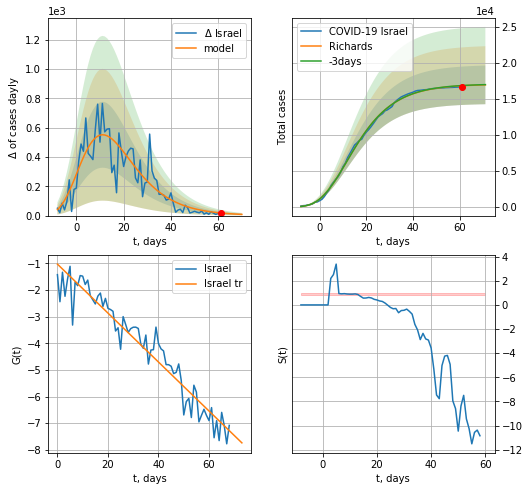

Israel data at: 2020-07-08
+3 day model MAPE: 0.001944
model: Richards
coeffs: [ 1.70515699e+04  6.43111297e+00 -3.67763089e+01  1.37701544e-02]
rational stdev: 0.158199
forecast at the end of period: +10 days
	 deltaDaycases: 8
	 total cases: 16963 ± 2683
	 total death: 173 ± 82
trend coefficient of determination: 0.925544
 intercept: -1.027514
 slope: -0.091953


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


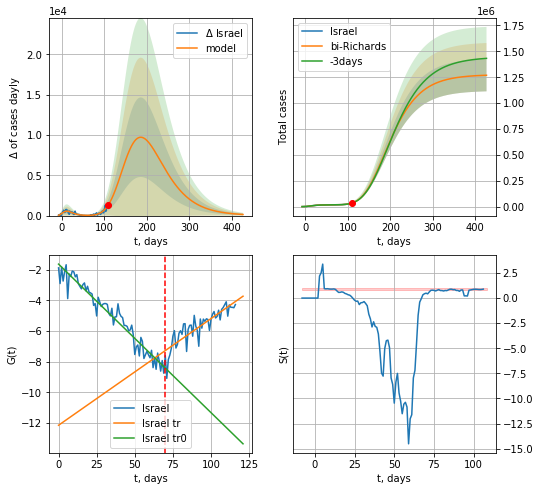

Israel data at: 2020-07-08
+3 day model MAPE: 0.005151
model: bi-Richards
coeffs: [1.25852347e+06 2.18606822e-01 8.17558747e+01 1.00815683e-01]
rational stdev: 0.122607
forecast at the end of period: +318 days
	 deltaDaycases: 137
	 total cases: 1269399 ± 155636
	 total death: 13012 ± 4786
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.940269
 intercept: -1.637179
 slope: -0.096925
trend coefficient of determination: 0.741269
 intercept: -12.154147
 slope: 0.069608


In [184]:
x = forecastRR('Israel',dfIS[20:90],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Israel',dfIS[20:],d1,60*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=90-20)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


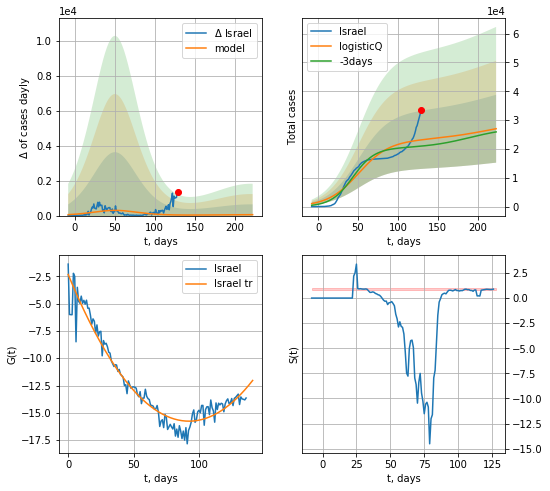

Israel data at: 2020-07-08
+3 day model MAPE: 0.103350
model: logisticQ
coeffs: [ 2.28532005e+04  5.35880834e-08  5.06371715e+01 -9.72550544e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.435710
forecast at the end of period: +94 days
	 deltaDaycases: 53
	 total cases: 27018 ± 11772
	 total death: 276 ± 360
trend coefficient of determination: 0.940351
 intercept_: -2.3373605031594717
 coeffs_: [ 0.         -0.29084233  0.00157476]


In [185]:
x = forecastRRR('Israel',dfIS[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


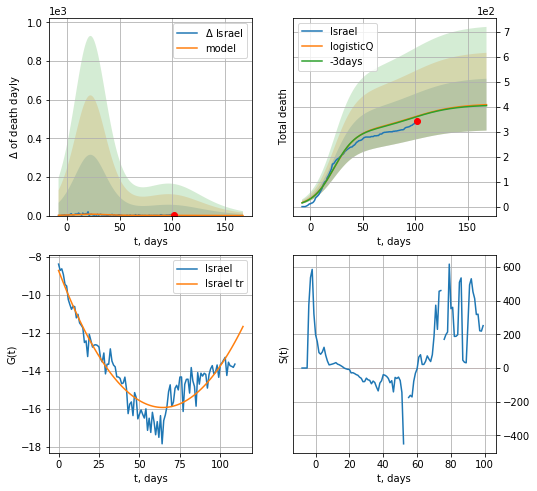

Israel data at: 2020-07-08
+3 day model MAPE: 0.004285
model: logisticQ
coeffs: [ 3.04401586e+02  2.14188129e-07  2.25726489e+01 -4.40230774e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.253630
forecast at the end of period: +66 days
	 total death: 408 ± 103
trend coefficient of determination: 0.882435
 intercept_: -8.719139517971962
 coeffs_: [ 0.         -0.22369673  0.00173546]


In [186]:
x = forecastRRR('Israel',dfIS[27:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


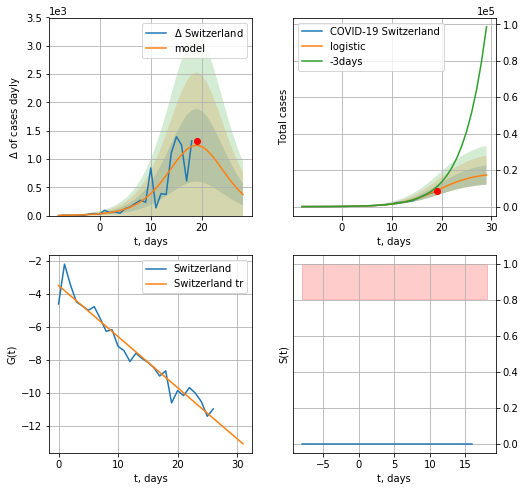

Switzerland data at: 2020-07-08
+3 day model MAPE: 0.24949892382467553
model: logistic
coeffs:  [1.87061213e+04 2.66466230e-01 1.93986309e+01]
rational stdev:  0.30604789910568747
forecast at the end of period: +10 days
	 deltaDaycases:  372
	 total cases:  17361 ± 5313
	 total death:  1050 ± 964
trend coefficient of determination: 0.944448
 intercept: -3.508672
 slope: -0.309041


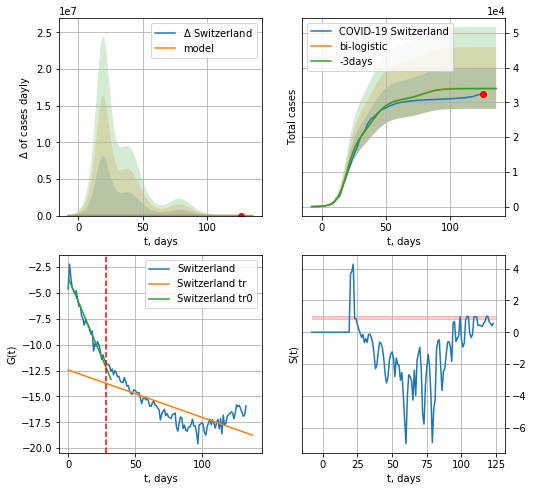

Switzerland data at: 2020-07-08
+3 day model MAPE: 0.0027285333008445277
model: bi-logistic
coeffs:  [1.22889030e+04 1.58021392e-01 3.95463288e+01] [1.87061213e+04 2.66466230e-01 1.93986309e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.17301958444429485
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  34066 ± 5894
	 total death:  2060 ± 1069
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.947988
 intercept: -3.537068
 slope: -0.305765
trend coefficient of determination: 0.590225
 intercept: -12.438493
 slope: -0.045723


In [187]:
vL= 28
x = forecast('Switzerland',dfSZ[:vL],d1,7*16-dT)
xx = forecast2('Switzerland',dfSZ[:],d1,7*16-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,2.])#,addpred=False,xcoef=[0.25,1.,2.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


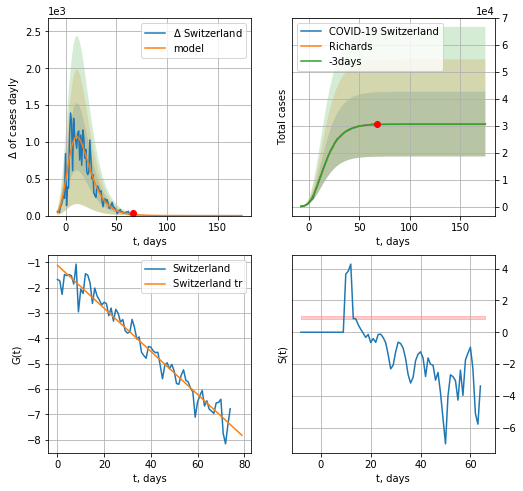

Switzerland data at: 2020-07-08
+3 day model MAPE: 0.000828
model: Richards
coeffs: [ 3.06407782e+04  7.51555694e+00 -3.39977032e+01  1.27179279e-02]
rational stdev: 0.391779
forecast at the end of period: +108 days
	 deltaDaycases: 0
	 total cases: 30640 ± 12004
	 total death: 1853 ± 2177
trend coefficient of determination: 0.957486
 intercept: -1.108794
 slope: -0.084964


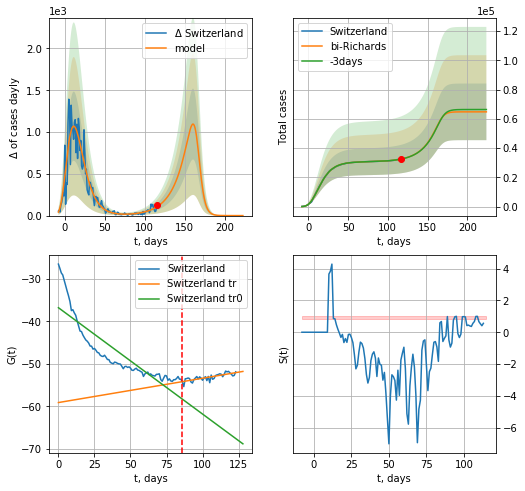

Switzerland data at: 2020-07-08
+3 day model MAPE: 0.000484
model: bi-Richards
coeffs: [3.42084704e+04 5.74299362e-02 1.66872692e+02 4.45900741e+00]
rational stdev: 0.298601
forecast at the end of period: +108 days
	 deltaDaycases: 0
	 total cases: 64849 ± 19364
	 total death: 3923 ± 3514
bi-Richards approximation splitting point: 86
trend coefficient of determination: 0.766452
 intercept: -36.783723
 slope: -0.250034
trend coefficient of determination: 0.592500
 intercept: -59.086793
 slope: 0.057179


In [188]:
iL = 10
vL = 86 + iL
x = forecastRR('Switzerland',dfSZ[iL:vL-iL],d1,7*30-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Switzerland',dfSZ[iL:],d1,7*30-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#xx = forecastR('Switzerland',dfSZ[:],d1,7*5-dT,x,vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


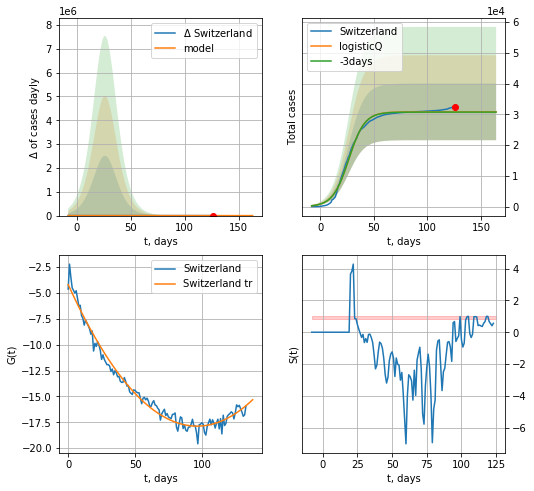

Switzerland data at: 2020-07-08
+3 day model MAPE: 0.002285
model: logisticQ
coeffs: [ 3.08198802e+04  4.82159468e-07  2.65735839e+01 -2.79796974e+05]
rational stdev: 0.299001
forecast at the end of period: +38 days
	 deltaDaycases: 0
	 total cases: 30819 ± 9215
	 total death: 1864 ± 1672
trend coefficient of determination: 0.980265
 intercept_: -4.191505755774479
 coeffs_: [ 0.         -0.28388478  0.00147288]


In [189]:
x = forecastRRR('Switzerland',dfSZ[:],d1,7*20-dT,addpred=False,xcoef=koreaCoeffs)

In [190]:
#trend3(dfUR[5:],dfIN[7:],dfRS[5:],'UR','IN','RS',40,40,40)

Ukr
           date    cases  active   death
116 2020-07-04  47677.0   25335  1227.0
117 2020-07-05  49043.0   26078  1262.0
118 2020-07-06  49607.0   26131  1283.0
119 2020-07-07  50414.0   25989  1306.0
120 2020-07-08  50414.0   25989  1306.0
Exaption occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


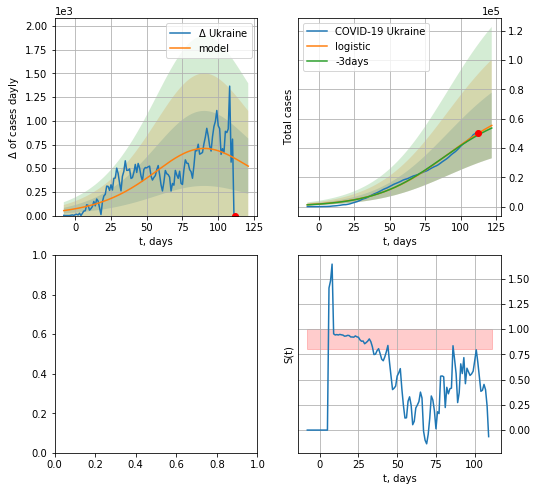

In [191]:
dfUR = read_df(pd.DataFrame(),"Ukr")
try:
    x=forecast('Ukraine',dfUR[:],d1,16*7-dT,addpred=True,xcoef=[0.25,1.,2.])
except:
      print("Exaption occurs") 

#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


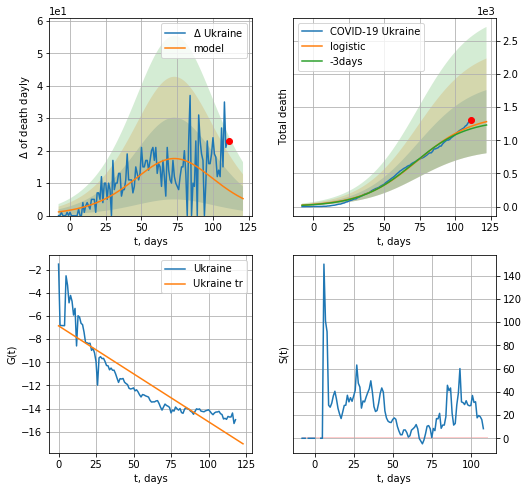

Ukraine data at: 2020-07-07
+3 day model MAPE: 0.03194029281931442
model: logistic
coeffs:  [1.39025739e+03 5.05843412e-02 7.34663177e+01]
rational stdev:  0.3718856884593796
forecast at the end of period: +11 days
	 total death:  1280 ± 476
trend coefficient of determination: 0.806118
 intercept: -6.841626
 slope: -0.082969


In [191]:
x=forecast('Ukraine',dfUR[:],d1,16*7-dT,addpred=False,xcoef=[0.25,1.,2.],cases='death')
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


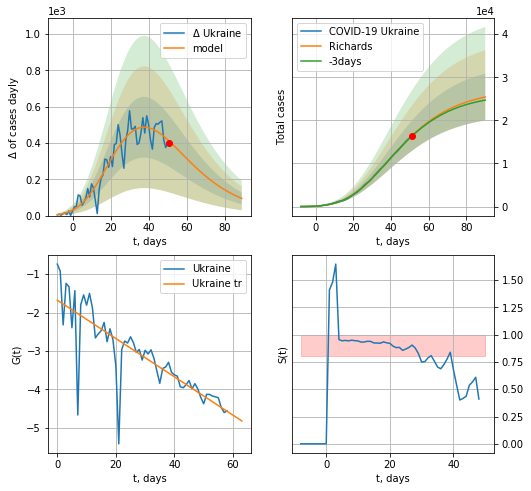

Ukraine data at: 2020-07-07
+3 day model MAPE: 0.005756
model: Richards
coeffs: [ 2.73152280e+04  5.78390520e-01 -1.00505543e+01  8.74755420e-02]
rational stdev: 0.213278
forecast at the end of period: +39 days
	 deltaDaycases: 94
	 total cases: 25413 ± 5420
	 total death: 658 ± 421
trend coefficient of determination: 0.678475
 intercept: -1.678868
 slope: -0.049847


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


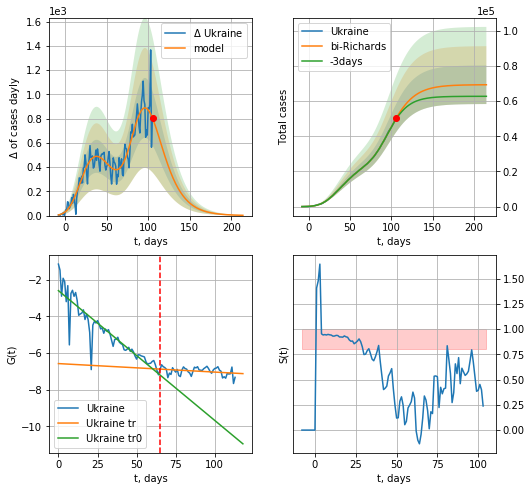

Ukraine data at: 2020-07-07
+3 day model MAPE: 0.011874
model: bi-Richards
coeffs: [4.19766519e+04 2.06687135e-01 7.79391976e+01 2.94915715e-01]
rational stdev: 0.158240
forecast at the end of period: +109 days
	 deltaDaycases: 2
	 total cases: 69254 ± 10958
	 total death: 1794 ± 851
bi-Richards approximation splitting point: 65
trend coefficient of determination: 0.828317
 intercept: -2.591958
 slope: -0.070906
trend coefficient of determination: 0.092442
 intercept: -6.576788
 slope: -0.004642


In [192]:
vL = 65+5
x=forecastRR('Ukraine',dfUR[5:vL-5],d1,7*20-dT,addpred=False,xcoef=RkoreaCoeffs)
xx=forecast2RR('Ukraine',dfUR[5:],d1,7*30-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


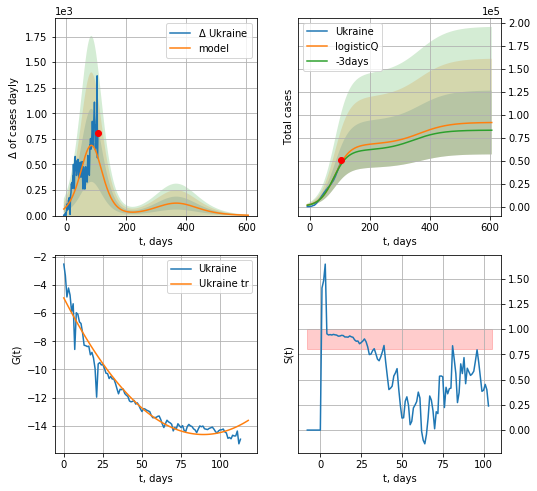

Ukraine data at: 2020-07-07
+3 day model MAPE: 0.032920
model: logisticQ
coeffs: [ 6.76577914e+04  2.89217853e-07  8.40816153e+01 -1.39900196e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.378987
forecast at the end of period: +501 days
	 deltaDaycases: 3
	 total cases: 91442 ± 34655
	 total death: 2368 ± 2692
trend coefficient of determination: 0.955960
 intercept_: -4.917617598426696
 coeffs_: [ 0.         -0.21748271  0.0012178 ]


In [193]:
x=forecastRRR('Ukraine',dfUR[5:],d1,7*86-dT,addpred=True,xcoef=koreaCoeffs)

In [194]:
#np.log(np.diff(dfIS["cases"].values)[:]/dfIS["cases"].values[1:]**2)

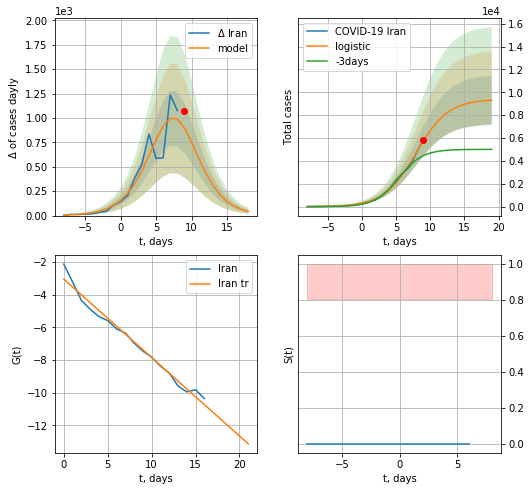

Iran data at: 2020-07-08
+3 day model MAPE: 0.41768987892528675
model: logistic
coeffs:  [9.38566037e+03 4.29600563e-01 7.92981697e+00]
rational stdev:  0.2297342175744371
forecast at the end of period: +10 days
	 deltaDaycases:  42
	 total cases:  9305 ± 2137
	 total death:  452 ± 311
trend coefficient of determination: 0.980602
 intercept: -3.037586
 slope: -0.480406


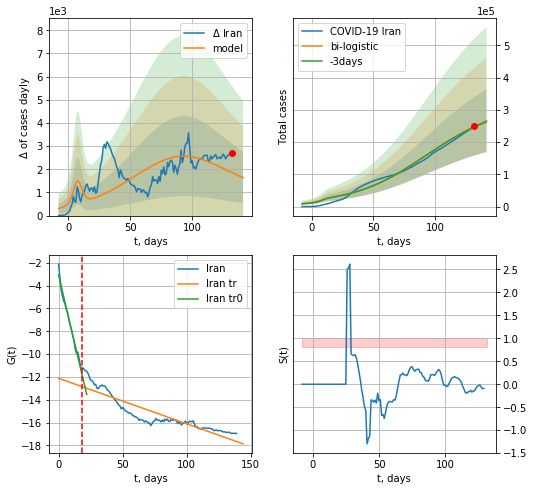

Iran data at: 2020-07-08
+3 day model MAPE: 0.011244841088134743
model: bi-logistic
coeffs:  [2.84702539e+05 3.46859861e-02 9.13512980e+01] [9.38566037e+03 4.29600563e-01 7.92981697e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3641770512637169
forecast at the end of period: +10 days
	 deltaDaycases:  1639
	 total cases:  266129 ± 96918
	 total death:  12947 ± 14145
bi-logistic approximation splitting point: 18
trend0 coefficient of determination: 0.982944
 intercept: -3.059655
 slope: -0.476268
trend coefficient of determination: 0.812649
 intercept: -12.116231
 slope: -0.039847


In [192]:
x = forecast('Iran',dfIN[:18],d1,7*16-dT)
xx = forecast2('Iran',dfIN[:],d1,16*7-dT,x,vL=18,addpred=True,xcoef=[0.25,1.,2.0])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


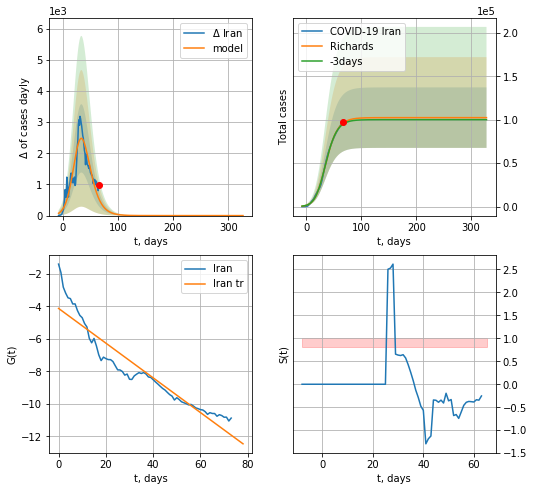

Iran data at: 2020-07-08
+3 day model MAPE: 0.012009
model: Richards
coeffs: [1.02478153e+05 1.52216321e-01 2.65523922e+01 5.45962709e-01]
rational stdev: 0.339941
forecast at the end of period: +262 days
	 deltaDaycases: 0
	 total cases: 102478 ± 34836
	 total death: 4985 ± 5083
trend coefficient of determination: 0.893485
 intercept: -4.118017
 slope: -0.106957


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


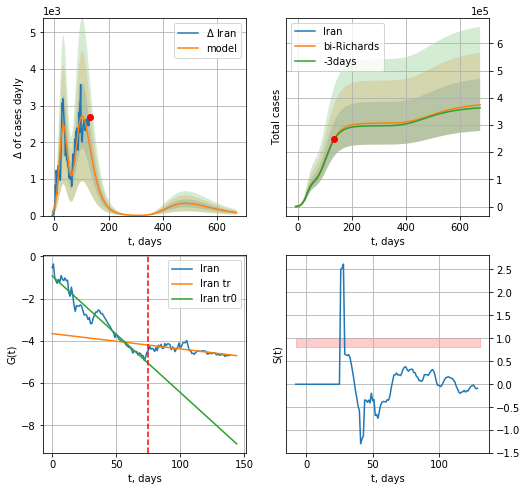

Iran data at: 2020-07-08
+3 day model MAPE: 0.008751
model: bi-Richards
coeffs: [ 2.04103162e+05  2.85066587e+00 -1.69237659e+01  1.26758301e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.255816
forecast at the end of period: +542 days
	 deltaDaycases: 81
	 total cases: 373616 ± 95577
	 total death: 18176 ± 13949
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.949245
 intercept: -0.922105
 slope: -0.055254
trend coefficient of determination: 0.498755
 intercept: -3.654864
 slope: -0.007265


In [193]:
vL = 75
x = forecastRR('Iran',dfIN[:vL],d1,52*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Iran',dfIN[:],d1,92*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


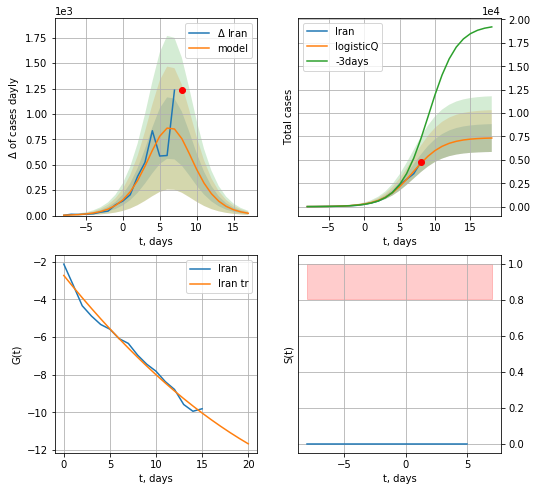

Iran data at: 2020-07-08
+3 day model MAPE: 0.437963
model: logisticQ
coeffs: [ 7.36885538e+03  7.42900276e-05 -6.37012173e+03  6.90117085e+00]
rational stdev: 0.203007
forecast at the end of period: +10 days
	 deltaDaycases: 22
	 total cases: 7331 ± 1488
	 total death: 356 ± 216
trend coefficient of determination: 0.985826
 intercept_: -2.7244557798652984
 coeffs_: [ 0.         -0.60810956  0.00802289]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


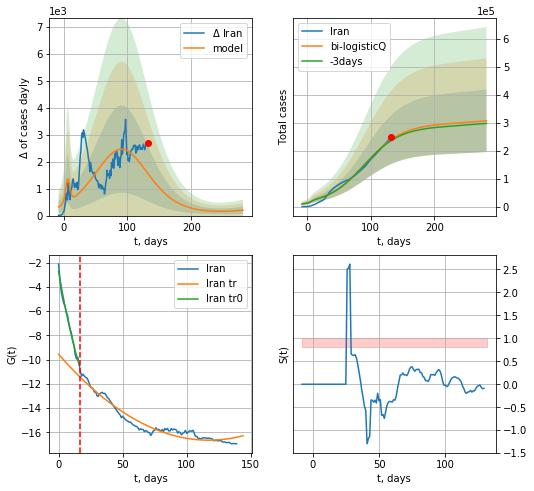

Iran data at: 2020-07-08
+3 day model MAPE: 0.014840
model: bi-logisticQ
coeffs: [ 2.87359342e+05  1.46283569e-07  9.09983335e+01 -2.33989957e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.364716
forecast at the end of period: +150 days
	 deltaDaycases: 200
	 total cases: 306726 ± 111868
	 total death: 14922 ± 16326
bi-logisticQ approximation splitting point: 17
trend coefficient of determination: 0.987745
 intercept_: -2.720144864989817
 coeffs_: [ 0.         -0.61067547  0.00823538]
trend coefficient of determination: 0.945705
 intercept_: -9.55883952984158
 coeffs_: [ 0.         -0.12098816  0.00051554]


In [194]:
x = forecastRRR('Iran',dfIN[:17],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Iran',dfIN[:],d1,36*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=17)

RS
           date     cases  active    death
126 2020-07-04  674515.0  217609  10027.0
127 2020-07-05  687862.0  223237  10296.0
128 2020-07-06  694230.0  219856  10494.0
129 2020-07-07  700792.0  217614  10667.0
130 2020-07-08  700792.0  217614  10667.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

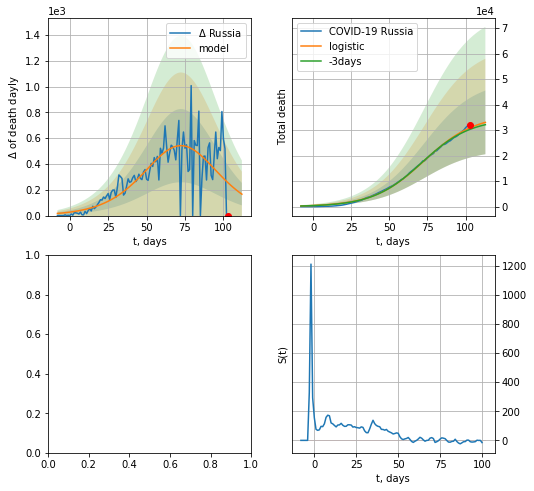

In [195]:
dfRS = read_df(pd.DataFrame(),"RS")
x = forecast('Russia',dfRS[19:],d1,16*7-dT,shift=3.,cases='death')
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


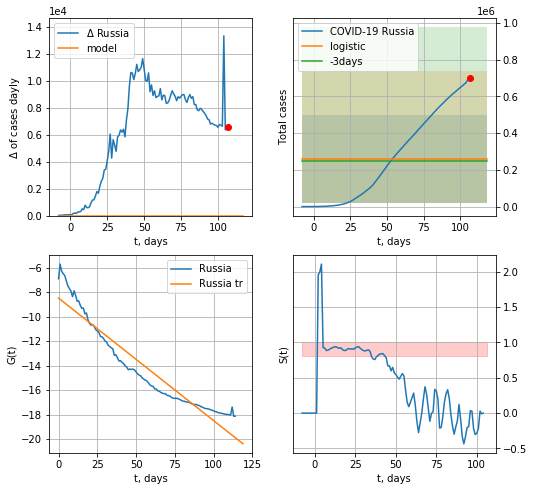

Russia data at: 2020-07-07
+3 day model MAPE: 0.046150880070896766
model: logistic
coeffs:  [ 2.60849991e+05 -7.37027633e+00  1.90835361e+02]
rational stdev:  0.9170914819293234
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  260849 ± 239223
	 total death:  3943 ± 10848
trend coefficient of determination: 0.908622
 intercept: -8.482061
 slope: -0.100099


In [368]:
x = forecast('Russia',dfRS[14:],d1,16*7-dT,shift=1.)
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14,shift=1.)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


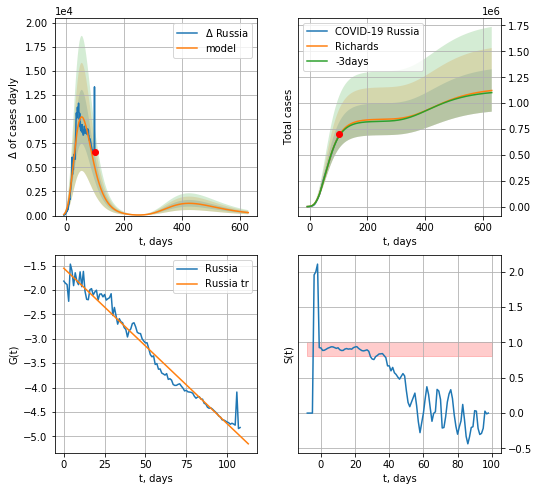

Russia data at: 2020-07-07
+3 day model MAPE: 0.009621
model: Richards
coeffs: [ 8.44693721e+05  2.95610754e+00 -8.12960494e+01  1.12042366e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.182470
forecast at the end of period: +529 days
	 deltaDaycases: 310
	 total cases: 1122101 ± 204750
	 total death: 16961 ± 9284
trend coefficient of determination: 0.970396
 intercept: -1.552649
 slope: -0.031881


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


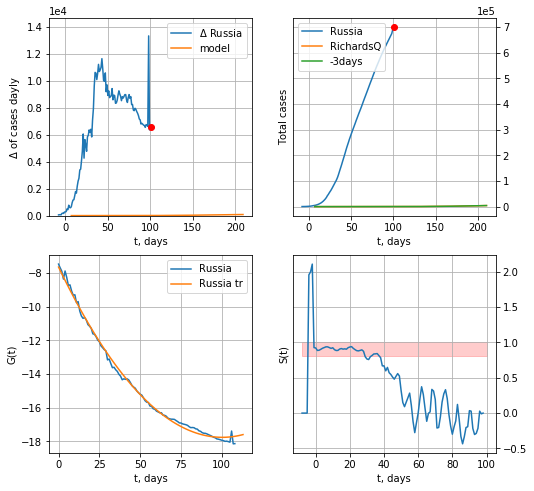

Russia data at: 2020-07-07
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 2.43452012e+04  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +109 days
	 deltaDaycases: 80


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [369]:
x = forecastRR('Russia',dfRS[20:],d1,90*7-dT,addpred=True,xcoef=RkoreaCoeffs)#,addpred=True,xcoef=[0.25,1.,1.5,1]
x = forecastQR('Russia',dfRS[20:],d1,30*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


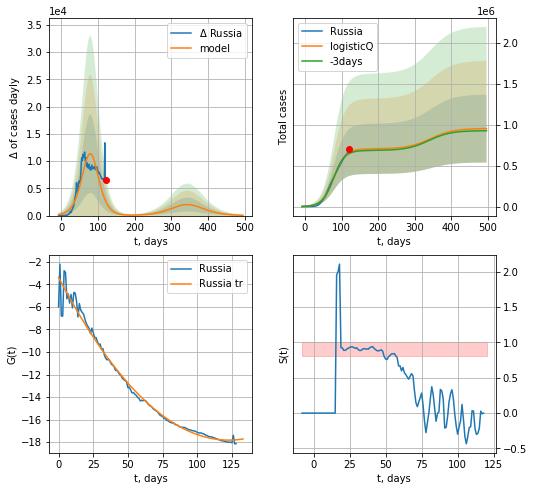

Russia data at: 2020-07-07
+3 day model MAPE: 0.019392
model: logisticQ
coeffs: [ 7.05828101e+05  3.72079417e-07  7.87617059e+01 -1.72947725e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.434621
forecast at the end of period: +375 days
	 deltaDaycases: 57
	 total cases: 954043 ± 414647
	 total death: 14421 ± 18803
trend coefficient of determination: 0.983483
 intercept_: -3.3859752432819246
 coeffs_: [ 0.         -0.23528312  0.00095912]


In [370]:
x = forecastRRR('Russia',dfRS[:],d1,68*7-dT,addpred=True,xcoef=koreaCoeffs)

JP
           date    cases  active  death
164 2020-07-04  19282.0    1346  977.0
165 2020-07-05  19522.0    1495  977.0
166 2020-07-06  19775.0    1674  977.0
167 2020-07-07  19981.0    1806  978.0
168 2020-07-08  20174.0    1863  980.0


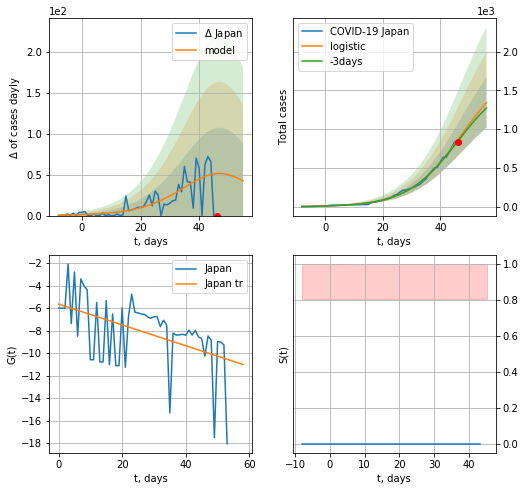

Japan data at: 2020-07-08
+3 day model MAPE: 0.0244139001087548
model: logistic
coeffs:  [1.86668601e+03 1.09971339e-01 4.74124632e+01]
rational stdev:  0.24188431663406776
forecast at the end of period: +10 days
	 deltaDaycases:  42
	 total cases:  1343 ± 325
	 total death:  65 ± 47
trend coefficient of determination: 0.226001
 intercept: -5.646499
 slope: -0.092589


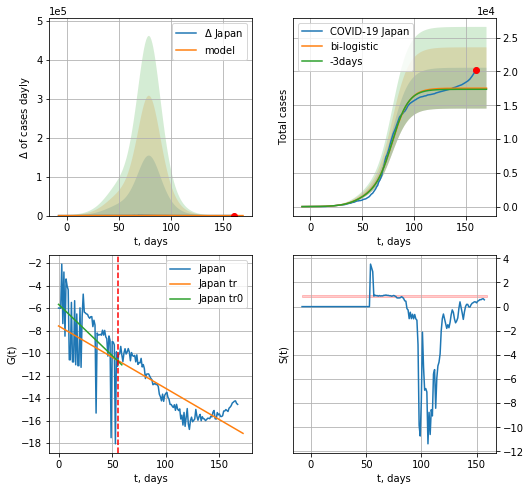

Japan data at: 2020-07-08
+3 day model MAPE: 0.00948053328933906
model: bi-logistic
coeffs:  [1.56602892e+04 1.23104196e-01 7.92834307e+01] [1.86668601e+03 1.09971339e-01 4.74124632e+01]
rational stdev:  0.17241499435318094
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  17526 ± 3021
	 total death:  851 ± 440
bi-logistic approximation splitting point: 55
trend0 coefficient of determination: 0.229818
 intercept: -5.672459
 slope: -0.091119
trend coefficient of determination: 0.712303
 intercept: -7.592952
 slope: -0.055506


In [196]:
dfJP = read_df(pd.DataFrame(),"JP")
try:
    x = forecast('Japan',dfJP[:55],d1,7*16-dT)
    xx = forecast2('Japan',dfJP[:],d1,16*7-dT,x,addpred=False,xcoef=[0.25,1.,1.25],vL=55)
except:
    print ("Exception occurs")

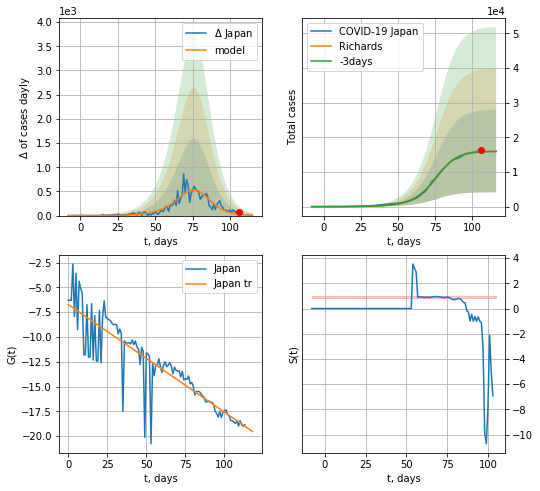

Japan data at: 2020-07-08
+3 day model MAPE: 0.009396
model: Richards
coeffs: [1.61043526e+04 1.05070375e-01 7.85362634e+01 1.40112813e+00]
rational stdev: 0.743333
forecast at the end of period: +10 days
	 deltaDaycases: 7
	 total cases: 16058 ± 11936
	 total death: 780 ± 1739
trend coefficient of determination: 0.778576
 intercept: -6.726919
 slope: -0.108522


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


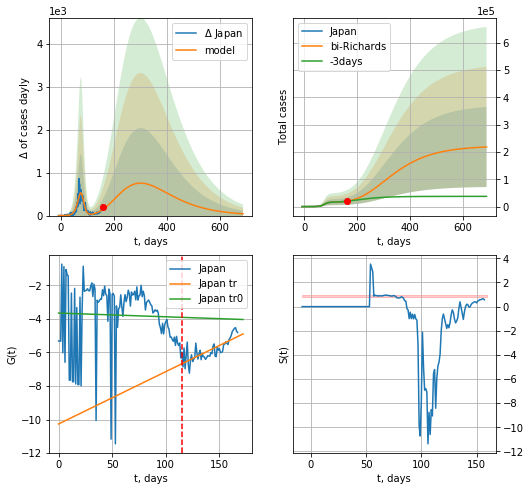

Japan data at: 2020-07-08
+3 day model MAPE: 0.021183
model: bi-Richards
coeffs: [ 2.06443239e+05  6.30985288e-01 -1.10111991e+02  1.59413851e-02]
rational stdev: 0.671134
forecast at the end of period: +528 days
	 deltaDaycases: 41
	 total cases: 218366 ± 146553
	 total death: 10607 ± 21356
bi-Richards approximation splitting point: 115
trend coefficient of determination: 0.001320
 intercept: -3.648973
 slope: -0.002223
trend coefficient of determination: 0.592268
 intercept: -10.261670
 slope: 0.031206


In [198]:
vL = 115
x = forecastRR('Japan',dfJP[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Japan',dfJP[:],d1,90*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


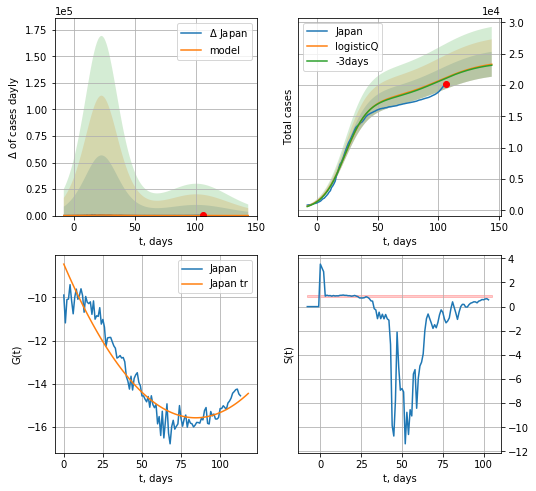

Japan data at: 2020-07-08
+3 day model MAPE: 0.004023
model: logisticQ
coeffs: [ 1.76504215e+04  3.61756642e-07  2.32393336e+01 -2.90344529e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.085286
forecast at the end of period: +38 days
	 deltaDaycases: 28
	 total cases: 23309 ± 1987
	 total death: 1132 ± 289
trend coefficient of determination: 0.919434
 intercept_: -8.456531545509797
 coeffs_: [ 0.         -0.16884062  0.00100015]


In [199]:
x = forecastRRR('Japan',dfJP[54:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


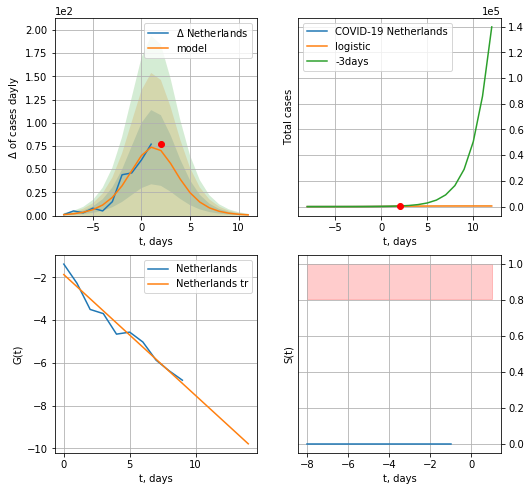

Netherlands data at: 2020-07-08
model: logistic
coeffs:  [487.74708253   0.61204074   1.72557629]
rational stdev:  0.23761280835096962
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  486 ± 115
	 total death:  58 ± 41
trend coefficient of determination: 0.966773
 intercept: -1.876651
 slope: -0.565279


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


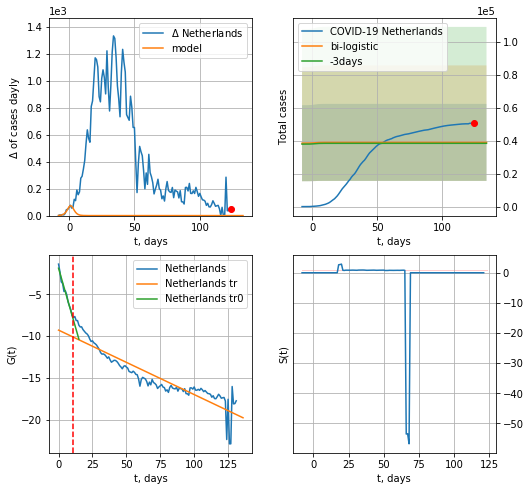

Netherlands data at: 2020-07-08
+3 day model MAPE: 0.014526530526670975
model: bi-logistic
coeffs:  [ 3.08362108e+04 -6.00401825e+00  1.74304962e+02] [487.74708253   0.61204074   1.72557629]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.5996146584477302
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  39033 ± 23404
	 total death:  4718 ± 8486
bi-logistic approximation splitting point: 11
trend0 coefficient of determination: 0.974821
 intercept: -1.878275
 slope: -0.564738
trend coefficient of determination: 0.840511
 intercept: -9.272534
 slope: -0.077000


In [200]:
vL=11
vL1=32
x = forecast('Netherlands',dfNL[:vL],d1,16*7-dT,pMAPE=False)
xx = forecast2('Netherlands',dfNL[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

NL
           date    cases  active   death
128 2020-07-04  50335.6       0  6113.0
129 2020-07-05  50621.0       0  6127.0
130 2020-07-06  50657.0       0  6128.0
131 2020-07-07  50694.0       0  6132.0
132 2020-07-08  50746.0       0  6135.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


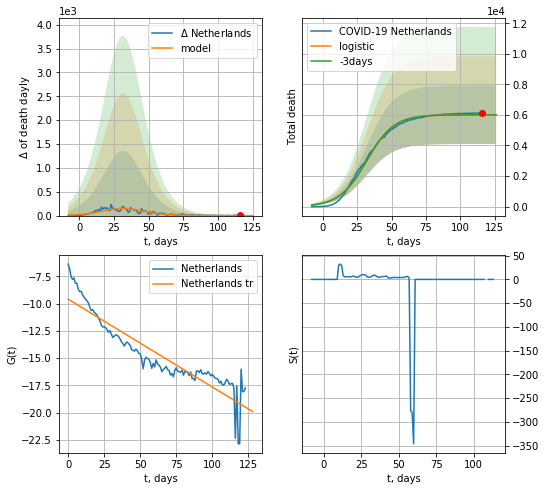

Netherlands data at: 2020-07-08
+3 day model MAPE: 0.0013486259416005102
model: logistic
coeffs:  [6.01441376e+03 1.01189210e-01 3.19760775e+01]
rational stdev:  0.31852971797489465
forecast at the end of period: +10 days
	 total death:  6013 ± 1915
trend coefficient of determination: 0.842790
 intercept: -9.598976
 slope: -0.080504


In [201]:
dfNL = read_df(pd.DataFrame(),"NL")
x = forecast('Netherlands',dfNL[8:],d1,16*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


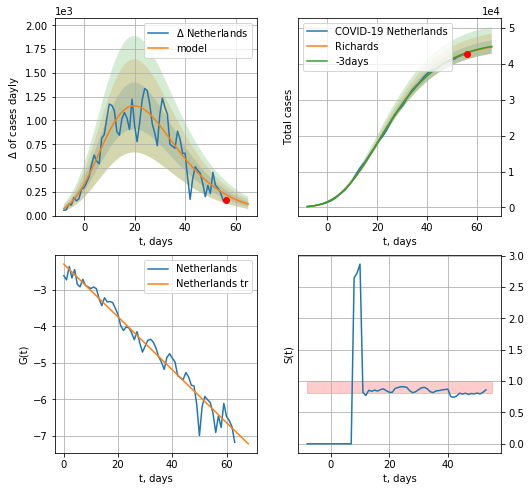

Netherlands data at: 2020-07-08
+3 day model MAPE: 0.002844
model: Richards
coeffs: [ 4.63265250e+04  4.86732663e-01 -5.76573628e+00  1.49500456e-01]
rational stdev: 0.041831
forecast at the end of period: +10 days
	 deltaDaycases: 120
	 total cases: 44688 ± 1869
	 total death: 5402 ± 677
trend coefficient of determination: 0.968459
 intercept: -2.292784
 slope: -0.072448


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


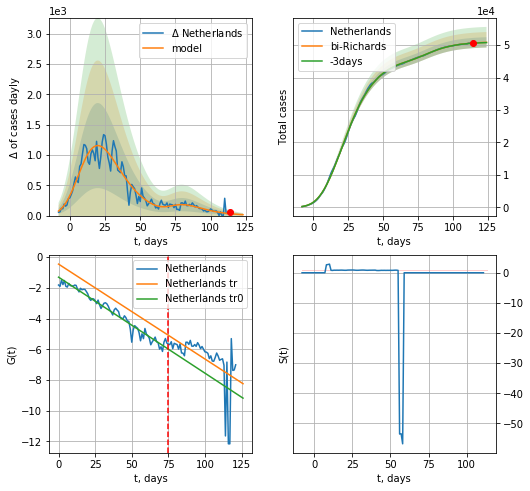

Netherlands data at: 2020-07-08
+3 day model MAPE: 0.001165
model: bi-Richards
coeffs: [4.70494974e+03 7.15730689e+00 2.87769964e+01 1.15137890e-02]
rational stdev: 0.031179
forecast at the end of period: +10 days
	 deltaDaycases: 15
	 total cases: 50849 ± 1585
	 total death: 6147 ± 574
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.960566
 intercept: -1.300706
 slope: -0.062531
trend coefficient of determination: 0.303764
 intercept: -0.450627
 slope: -0.061813


In [202]:
iL = 10
vL = 75 +iL
x = forecastRR('Netherlands',dfNL[iL:vL-iL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Netherlands',dfNL[iL:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


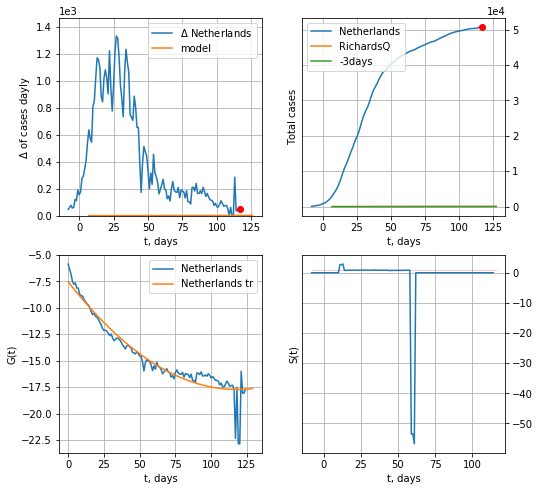

Netherlands data at: 2020-07-08
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 2.85848799e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +10 days
	 deltaDaycases: 1


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [203]:
x = forecastQR('Netherlands',dfNL[7:],d1,16*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


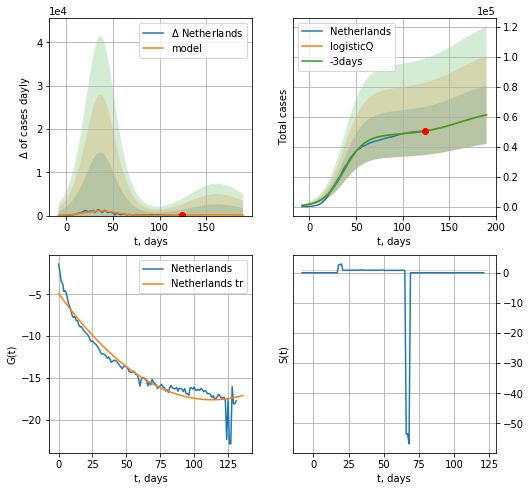

Netherlands data at: 2020-07-08
+3 day model MAPE: 0.003449
model: logisticQ
coeffs: [ 4.80925994e+04  2.35113586e-07  3.70906083e+01 -3.87036308e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.318468
forecast at the end of period: +66 days
	 deltaDaycases: 133
	 total cases: 61470 ± 19576
	 total death: 7431 ± 7099
trend coefficient of determination: 0.921681
 intercept_: -4.904106037508843
 coeffs_: [ 0.         -0.22418291  0.00099005]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


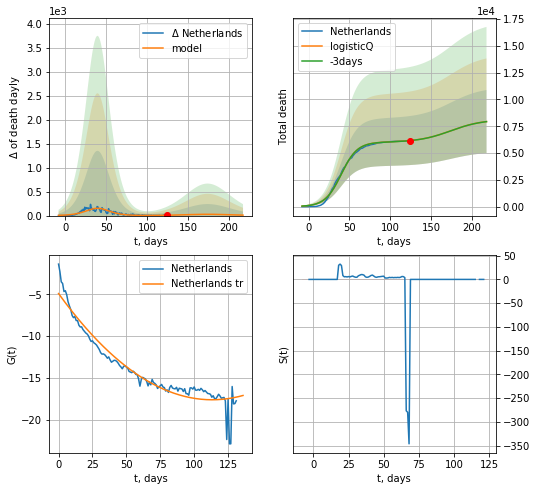

Netherlands data at: 2020-07-08
+3 day model MAPE: 0.001307
model: logisticQ
coeffs: [ 6.01321976e+03  3.74583726e-07  3.99746654e+01 -2.70759187e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.371003
forecast at the end of period: +94 days
	 total death: 7936 ± 2944
trend coefficient of determination: 0.921681
 intercept_: -4.904106037508843
 coeffs_: [ 0.         -0.22418291  0.00099005]


In [204]:
x = forecastRRR('Netherlands',dfNL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Netherlands',dfNL[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

In [205]:
#trend3(dfAT[1:],dfSG[:],dfBG[:],'AT','SG','BG',40,35,35)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


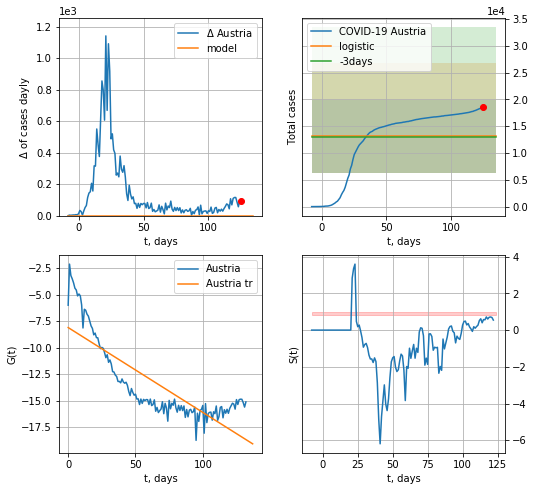

Austria data at: 2020-07-08
+3 day model MAPE: 0.011365022956383688
model: logistic
coeffs:  [12365.36574643   -28.83324693   143.79253841]
scenario coeffs:  [0.0625, 1.0, 2.0]
rational stdev:  0.5172040559949257
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  13138 ± 6795
	 total death:  501 ± 777
trend coefficient of determination: 0.675124
 intercept: -8.111403
 slope: -0.080089


In [206]:
x = forecast('Austria',dfAT[:],d1,7*16-dT,addpred=True,xcoef=[0.25/4,1.,2.0])
#xx = forecast2('Austria',dfAT[:],d1,7*7-dT,x,addpred=True,xcoef=[0.35*2,1.,1.5],vL=36)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


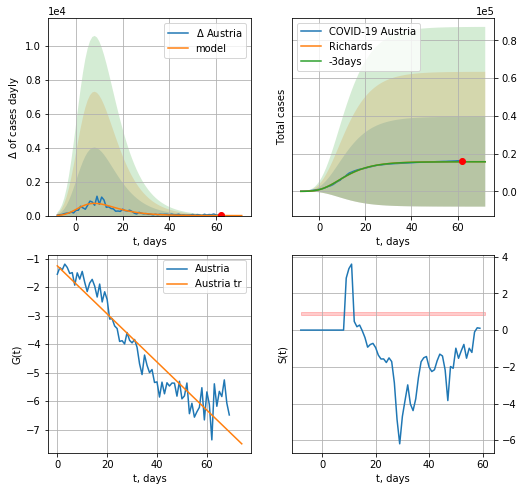

Austria data at: 2020-07-08
+3 day model MAPE: 0.004675
model: Richards
coeffs: [ 1.57373335e+04  1.43837183e+01 -2.95009845e+01  8.70431827e-03]
rational stdev: 1.513265
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 15731 ± 23806
	 total death: 599 ± 2719
trend coefficient of determination: 0.902787
 intercept: -1.255749
 slope: -0.084344


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


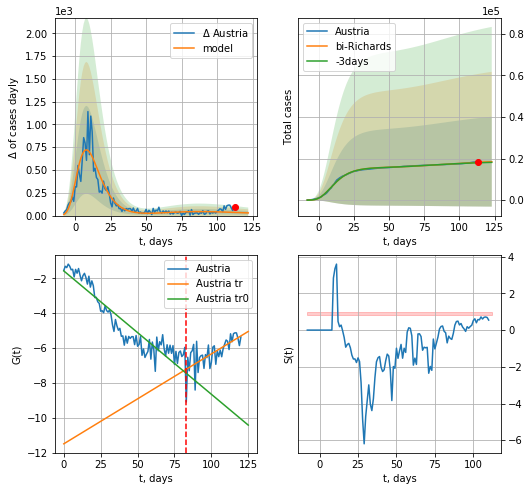

Austria data at: 2020-07-08
+3 day model MAPE: 0.011862
model: bi-Richards
coeffs: [ 3.87817980e+03  4.78059794e+00 -7.59473619e+01  6.42609219e-03]
rational stdev: 1.167422
forecast at the end of period: +10 days
	 deltaDaycases: 29
	 total cases: 18485 ± 21579
	 total death: 704 ± 2465
bi-Richards approximation splitting point: 83
trend coefficient of determination: 0.868024
 intercept: -1.573061
 slope: -0.070816
trend coefficient of determination: 0.447170
 intercept: -11.498442
 slope: 0.051615


In [207]:
vL=83+12
x = forecastRR('Austria',dfAT[12:vL-12],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Austria',dfAT[12:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)
#xx = forecast2R('Austria',dfAT[:],d1,8*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


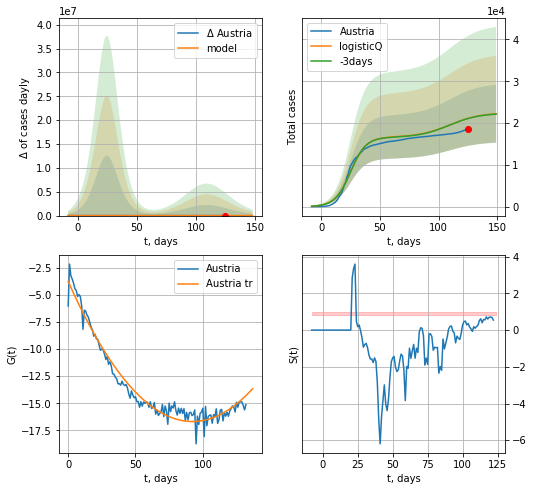

Austria data at: 2020-07-08
+3 day model MAPE: 0.001992
model: logisticQ
coeffs: [ 1.66147655e+04  3.06024350e-07  2.51344553e+01 -4.95443543e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.311620
forecast at the end of period: +24 days
	 deltaDaycases: 20
	 total cases: 22222 ± 6925
	 total death: 847 ± 791
trend coefficient of determination: 0.962561
 intercept_: -3.7257796817230435
 coeffs_: [ 0.         -0.28095966  0.00152176]


In [208]:
vL = 68
x = forecastRRR('Austria',dfAT[:],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR('Austria',dfAT[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=vL)

BG
           date    cases  active   death
125 2020-07-04  61838.0   34976  9771.0
126 2020-07-05  62016.0   35154  9771.0
127 2020-07-06  62058.0   35193  9774.0
128 2020-07-07  62123.0   35162  9776.0
129 2020-07-08  62123.0   35209  9776.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

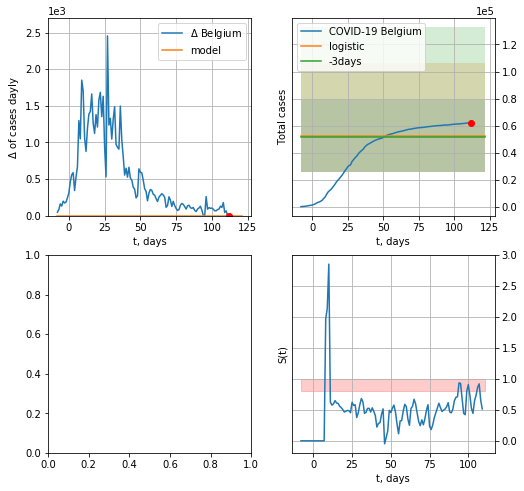

In [209]:
vL=9
dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[vL:],d1,16*7-dT,addpred=True,xcoef=[0.25,1.,3.])
#xx = forecast2('Belgium',dfBG[vL:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

BG
           date    cases  active   death
124 2020-07-03  61727.0   34889  9765.0
125 2020-07-04  61838.0   34976  9771.0
126 2020-07-05  62016.0   35154  9771.0
127 2020-07-06  62058.0   35193  9774.0
128 2020-07-07  62123.0   35162  9776.0


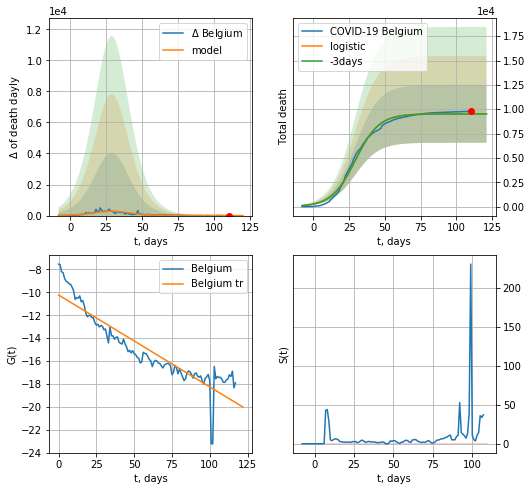

Belgium data at: 2020-07-07
+3 day model MAPE: 0.0016966451161138582
model: logistic
coeffs:  [9.53093914e+03 1.20651178e-01 2.93007672e+01]
rational stdev:  0.31193024345744097
forecast at the end of period: +11 days
	 total death:  9530 ± 2972
trend coefficient of determination: 0.836305
 intercept: -10.229933
 slope: -0.080258


In [363]:
dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[10:],d1,16*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


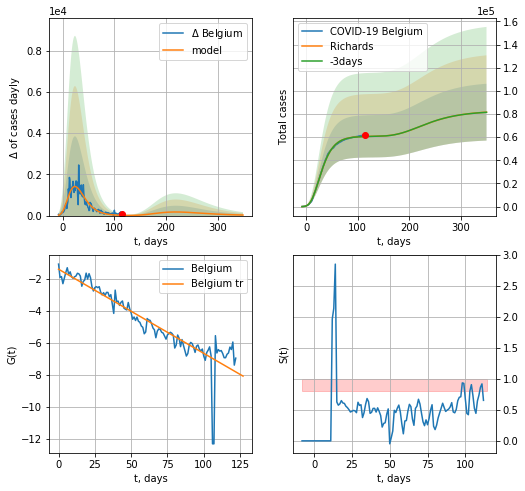

Belgium data at: 2020-07-07
+3 day model MAPE: 0.002134
model: Richards
coeffs: [ 6.08159864e+04  7.62544484e+00 -5.14413479e+01  8.31057621e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.300768
forecast at the end of period: +235 days
	 deltaDaycases: 26
	 total cases: 81588 ± 24539
	 total death: 12849 ± 11593
trend coefficient of determination: 0.836046
 intercept: -1.395838
 slope: -0.052597


In [364]:
x = forecastRR('Belgium',dfBG[5:],d1,48*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


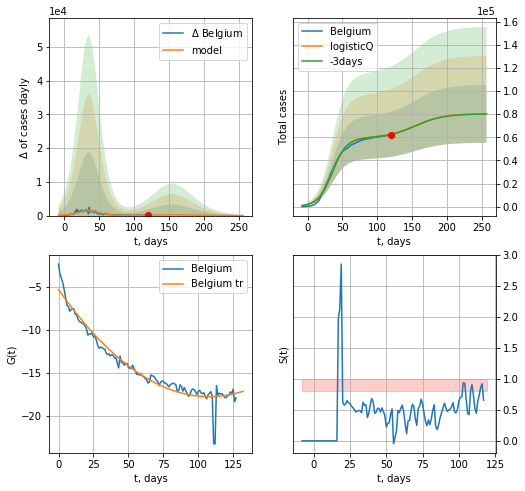

Belgium data at: 2020-07-07
+3 day model MAPE: 0.002736
model: logisticQ
coeffs: [ 5.94402791e+04  3.06109603e-07  3.54925466e+01 -3.16764885e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.312068
forecast at the end of period: +137 days
	 deltaDaycases: 7
	 total cases: 80350 ± 25074
	 total death: 12654 ± 11846
trend coefficient of determination: 0.943336
 intercept_: -5.330954875915904
 coeffs_: [ 0.         -0.23039156  0.00106825]


In [365]:
x = forecastRRR('Belgium',dfBG[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

In [210]:
dfBZ.tail()

,date,cases,active,death
130,2020-07-04,1578376.0,535396,64365.0
131,2020-07-05,1604585.0,561070,64900.0
132,2020-07-06,1626071.0,488286,65556.0
133,2020-07-07,1674655.0,489865,66868.0
134,2020-07-08,1716196.0,495674,68055.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


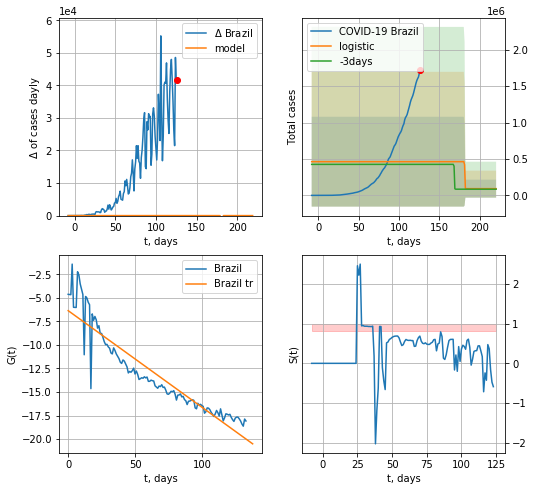

Brazil data at: 2020-07-08
+3 day model MAPE: 0.08680871504146397
model: logistic
coeffs:  [ 3.70430635e+05 -7.18380054e+00  1.81291376e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.3329973264557529
forecast at the end of period: +94 days
	 deltaDaycases:  0
	 total cases:  92607 ± 123445
	 total death:  3672 ± 14684
trend coefficient of determination: 0.866786
 intercept: -6.359570
 slope: -0.102474


In [211]:
x = forecast('Brazil',dfBZ[:],d1,28*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx = forecast2('Brazil',dfBZ[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


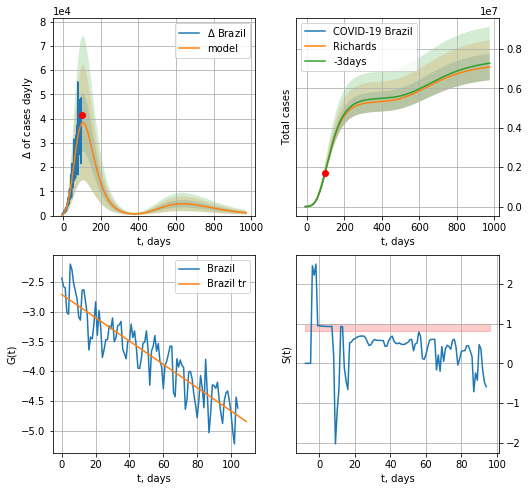

Brazil data at: 2020-07-08
+3 day model MAPE: 0.002170
model: Richards
coeffs: [ 5.32869292e+06  3.23437822e-01 -3.22535309e+01  6.24666428e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.095410
forecast at the end of period: +878 days
	 deltaDaycases: 1159
	 total cases: 7084096 ± 675893
	 total death: 280916 ± 80406
trend coefficient of determination: 0.816876
 intercept: -2.710461
 slope: -0.019577


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


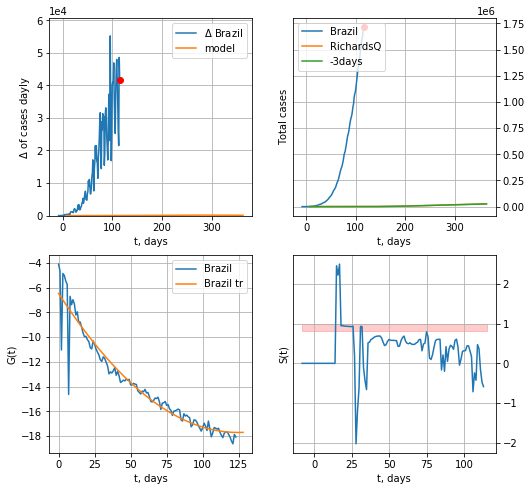

Brazil data at: 2020-07-08
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 3.54597654e+04  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +248 days
	 deltaDaycases: 92


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [213]:
x = forecastRR('Brazil',dfBZ[29:],d1,140*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastQR('Brazil',dfBZ[10:],d1,50*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


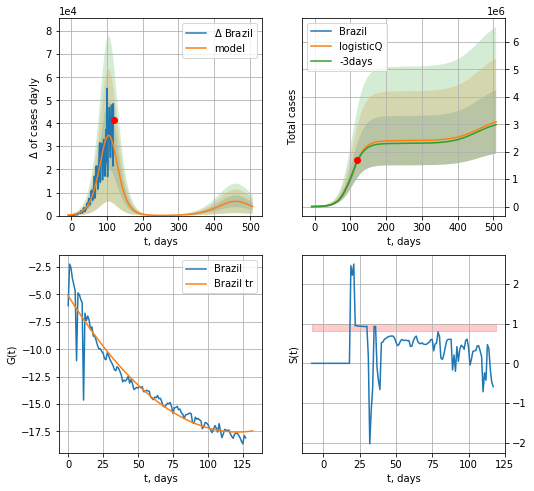

Brazil data at: 2020-07-08
+3 day model MAPE: 0.014422
model: logisticQ
coeffs: [ 2.40361659e+06  1.16663322e-06  1.05472055e+02 -4.95559456e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.373828
forecast at the end of period: +388 days
	 deltaDaycases: 3953
	 total cases: 3087233 ± 1154095
	 total death: 122422 ± 137294
trend coefficient of determination: 0.926996
 intercept_: -5.109339446687928
 coeffs_: [ 0.         -0.2054694   0.00084831]


In [214]:
x = forecastRRR('Brazil',dfBZ[6:],d1,70*7-dT,addpred=True,xcoef=koreaCoeffs)

In [215]:
#x = forecastRRR('Brazil',dfBZ[5:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

AS
           date   cases  active  death
140 2020-07-04  8443.0     940  104.0
141 2020-07-05  8586.0    1060  106.0
142 2020-07-06  8755.0    1194  106.0
143 2020-07-07  8886.0    1293  106.0
144 2020-07-08  9059.0    1380  106.0


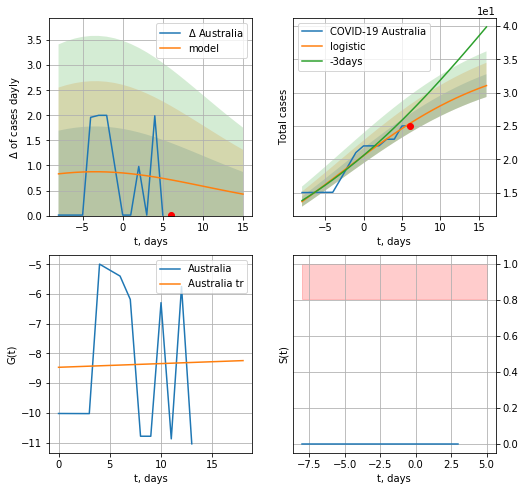

Australia data at: 2020-07-08
model: logistic
coeffs:  [35.98153551  0.09728993 -2.93367767]
rational stdev:  0.0551816162827012
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  31 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.000431
 intercept: -8.467221
 slope: 0.012491


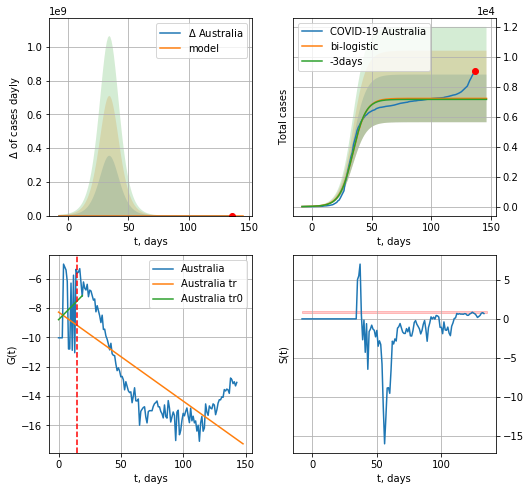

Australia data at: 2020-07-08
+3 day model MAPE: 0.009300613288380423
model: bi-logistic
coeffs:  [7.20796149e+03 1.80210768e-01 3.45866916e+01] [35.98153551  0.09728993 -2.93367767]
rational stdev:  0.2197966332265422
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  7243 ± 1592
	 total death:  84 ± 55
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.022779
 intercept: -8.785888
 slope: 0.086030
trend coefficient of determination: 0.549025
 intercept: -8.270804
 slope: -0.060752


In [216]:
dfAS = read_df(pd.DataFrame(),"AS")
try:
    x = forecast('Australia',dfAS[:15],d1,16*7-dT,pMAPE=False)
    xx = forecast2('Australia',dfAS[:],d1,16*7-dT,x,vL=15,addpred=False,xcoef=[0.25/4,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


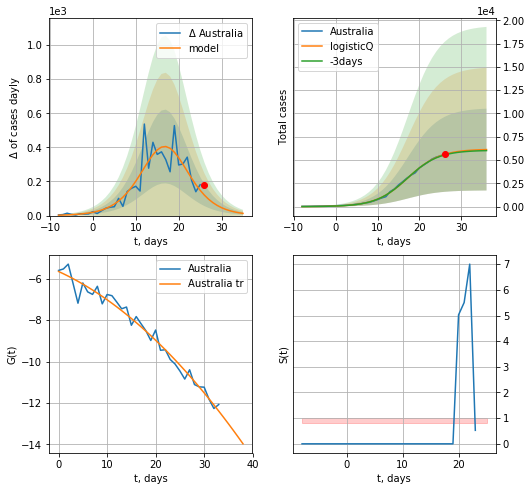

Australia data at: 2020-07-08
+3 day model MAPE: 0.012936
model: logisticQ
coeffs: [ 6.16825959e+03  4.63202537e-05  1.72354346e+01 -5.67168730e+03]
rational stdev: 0.716728
forecast at the end of period: +10 days
	 deltaDaycases: 12
	 total cases: 6125 ± 4390
	 total death: 71 ± 152
trend coefficient of determination: 0.975101
 intercept_: -5.657250296853678
 coeffs_: [ 0.         -0.10702975 -0.00294069]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


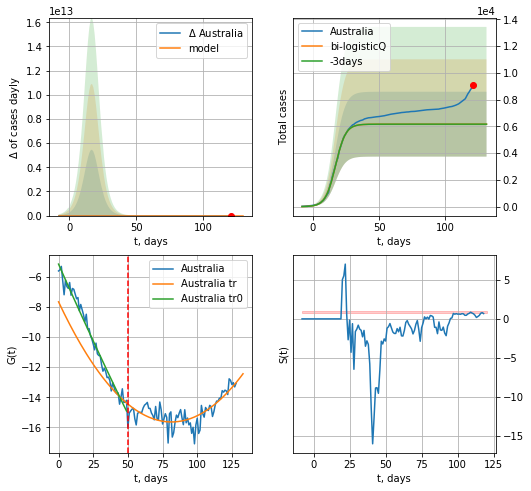

Australia data at: 2020-07-08
+3 day model MAPE: 0.000000
model: bi-logisticQ
coeffs: [-2.48991717 -0.82479074 25.54274931  0.56541618]
rational stdev: 0.392920
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 6168 ± 2423
	 total death: 72 ± 84
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.978786
 intercept_: -5.1508340728883
 coeffs_: [ 0.00000000e+00 -2.09278795e-01  2.06303704e-04]
trend coefficient of determination: 0.587155
 intercept_: -7.6565548671828
 coeffs_: [ 0.         -0.1960423   0.00120382]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [217]:
#axcoef = [koreaCoeffs[0],koreaCoeffs[1],koreaCoeffs[2],koreaCoeffs[3]]
vL = 50
x = forecastRRR('Australia',dfAS[15:vL],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Australia',dfAS[15:],d1,16*7-dT,x,addpred=False,xcoef=koreaCoeffs,vL=vL)

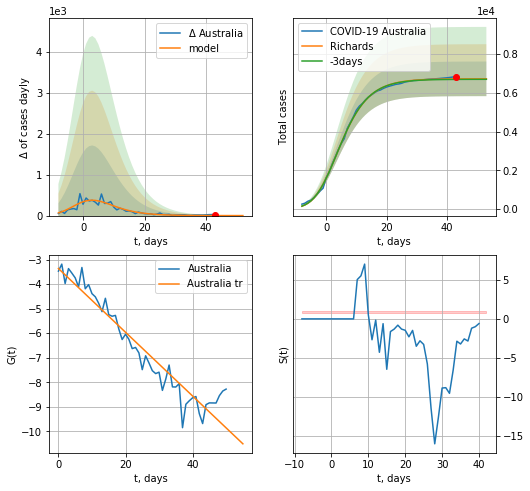

Australia data at: 2020-07-08
+3 day model MAPE: 0.003600
model: Richards
coeffs: [ 6.72783538e+03  5.79545397e-01 -3.45390906e+00  3.01540346e-01]
rational stdev: 0.133001
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 6726 ± 894
	 total death: 78 ± 31
trend coefficient of determination: 0.919763
 intercept: -3.364676
 slope: -0.129802


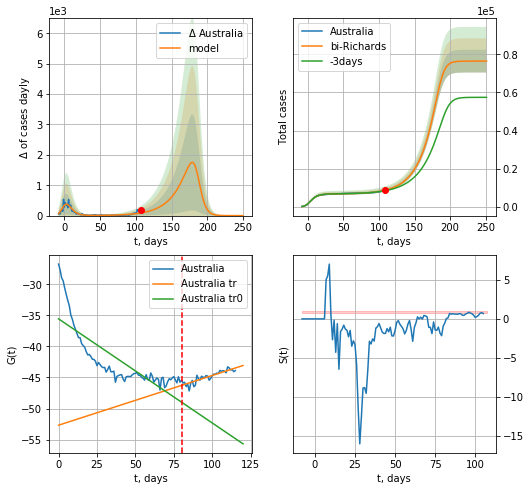

Australia data at: 2020-07-08
+3 day model MAPE: 0.031028
model: bi-Richards
coeffs: [6.97246043e+04 4.53445039e-02 1.86935255e+02 4.38277678e+00]
rational stdev: 0.078218
forecast at the end of period: +143 days
	 deltaDaycases: 0
	 total cases: 76452 ± 5979
	 total death: 894 ± 209
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.655252
 intercept: -35.561971
 slope: -0.167632
trend coefficient of determination: 0.780569
 intercept: -52.681065
 slope: 0.080059


In [218]:
iL = 28
vL = 80+iL
x = forecastRR('Australia',dfAS[iL:vL-iL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Australia',dfAS[iL:],d1,35*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

ML
           date   cases  active  death
128 2020-07-04  8658.0      76  121.0
129 2020-07-05  8668.0      71  121.0
130 2020-07-06  8674.0      72  121.0
131 2020-07-07  8674.5      72  121.0
132 2020-07-08  8677.0      70  121.0


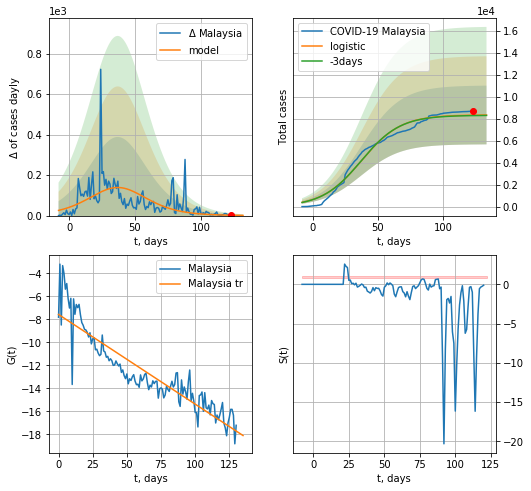

Malaysia data at: 2020-07-08
+3 day model MAPE: 0.004678684697860774
model: logistic
coeffs:  [8.34935000e+03 6.64587963e-02 3.73538117e+01]
rational stdev:  0.3204027441849929
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  8334 ± 2670
	 total death:  116 ± 111
trend coefficient of determination: 0.823625
 intercept: -7.582696
 slope: -0.077966


In [220]:
dfML = read_df(pd.DataFrame(),"ML")
x = forecast('Malaysia',dfML[1:],d1,16*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

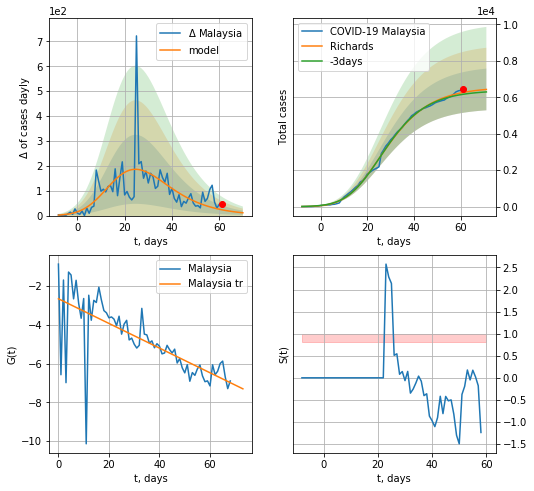

Malaysia data at: 2020-07-08
+3 day model MAPE: 0.016662
model: Richards
coeffs: [6.55738118e+03 3.88579492e-01 7.38231986e+00 2.20014246e-01]
rational stdev: 0.177891
forecast at the end of period: +10 days
	 deltaDaycases: 11
	 total cases: 6429 ± 1143
	 total death: 89 ± 47
trend coefficient of determination: 0.508698
 intercept: -2.652901
 slope: -0.063638


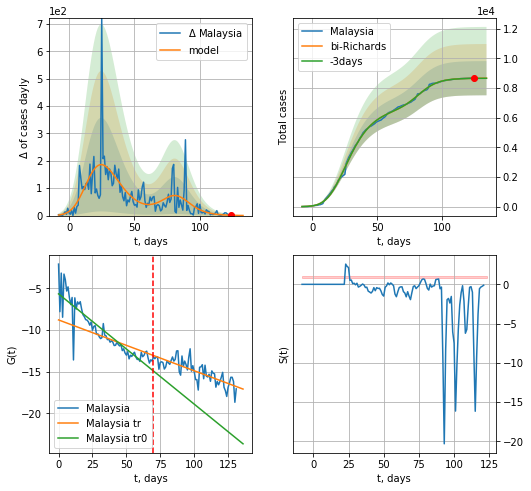

Malaysia data at: 2020-07-08
+3 day model MAPE: 0.000725
model: bi-Richards
coeffs: [2.10856522e+03 1.32529020e-01 8.16729234e+01 9.82039093e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.133088
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 8663 ± 1152
	 total death: 120 ± 47
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.803035
 intercept: -5.660706
 slope: -0.132271
trend coefficient of determination: 0.606481
 intercept: -8.786785
 slope: -0.060986


In [221]:
vL = 70
x = forecastRR('Malaysia',dfML[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Malaysia',dfML[:],d1,16*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


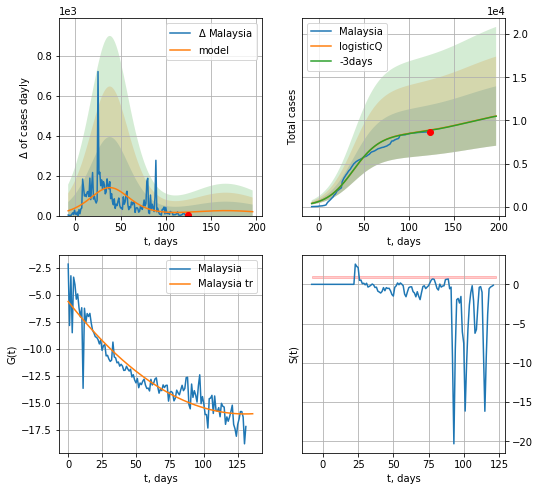

Malaysia data at: 2020-07-08
+3 day model MAPE: 0.003684
model: logisticQ
coeffs: [ 8.34607323e+03  1.16780670e-07  3.83423292e+01 -5.70393468e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.327820
forecast at the end of period: +73 days
	 deltaDaycases: 19
	 total cases: 10507 ± 3444
	 total death: 146 ± 143
trend coefficient of determination: 0.874223
 intercept_: -5.59757452399728
 coeffs_: [ 0.         -0.16038466  0.00061511]


In [222]:
x = forecastRRR('Malaysia',dfML[:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs)

ZL
           date   cases  active  death
127 2020-07-04  1533.0      21   22.0
128 2020-07-05  1534.0      22   22.0
129 2020-07-06  1536.0      22   22.0
130 2020-07-07  1537.0      23   22.0
131 2020-07-08  1540.0      24   22.0


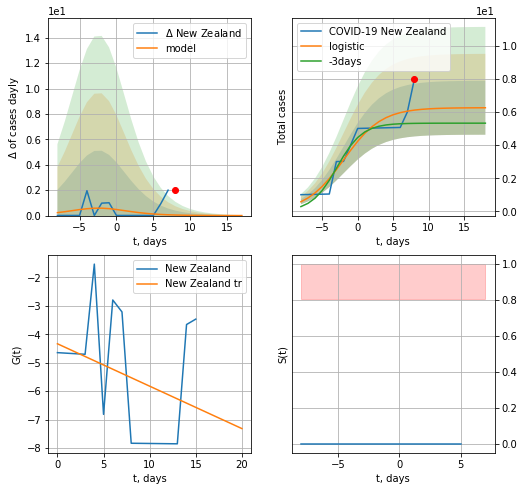

New Zealand data at: 2020-07-08
model: logistic
coeffs:  [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.26005250078288755
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  6 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.103357
 intercept: -4.332661
 slope: -0.149156


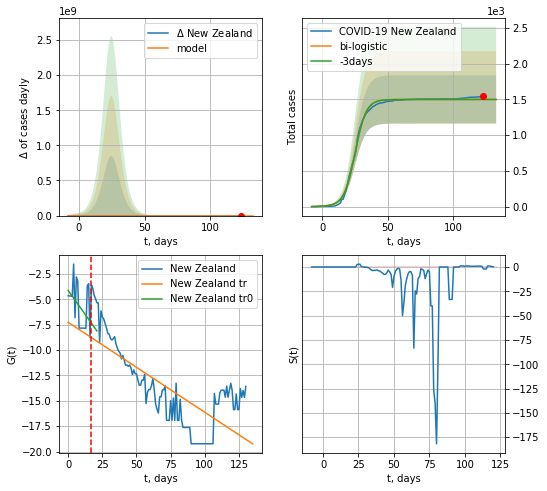

New Zealand data at: 2020-07-08
+3 day model MAPE: 0.0009879447670849484
model: bi-logistic
coeffs:  [1.49251271e+03 2.37924457e-01 2.52040028e+01] [ 6.26235961  0.37662733 -1.95315921]
rational stdev:  0.22523430713263806
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  1498 ± 337
	 total death:  21 ± 14
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.175036
 intercept: -4.131936
 slope: -0.189301
trend coefficient of determination: 0.550772
 intercept: -7.266777
 slope: -0.088704


In [223]:
vL=17
dfZL = read_df(pd.DataFrame(),"ZL")
try:
    x = forecast('New Zealand',dfZL[:vL],d1,16*7-dT,pMAPE=False)
    xx = forecast2('New Zealand',dfZL[:],d1,16*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)#
except:
    print ("Exception occurs")

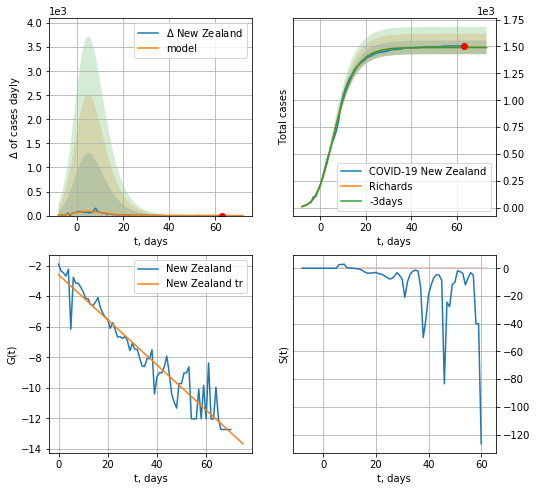

New Zealand data at: 2020-07-08
+3 day model MAPE: 0.000854
model: Richards
coeffs: [ 1.49158630e+03  5.64402224e-01 -5.41494471e-01  3.30453174e-01]
rational stdev: 0.042486
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 1491 ± 63
	 total death: 21 ± 2
trend coefficient of determination: 0.916494
 intercept: -2.603090
 slope: -0.147473


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


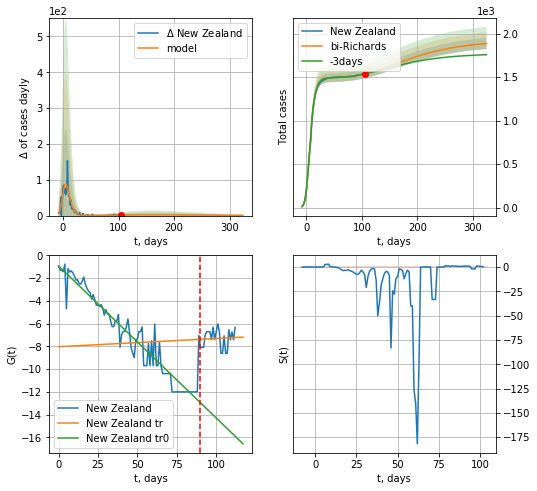

New Zealand data at: 2020-07-08
+3 day model MAPE: 0.001136
model: bi-Richards
coeffs: [ 4.31492283e+02  1.38327023e+00 -1.49273339e+02  1.06079337e-02]
rational stdev: 0.033747
forecast at the end of period: +220 days
	 deltaDaycases: 0
	 total cases: 1886 ± 63
	 total death: 26 ± 2
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.914597
 intercept: -0.919054
 slope: -0.133730
trend coefficient of determination: 0.003433
 intercept: -8.024588
 slope: 0.007184


In [226]:
vL = 90 + 18
x = forecastRR('New Zealand',dfZL[18:vL-18],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('New Zealand',dfZL[18:],d1,46*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-18)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


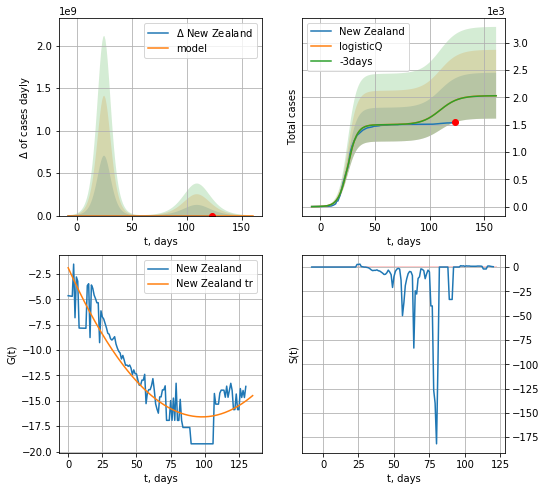

New Zealand data at: 2020-07-08
+3 day model MAPE: 0.000584
model: logisticQ
coeffs: [ 1.49898602e+03  1.84140378e-06  2.51567737e+01 -1.27958103e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.206625
forecast at the end of period: +38 days
	 deltaDaycases: 0
	 total cases: 2028 ± 419
	 total death: 28 ± 17
trend coefficient of determination: 0.852943
 intercept_: -1.8907686318154457
 coeffs_: [ 0.         -0.29986162  0.0015299 ]


In [227]:
x = forecastRRR('New Zealand',dfZL[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

BR
           date    cases  active  death
127 2020-07-04  63270.0   12183  418.0
128 2020-07-05  63554.0   12260  423.0
129 2020-07-06  63804.0   12255  429.0
130 2020-07-07  64003.0   11665  436.0
131 2020-07-08  64224.0   10927  443.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


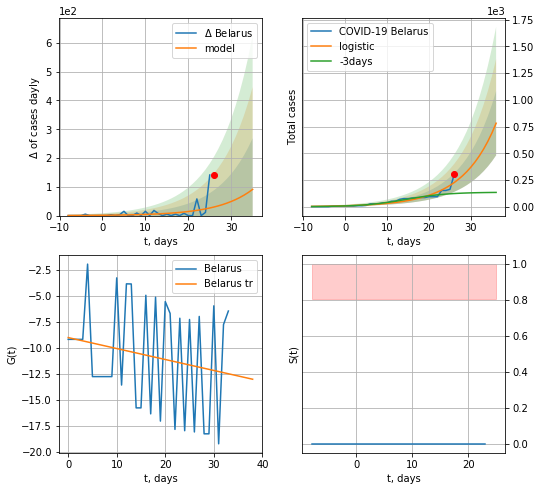

Belarus data at: 2020-07-08
+3 day model MAPE: 1.0426298586333318
model: logistic
coeffs:  [1.42197961e+06 1.24002034e-01 9.65329254e+01]
rational stdev:  0.38452901172178605
forecast at the end of period: +10 days
	 deltaDaycases:  91
	 total cases:  781 ± 300
	 total death:  5 ± 5
trend coefficient of determination: 0.039182
 intercept: -9.040329
 slope: -0.105417


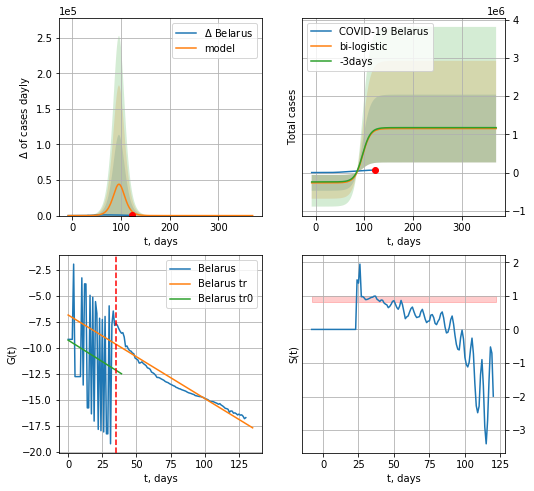

Belarus data at: 2020-07-08
+3 day model MAPE: 0.021187768300689885
model: bi-logistic
coeffs:  [-2.69466125e+05  2.84195014e+01 -6.55043155e+02] [1.42197961e+06 1.24002034e-01 9.65329254e+01]
rational stdev:  0.7697343749365831
forecast at the end of period: +248 days
	 deltaDaycases:  0
	 total cases:  1152513 ± 887129
	 total death:  7949 ± 18355
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.026128
 intercept: -9.289300
 slope: -0.082783
trend coefficient of determination: 0.933234
 intercept: -6.870425
 slope: -0.080366


In [228]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:35],d1,7*16-dT)
xx = forecast2('Belarus',dfBR[:],d1,50*7-dT,x,addpred=False,xcoef=[0.25,1.,1.8],vL=35)

BR
           date    cases  active  death
127 2020-07-04  63270.0   12183  418.0
128 2020-07-05  63554.0   12260  423.0
129 2020-07-06  63804.0   12255  429.0
130 2020-07-07  64003.0   11665  436.0
131 2020-07-08  64224.0   10927  443.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


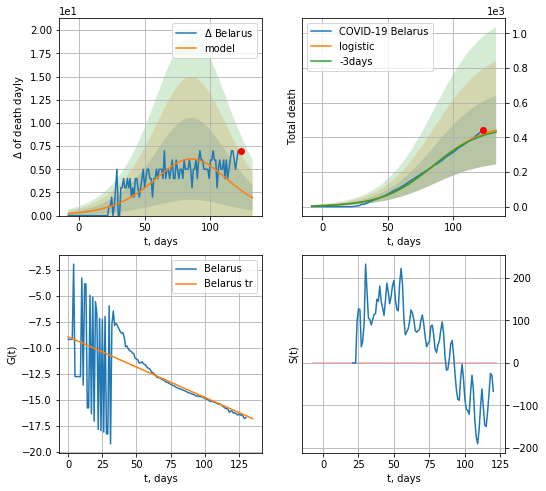

Belarus data at: 2020-07-08
+3 day model MAPE: 0.022002356248646382
model: logistic
coeffs:  [4.82197526e+02 5.07696072e-02 8.58774954e+01]
rational stdev:  0.4491422849417737
forecast at the end of period: +10 days
	 total death:  441 ± 198
trend coefficient of determination: 0.386974
 intercept: -8.958667
 slope: -0.058350


In [229]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:],d1,16*7-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


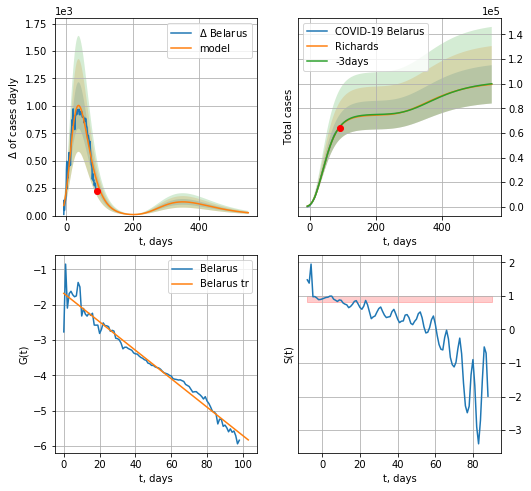

Belarus data at: 2020-07-08
+3 day model MAPE: 0.003631
model: Richards
coeffs: [ 7.45215650e+04  2.45553151e+00 -7.68508707e+01  1.50293986e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.156375
forecast at the end of period: +458 days
	 deltaDaycases: 25
	 total cases: 99391 ± 15542
	 total death: 685 ± 321
trend coefficient of determination: 0.967167
 intercept: -1.682516
 slope: -0.040256


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


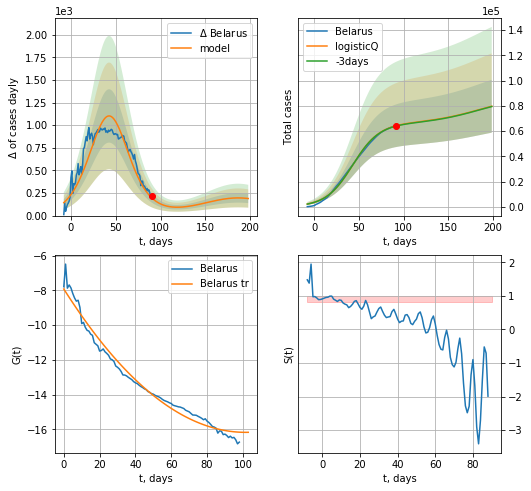

Belarus data at: 2020-07-08
+3 day model MAPE: 0.004170
model: logisticQ
coeffs: [ 6.58017249e+04  5.02104994e-07  4.29713225e+01 -1.32658235e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.262898
forecast at the end of period: +108 days
	 deltaDaycases: 188
	 total cases: 79709 ± 20955
	 total death: 549 ± 432
trend coefficient of determination: 0.978346
 intercept_: -7.919922734296992
 coeffs_: [ 0.         -0.16277412  0.00080203]


In [230]:
x = forecastRR('Belarus',dfBR[32:],d1,80*7-dT,addpred=True,xcoef=RkoreaCoeffs)
x = forecastRRR('Belarus',dfBR[32:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


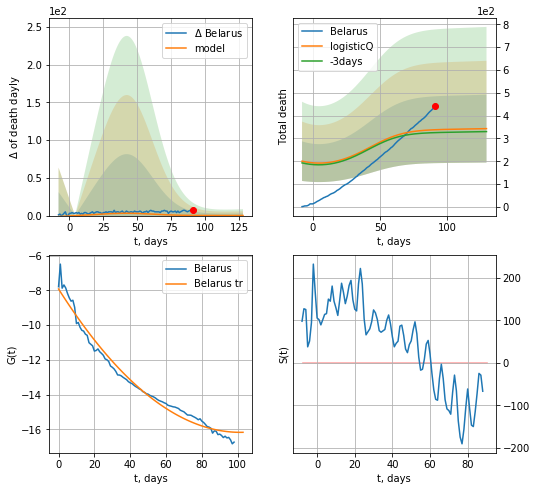

Belarus data at: 2020-07-08
+3 day model MAPE: 0.038865
model: logisticQ
coeffs: [ 2.86271938e+02  7.30591054e-04  1.01517185e+01 -9.00648410e-01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.433668
forecast at the end of period: +38 days
	 total death: 342 ± 148
trend coefficient of determination: 0.978346
 intercept_: -7.919922734296992
 coeffs_: [ 0.         -0.16277412  0.00080203]


In [231]:
x = forecastRRR('Belarus',dfBR[32:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

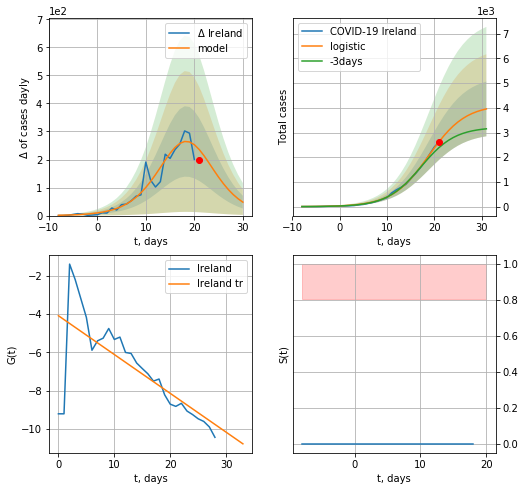

Ireland data at: 2020-07-08
+3 day model MAPE: 0.12282208812559416
model: logistic
coeffs:  [4.12730398e+03 2.56984382e-01 1.88154165e+01]
rational stdev:  0.27980533262906077
forecast at the end of period: +10 days
	 deltaDaycases:  47
	 total cases:  3954 ± 1106
	 total death:  269 ± 225
trend coefficient of determination: 0.521820
 intercept: -4.083344
 slope: -0.202899


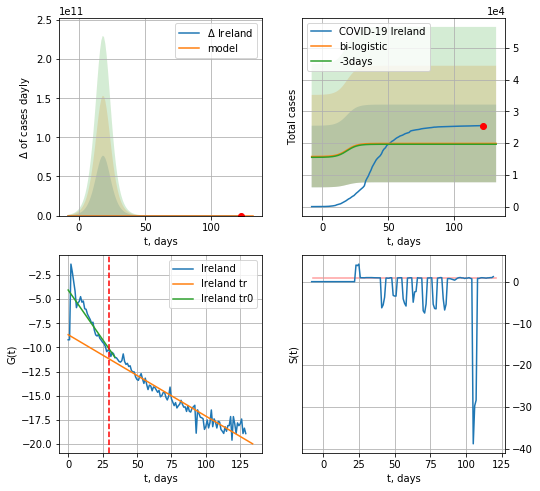

Ireland data at: 2020-07-08
+3 day model MAPE: 0.013072027286195838
model: bi-logistic
coeffs:  [ 1.26355001e+04 -1.05217160e+01  2.64940917e+02] [4.12730398e+03 2.56984382e-01 1.88154165e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.6148880088554443
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  19921 ± 12249
	 total death:  1355 ± 2499
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.551550
 intercept: -4.065434
 slope: -0.204818
trend coefficient of determination: 0.926365
 intercept: -8.686054
 slope: -0.084210


In [232]:
vL=30
x = forecast('Ireland',dfIR[:vL],d1,16*7-dT)
xx = forecast2('Ireland',dfIR[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


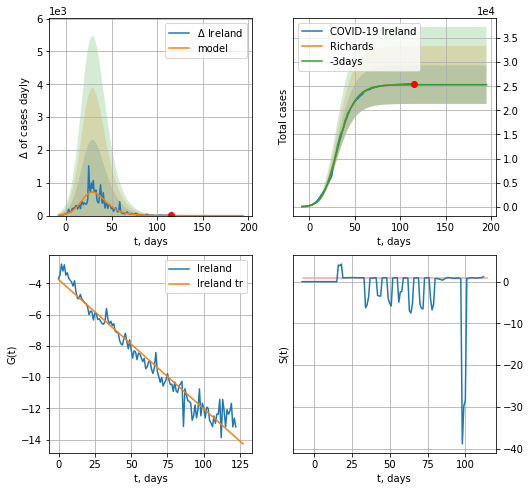

Ireland data at: 2020-07-08
+3 day model MAPE: 0.000679
model: Richards
coeffs: [2.53424835e+04 2.13425185e-01 2.07338503e+01 4.36257508e-01]
rational stdev: 0.157623
forecast at the end of period: +80 days
	 deltaDaycases: 0
	 total cases: 25342 ± 3994
	 total death: 1724 ± 815
trend coefficient of determination: 0.956513
 intercept: -3.747718
 slope: -0.082879


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


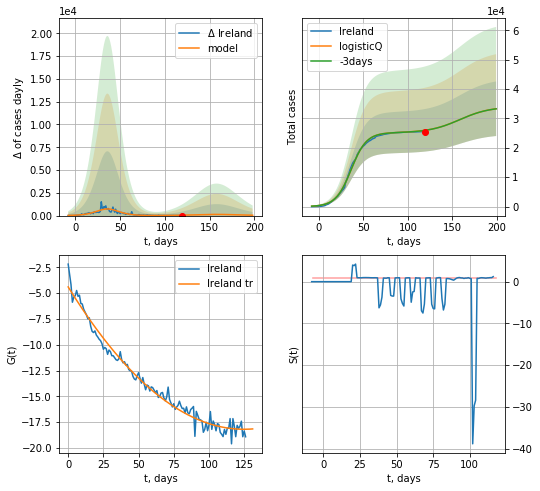

Ireland data at: 2020-07-08
+3 day model MAPE: 0.000971
model: logisticQ
coeffs: [ 2.51384370e+04  7.12575069e-07  3.62825449e+01 -1.63018410e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.278728
forecast at the end of period: +80 days
	 deltaDaycases: 41
	 total cases: 33293 ± 9279
	 total death: 2265 ± 1893
trend coefficient of determination: 0.979335
 intercept_: -4.4063508181827
 coeffs_: [ 0.         -0.22075     0.00088403]


In [233]:
ivL = 7
vL = 90 + ivL
x = forecastRR('Ireland',dfIR[7:],d1,26*7-dT,addpred=False,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Ireland',dfIR[7:],d1,26*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-ivL)
x = forecastRRR('Ireland',dfIR[3:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

CL
           date   cases  active   death
123 2020-07-04  291847   28210  6192.0
124 2020-07-05  295532   28192  6308.0
125 2020-07-06  298557   27802  6384.0
126 2020-07-07  301019   26340  6434.0
127 2020-07-08  303083   24807  6573.0


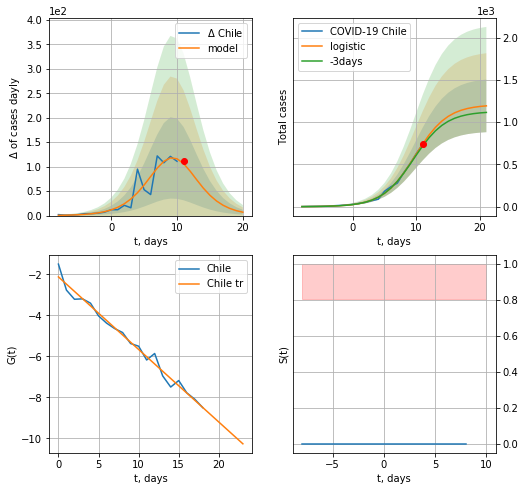

Chile data at: 2020-07-08
+3 day model MAPE: 0.03908987806693812
model: logistic
coeffs:  [1.20759839e+03 3.93191843e-01 9.80781865e+00]
rational stdev:  0.2610672451056305
forecast at the end of period: +10 days
	 deltaDaycases:  6
	 total cases:  1192 ± 311
	 total death:  25 ± 19
trend coefficient of determination: 0.982168
 intercept: -2.127319
 slope: -0.354074


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


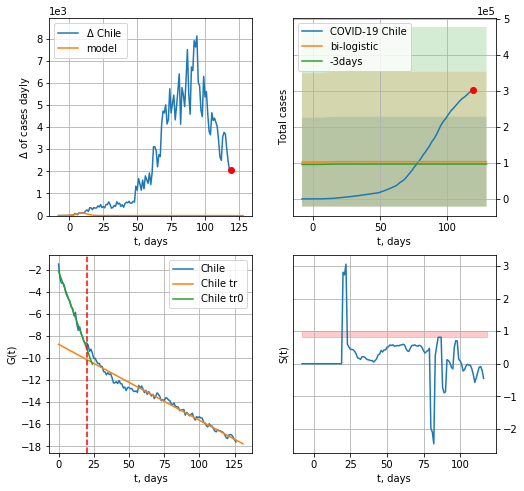

Chile data at: 2020-07-08
+3 day model MAPE: 0.06727855363785044
model: bi-logistic
coeffs:  [ 8.19347047e+04 -1.80446292e+01  4.41890367e+02] [1.20759839e+03 3.93191843e-01 9.80781865e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.2062208070393332
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  103625 ± 124995
	 total death:  2247 ± 8131
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.984051
 intercept: -2.144368
 slope: -0.351232
trend coefficient of determination: 0.965592
 intercept: -8.767587
 slope: -0.068776


In [234]:
vL=20
dfCL = read_df(pd.DataFrame(),"CL")
x = forecast('Chile',dfCL[:vL],d1,7*16-dT)
xx = forecast2('Chile',dfCL[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


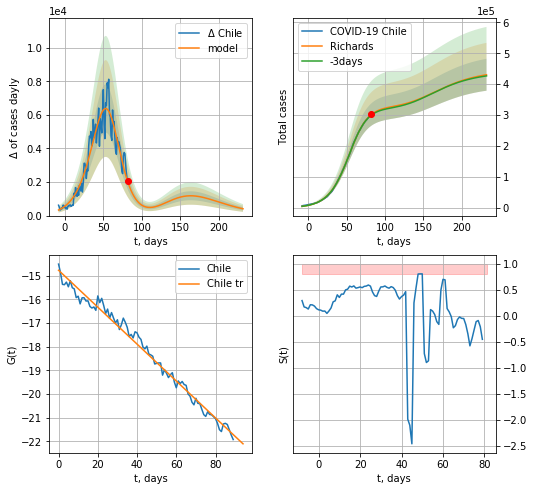

Chile data at: 2020-07-08
+3 day model MAPE: 0.006160
model: Richards
coeffs: [3.26781201e+05 6.42037390e-02 5.69760724e+01 1.34216477e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.119695
forecast at the end of period: +150 days
	 deltaDaycases: 406
	 total cases: 430461 ± 51523
	 total death: 9335 ± 3352
trend coefficient of determination: 0.985834
 intercept: -14.762920
 slope: -0.078156


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


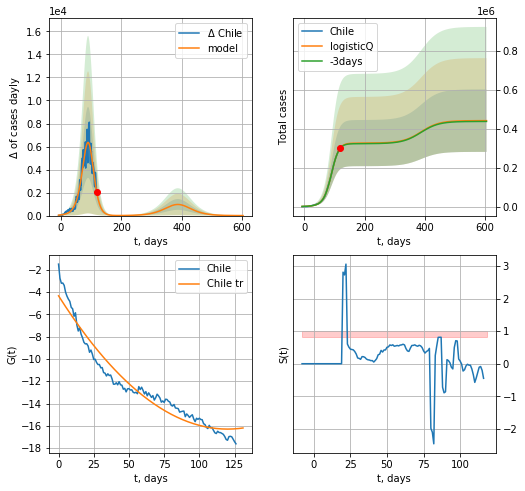

Chile data at: 2020-07-08
+3 day model MAPE: 0.004600
model: logisticQ
coeffs: [ 3.26550743e+05  1.62018251e-04  8.89484755e+01 -3.90517390e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.363486
forecast at the end of period: +486 days
	 deltaDaycases: 2
	 total cases: 442139 ± 160711
	 total death: 9588 ± 10455
trend coefficient of determination: 0.946495
 intercept_: -4.346002320979919
 coeffs_: [ 0.         -0.19901614  0.00082891]


In [235]:
vL = 20+10
x = forecastRR('Chile',dfCL[37:],d1,36*7-dT,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Chile',dfCL[10:],d1,40*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL-10)
x = forecastRRR('Chile',dfCL[:],d1,84*7-dT,addpred=True,xcoef=koreaCoeffs)

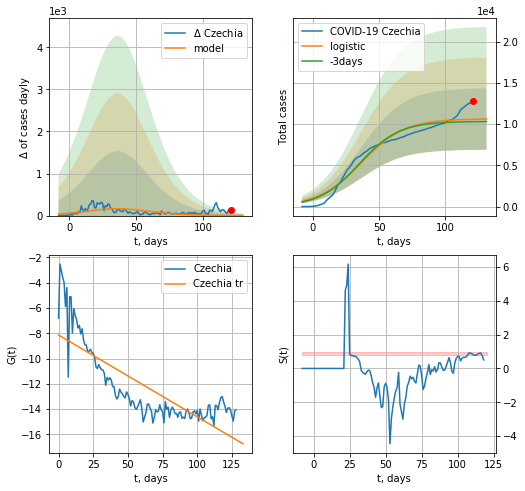

Czechia data at: 2020-07-08
+3 day model MAPE: 0.028526634748838493
model: logistic
coeffs:  [1.06398813e+04 6.15892277e-02 3.66345605e+01]
rational stdev:  0.3507595708843997
forecast at the end of period: +10 days
	 deltaDaycases:  2
	 total cases:  10608 ± 3720
	 total death:  290 ± 305
trend coefficient of determination: 0.645510
 intercept: -8.141599
 slope: -0.064707


In [236]:
x = forecast('Czechia',dfCH[:],d1,16*7-dT,shift=1.,addpred=False,xcoef=[0.25,1.,2.4])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


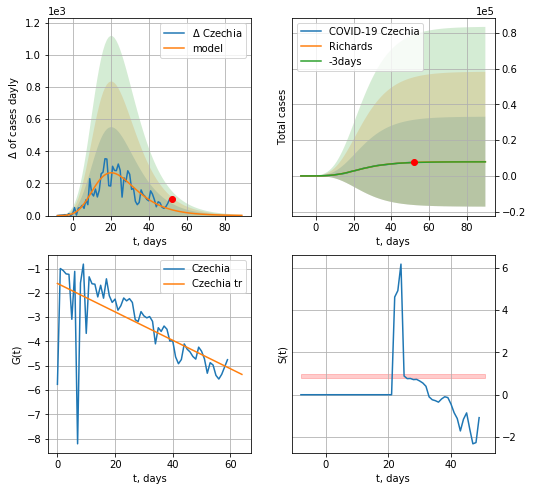

Czechia data at: 2020-07-08
+3 day model MAPE: 0.007833
model: Richards
coeffs: [ 7.98936728e+03  1.90702295e+00 -1.17113715e+01  4.87284384e-02]
rational stdev: 3.153560
forecast at the end of period: +38 days
	 deltaDaycases: 1
	 total cases: 7976 ± 25154
	 total death: 218 ± 2062
trend coefficient of determination: 0.449014
 intercept: -1.614154
 slope: -0.058414


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


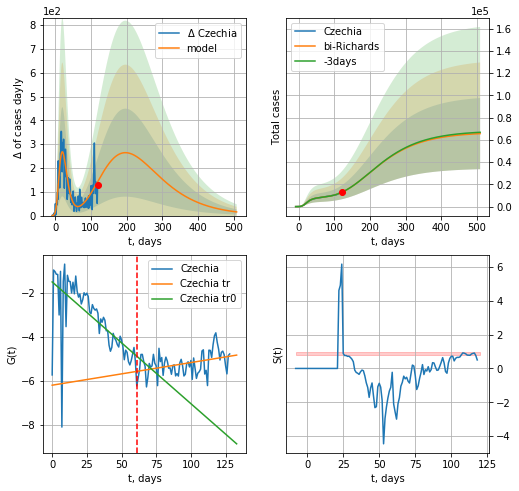

Czechia data at: 2020-07-08
+3 day model MAPE: 0.000145
model: bi-Richards
coeffs: [ 5.89326563e+04  6.69213558e-01 -1.27487316e+02  1.83851059e-02]
rational stdev: 0.487303
forecast at the end of period: +388 days
	 deltaDaycases: 15
	 total cases: 65662 ± 31997
	 total death: 1798 ± 2628
bi-Richards approximation splitting point: 61
trend coefficient of determination: 0.429800
 intercept: -1.493127
 slope: -0.055421
trend coefficient of determination: 0.148038
 intercept: -6.194985
 slope: 0.010302


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


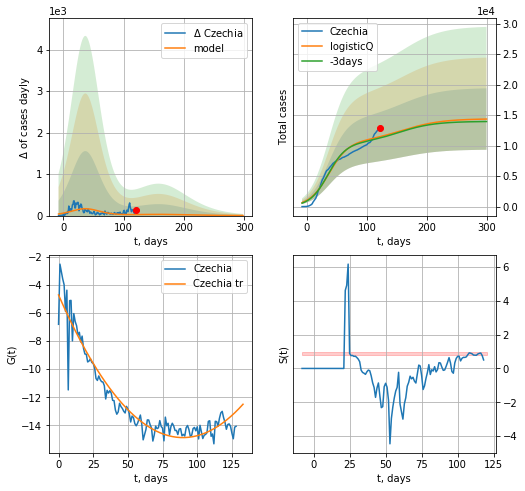

Czechia data at: 2020-07-08
+3 day model MAPE: 0.019828
model: logisticQ
coeffs: [ 1.06398806e+04  6.92146927e-08  3.66352578e+01 -8.89455705e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.350785
forecast at the end of period: +178 days
	 deltaDaycases: 1
	 total cases: 14358 ± 5036
	 total death: 393 ± 413
trend coefficient of determination: 0.917611
 intercept_: -4.724359532144734
 coeffs_: [ 0.         -0.22615396  0.00126131]


In [237]:
vL= 61
x = forecastRR('Czechia',dfCH[:vL],d1,20*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Czechia',dfCH[:],d1,70*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRRR('Czechia',dfCH[:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

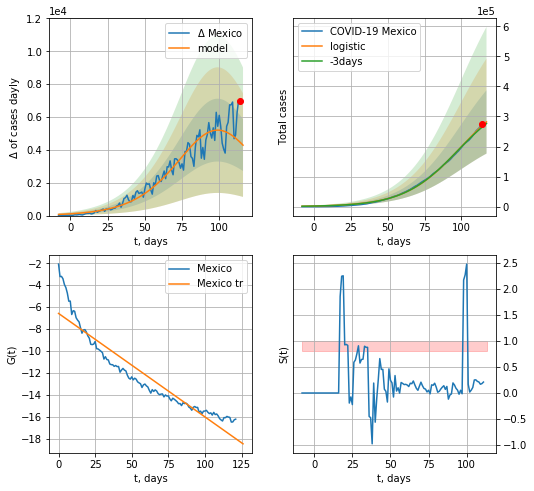

Mexico data at: 2020-07-08
+3 day model MAPE: 0.01769050782333025
model: logistic
coeffs:  [3.89856475e+05 5.31250859e-02 9.92160722e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.373757308416143
forecast at the end of period: +3 days
	 deltaDaycases:  4288
	 total cases:  281992 ± 105396
	 total death:  33629 ± 37707
trend coefficient of determination: 0.885672
 intercept: -6.569867
 slope: -0.094224


In [238]:
x = forecast('Mexico',dfMX[:],d1,15*7-dT,addpred=True,xcoef=[.25,1.,2.])#

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


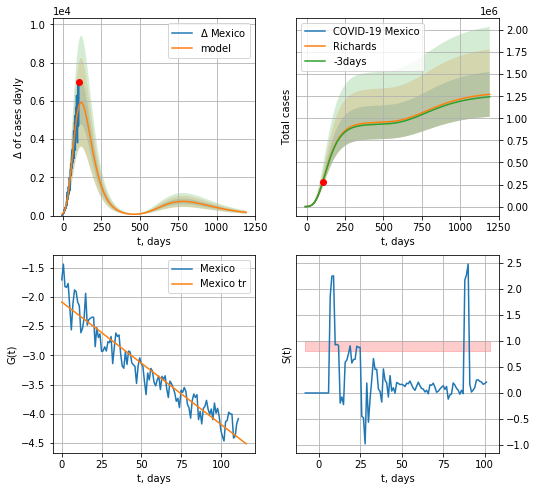

Mexico data at: 2020-07-08
+3 day model MAPE: 0.002523
model: Richards
coeffs: [ 9.55183732e+05  5.21561598e-01 -8.10036321e+01  3.28548133e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.200082
forecast at the end of period: +1088 days
	 deltaDaycases: 165
	 total cases: 1271891 ± 254482
	 total death: 151681 ± 91045
trend coefficient of determination: 0.914157
 intercept: -2.087338
 slope: -0.020912


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


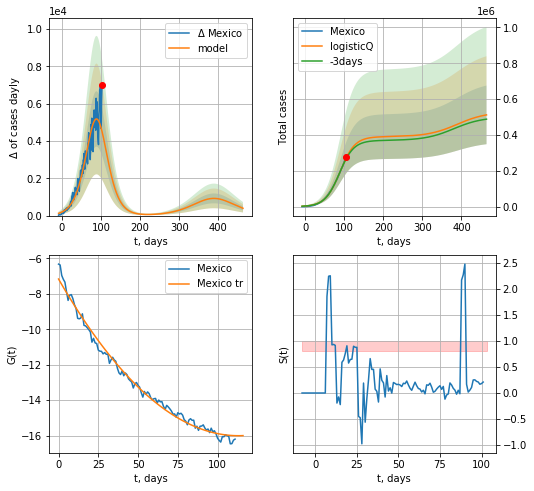

Mexico data at: 2020-07-08
+3 day model MAPE: 0.017893
model: logisticQ
coeffs: [ 3.90350444e+05  9.47608151e-07  8.92704110e+01 -5.59201490e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.319677
forecast at the end of period: +360 days
	 deltaDaycases: 391
	 total cases: 512090 ± 163703
	 total death: 61070 ± 58568
trend coefficient of determination: 0.989752
 intercept_: -7.164281341753024
 coeffs_: [ 0.         -0.15627982  0.00069079]


In [239]:
x = forecastRR('Mexico',dfMX[10:],d1,170*7-dT,addpred=True,xcoef=RkoreaCoeffs)#
x = forecastRRR('Mexico',dfMX[10:],d1,66*7-dT,addpred=True,xcoef=koreaCoeffs)#

LT
           date   cases  active  death     tests
117 2020-07-04  1836.0     201   79.0  442242.0
118 2020-07-05  1841.0     215   79.0  443242.0
119 2020-07-06  1844.0     218   79.0  444407.0
120 2020-07-07  1854.0     223   79.0  447994.0
121 2020-07-08  1854.0     223   79.0       NaN
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


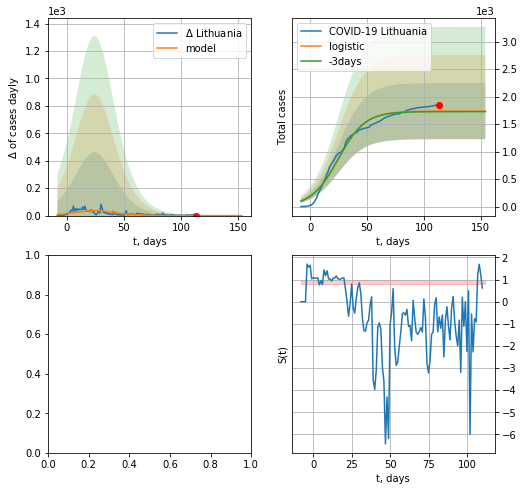

In [240]:
vL = 17
dfLT = read_df(pd.DataFrame(),"LT")
try:
    x = forecast('Lithuania',dfLT[:],d1,6*7-1)
except:
    print("Exception occurs")
#xx = forecast2('Lithuania',dfLT[:],d1,8*7-1,x,shift=1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

In [372]:
#dfLT = read_df(pd.DataFrame(),"LT")
#plt.plot(range(len(dfLT[3:])),dfLT[3:].cases/dfLT[3:].tests)

#plt.grid()#

In [373]:
#np.diff(dfLT["cases"])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: invalid value encountered in true_divide


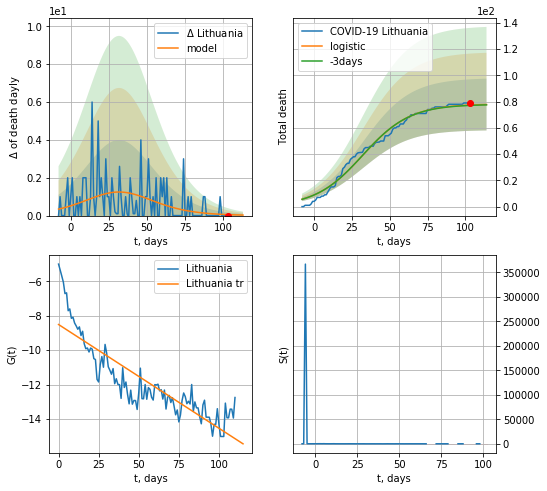

Lithuania data at: 2020-07-07
+3 day model MAPE: 0.0032438936945038293
model: logistic
coeffs:  [7.82445549e+01 6.36933119e-02 3.21295937e+01]
rational stdev:  0.25350099159023304
forecast at the end of period: +11 days
	 total death:  77 ± 19
trend coefficient of determination: 0.759305
 intercept: -8.509760
 slope: -0.060226


In [374]:
x = forecast('Lithuania',dfLT[9:],d1,7*16-dT,cases='death')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


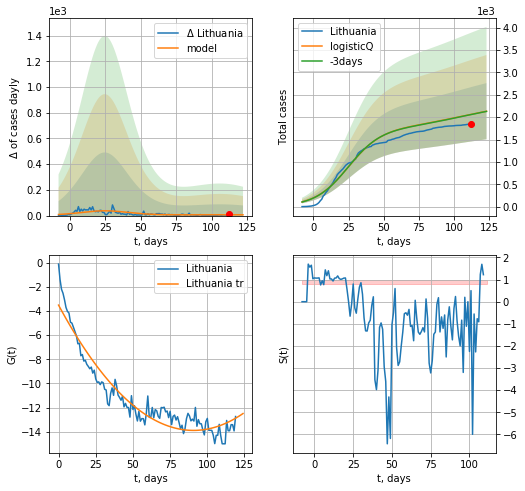

Lithuania data at: 2020-07-07
+3 day model MAPE: 0.002147
model: logisticQ
coeffs: [ 1.73281261e+03  1.48161998e-07  2.48167427e+01 -5.71602192e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.294610
forecast at the end of period: +11 days
	 deltaDaycases: 6
	 total cases: 2133 ± 628
	 total death: 91 ± 80
trend coefficient of determination: 0.910253
 intercept_: -3.5055245109976862
 coeffs_: [ 0.         -0.22915055  0.00126306]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


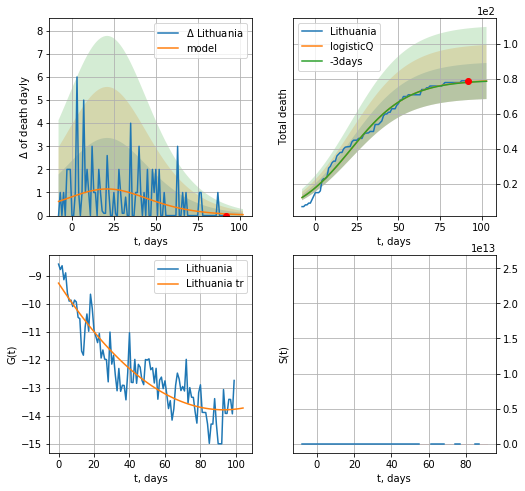

Lithuania data at: 2020-07-07
+3 day model MAPE: 0.001789
model: logisticQ
coeffs: [ 7.95667147e+01  3.60485373e-07  2.14258677e+01 -1.60689247e+05]
rational stdev: 0.130893
forecast at the end of period: +11 days
	 total death: 78 ± 10
trend coefficient of determination: 0.821041
 intercept_: -9.269400391470839
 coeffs_: [ 0.         -0.09727751  0.00052275]


In [375]:
#x = forecast('Lithuania',dfLT[10-4:],d1,6*7-1,cases='active')
x = forecastRRR('Lithuania',dfLT[:],d1,16*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Lithuania',dfLT[20:],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


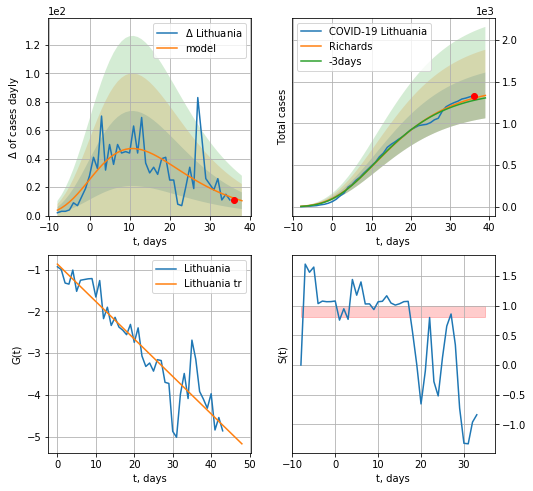

Lithuania data at: 2020-07-07
+3 day model MAPE: 0.021066
model: Richards
coeffs: [ 1.45212959e+03  9.67658542e+00 -4.16678055e+01  9.16998413e-03]
rational stdev: 0.205046
forecast at the end of period: +3 days
	 deltaDaycases: 10
	 total cases: 1333 ± 273
	 total death: 57 ± 35
trend coefficient of determination: 0.866665
 intercept: -0.867769
 slope: -0.089640


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


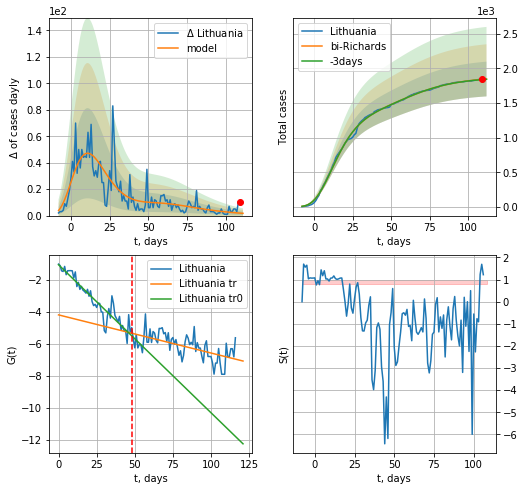

Lithuania data at: 2020-07-07
+3 day model MAPE: 0.001821
model: bi-Richards
coeffs: [4.30216093e+02 9.96464780e-01 2.64124613e+00 5.01782696e-02]
rational stdev: 0.135911
forecast at the end of period: +3 days
	 deltaDaycases: 1
	 total cases: 1847 ± 251
	 total death: 79 ± 32
bi-Richards approximation splitting point: 48
trend coefficient of determination: 0.880025
 intercept: -1.036780
 slope: -0.092499
trend coefficient of determination: 0.370576
 intercept: -4.170653
 slope: -0.023834


In [376]:
vL = 48+3
x = forecastRR('Lithuania',dfLT[3:vL-3],d1,15*7-1-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx = forecast2RR('Lithuania',dfLT[3:],d1,15*7-1-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-3)#
#xx = forecast2R('Lithuania',dfLT[:],d1,2*7-1,x,shift=1.0,addpred=True,xcoef=[0.25,1.,1.5])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


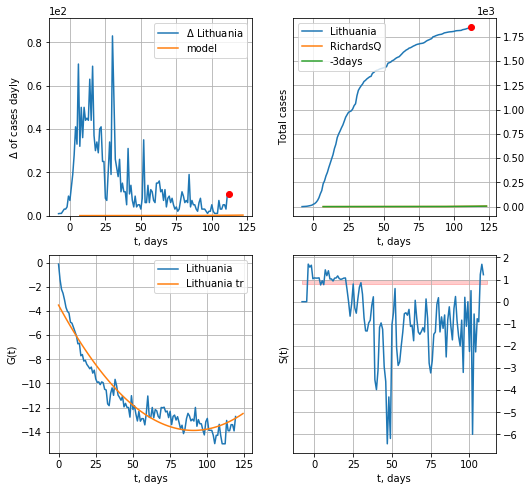

Lithuania data at: 2020-07-07
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 4.54139979e+02  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +11 days
	 deltaDaycases: 0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [377]:
x = forecastQR('Lithuania',dfLT[:],d1,16*7-dT,addpred=False,xcoef=[0.35,.52,4.,1.,1.])

LX
           date   cases  active  death
119 2020-07-04  4476.0     350  110.0
120 2020-07-05  4522.0     396  110.0
121 2020-07-06  4542.0     416  110.0
122 2020-07-07  4603.0     437  110.0
123 2020-07-08  4650.0     484  110.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


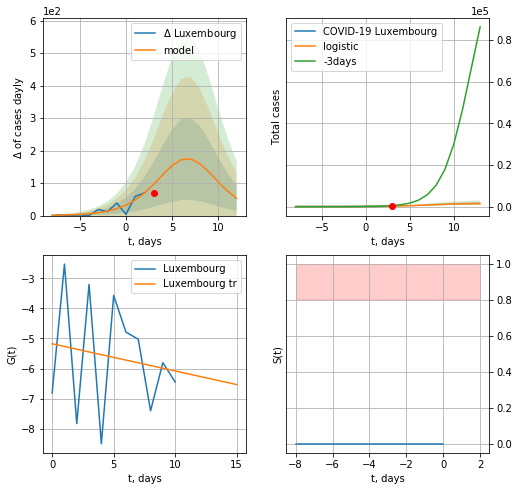

Luxembourg data at: 2020-07-08
model: logistic
coeffs:  [1.56298312e+03 4.51684200e-01 7.13428385e+00]
rational stdev:  0.3215238047871676
forecast at the end of period: +10 days
	 deltaDaycases:  53
	 total cases:  1459 ± 469
	 total death:  34 ± 32
trend coefficient of determination: 0.022967
 intercept: -5.176630
 slope: -0.090347


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


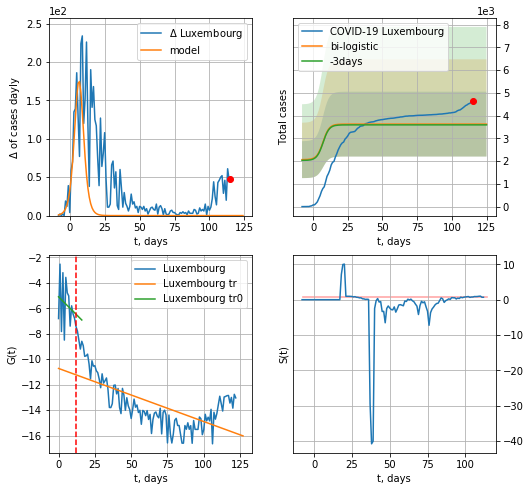

Luxembourg data at: 2020-07-08
+3 day model MAPE: 0.00929371064238614
model: bi-logistic
coeffs:  [1837.08214186   -7.01667801  254.33247126] [1.56298312e+03 4.51684200e-01 7.13428385e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.3924856515522099
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  3629 ± 1424
	 total death:  85 ± 100
bi-logistic approximation splitting point: 12
trend0 coefficient of determination: 0.045986
 intercept: -5.098250
 slope: -0.113861
trend coefficient of determination: 0.437742
 intercept: -10.726360
 slope: -0.041723


In [241]:
dfLX = read_df(pd.DataFrame(),"LX")
x = forecast("Luxembourg",dfLX[:12],d1,16*7-dT,pMAPE=False)
xx = forecast2("Luxembourg",dfLX[:],d1,16*7-dT,x,vL=12,addpred=True,xcoef=[0.25/2,1.,2.])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


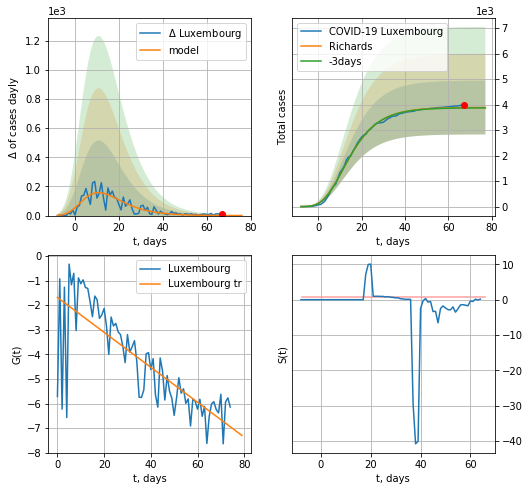

Luxembourg data at: 2020-07-08
+3 day model MAPE: 0.003397
model: Richards
coeffs: [ 3.88624162e+03  1.84559202e+01 -3.50836458e+01  5.98945554e-03]
rational stdev: 0.271241
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 3883 ± 1053
	 total death: 91 ± 74
trend coefficient of determination: 0.629125
 intercept: -1.687510
 slope: -0.070995


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


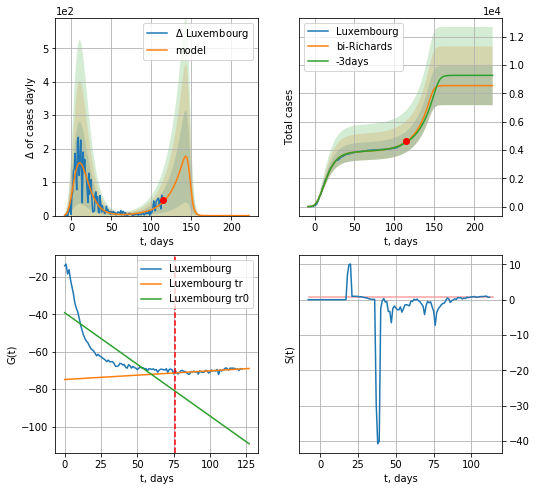

Luxembourg data at: 2020-07-08
+3 day model MAPE: 0.011410
model: bi-Richards
coeffs: [4.67208232e+03 5.69031191e-02 1.48162122e+02 7.66786777e+00]
rational stdev: 0.161637
forecast at the end of period: +108 days
	 deltaDaycases: 0
	 total cases: 8558 ± 1383
	 total death: 202 ± 97
bi-Richards approximation splitting point: 76
trend coefficient of determination: 0.631265
 intercept: -39.172353
 slope: -0.550831
trend coefficient of determination: 0.442059
 intercept: -74.817378
 slope: 0.046245


In [242]:
vL = 76
x = forecastRR("Luxembourg",dfLX[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Luxembourg",dfLX[:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


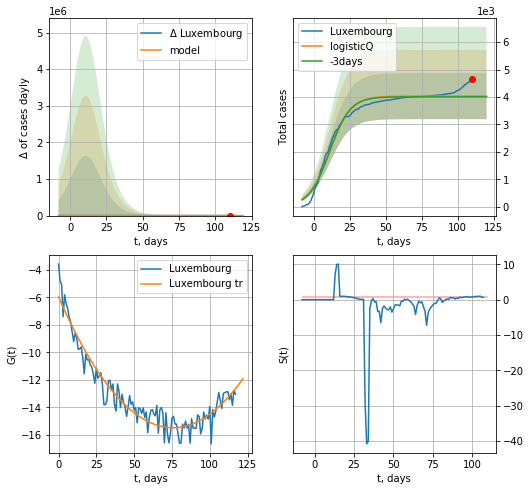

Luxembourg data at: 2020-07-08
+3 day model MAPE: 0.006541
model: logisticQ
coeffs: [ 4.03514869e+03  2.81149721e-07  1.11938352e+01 -4.92324510e+05]
rational stdev: 0.208315
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 4035 ± 840
	 total death: 95 ± 59
trend coefficient of determination: 0.918449
 intercept_: -5.959263189015052
 coeffs_: [ 0.         -0.2515469   0.00166233]


In [243]:
x = forecastRRR("Luxembourg",dfLX[5:],d1,16*7-dT,addpred=False,xcoef=koreaCoeffs)

ED
           date    cases   active   death
126 2020-07-04  61535.0  28259.0  4769.0
127 2020-07-05  61958.0  28455.0  4781.0
128 2020-07-06  62380.0  28687.0  4821.0
129 2020-07-07  63245.0  29301.0  4873.0
130 2020-07-08  63245.0  29301.0  4873.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

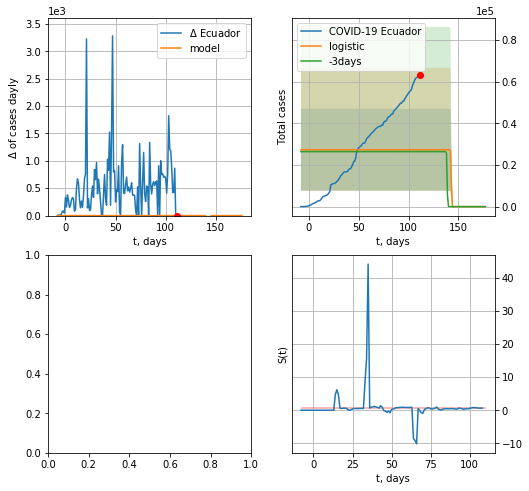

In [244]:
dfED = read_df(pd.DataFrame(),"ED")
x = forecast("Ecuador",dfED[11:],d1,24*7-dT)
#xx = forecast2(c,adf[:],d1,4*7-dT,x)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


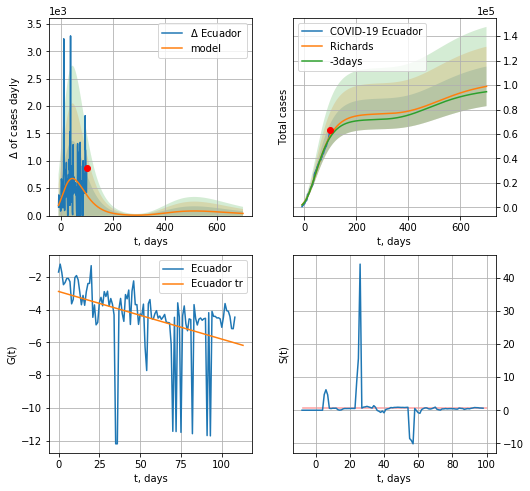

Ecuador data at: 2020-07-07
+3 day model MAPE: 0.022543
model: Richards
coeffs: [ 7.65357283e+04  1.54979045e+00 -1.25802653e+02  1.56490343e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.163730
forecast at the end of period: +599 days
	 deltaDaycases: 39
	 total cases: 98969 ± 16204
	 total death: 7625 ± 3745
trend coefficient of determination: 0.159918
 intercept: -2.898953
 slope: -0.029032


In [254]:
x = forecastRR("Ecuador",dfED[20:],d1,100*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


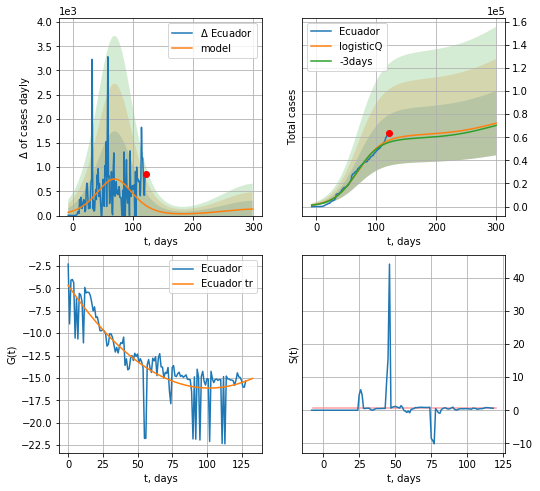

Ecuador data at: 2020-07-07
+3 day model MAPE: 0.031736
model: logisticQ
coeffs: [ 6.17127512e+04  1.72012698e-07  6.96543307e+01 -2.84244407e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.384655
forecast at the end of period: +179 days
	 deltaDaycases: 134
	 total cases: 72157 ± 27755
	 total death: 5559 ± 6414
trend coefficient of determination: 0.727120
 intercept_: -4.677981442627891
 coeffs_: [ 0.         -0.22533916  0.00110812]


In [255]:
x = forecastRRR("Ecuador",dfED[:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

FI
           date   cases  active  death
130 2020-07-04  7248.0     219  329.0
131 2020-07-05  7253.0     224  329.0
132 2020-07-06  7257.0     228  329.0
133 2020-07-07  7262.0     233  329.0
134 2020-07-08  7265.0     136  329.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


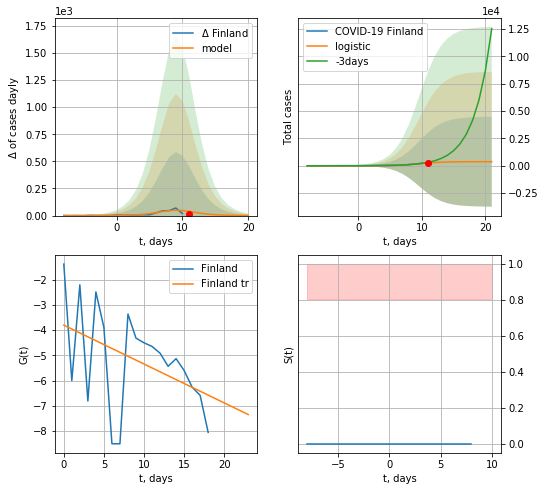

Finland data at: 2020-07-08
+3 day model MAPE: 0.3536794792474036
model: logistic
coeffs:  [373.20900186   0.53490302   9.59276199]
rational stdev:  11.028448708024662
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  372 ± 4106
	 total death:  16 ± 529
trend coefficient of determination: 0.182614
 intercept: -3.802910
 slope: -0.153962


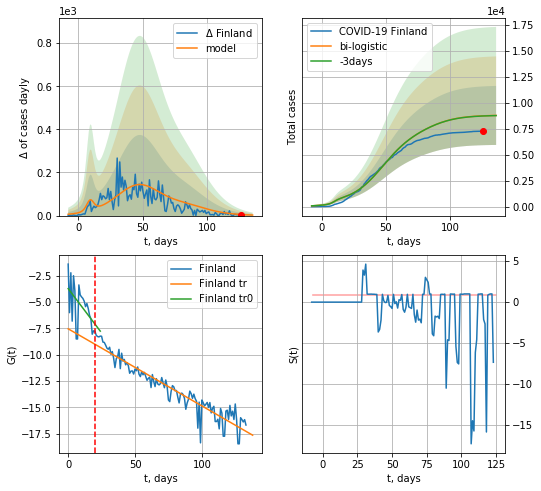

Finland data at: 2020-07-08
+3 day model MAPE: 0.0018130416041894143
model: bi-logistic
coeffs:  [6.74735928e+03 8.19616516e-02 4.69904625e+01] [373.20900186   0.53490302   9.59276199]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.32355920167718816
forecast at the end of period: +10 days
	 deltaDaycases:  2
	 total cases:  8778 ± 2840
	 total death:  397 ± 385
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.234981
 intercept: -3.717136
 slope: -0.168257
trend coefficient of determination: 0.898937
 intercept: -7.537095
 slope: -0.073264


In [245]:
dfFI = read_df(pd.DataFrame(),"FI")
x = forecast("Finland",dfFI[:20],d1,7*16-dT)
xx = forecast2("Finland",dfFI[:],d1,16*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


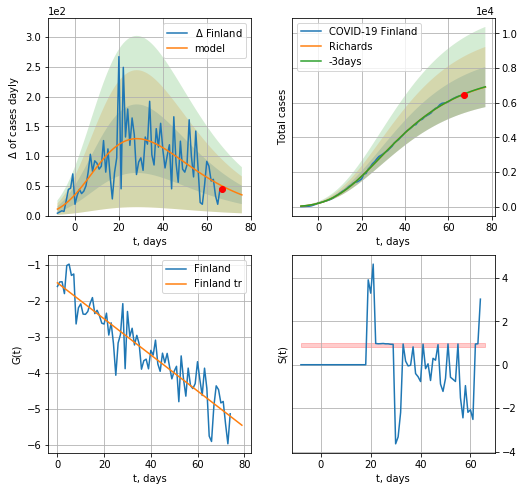

Finland data at: 2020-07-08
+3 day model MAPE: 0.001636
model: Richards
coeffs: [ 7.67975998e+03  2.65386989e+00 -5.92221329e+01  1.73850507e-02]
rational stdev: 0.167365
forecast at the end of period: +10 days
	 deltaDaycases: 34
	 total cases: 6899 ± 1154
	 total death: 312 ± 156
trend coefficient of determination: 0.854396
 intercept: -1.508202
 slope: -0.049971


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


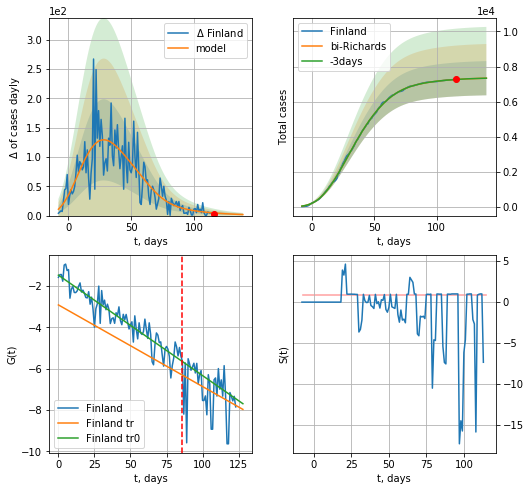

Finland data at: 2020-07-08
+3 day model MAPE: 0.000014
model: bi-Richards
coeffs: [-3.02851947e+02  1.02271353e+01  6.68257373e+00  6.69361759e-03]
rational stdev: 0.132865
forecast at the end of period: +24 days
	 deltaDaycases: 1
	 total cases: 7336 ± 974
	 total death: 332 ± 132
bi-Richards approximation splitting point: 86
trend coefficient of determination: 0.875022
 intercept: -1.473131
 slope: -0.048629
trend coefficient of determination: 0.138899
 intercept: -2.914537
 slope: -0.039521


In [246]:
vL = 86 + 10
x = forecastRR("Finland",dfFI[10:vL-10],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Finland",dfFI[10:],d1,18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


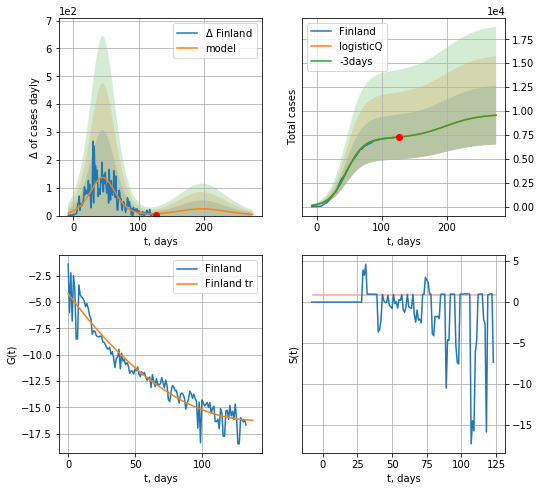

Finland data at: 2020-07-08
+3 day model MAPE: 0.001643
model: logisticQ
coeffs: [ 7.14722566e+03  3.26823603e-07  4.53751267e+01 -2.33914486e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.321771
forecast at the end of period: +150 days
	 deltaDaycases: 4
	 total cases: 9559 ± 3075
	 total death: 432 ± 417
trend coefficient of determination: 0.924334
 intercept_: -4.199531984720016
 coeffs_: [ 0.         -0.17098829  0.00060768]


In [247]:
x = forecastRRR("Finland",dfFI[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

BL
           date  cases  active  death
116 2020-07-04   5677  2538.0  241.0
117 2020-07-05   5740  2579.0  246.0
118 2020-07-06   5914  2664.0  250.0
119 2020-07-07   6102  2811.0  254.0
120 2020-07-08   6342  2917.0  259.0


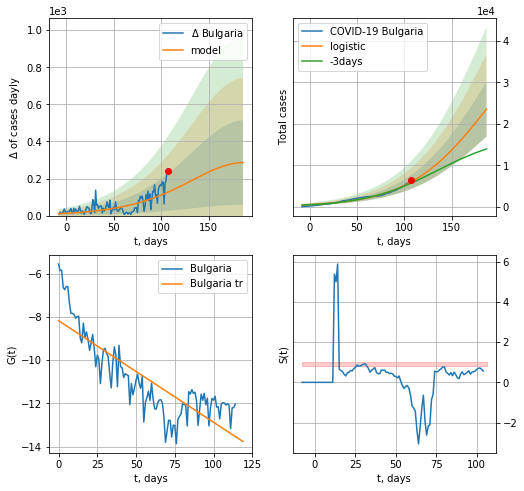

Bulgaria data at: 2020-07-08
+3 day model MAPE: 0.05292582012995507
model: logistic
coeffs:  [4.75913279e+04 2.40621591e-02 1.87855074e+02]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.2809209978060561
forecast at the end of period: +80 days
	 deltaDaycases:  286
	 total cases:  23551 ± 6615
	 total death:  961 ± 809
trend coefficient of determination: 0.696979
 intercept: -8.175950
 slope: -0.046975


In [248]:
dfBL = read_df(pd.DataFrame(),"BL").fillna(0)
try:
    x = forecast('Bulgaria',dfBL[5:],d1,26*7-dT,shift=1.0,addpred=True,xcoef=[0.25,1.,3.5])
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


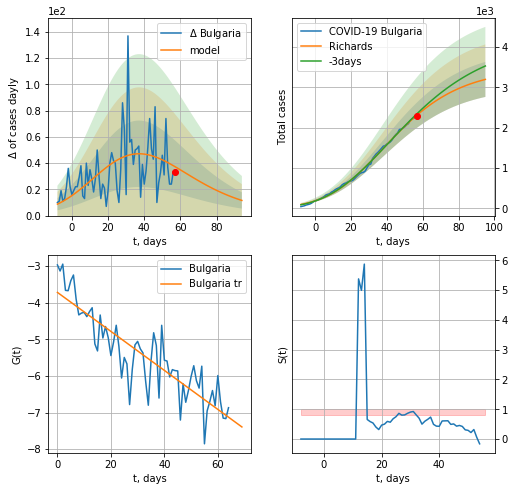

Bulgaria data at: 2020-07-08
+3 day model MAPE: 0.017234
model: Richards
coeffs: [3.47700933e+03 1.26494372e-01 1.24703961e+01 3.39631762e-01]
rational stdev: 0.135837
forecast at the end of period: +38 days
	 deltaDaycases: 11
	 total cases: 3197 ± 434
	 total death: 130 ± 52
trend coefficient of determination: 0.758376
 intercept: -3.716230
 slope: -0.053312


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


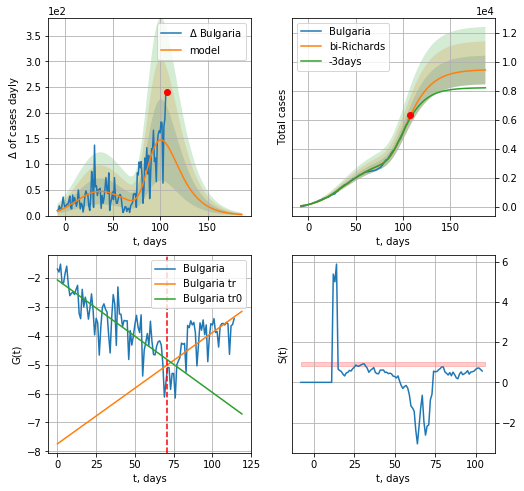

Bulgaria data at: 2020-07-08
+3 day model MAPE: 0.027824
model: bi-Richards
coeffs: [6.01946630e+03 4.22105332e+00 3.51854099e+01 1.49124814e-02]
rational stdev: 0.104622
forecast at the end of period: +80 days
	 deltaDaycases: 2
	 total cases: 9462 ± 989
	 total death: 386 ± 121
bi-Richards approximation splitting point: 71
trend coefficient of determination: 0.675656
 intercept: -2.063039
 slope: -0.039016
trend coefficient of determination: 0.456168
 intercept: -7.741625
 slope: 0.038564


In [252]:
vL = 71+5
x = forecastRR('Bulgaria',dfBL[5:vL-5],d1,20*7-dT,shift=1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bulgaria',dfBL[5:],d1,26*7-dT,x,shift=1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


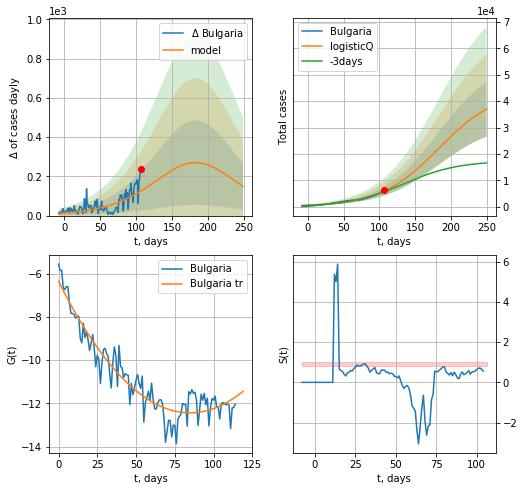

Bulgaria data at: 2020-07-08
+3 day model MAPE: 0.051706
model: logisticQ
coeffs: [ 4.40306144e+04  1.52089130e-06  1.83014081e+02 -1.59471651e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.281119
forecast at the end of period: +143 days
	 deltaDaycases: 148
	 total cases: 36957 ± 10389
	 total death: 1509 ± 1272
trend coefficient of determination: 0.896553
 intercept_: -6.35848678844259
 coeffs_: [ 0.         -0.14347979  0.00084654]


In [253]:
x = forecastRRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=True,xcoef=koreaCoeffs)

TH
           date   cases  active  death
128 2020-07-04  3190.0    61.0   58.0
129 2020-07-05  3195.0    65.0   58.0
130 2020-07-06  3195.5    65.0   58.0
131 2020-07-07  3197.0    65.0   58.0
132 2020-07-08  3202.0    59.0   58.0


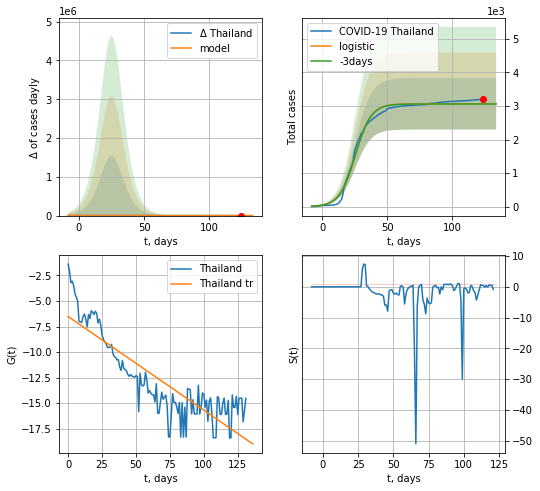

Thailand data at: 2020-07-08
+3 day model MAPE: 0.0018596640840057963
model: logistic
coeffs:  [3.06532386e+03 1.64653847e-01 2.56139423e+01]
rational stdev:  0.24934432544461863
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  3065 ± 764
	 total death:  55 ± 41
trend coefficient of determination: 0.742949
 intercept: -6.520198
 slope: -0.091727


In [254]:
dfTH = read_df(pd.DataFrame(),"TH")
dfTH = dfTH.fillna(0)
try:
    x = forecast("Thailand",dfTH[:],d1,16*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])
except:
    print("Exception occurs")
#xx = forecast2("Thailand",dfTH[:],d1,8*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

In [255]:
#x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


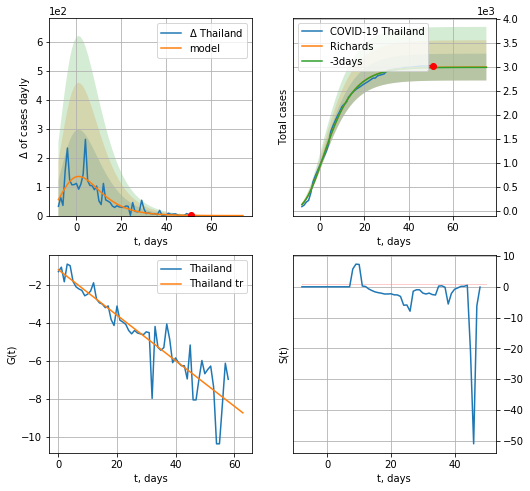

Thailand data at: 2020-07-08
+3 day model MAPE: 0.001961
model: Richards
coeffs: [ 2.99626186e+03  1.57389308e+01 -3.79335147e+01  7.82164356e-03]
rational stdev: 0.093313
forecast at the end of period: +24 days
	 deltaDaycases: 0
	 total cases: 2995 ± 279
	 total death: 54 ± 15
trend coefficient of determination: 0.845848
 intercept: -1.208266
 slope: -0.119672


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


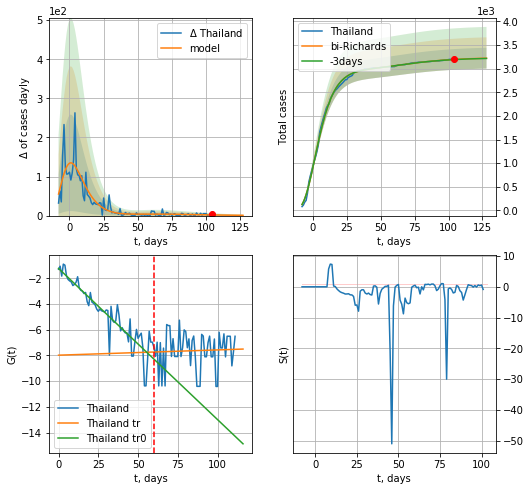

Thailand data at: 2020-07-08
+3 day model MAPE: 0.000974
model: bi-Richards
coeffs: [ 2.39282755e+02  7.10839291e+00 -5.25267740e+01  6.05249663e-03]
rational stdev: 0.068483
forecast at the end of period: +24 days
	 deltaDaycases: 0
	 total cases: 3219 ± 220
	 total death: 58 ± 11
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.843201
 intercept: -1.237329
 slope: -0.117505
trend coefficient of determination: 0.001820
 intercept: -7.978460
 slope: 0.004088


In [256]:
vL = 80
x = forecastRR("Thailand",dfTH[20:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Thailand",dfTH[20:],d1,18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


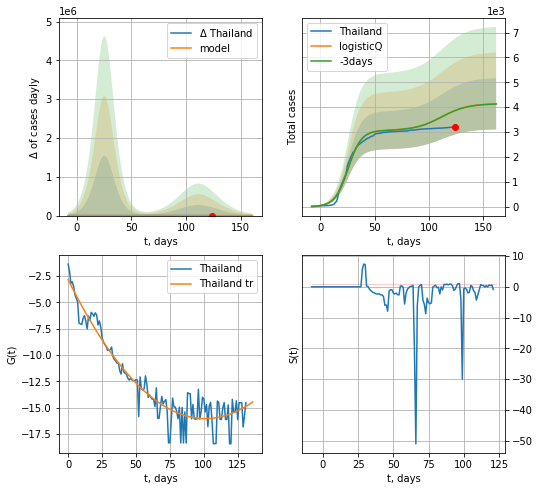

Thailand data at: 2020-07-08
+3 day model MAPE: 0.000783
model: logisticQ
coeffs: [ 3.06532674e+03  5.39565566e-07  2.56144752e+01 -3.05032563e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.249508
forecast at the end of period: +38 days
	 deltaDaycases: 1
	 total cases: 4134 ± 1031
	 total death: 74 ± 55
trend coefficient of determination: 0.913336
 intercept_: -2.8620455396821853
 coeffs_: [ 0.         -0.26056799  0.00128887]


In [257]:
x = forecastRRR("Thailand",dfTH[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

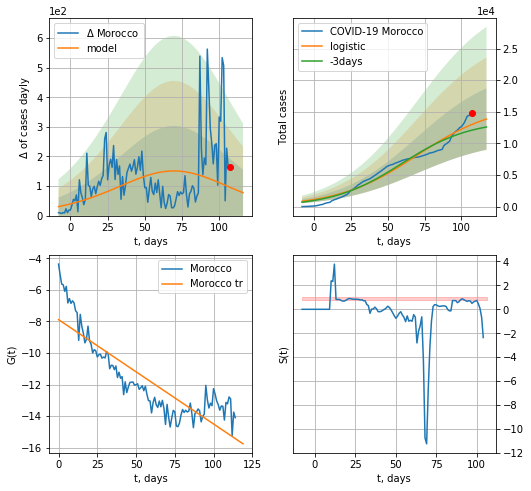

Morocco data at: 2020-07-08
+3 day model MAPE: 0.07714427341510728
model: logistic
coeffs:  [1.62759109e+04 3.71004895e-02 6.99759168e+01]
rational stdev:  0.3502499562280669
forecast at the end of period: +10 days
	 deltaDaycases:  77
	 total cases:  13855 ± 4852
	 total death:  226 ± 237
trend coefficient of determination: 0.751901
 intercept: -7.882383
 slope: -0.066191


In [258]:
x = forecast("Morocco",dfMR[5:],d1,16*7-dT)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


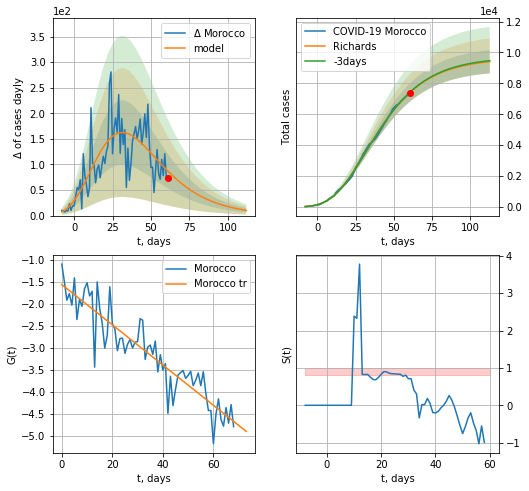

Morocco data at: 2020-07-08
+3 day model MAPE: 0.002855
model: Richards
coeffs: [ 9.62196675e+03  2.25668236e+00 -5.19496574e+01  2.05516980e-02]
rational stdev: 0.079909
forecast at the end of period: +52 days
	 deltaDaycases: 10
	 total cases: 9401 ± 751
	 total death: 154 ± 36
trend coefficient of determination: 0.846109
 intercept: -1.563197
 slope: -0.045646


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power


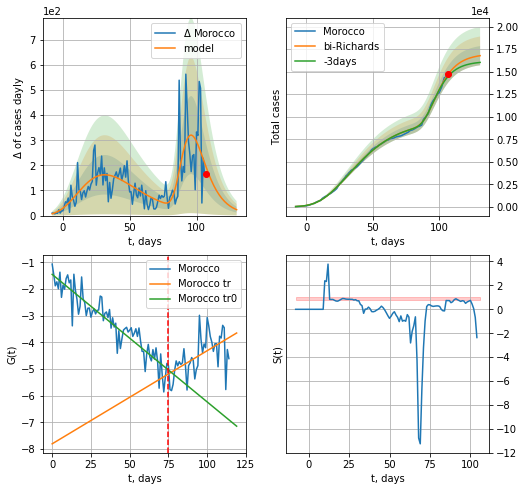

Morocco data at: 2020-07-08
+3 day model MAPE: 0.018053
model: bi-Richards
coeffs: [7.41851015e+03 9.68619094e+00 5.61087923e+01 1.14001373e-02]
rational stdev: 0.063455
forecast at the end of period: +24 days
	 deltaDaycases: 23
	 total cases: 16779 ± 1064
	 total death: 274 ± 52
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.860991
 intercept: -1.452862
 slope: -0.047812
trend coefficient of determination: 0.304265
 intercept: -7.803834
 slope: 0.034907


In [259]:
vL = 75 + 5
x = forecastRR("Morocco",dfMR[5:vL-5],d1,22*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Morocco",dfMR[5:],d1,18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


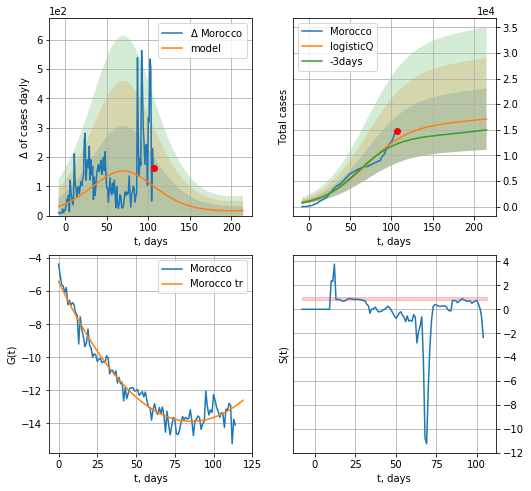

Morocco data at: 2020-07-08
+3 day model MAPE: 0.073229
model: logisticQ
coeffs: [ 1.62702564e+04  1.25916516e-07  6.99557107e+01 -2.94605826e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.350243
forecast at the end of period: +108 days
	 deltaDaycases: 16
	 total cases: 17102 ± 5990
	 total death: 280 ± 294
trend coefficient of determination: 0.952780
 intercept_: -5.4087112151766
 coeffs_: [ 0.         -0.19753989  0.00115219]


In [260]:
x = forecastRRR("Morocco",dfMR[5:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

RM
           date    cases  active   death
129 2020-07-04  28582.0  6997.0  1731.0
130 2020-07-05  29223.0  7242.0  1768.0
131 2020-07-06  29620.0  7287.0  1799.0
132 2020-07-07  29896.0  7421.0  1799.0
133 2020-07-08  30175.0  7559.0  1817.0


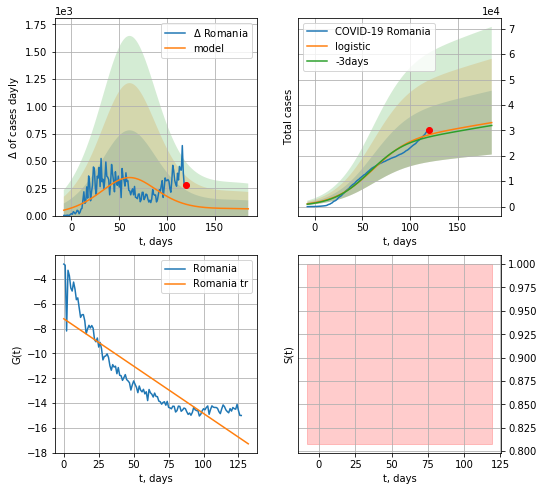

Romania data at: 2020-07-08
+3 day model MAPE: 0.031749728510255835
model: logistic
coeffs:  [2.79842505e+04 4.81357967e-02 6.06447342e+01]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.37962164573180035
forecast at the end of period: +66 days
	 deltaDaycases:  62
	 total cases:  33054 ± 12548
	 total death:  1990 ± 2266
trend coefficient of determination: 0.773253
 intercept: -7.206959
 slope: -0.076307


In [265]:
dfRM = read_df(pd.DataFrame(),"RM")
x = forecast("Romania",dfRM[5:],d1,24*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


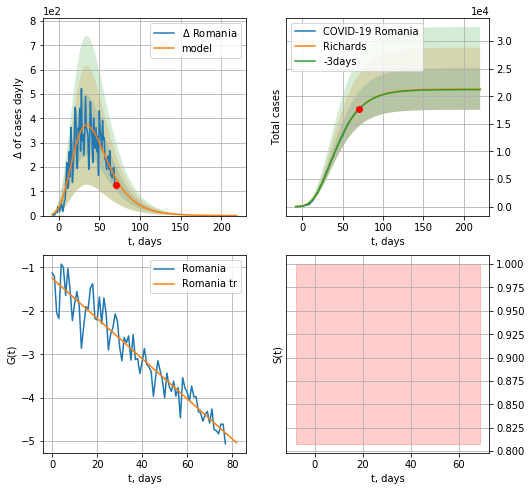

Romania data at: 2020-07-08
+3 day model MAPE: 0.002257
model: Richards
coeffs: [ 2.13025472e+04  3.80217834e+00 -5.67257576e+01  1.25517845e-02]
rational stdev: 0.176275
forecast at the end of period: +150 days
	 deltaDaycases: 0
	 total cases: 21299 ± 3754
	 total death: 1282 ± 677
trend coefficient of determination: 0.908515
 intercept: -1.251895
 slope: -0.046188


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


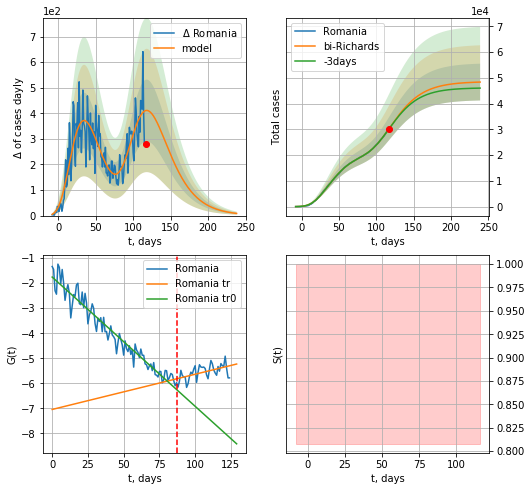

Romania data at: 2020-07-08
+3 day model MAPE: 0.002735
model: bi-Richards
coeffs: [2.72541495e+04 3.87711566e-01 6.56883743e+01 1.06493076e-01]
rational stdev: 0.147634
forecast at the end of period: +122 days
	 deltaDaycases: 8
	 total cases: 48356 ± 7139
	 total death: 2911 ± 1289
bi-Richards approximation splitting point: 87
trend coefficient of determination: 0.937816
 intercept: -1.757506
 slope: -0.051605
trend coefficient of determination: 0.287451
 intercept: -7.043077
 slope: 0.014058


In [266]:
vL = 87+8
x = forecastRR("Romania",dfRM[8:vL-8],d1,36*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Romania",dfRM[8:],d1,32*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL = vL-8)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


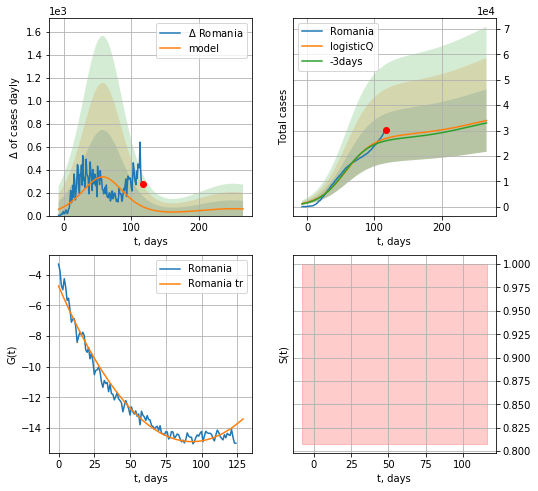

Romania data at: 2020-07-08
+3 day model MAPE: 0.036322
model: logisticQ
coeffs: [ 2.80653208e+04  1.37664447e-07  5.78028221e+01 -3.46968668e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.362641
forecast at the end of period: +150 days
	 deltaDaycases: 57
	 total cases: 33923 ± 12302
	 total death: 2042 ± 2221
trend coefficient of determination: 0.976959
 intercept_: -4.729401523450747
 coeffs_: [ 0.         -0.21784603  0.00116697]


In [267]:
xx = forecastRRR("Romania",dfRM[8:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

In [268]:
#x = forecastRRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/4,.5,2.2,1])

EU
           date    cases  active     death
147 2020-07-04  1302059  161413  133687.0
148 2020-07-05  1304731  161088  133771.0
149 2020-07-06  1310539  162595  133845.0
150 2020-07-07  1313602  162792  133977.0
151 2020-07-08  1317853  162308  134116.0


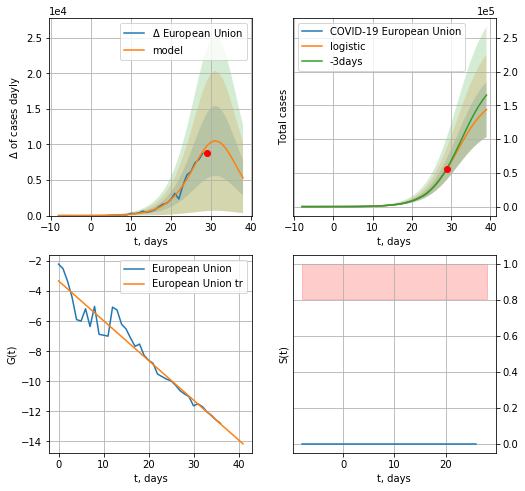

European Union data at: 2020-07-08
+3 day model MAPE: 0.026537291805373914
model: logistic
coeffs:  [1.65818576e+05 2.54045102e-01 3.15946527e+01]
rational stdev:  0.28380142507641165
forecast at the end of period: +10 days
	 deltaDaycases:  5300
	 total cases:  143890 ± 40836
	 total death:  14643 ± 12467
trend coefficient of determination: 0.942451
 intercept: -3.318380
 slope: -0.264437


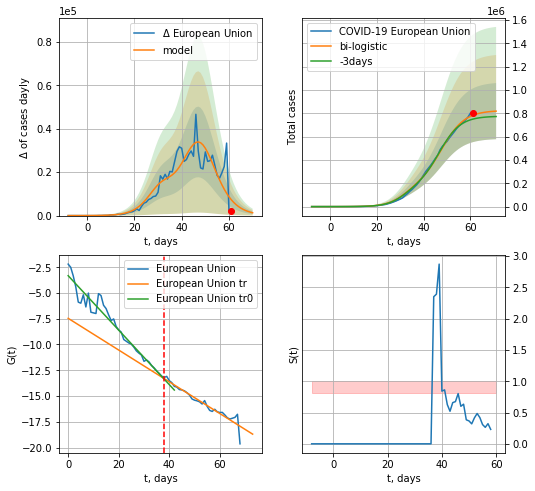

European Union data at: 2020-07-08
+3 day model MAPE: 0.046518861456193536
model: bi-logistic
coeffs:  [6.59401208e+05 2.01830792e-01 4.76685424e+01] [1.65818576e+05 2.54045102e-01 3.15946527e+01]
rational stdev:  0.2940888577461115
forecast at the end of period: +10 days
	 deltaDaycases:  1305
	 total cases:  819321 ± 240953
	 total death:  83381 ± 73564
bi-logistic approximation splitting point: 38
trend0 coefficient of determination: 0.946588
 intercept: -3.319965
 slope: -0.264305
trend coefficient of determination: 0.919570
 intercept: -7.459861
 slope: -0.154008


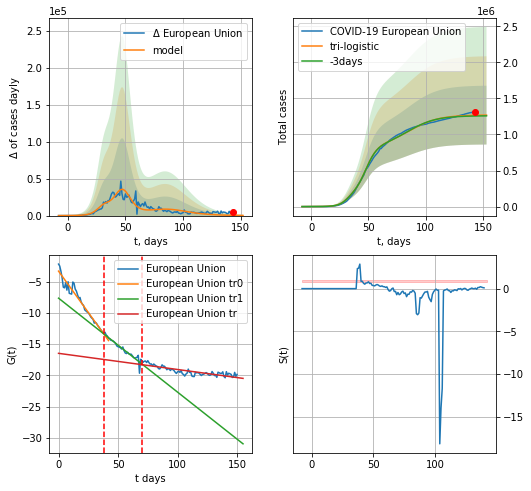

European Union data at: 2020-07-08
+3 day model MAPE: 0.007822270302146654
model: tri-logistic
coeffs:  [4.45578826e+05 7.80504963e-02 8.53300767e+01] [1.65818576e+05 2.54045102e-01 3.15946527e+01 6.59401208e+05
 2.01830792e-01 4.76685424e+01]
forecast rational stdev:  0.3213306602897433
forecast at the end of period: +10 days
	 deltaDaycases:  181
	 total cases:  1268544 ± 407622
	 total death:  129097 ± 124448
tri-logistic approximation splitting points: 38,70
trend0 coefficient of determination: 0.946588
 intercept: -3.319965
 slope: -0.264305
trend1 coefficient of determination: 0.917507
 intercept: -7.641441
 slope: -0.150225
trend coefficient of determination: 0.703722
 intercept: -16.461059
 slope: -0.025828


In [269]:
vL=38
vL1=70
dfEU = read_df(pd.DataFrame(),"EU")
x = forecast("European Union",dfEU[:vL],d1,16*7-dT)
xx = forecast2("European Union",dfEU[:vL1],d1,16*7-dT,x,vL=38,addpred=False,xcoef=[0.25,1.,1.5])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("European Union",dfEU,d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


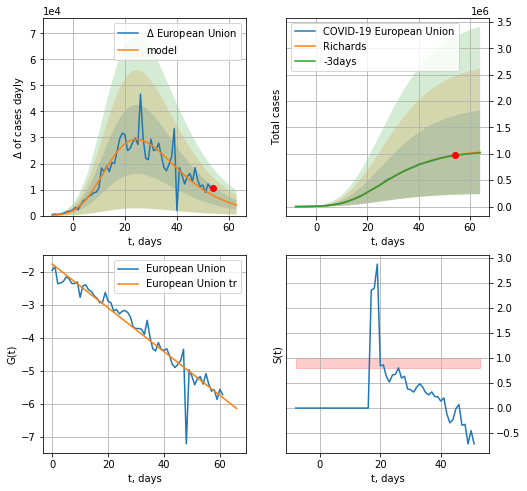

European Union data at: 2020-07-08
+3 day model MAPE: 0.007559
model: Richards
coeffs: [ 1.08235898e+06  8.91256786e-01 -6.99260106e+00  8.61059421e-02]
rational stdev: 0.768581
forecast at the end of period: +10 days
	 deltaDaycases: 4079
	 total cases: 1029694 ± 791403
	 total death: 104790 ± 241618
trend coefficient of determination: 0.920526
 intercept: -1.769267
 slope: -0.066303


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


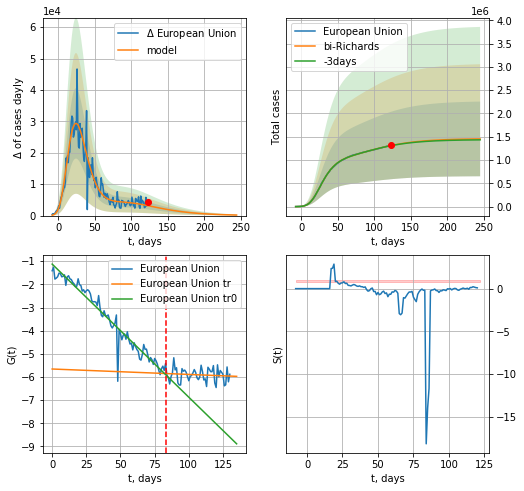

European Union data at: 2020-07-08
+3 day model MAPE: 0.002634
model: bi-Richards
coeffs: [ 3.76597991e+05  2.64005852e+00 -6.68809136e+01  1.04971408e-02]
rational stdev: 0.551608
forecast at the end of period: +122 days
	 deltaDaycases: 174
	 total cases: 1452684 ± 801312
	 total death: 147837 ± 244644
bi-Richards approximation splitting point: 83
trend coefficient of determination: 0.943655
 intercept: -1.125171
 slope: -0.057495
trend coefficient of determination: 0.012172
 intercept: -5.655951
 slope: -0.002345


In [270]:
vL = 83+20
x = forecastRR("European Union",dfEU[20:vL-20],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("European Union",dfEU[20:],d1,32*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


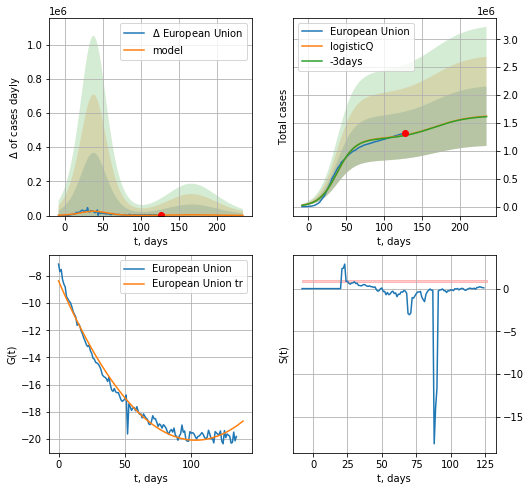

European Union data at: 2020-07-08
+3 day model MAPE: 0.005462
model: logisticQ
coeffs: [ 1.21422914e+06  1.71582584e-07  3.82823871e+01 -4.89435716e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.329117
forecast at the end of period: +108 days
	 deltaDaycases: 932
	 total cases: 1621398 ± 533629
	 total death: 165007 ± 162919
trend coefficient of determination: 0.981085
 intercept_: -8.361414372966113
 coeffs_: [ 0.         -0.22741435  0.00110139]


In [271]:
x = forecastRRR("European Union",dfEU[16:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: overflow encountered in power
  from ipykernel import kernelapp as app


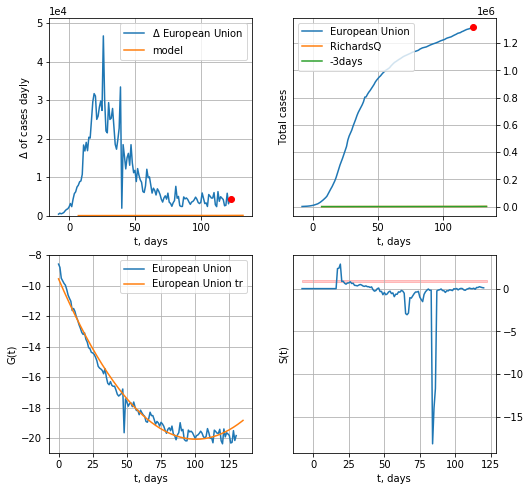

European Union data at: 2020-07-08
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 7.42779548e+04  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
S.Korea scenario coeffs: [ 3.69179628e-01  4.55901153e+01  3.02600169e-01 -6.49668395e+01
  2.33503320e-03]
rational stdev: nan
forecast at the end of period: +10 days
	 deltaDaycases: 53


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [272]:
x = forecastQR("European Union",dfEU[20:],d1,16*7-dT,addpred=True,xcoef=QRkoreaCoeffs)

In [273]:
#x = forecastRR("Romania",dfRM[5:],d1,14*7-dT)

In [274]:
#x = forecastRRR("European Union",dfEU[:],d1,8*7-dT)

In [275]:
#x = forecastRRR("Romania",dfRM[5:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

In [276]:
#dfIC[:]

IC
           date   cases  active  death
125 2020-07-04  1860.0      17   10.0
126 2020-07-05  1863.0      20   10.0
127 2020-07-06  1866.0      16   10.0
128 2020-07-07  1873.0      16   10.0
129 2020-07-08  1880.0      20   10.0


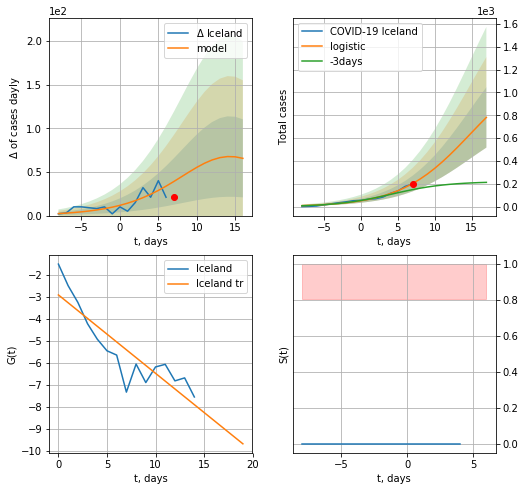

Iceland data at: 2020-07-08
+3 day model MAPE: 0.49229543132944575
model: logistic
coeffs:  [1.27194861e+03 2.12945173e-01 1.48141483e+01]
rational stdev:  0.3377978270267634
forecast at the end of period: +10 days
	 deltaDaycases:  65
	 total cases:  781 ± 263
	 total death:  4 ± 4
trend coefficient of determination: 0.778766
 intercept: -2.904405
 slope: -0.356109


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:189: RuntimeWarning: overflow encountered in exp


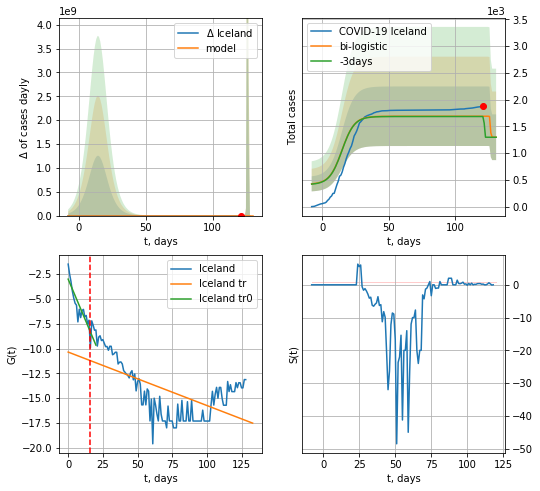

Iceland data at: 2020-07-08
+3 day model MAPE: 0.08257805863631981
model: bi-logistic
coeffs:  [392.2647123   -5.86039323 126.77780781] [1.27194861e+03 2.12945173e-01 1.48141483e+01]
scenario coeffs:  [0.0625, 1.0, 2]
rational stdev:  0.32927560856534616
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  1296 ± 426
	 total death:  6 ± 5
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.772657
 intercept: -3.017482
 slope: -0.331878
trend coefficient of determination: 0.370369
 intercept: -10.358856
 slope: -0.053791


In [277]:
dfIC = read_df(pd.DataFrame(),"IC")
vL=16
try:
    x = forecast("Iceland",dfIC[:vL],d1,16*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
    xx = forecast2("Iceland",dfIC[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25/4,1.,2],vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


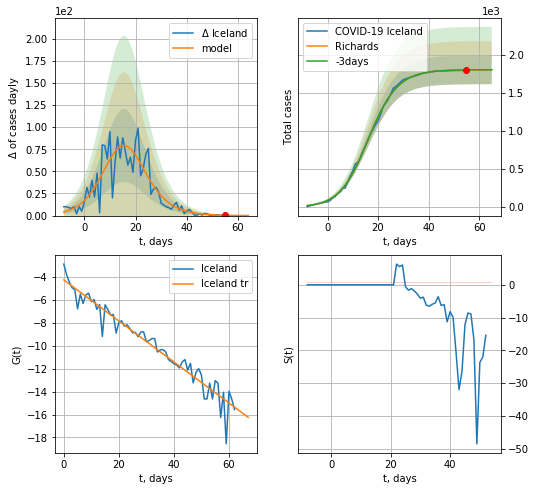

Iceland data at: 2020-07-08
+3 day model MAPE: 0.000559
model: Richards
coeffs: [1.80650159e+03 1.95431148e-01 1.50691594e+01 8.61754773e-01]
rational stdev: 0.104312
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 1806 ± 188
	 total death: 9 ± 2
trend coefficient of determination: 0.936826
 intercept: -4.237440
 slope: -0.179276


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


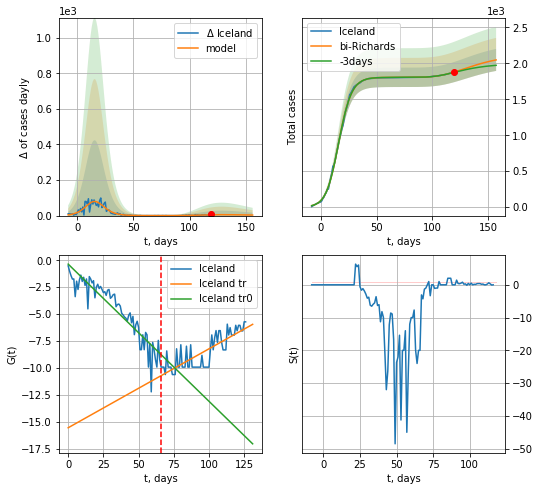

Iceland data at: 2020-07-08
+3 day model MAPE: 0.002529
model: bi-Richards
coeffs: [3.23189152e+02 2.63803642e+00 3.56836415e+01 1.66649472e-02]
rational stdev: 0.074783
forecast at the end of period: +38 days
	 deltaDaycases: 3
	 total cases: 2048 ± 153
	 total death: 10 ± 2
bi-Richards approximation splitting point: 66
trend coefficient of determination: 0.842119
 intercept: -0.355244
 slope: -0.127452
trend coefficient of determination: 0.661993
 intercept: -15.558985
 slope: 0.073345


In [279]:
vL = 66+2
x = forecastRR("Iceland",dfIC[2:vL-2],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iceland",dfIC[2:],d1,20*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-2)
#x = forecastRRR("Iceland",dfIC[:20],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


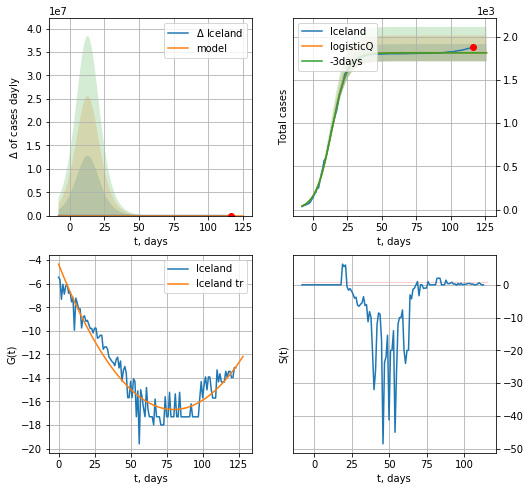

Iceland data at: 2020-07-08
+3 day model MAPE: 0.001243
model: logisticQ
coeffs: [ 1.81368181e+03  3.63415825e-06  1.34291751e+01 -4.80457860e+04]
rational stdev: 0.054726
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 1813 ± 99
	 total death: 9 ± 1
trend coefficient of determination: 0.917575
 intercept_: -4.3317418137075805
 coeffs_: [ 0.         -0.30959417  0.00194013]


In [280]:
x = forecastRRR("Iceland",dfIC[5:],d1,16*7-dT,addpred=False,xcoef=[0.35/6,.5,4.,1.])

PM
           date  cases   active  death
116 2020-07-04  36983  18502.0  720.0
117 2020-07-05  38149  19416.0  747.0
118 2020-07-06  39334  20528.0  770.0
119 2020-07-07  40291  20766.0  799.0
120 2020-07-08  41251  20963.0  819.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:119: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


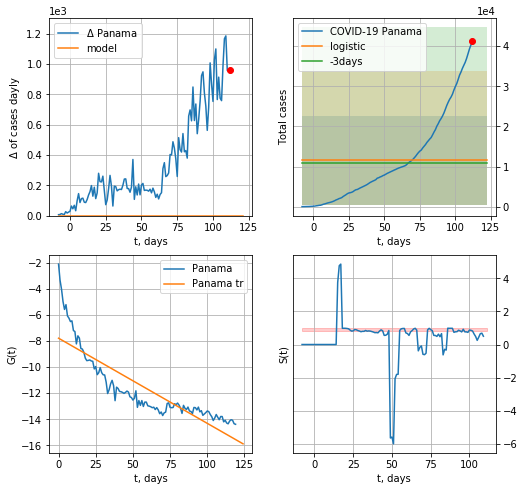

Panama data at: 2020-07-08
+3 day model MAPE: 0.06777695618151382
model: logistic
coeffs:  [ 1.15229422e+04 -9.50765470e+00  2.53892693e+02]
rational stdev:  0.9631166730918829
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  11522 ± 11097
	 total death:  228 ± 658
trend coefficient of determination: 0.741656
 intercept: -7.783673
 slope: -0.065344


In [281]:
dfPM = read_df(pd.DataFrame(),"PM").fillna(0)
x = forecast("Panama",dfPM[:],d1,16*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


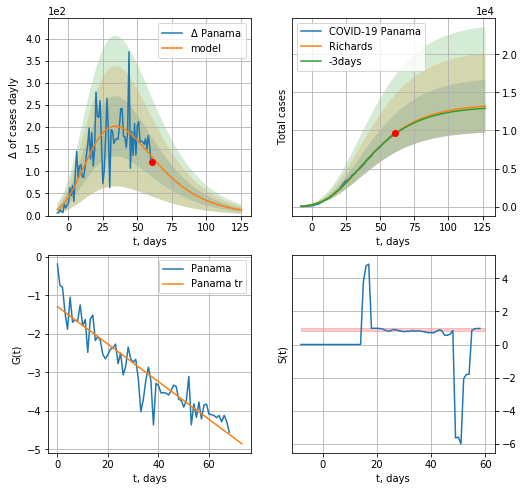

Panama data at: 2020-07-08
+3 day model MAPE: 0.008184
model: Richards
coeffs: [ 1.34885246e+04  2.34173945e+00 -6.38327516e+01  1.75366113e-02]
rational stdev: 0.263123
forecast at the end of period: +66 days
	 deltaDaycases: 12
	 total cases: 13188 ± 3470
	 total death: 261 ± 206
trend coefficient of determination: 0.871686
 intercept: -1.291480
 slope: -0.048815


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


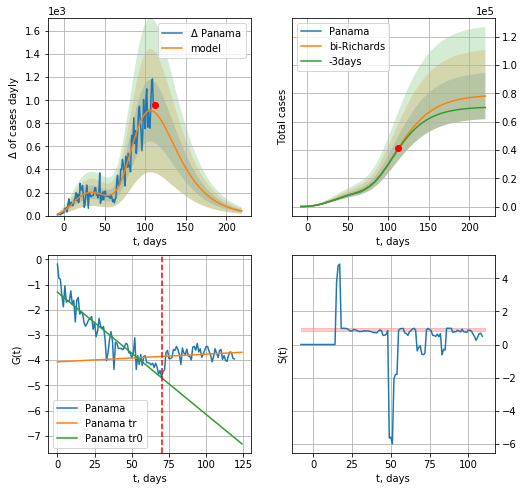

Panama data at: 2020-07-08
+3 day model MAPE: 0.014632
model: bi-Richards
coeffs: [ 6.56396106e+04  2.06941159e+00 -1.00931026e+00  1.78542171e-02]
rational stdev: 0.208731
forecast at the end of period: +108 days
	 deltaDaycases: 38
	 total cases: 78085 ± 16298
	 total death: 1550 ± 970
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.874449
 intercept: -1.299850
 slope: -0.048538
trend coefficient of determination: 0.028213
 intercept: -4.066954
 slope: 0.003061


In [282]:
vL = 70
x = forecastRR("Panama",dfPM[:vL],d1,24*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Panama",dfPM[:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


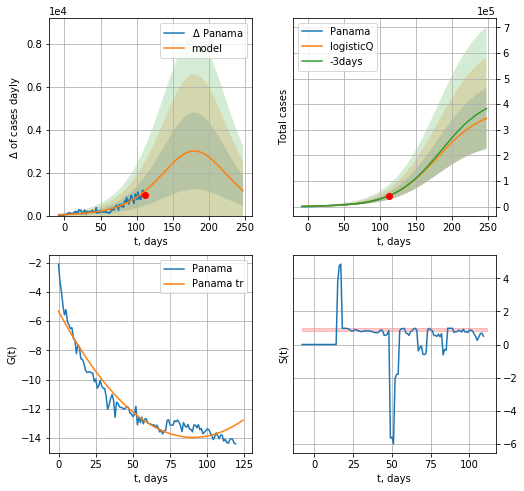

Panama data at: 2020-07-08
+3 day model MAPE: 0.002940
model: logisticQ
coeffs: [ 3.84825301e+05  2.10086471e-06  1.79886393e+02 -1.47013856e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.346059
forecast at the end of period: +136 days
	 deltaDaycases: 1159
	 total cases: 344319 ± 119154
	 total death: 6836 ± 7096
trend coefficient of determination: 0.926414
 intercept_: -5.320303813972992
 coeffs_: [ 0.         -0.19060323  0.00105261]


In [283]:
x = forecastRRR("Panama",dfPM[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

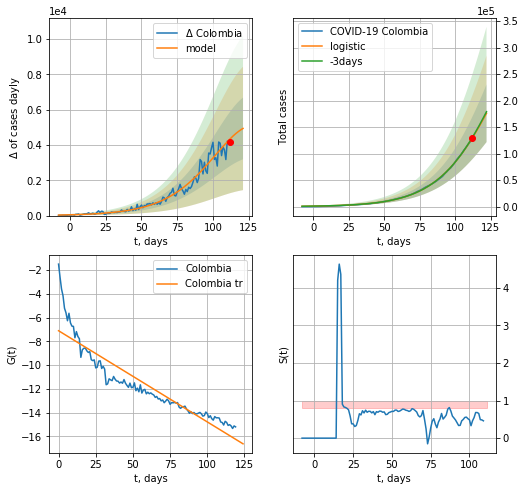

Colombia data at: 2020-07-08
+3 day model MAPE: 0.008499320262418016
model: logistic
coeffs:  [4.32418865e+05 4.74778726e-02 1.29940014e+02]
rational stdev:  0.3086568925624664
forecast at the end of period: +10 days
	 deltaDaycases:  4931
	 total cases:  175932 ± 54302
	 total death:  6191 ± 5732
trend coefficient of determination: 0.843753
 intercept: -7.109010
 slope: -0.076739


In [284]:
dfCB = dfCB.fillna(0)
x = forecast("Colombia",dfCB[:],d1,16*7-dT)

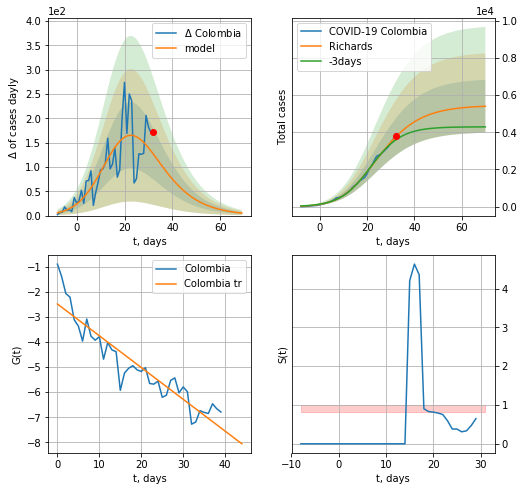

Colombia data at: 2020-07-08
+3 day model MAPE: 0.053959
model: Richards
coeffs: [5.45323700e+03 2.23852153e-01 1.50939189e+01 4.47628300e-01]
rational stdev: 0.263661
forecast at the end of period: +38 days
	 deltaDaycases: 5
	 total cases: 5403 ± 1424
	 total death: 190 ± 150
trend coefficient of determination: 0.864435
 intercept: -2.485434
 slope: -0.126591


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


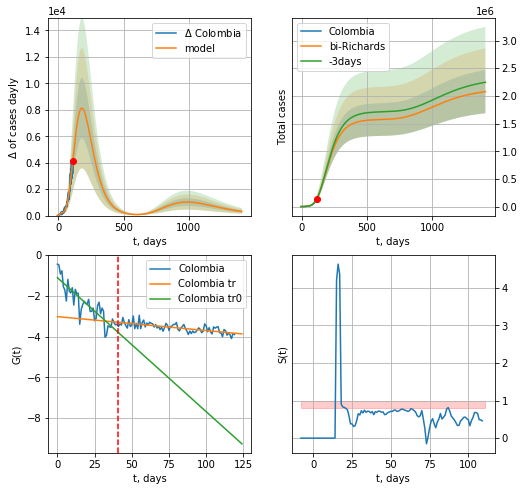

Colombia data at: 2020-07-08
+3 day model MAPE: 0.003458
model: bi-Richards
coeffs: [ 1.56974744e+06  3.62141340e-01 -4.45296715e+01  3.96054531e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.187809
forecast at the end of period: +1298 days
	 deltaDaycases: 312
	 total cases: 2076296 ± 389946
	 total death: 73068 ± 41168
bi-Richards approximation splitting point: 41
trend coefficient of determination: 0.763650
 intercept: -1.115285
 slope: -0.065674
trend coefficient of determination: 0.484719
 intercept: -3.023033
 slope: -0.006827


In [285]:
vL = 41
x = forecastRR("Colombia",dfCB[:vL],d1,20*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Colombia",dfCB[:],d1,200*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


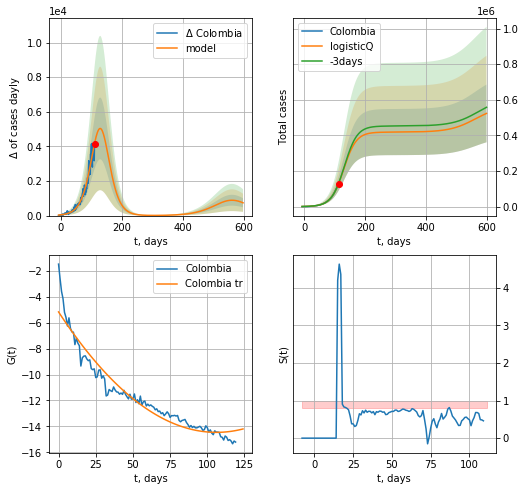

Colombia data at: 2020-07-08
+3 day model MAPE: 0.008014
model: logisticQ
coeffs: [ 4.18543499e+05  4.91738127e-06  1.28755452e+02 -9.66198140e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.309514
forecast at the end of period: +486 days
	 deltaDaycases: 739
	 total cases: 523401 ± 162000
	 total death: 18419 ± 17102
trend coefficient of determination: 0.936828
 intercept_: -5.183987657382593
 coeffs_: [ 0.         -0.17462425  0.00082257]


In [286]:
x = forecastRRR("Colombia",dfCB[:],d1,84*7-dT,addpred=True,xcoef=koreaCoeffs)

AR
           date    cases  active  death
122 2020-07-04  15500.0  3373.0  946.0
123 2020-07-05  15941.0  3497.0  952.0
124 2020-07-06  16404.0  3561.0  959.0
125 2020-07-07  16879.0  3817.0  968.0
126 2020-07-08  17348.0  4041.0  978.0


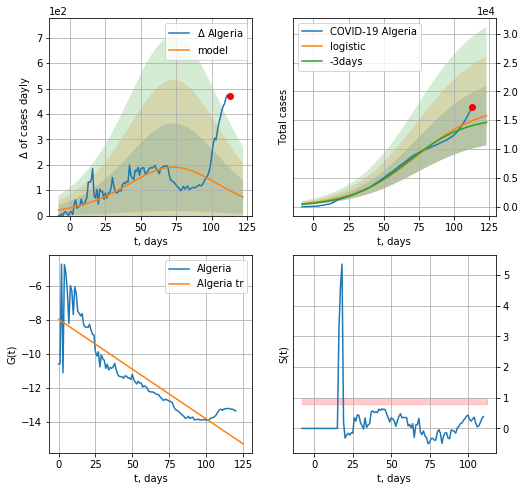

Algeria data at: 2020-07-08
+3 day model MAPE: 0.06322929624779644
model: logistic
coeffs:  [1.76401399e+04 4.32082654e-02 7.35027018e+01]
rational stdev:  0.32510848114474916
forecast at the end of period: +10 days
	 deltaDaycases:  73
	 total cases:  15780 ± 5130
	 total death:  889 ± 867
trend coefficient of determination: 0.777676
 intercept: -7.975931
 slope: -0.058595


In [287]:
dfAR = read_df(pd.DataFrame(),"AR")
dfAR = dfAR.fillna(0)
x = forecast("Algeria",dfAR[5:],d1,16*7-dT)
#dfAG

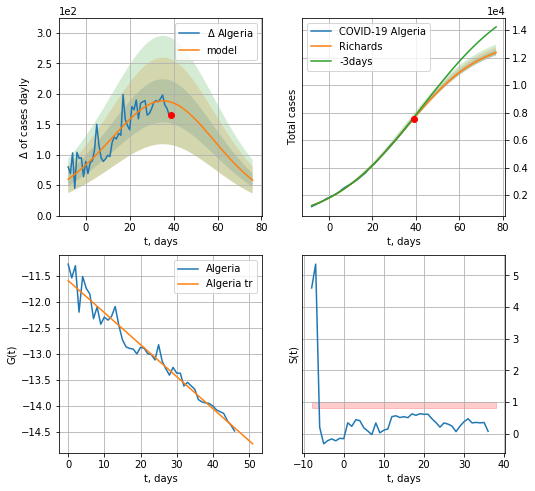

Algeria data at: 2020-07-08
+3 day model MAPE: 0.009853
model: Richards
coeffs: [1.34014708e+04 4.98947126e-02 3.86388178e+01 1.19488243e+00]
rational stdev: 0.015787
forecast at the end of period: +38 days
	 deltaDaycases: 58
	 total cases: 12359 ± 195
	 total death: 696 ± 32
trend coefficient of determination: 0.959635
 intercept: -11.589812
 slope: -0.061720


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


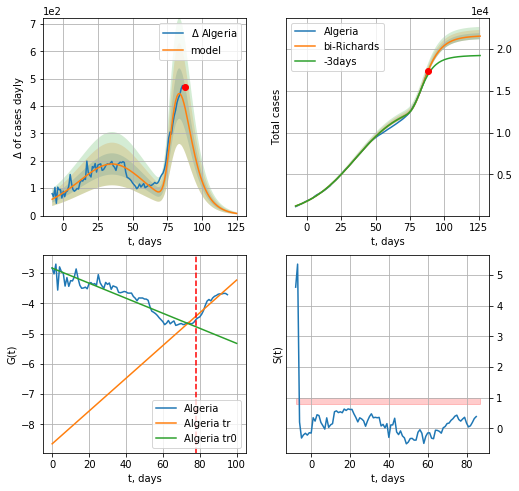

Algeria data at: 2020-07-08
+3 day model MAPE: 0.031083
model: bi-Richards
coeffs: [8.16785689e+03 1.31183302e+01 5.08872686e+01 1.03888128e-02]
rational stdev: 0.017081
forecast at the end of period: +38 days
	 deltaDaycases: 7
	 total cases: 21480 ± 366
	 total death: 1210 ± 62
bi-Richards approximation splitting point: 78
trend coefficient of determination: 0.887757
 intercept: -2.834077
 slope: -0.024895
trend coefficient of determination: 0.861882
 intercept: -8.647154
 slope: 0.054180


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in power


In [288]:
iL = 30
vL = 78+iL
x = forecastRR("Algeria",dfAR[iL:vL-iL],d1,20*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Algeria",dfAR[iL:],d1,20*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


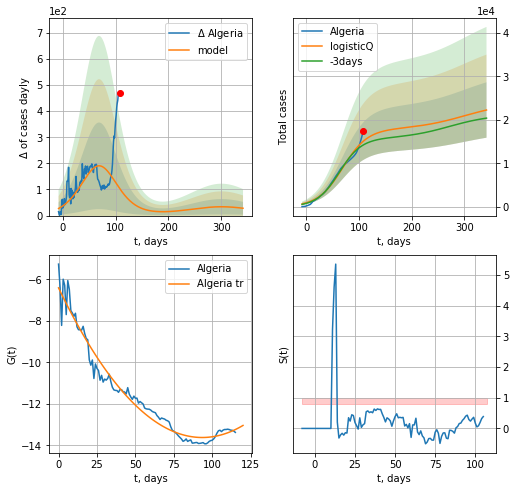

Algeria data at: 2020-07-08
+3 day model MAPE: 0.062304
model: logisticQ
coeffs: [ 1.78103448e+04  2.88221648e-07  6.90471594e+01 -1.47778932e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.286264
forecast at the end of period: +234 days
	 deltaDaycases: 28
	 total cases: 22268 ± 6374
	 total death: 1255 ± 1077
trend coefficient of determination: 0.964125
 intercept_: -6.414363174032963
 coeffs_: [ 0.         -0.15414668  0.00082467]


In [289]:
x = forecastRRR("Algeria",dfAR[10:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

IE
           date  cases   active   death
117 2020-07-04  62142  30834.0  3089.0
118 2020-07-05  64958  31798.0  3241.0
119 2020-07-06  66226  32132.0  3309.0
120 2020-07-07  67146  32132.0  3309.0
121 2020-07-08  68079  33135.0  3359.0


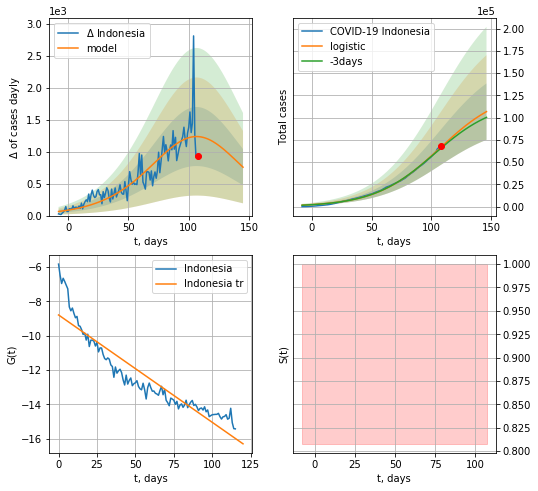

Indonesia data at: 2020-07-08
+3 day model MAPE: 0.019585485627258807
model: logistic
coeffs:  [1.31140638e+05 3.77928513e-02 1.06909437e+02]
rational stdev:  0.29711266588251317
forecast at the end of period: +38 days
	 deltaDaycases:  758
	 total cases:  106770 ± 31722
	 total death:  5268 ± 4695
trend coefficient of determination: 0.861746
 intercept: -8.790991
 slope: -0.062477


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


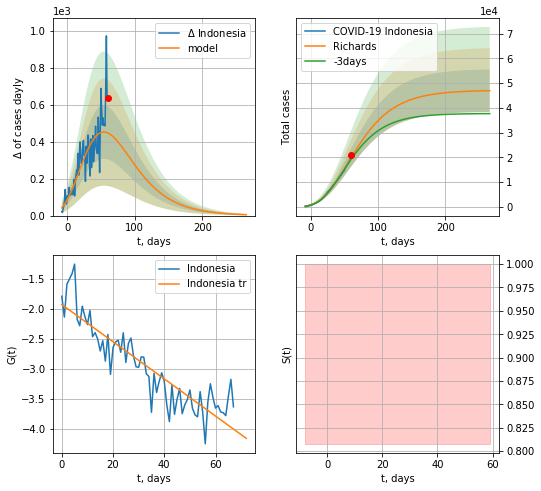

Indonesia data at: 2020-07-08
+3 day model MAPE: 0.038034
model: Richards
coeffs: [ 4.71238175e+04  1.80037267e+00 -1.05970975e+02  1.46070771e-02]
rational stdev: 0.182929
forecast at the end of period: +206 days
	 deltaDaycases: 4
	 total cases: 46942 ± 8587
	 total death: 2316 ± 1270
trend coefficient of determination: 0.798542
 intercept: -1.926274
 slope: -0.031064


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


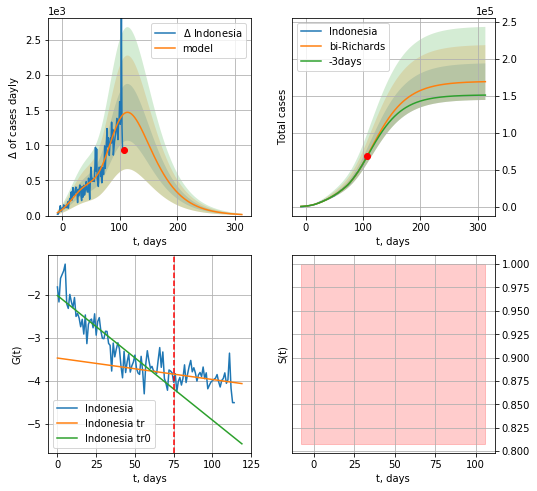

Indonesia data at: 2020-07-08
+3 day model MAPE: 0.009444
model: bi-Richards
coeffs: [ 1.22493936e+05  1.50036441e+00 -2.13054153e+01  1.89563481e-02]
rational stdev: 0.146073
forecast at the end of period: +206 days
	 deltaDaycases: 15
	 total cases: 169086 ± 24698
	 total death: 8342 ± 3655
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.799242
 intercept: -2.007238
 slope: -0.029010
trend coefficient of determination: 0.067828
 intercept: -3.462883
 slope: -0.004994


In [291]:
dfIE = read_df(pd.DataFrame(),"IE")
x = forecast("Indonesia",dfIE[5:],d1,20*7-dT)
vL = 75+6
x = forecastRR("Indonesia",dfIE[6:vL-6],d1,44*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Indonesia",dfIE[6:],d1,44*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-6)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


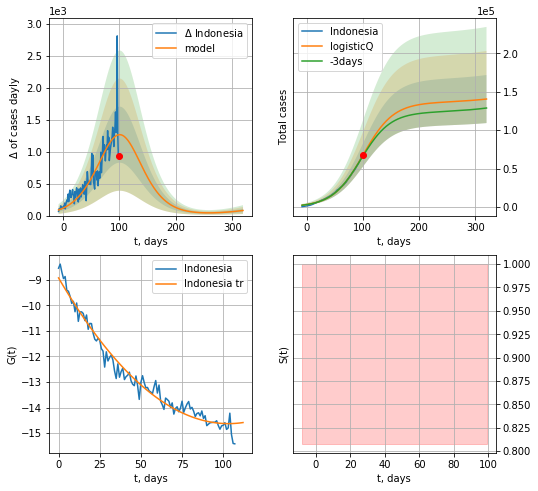

Indonesia data at: 2020-07-08
+3 day model MAPE: 0.017952
model: logisticQ
coeffs: [ 1.35911873e+05  1.80106103e-06  1.00682239e+02 -2.05985123e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.222643
forecast at the end of period: +220 days
	 deltaDaycases: 80
	 total cases: 140593 ± 31302
	 total death: 6936 ± 4632
trend coefficient of determination: 0.971474
 intercept_: -8.928589217266673
 coeffs_: [ 0.         -0.11052431  0.00053576]


In [292]:
x = forecastRRR("Indonesia",dfIE[13:],d1,46*7-dT,addpred=True,xcoef=koreaCoeffs)

PH
           date  cases   active   death
119 2020-07-04  41830  29087.0  1290.0
120 2020-07-05  46333  32845.0  1303.0
121 2020-07-06  47873  34178.0  1309.0
122 2020-07-07  49100  34178.0  1309.0
123 2020-07-08  50359  36457.0  1314.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


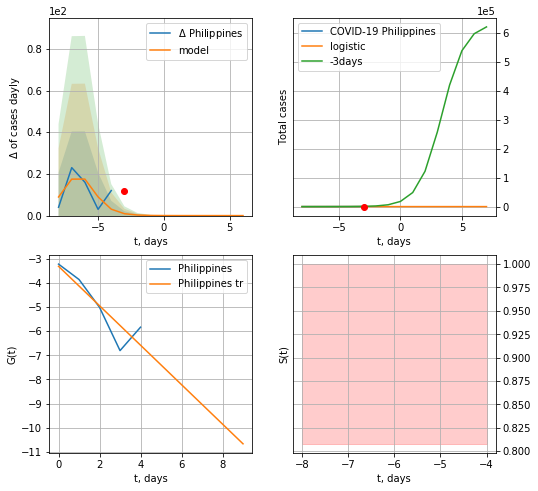

Philippines data at: 2020-07-08
+3 day model MAPE: 0.9724006736169737
model: logistic
coeffs:  [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.19348550855350297
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  61 ± 11
	 total death:  1 ± 0
trend coefficient of determination: 0.794507
 intercept: -3.309972
 slope: -0.817432


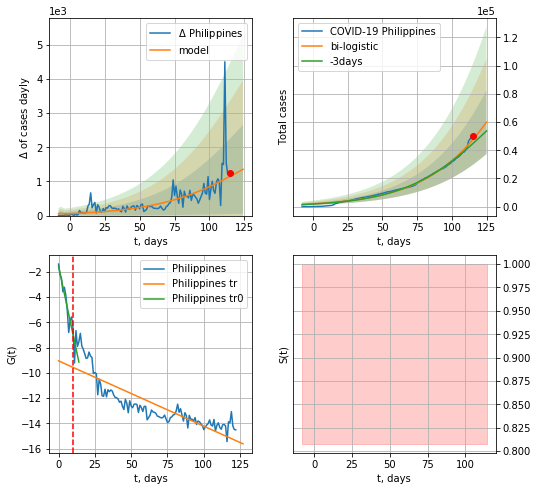

Philippines data at: 2020-07-08
+3 day model MAPE: 0.0673662797622598
model: bi-logistic
coeffs:  [2.66274212e+05 2.94178733e-02 1.67100729e+02] [61.51692029  1.2919553  -5.99802409]
rational stdev:  0.3761727519179023
forecast at the end of period: +10 days
	 deltaDaycases:  1353
	 total cases:  59891 ± 22529
	 total death:  1562 ± 1762
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend coefficient of determination: 0.735927
 intercept: -9.052767
 slope: -0.051754


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:305: RuntimeWarning: overflow encountered in exp


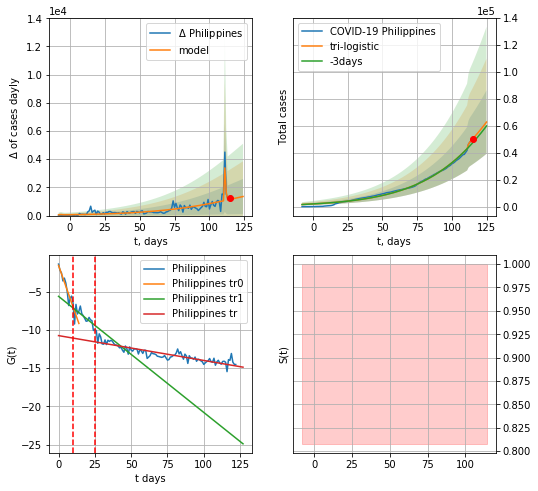

Philippines data at: 2020-07-08
+3 day model MAPE: 0.05947451409438932
model: tri-logistic
coeffs:  [2884.9190426    24.56086714  111.94280542] [ 6.15169203e+01  1.29195530e+00 -5.99802409e+00  2.66274212e+05
  2.94178733e-02  1.67100729e+02]
forecast rational stdev:  0.37525584834663966
forecast at the end of period: +10 days
	 deltaDaycases:  1353
	 total cases:  62776 ± 23557
	 total death:  1638 ± 1844
tri-logistic approximation splitting points: 10,25
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend1 coefficient of determination: 0.474240
 intercept: -5.600607
 slope: -0.151865
trend coefficient of determination: 0.778965
 intercept: -10.737160
 slope: -0.032482


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:305: RuntimeWarning: overflow encountered in exp


In [294]:
vL=10
vL1=25
dfPH = read_df(pd.DataFrame(),"PH")
x = forecast("Philippines",dfPH[4:vL],d1,16*7-dT,addpred=False,xcoef=[0.25,1.,2.3])
xx = forecast2("Philippines",dfPH[:],d1,16*7-dT,x,vL=vL,addpred=False,xcoef=[0.25,1.,1.8])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Philippines",dfPH,d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


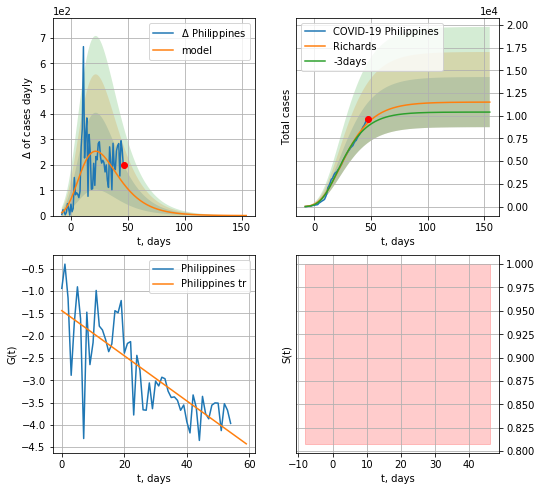

Philippines data at: 2020-07-08
+3 day model MAPE: 0.044209
model: Richards
coeffs: [ 1.15018278e+04  6.61454462e+00 -5.57256966e+01  9.11064046e-03]
rational stdev: 0.239775
forecast at the end of period: +108 days
	 deltaDaycases: 0
	 total cases: 11497 ± 2756
	 total death: 300 ± 215
trend coefficient of determination: 0.622666
 intercept: -1.437831
 slope: -0.050660


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


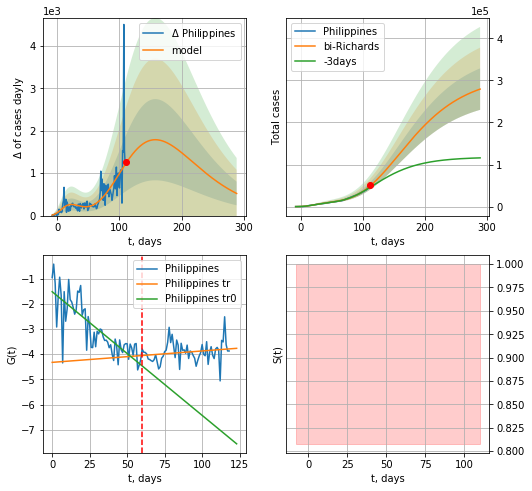

Philippines data at: 2020-07-08
+3 day model MAPE: 0.071643
model: bi-Richards
coeffs: [ 3.01709712e+05  9.61142052e-01 -9.31714330e+01  1.68995253e-02]
rational stdev: 0.176405
forecast at the end of period: +178 days
	 deltaDaycases: 521
	 total cases: 279344 ± 49277
	 total death: 7288 ± 3856
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.656877
 intercept: -1.516646
 slope: -0.049135
trend coefficient of determination: 0.036971
 intercept: -4.323808
 slope: 0.004531


In [295]:
vL = 60 + 4
x = forecastRR("Philippines",dfPH[4:vL-4],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Philippines",dfPH[4:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-4)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


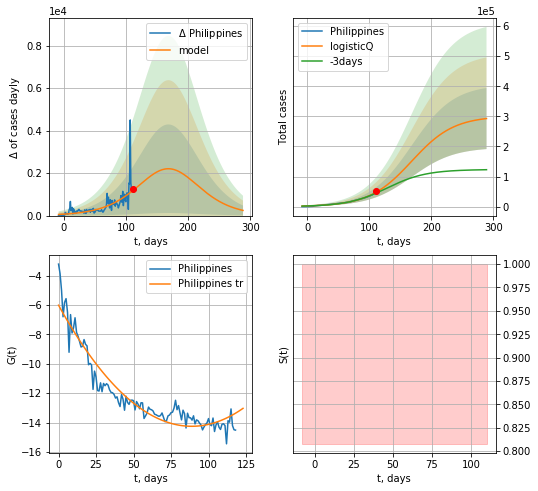

Philippines data at: 2020-07-08
+3 day model MAPE: 0.065868
model: logisticQ
coeffs: [ 3.00757328e+05  2.29007647e-06  1.68325636e+02 -1.26461184e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.346809
forecast at the end of period: +178 days
	 deltaDaycases: 244
	 total cases: 292720 ± 101518
	 total death: 7637 ± 7945
trend coefficient of determination: 0.907395
 intercept_: -6.015282176397996
 coeffs_: [ 0.         -0.1855664   0.00104468]


In [296]:
x = forecastRRR("Philippines",dfPH[4:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

GC
           date   cases  active  death
126 2020-07-04  3511.0    1945  192.0
127 2020-07-05  3519.0    1953  192.0
128 2020-07-06  3562.0    1996  192.0
129 2020-07-07  3589.0    2022  193.0
130 2020-07-08  3622.0    2055  193.0


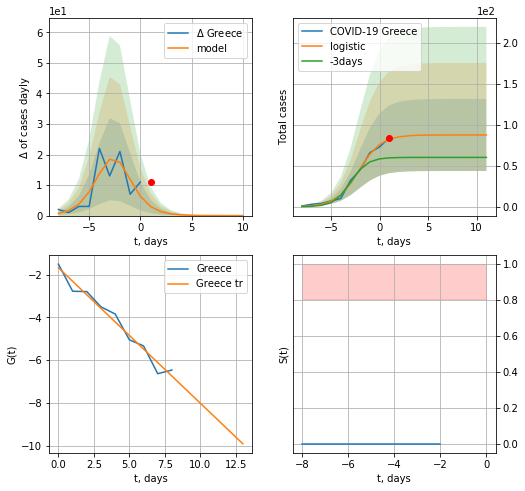

Greece data at: 2020-07-08
+3 day model MAPE: 0.42128754754463943
model: logistic
coeffs:  [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.5018417290456435
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  87 ± 43
	 total death:  4 ± 6
trend coefficient of determination: 0.966991
 intercept: -1.674249
 slope: -0.634181


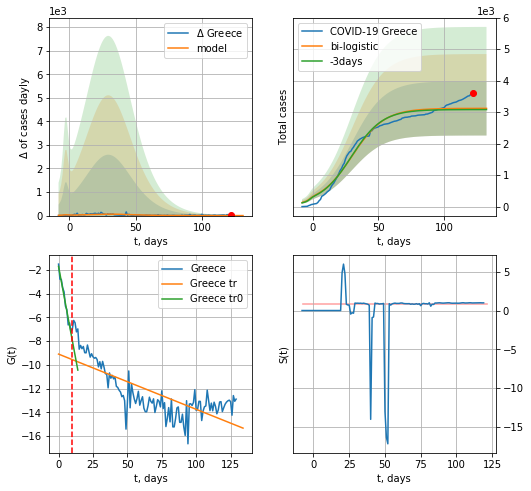

Greece data at: 2020-07-08
+3 day model MAPE: 0.012157484812491652
model: bi-logistic
coeffs:  [3.03294173e+03 8.17658302e-02 2.99547389e+01] [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.276219149696593
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  3119 ± 861
	 total death:  166 ± 137
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.974467
 intercept: -1.699561
 slope: -0.624689
trend coefficient of determination: 0.571075
 intercept: -9.094975
 slope: -0.046602


In [297]:
dfGC = read_df(pd.DataFrame(),"GC")
x = forecast("Greece",dfGC[:10],d1,16*7-dT)
xx = forecast2("Greece",dfGC[:],d1,16*7-dT,x,addpred=False,xcoef=[.25/2,1.,2.3],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


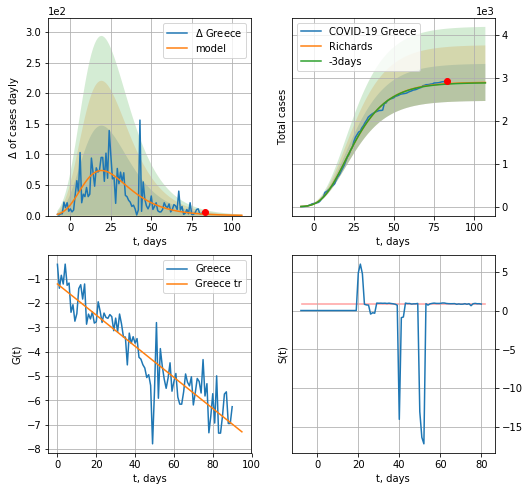

Greece data at: 2020-07-08
+3 day model MAPE: 0.003283
model: Richards
coeffs: [ 2.89327821e+03  7.32575617e+00 -4.72776749e+01  9.49188322e-03]
rational stdev: 0.149150
forecast at the end of period: +24 days
	 deltaDaycases: 0
	 total cases: 2886 ± 430
	 total death: 153 ± 68
trend coefficient of determination: 0.838381
 intercept: -1.223029
 slope: -0.063896


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


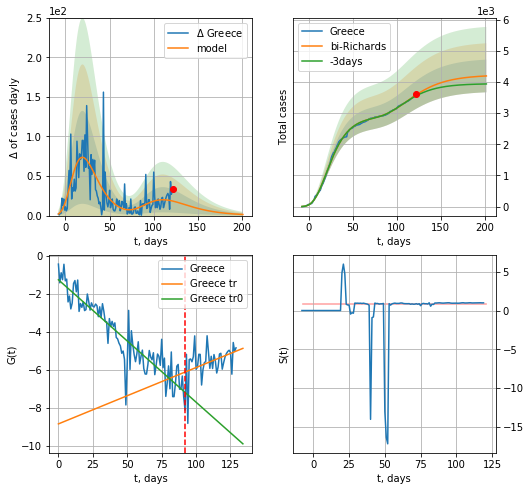

Greece data at: 2020-07-08
+3 day model MAPE: 0.009813
model: bi-Richards
coeffs: [1.33564888e+03 2.50216130e+00 9.20954259e+00 1.61248602e-02]
rational stdev: 0.125081
forecast at the end of period: +80 days
	 deltaDaycases: 1
	 total cases: 4194 ± 524
	 total death: 223 ± 83
bi-Richards approximation splitting point: 92
trend coefficient of determination: 0.844329
 intercept: -1.248002
 slope: -0.064435
trend coefficient of determination: 0.141924
 intercept: -8.833582
 slope: 0.029667


In [299]:
vL = 92
x = forecastRR("Greece",dfGC[:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Greece",dfGC[:],d1,26*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


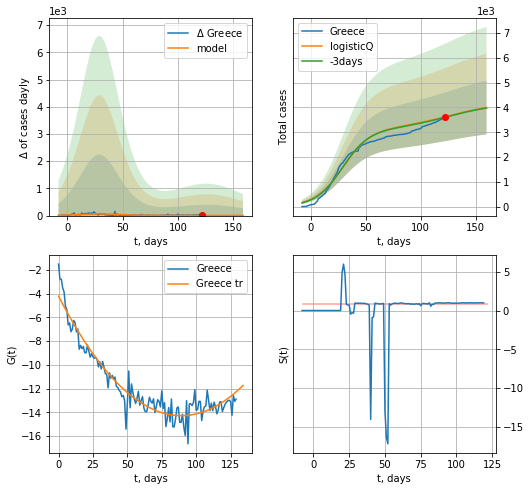

Greece data at: 2020-07-08
+3 day model MAPE: 0.005281
model: logisticQ
coeffs: [ 3.12549169e+03  1.16320887e-07  2.91813352e+01 -6.81440115e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.271004
forecast at the end of period: +38 days
	 deltaDaycases: 7
	 total cases: 3996 ± 1083
	 total death: 212 ± 172
trend coefficient of determination: 0.915184
 intercept_: -4.20683737711948
 coeffs_: [ 0.         -0.22613106  0.00126789]


In [300]:
x = forecastRRR("Greece",dfGC[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

HG
           date   cases  active  death
120 2020-07-04  4174.0     801  589.0
121 2020-07-05  4189.0     740  589.0
122 2020-07-06  4205.0     742  589.0
123 2020-07-07  4210.0     736  589.0
124 2020-07-08  4210.0     736  589.0
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


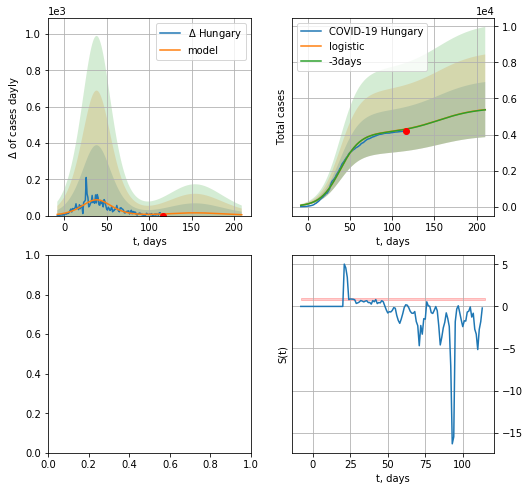

In [301]:
dfHG = read_df(pd.DataFrame(),"HG")
try:
    x = forecast("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=[.35,.5,4,1])
except:
    print("Exception occurs")
#xx = forecast2("Hungary",dfHG[:],d1,4*7-dT,x,vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


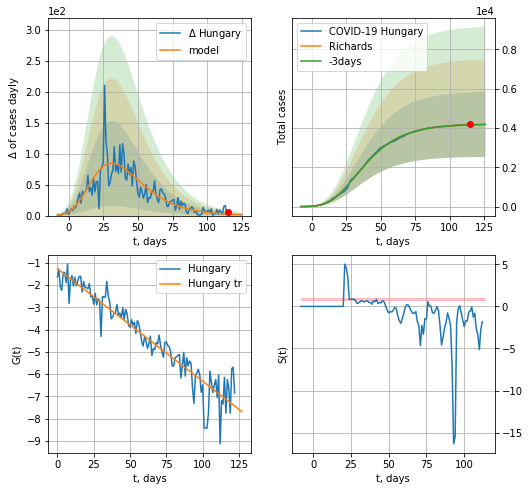

Hungary data at: 2020-07-07
+3 day model MAPE: 0.001106
model: Richards
coeffs: [ 4.20782185e+03  3.94895011e+00 -4.63187566e+01  1.38912313e-02]
rational stdev: 0.395032
forecast at the end of period: +11 days
	 deltaDaycases: 1
	 total cases: 4184 ± 1652
	 total death: 585 ± 693
trend coefficient of determination: 0.895717
 intercept: -1.252247
 slope: -0.050697


In [297]:
vL = 99
x = forecastRR("Hungary",dfHG[:],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
#xx = forecast2RR("Hungary",dfHG[:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


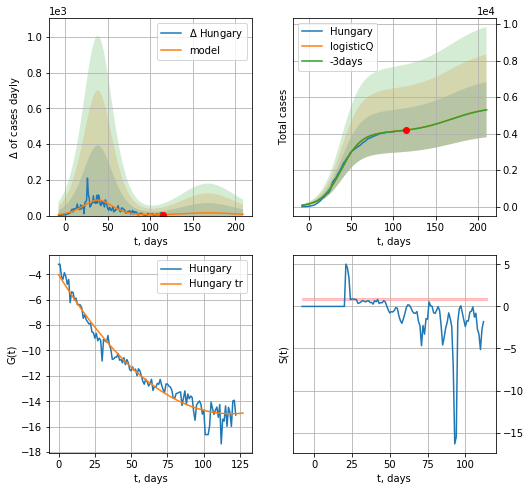

Hungary data at: 2020-07-07
+3 day model MAPE: 0.003011
model: logisticQ
coeffs: [ 4.07279871e+03  3.18027830e-07  3.85953463e+01 -2.67539903e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.284493
forecast at the end of period: +95 days
	 deltaDaycases: 7
	 total cases: 5308 ± 1510
	 total death: 742 ± 633
trend coefficient of determination: 0.962917
 intercept_: -4.033913556257995
 coeffs_: [ 0.         -0.18456048  0.00077779]


In [298]:
x = forecastRRR("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='cases')

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


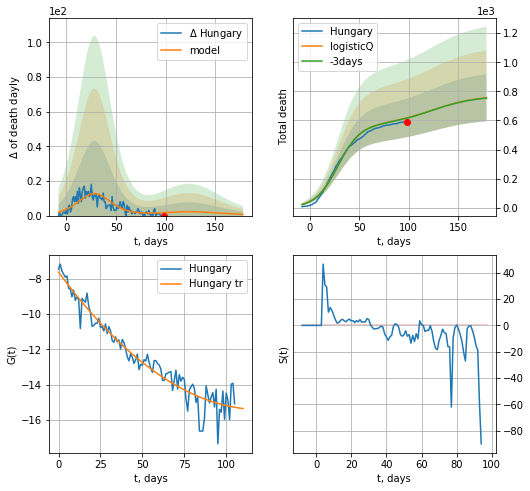

Hungary data at: 2020-07-07
+3 day model MAPE: 0.002931
model: logisticQ
coeffs: [ 5.70210195e+02  3.26505925e-07  2.84708032e+01 -2.71319107e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.214649
forecast at the end of period: +81 days
	 total death: 756 ± 162
trend coefficient of determination: 0.930973
 intercept_: -7.632754313318067
 coeffs_: [ 0.         -0.12884274  0.00053333]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:132: RuntimeWarning: divide by zero encountered in true_divide


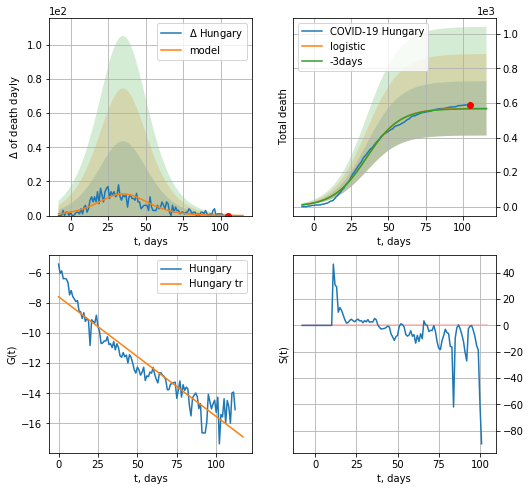

Hungary data at: 2020-07-07
+3 day model MAPE: 0.0040708851808819065
model: logistic
coeffs:  [5.69636022e+02 8.93753842e-02 3.54514475e+01]
rational stdev:  0.2758469562165091
forecast at the end of period: +11 days
	 total death:  569 ± 157
trend coefficient of determination: 0.897138
 intercept: -7.589285
 slope: -0.079478


In [299]:
x = forecastRRR("Hungary",dfHG[17:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')
x = forecast("Hungary",dfHG[10:],d1,16*7-dT,cases='death')

MT
           date  cases  active  death
118 2020-07-04  672.1      12    9.0
119 2020-07-05  672.2      11    9.0
120 2020-07-06  672.3      11    9.0
121 2020-07-07  673.0      11    9.0
122 2020-07-08  673.0      10    9.0


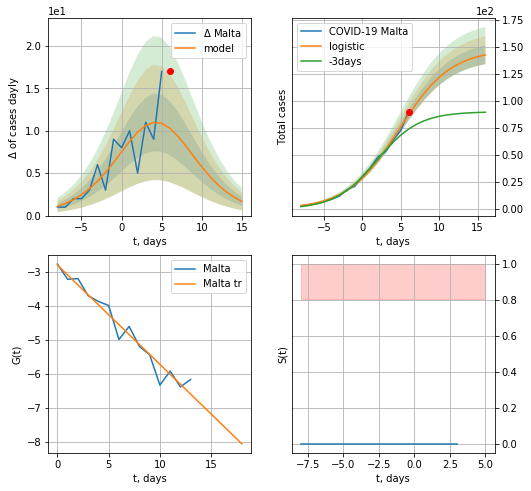

Malta data at: 2020-07-08
model: logistic
coeffs:  [147.79636191   0.29837112   4.7799048 ]
rational stdev:  0.06036954020755974
forecast at the end of period: +10 days
	 deltaDaycases:  1
	 total cases:  142 ± 8
	 total death:  1 ± 0
trend coefficient of determination: 0.952854
 intercept: -2.800130
 slope: -0.292111
Exception occurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


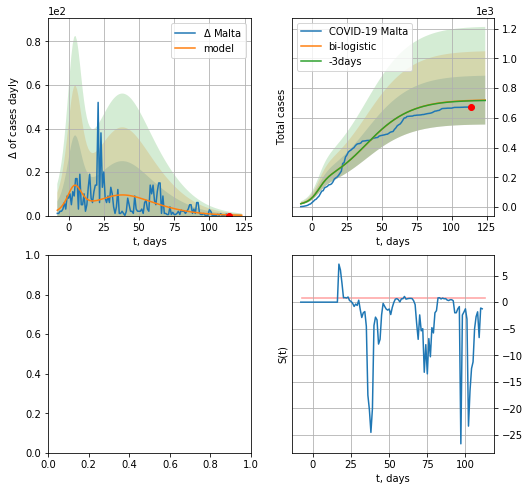

In [302]:
try:
    dfMT = read_df(pd.DataFrame(),"MT")
    x = forecast("Malta",dfMT[:15],d1,7*16-dT,pMAPE=False)
    xx = forecast2("Malta",dfMT[:],d1,7*16-dT,x,vL=15,addpred=True,xcoef=[0.25/2,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


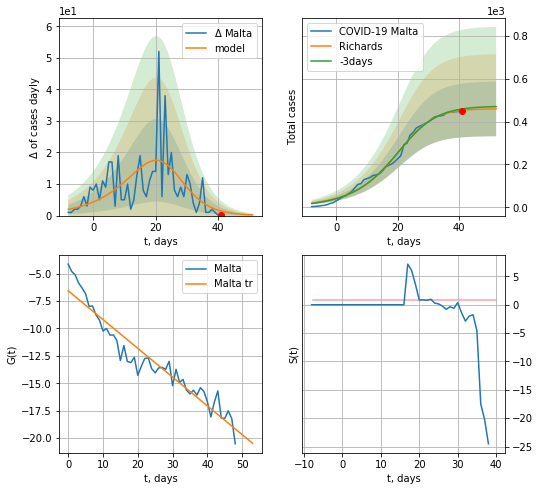

Malta data at: 2020-07-07
+3 day model MAPE: 0.016229
model: Richards
coeffs: [4.60753453e+02 9.94315746e-02 2.41437164e+01 1.98427317e+00]
rational stdev: 0.277865
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 459 ± 127
	 total death: 6 ± 5
trend coefficient of determination: 0.914701
 intercept: -6.567936
 slope: -0.262394


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


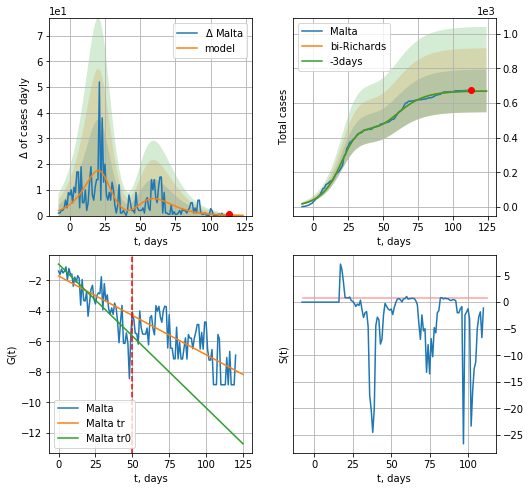

Malta data at: 2020-07-07
+3 day model MAPE: 0.001615
model: bi-Richards
coeffs: [2.09256379e+02 1.48480386e+01 2.57464768e-01 5.80053600e-03]
rational stdev: 0.183740
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 669 ± 122
	 total death: 8 ± 4
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.728228
 intercept: -0.934760
 slope: -0.094285
trend coefficient of determination: 0.477035
 intercept: -1.715028
 slope: -0.051660


In [301]:
vL = 50
x = forecastRR("Malta",dfMT[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Malta",dfMT[:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


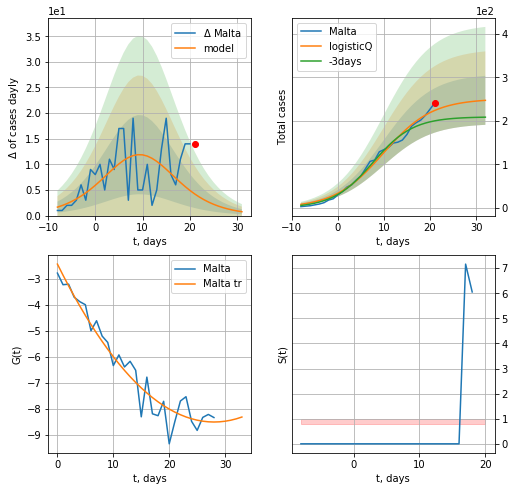

Malta data at: 2020-07-07
+3 day model MAPE: 0.130140
model: logisticQ
coeffs: [ 2.50920068e+02  3.54275509e-06  9.84690922e+00 -5.35768463e+04]
rational stdev: 0.227624
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 247 ± 56
	 total death: 3 ± 2
trend coefficient of determination: 0.935484
 intercept_: -2.4264251666881744
 coeffs_: [ 0.         -0.43368994  0.00773877]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


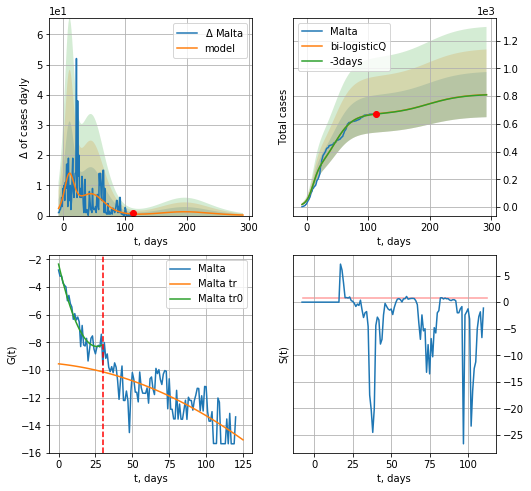

Malta data at: 2020-07-07
+3 day model MAPE: 0.001780
model: bi-logisticQ
coeffs: [ 4.17583804e+02  1.67901759e-07  4.51756391e+01 -4.08134263e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.200839
forecast at the end of period: +179 days
	 deltaDaycases: 0
	 total cases: 811 ± 162
	 total death: 10 ± 6
bi-logisticQ approximation splitting point: 30
trend coefficient of determination: 0.928360
 intercept_: -2.3445378489560733
 coeffs_: [ 0.         -0.45826686  0.00882824]
trend coefficient of determination: 0.574574
 intercept_: -9.547921414319585
 coeffs_: [ 0.         -0.0115466  -0.00025906]


In [302]:
x = forecastRRR("Malta",dfMT[:30],d1,16*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1.])
xx = forecast2RRR("Malta",dfMT[:],d1,40*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=30)

SL
           date   cases  active  death
116 2020-07-04  1749.0   255.0   28.0
117 2020-07-05  1765.0   271.0   28.0
118 2020-07-06  1767.0   266.0   28.0
119 2020-07-07  1798.0   297.0   28.0
120 2020-07-08  1798.0   297.0   28.0


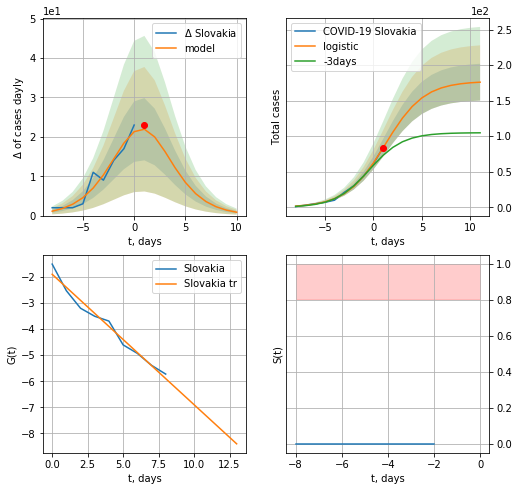

Slovakia data at: 2020-07-08
model: logistic
coeffs:  [177.28786794   0.4996723    1.23158092]
rational stdev:  0.14723856172050678
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  175 ± 25
	 total death:  2 ± 0
trend coefficient of determination: 0.974721
 intercept: -1.894823
 slope: -0.500610
Exception ocurs


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:479: RuntimeWarning: divide by zero encountered in log


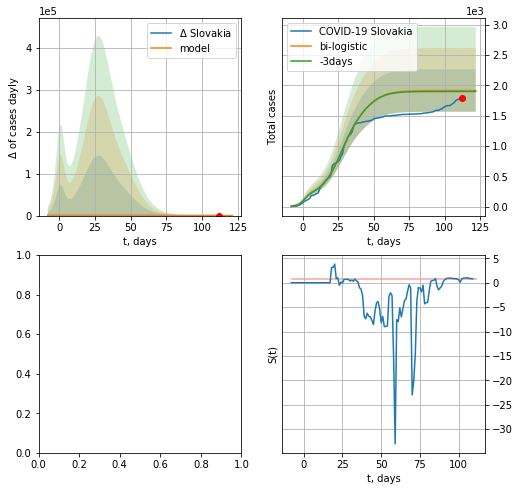

In [303]:
dfSL = read_df(pd.DataFrame(),"SL")
dfSL = dfSL.fillna(0)
try:
    x = forecast("Slovakia",dfSL[:10],d1,16*7-dT,pMAPE=False)
    xx = forecast2("Slovakia",dfSL[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=10)
except:
    print("Exception ocurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


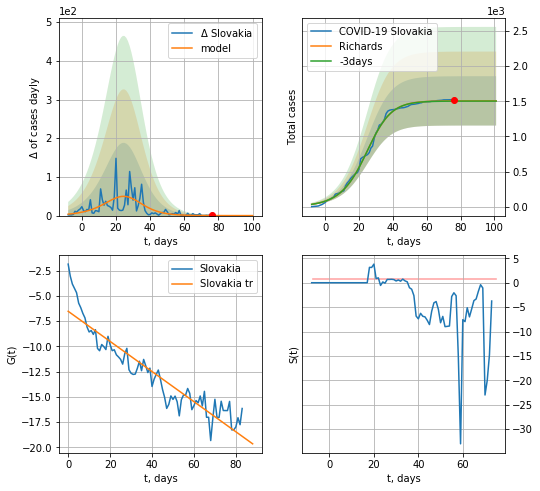

Slovakia data at: 2020-07-07
+3 day model MAPE: 0.002066
model: Richards
coeffs: [1.50610865e+03 1.09508318e-01 2.68945088e+01 1.32920214e+00]
rational stdev: 0.232989
forecast at the end of period: +25 days
	 deltaDaycases: 0
	 total cases: 1506 ± 350
	 total death: 23 ± 16
trend coefficient of determination: 0.871466
 intercept: -6.535200
 slope: -0.149062


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


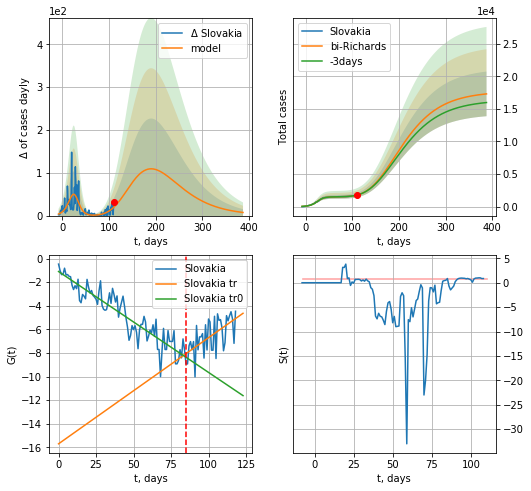

Slovakia data at: 2020-07-07
+3 day model MAPE: 0.001982
model: bi-Richards
coeffs: [1.61742418e+04 3.50238849e-01 3.58199445e+01 5.38458334e-02]
rational stdev: 0.198087
forecast at the end of period: +277 days
	 deltaDaycases: 7
	 total cases: 17293 ± 3425
	 total death: 274 ± 162
bi-Richards approximation splitting point: 85
trend coefficient of determination: 0.851511
 intercept: -1.093332
 slope: -0.085579
trend coefficient of determination: 0.353669
 intercept: -15.707899
 slope: 0.090014


In [379]:
vL = 85
x = forecastRR("Slovakia",dfSL[:vL],d1,18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Slovakia",dfSL[:],d1,54*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


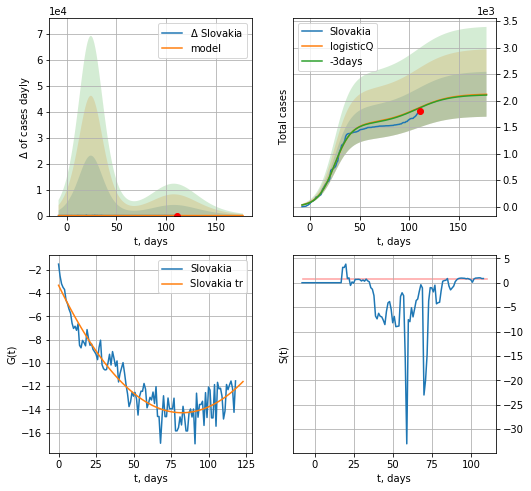

Slovakia data at: 2020-07-07
+3 day model MAPE: 0.003537
model: logisticQ
coeffs: [ 1.57271614e+03  7.02878386e-07  2.48175310e+01 -1.67091312e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.199815
forecast at the end of period: +67 days
	 deltaDaycases: 0
	 total cases: 2120 ± 423
	 total death: 33 ± 19
trend coefficient of determination: 0.897754
 intercept_: -3.3266588085599587
 coeffs_: [ 0.         -0.26659131  0.0016197 ]


In [380]:
x = forecastRRR("Slovakia",dfSL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

SV
           date   cases  active  death
121 2020-07-04  1679.0   184.0  111.0
122 2020-07-05  1716.0   221.0  111.0
123 2020-07-06  1739.0   205.0  111.0
124 2020-07-07  1751.0   205.0  111.0
125 2020-07-08  1763.0   223.0  111.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


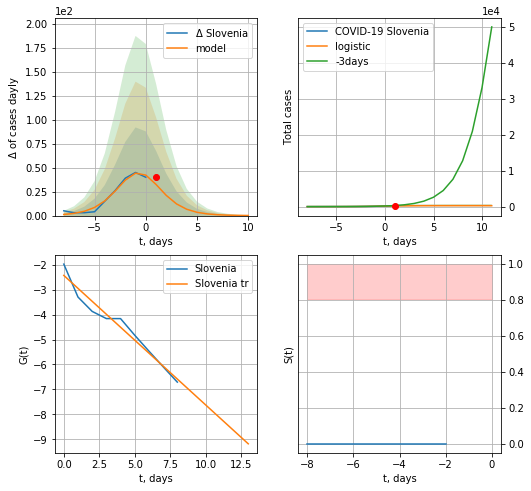

Slovenia data at: 2020-07-08
model: logistic
coeffs:  [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
rational stdev:  0.5312441686508605
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  260 ± 138
	 total death:  16 ± 25
trend coefficient of determination: 0.958485
 intercept: -2.427236
 slope: -0.519636


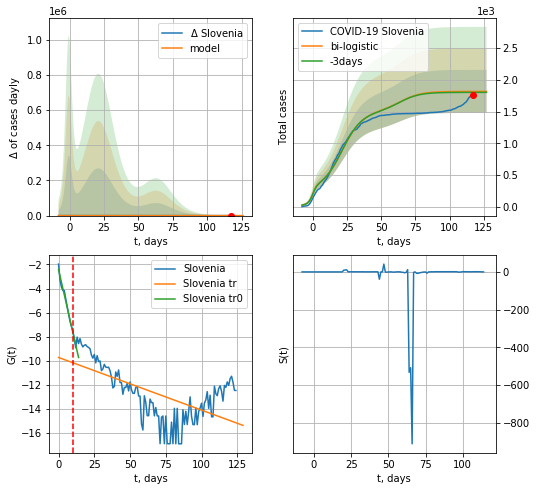

Slovenia data at: 2020-07-08
+3 day model MAPE: 0.008164405809762512
model: bi-logistic
coeffs:  [1.24528340e+03 1.32609452e-01 2.13604929e+01] [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.1866126756970842
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  1817 ± 339
	 total death:  114 ± 63
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.969651
 intercept: -2.421914
 slope: -0.521632
trend coefficient of determination: 0.379881
 intercept: -9.724833
 slope: -0.043701


In [305]:
dfSV = read_df(pd.DataFrame(),"SV").fillna(0)
try:
    x = forecast("Slovenia",dfSV[:10],d1,7*16-dT,pMAPE=False)
    xx = forecast2("Slovenia",dfSV[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,3.],vL=10)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


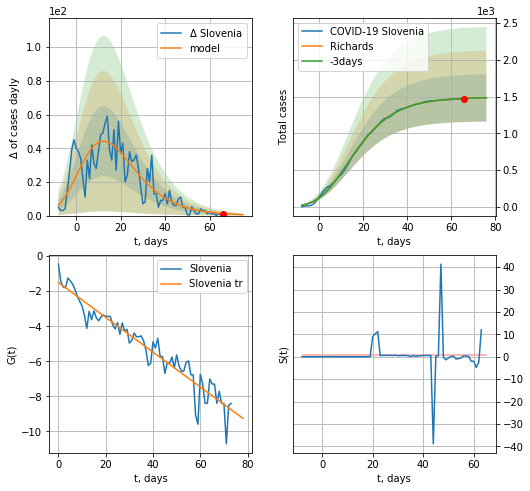

Slovenia data at: 2020-07-08
+3 day model MAPE: 0.001211
model: Richards
coeffs: [ 1.48860897e+03  5.69202399e-01 -8.90072420e+00  1.52510532e-01]
rational stdev: 0.217393
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 1482 ± 322
	 total death: 93 ± 60
trend coefficient of determination: 0.915958
 intercept: -1.505070
 slope: -0.099296


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


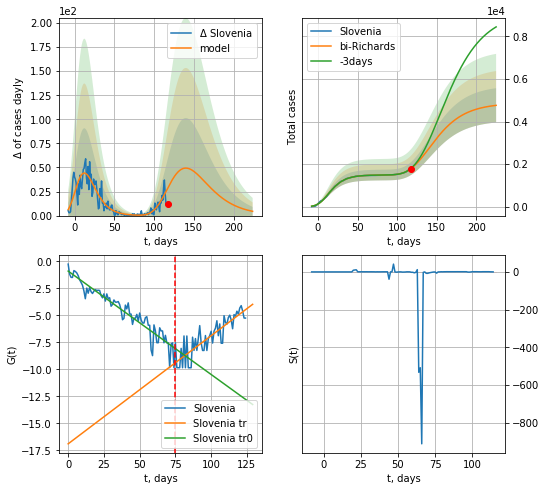

Slovenia data at: 2020-07-08
+3 day model MAPE: 0.006608
model: bi-Richards
coeffs: [3.38076606e+03 1.18268132e+00 5.67438177e+01 3.41340847e-02]
rational stdev: 0.169458
forecast at the end of period: +108 days
	 deltaDaycases: 4
	 total cases: 4760 ± 806
	 total death: 299 ± 152
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.905842
 intercept: -0.890584
 slope: -0.095828
trend coefficient of determination: 0.722455
 intercept: -16.895365
 slope: 0.100200


In [308]:
vL = 75
x = forecastRR("Slovenia",dfSV[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Slovenia",dfSV[:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

[0.35416971, 0.02606324, 4.35859408, 19.30413219]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


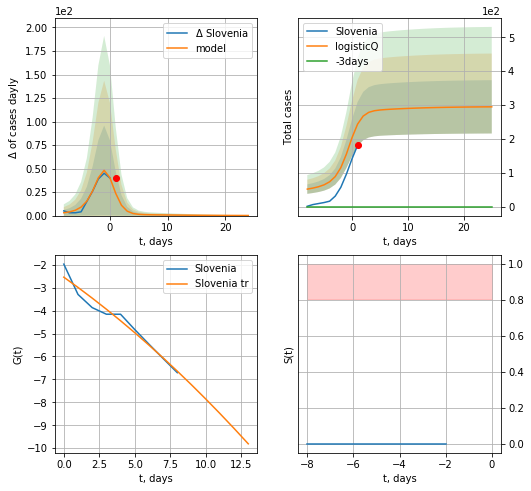

Slovenia data at: 2020-07-08
+3 day model MAPE: inf
model: logisticQ
coeffs: [ 2.17965799e+02  4.01733228e-02 -2.21208435e+01 -7.00287194e-01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.266979
forecast at the end of period: +24 days
	 deltaDaycases: 0
	 total cases: 294 ± 78
	 total death: 18 ± 14
trend coefficient of determination: 0.956027
 intercept_: -2.543480478113449
 coeffs_: [ 0.         -0.43771568 -0.00932819]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:234: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


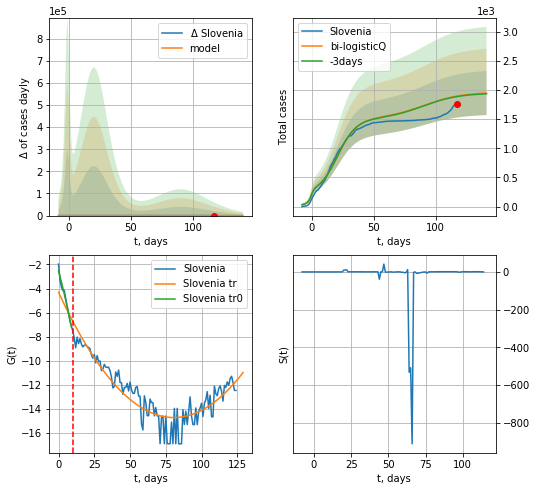

Slovenia data at: 2020-07-08
+3 day model MAPE: 0.004827
model: bi-logisticQ
coeffs: [ 1.28867961e+03  3.09341365e-07  2.07577487e+01 -4.19176110e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.194001
forecast at the end of period: +24 days
	 deltaDaycases: 1
	 total cases: 1946 ± 377
	 total death: 122 ± 71
bi-logisticQ approximation splitting point: 10
trend coefficient of determination: 0.968209
 intercept_: -2.53431844604435
 coeffs_: [ 0.         -0.45029183 -0.00732028]
trend coefficient of determination: 0.828089
 intercept_: -4.310522158007446
 coeffs_: [ 0.         -0.25791116  0.0015986 ]


In [309]:
print(koreaCoeffs)
x = forecastRRR("Slovenia",dfSV[:10],d1,18*7-dT,addpred=True,xcoef=koreaCoeffs)
xx = forecast2RRR("Slovenia",dfSV[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=10)

SB
           date  cases  active  death
116 2020-07-04  15829  2459.0  306.0
117 2020-07-05  16131  2756.0  311.0
118 2020-07-06  16420  2737.0  317.0
119 2020-07-07  16719  3023.0  330.0
120 2020-07-08  17076  3369.0  341.0


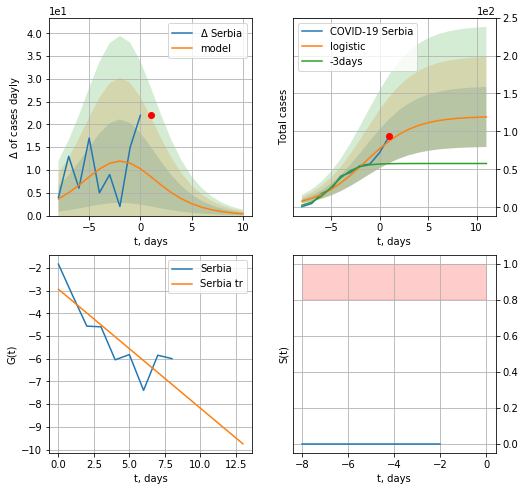

Serbia data at: 2020-07-08
model: logistic
coeffs:  [119.86809018   0.40041874  -1.48148467]
rational stdev:  0.3321032925412913
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  119 ± 39
	 total death:  2 ± 1
trend coefficient of determination: 0.723021
 intercept: -2.939233
 slope: -0.523684


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


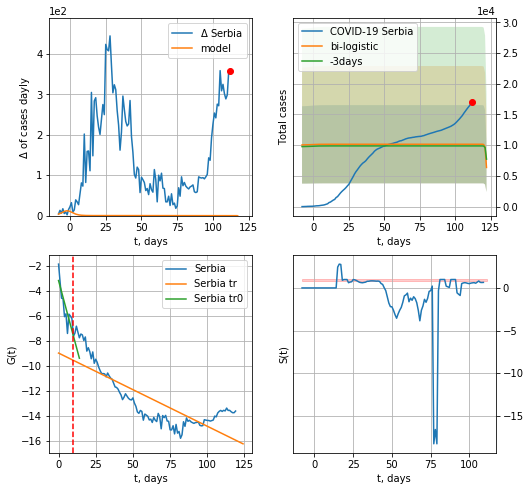

Serbia data at: 2020-07-08
+3 day model MAPE: 0.027625804363548653
model: bi-logistic
coeffs:  [ 8.02811277e+03 -2.61580249e+00  1.22044646e+02] [119.86809018   0.40041874  -1.48148467]
scenario coeffs:  [0.25, 1.0, 2.2]
rational stdev:  0.6270485223135609
forecast at the end of period: +10 days
	 deltaDaycases:  -3289
	 total cases:  6375 ± 3997
	 total death:  127 ± 238
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.680312
 intercept: -3.149496
 slope: -0.444835
trend coefficient of determination: 0.655726
 intercept: -8.964602
 slope: -0.058681


In [310]:
dfSB = read_df(pd.DataFrame(),"SB")
dfSB = dfSB.fillna(0)
x = forecast("Serbia",dfSB[:10],d1,16*7-dT,pMAPE=False)
xx = forecast2("Serbia",dfSB[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,2.2],vL=10)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


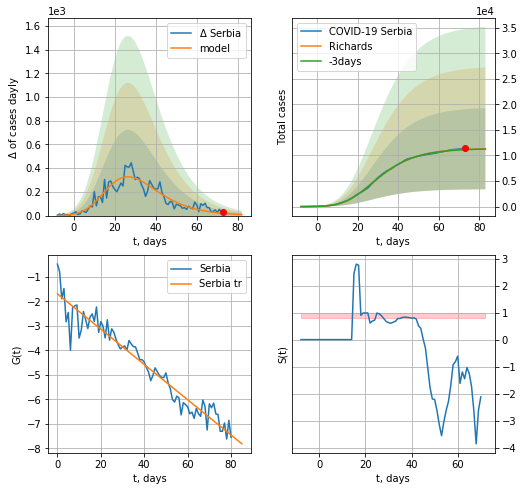

Serbia data at: 2020-07-08
+3 day model MAPE: 0.005935
model: Richards
coeffs: [1.14293254e+04 5.20642407e-01 5.14901126e+00 1.61282517e-01]
rational stdev: 0.700960
forecast at the end of period: +10 days
	 deltaDaycases: 8
	 total cases: 11327 ± 7939
	 total death: 226 ± 475
trend coefficient of determination: 0.932302
 intercept: -1.698040
 slope: -0.071957


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


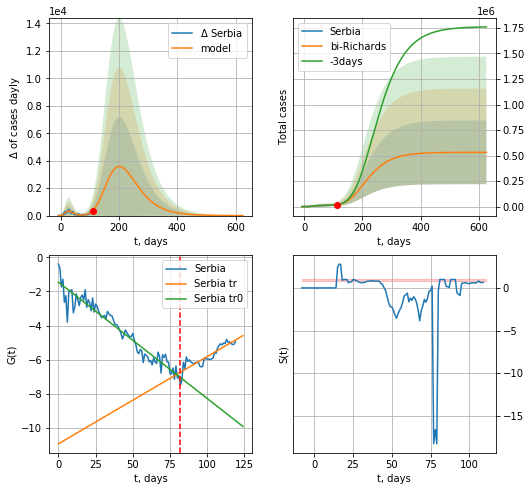

Serbia data at: 2020-07-08
+3 day model MAPE: 0.007314
model: bi-Richards
coeffs: [5.20491331e+05 1.79514314e-01 8.95778995e+01 1.09979602e-01]
rational stdev: 0.587231
forecast at the end of period: +514 days
	 deltaDaycases: 2
	 total cases: 531801 ± 312290
	 total death: 10619 ± 18707
bi-Richards approximation splitting point: 82
trend coefficient of determination: 0.927040
 intercept: -1.452195
 slope: -0.068138
trend coefficient of determination: 0.787854
 intercept: -10.919849
 slope: 0.051081


In [311]:
vL=82
x = forecastRR("Serbia",dfSB[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Serbia",dfSB[:],d1,88*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


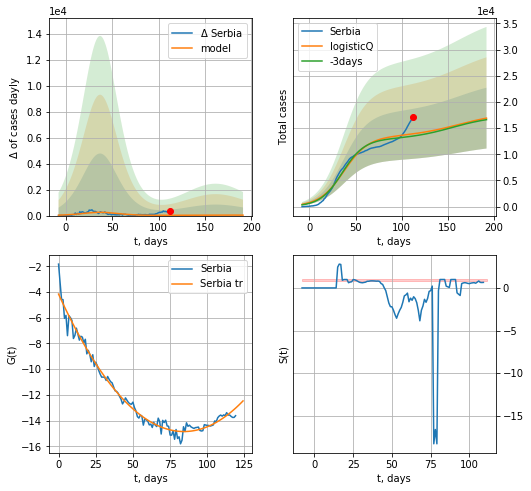

Serbia data at: 2020-07-08
+3 day model MAPE: 0.031601
model: logisticQ
coeffs: [ 1.33278286e+04  1.14979744e-07  3.71723406e+01 -6.57876005e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.343568
forecast at the end of period: +80 days
	 deltaDaycases: 33
	 total cases: 16905 ± 5808
	 total death: 337 ± 347
trend coefficient of determination: 0.979094
 intercept_: -4.16220789814088
 coeffs_: [ 0.         -0.25360421  0.00150528]


In [312]:
x = forecastRRR("Serbia",dfSB[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

CT
           date   cases  active  death
126 2020-07-04  3094.0   798.0  113.0
127 2020-07-05  3151.0   842.0  113.0
128 2020-07-06  3220.0   897.0  113.0
129 2020-07-07  3272.0   930.0  113.0
130 2020-07-08  3325.0   934.0  114.0


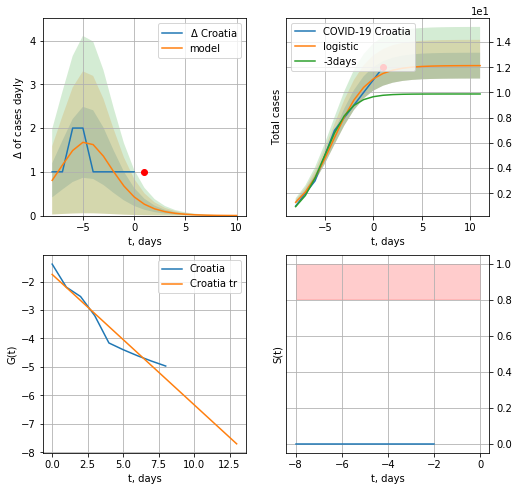

Croatia data at: 2020-07-08
model: logistic
coeffs:  [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.08430442468045289
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  12 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.936719
 intercept: -1.749041
 slope: -0.458074


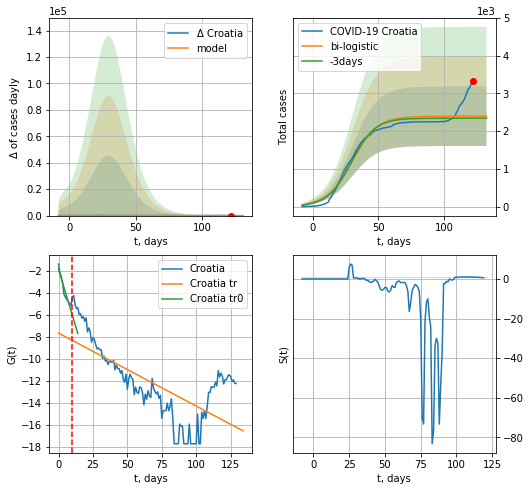

Croatia data at: 2020-07-08
+3 day model MAPE: 0.022623400715845093
model: bi-logistic
coeffs:  [2.38256040e+03 1.05074247e-01 3.01047776e+01] [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.32922874429257226
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  2394 ± 788
	 total death:  82 ± 80
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.922384
 intercept: -1.856940
 slope: -0.417612
trend coefficient of determination: 0.470690
 intercept: -7.666860
 slope: -0.066334


In [313]:
try:
    dfCT = read_df(pd.DataFrame(),"CT")
    dfCT = dfCT.fillna(0)
    x = forecast("Croatia",dfCT[:10],d1,16*7-dT,pMAPE=False)
    xx = forecast2("Croatia",dfCT[:],d1,16*7-dT,x,addpred=False,xcoef=[0.25/2,1.,2.],vL=10)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


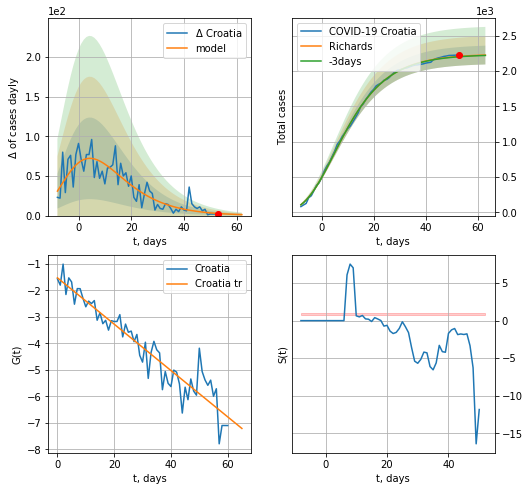

Croatia data at: 2020-07-08
+3 day model MAPE: 0.002310
model: Richards
coeffs: [ 2.23963101e+03  7.95190714e+00 -4.62548924e+01  1.10914885e-02]
rational stdev: 0.059686
forecast at the end of period: +10 days
	 deltaDaycases: 1
	 total cases: 2226 ± 132
	 total death: 76 ± 13
trend coefficient of determination: 0.897394
 intercept: -1.522031
 slope: -0.087533


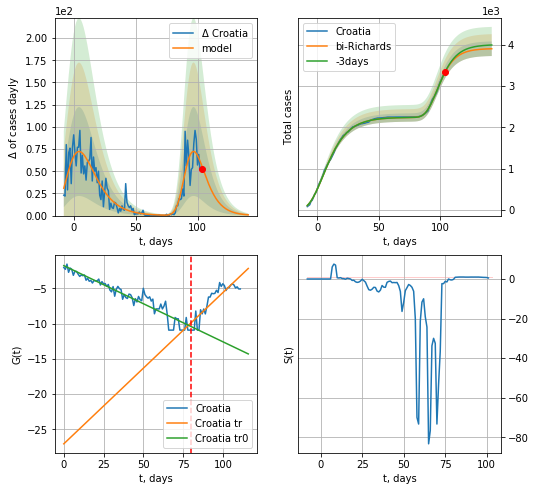

Croatia data at: 2020-07-08
+3 day model MAPE: 0.002721
model: bi-Richards
coeffs: [1.66434196e+03 1.06566152e+00 8.01427692e+01 1.17243821e-01]
rational stdev: 0.045157
forecast at the end of period: +38 days
	 deltaDaycases: 0
	 total cases: 3897 ± 176
	 total death: 133 ± 18
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.908815
 intercept: -1.785806
 slope: -0.107846
trend coefficient of determination: 0.762403
 intercept: -27.034281
 slope: 0.214205


In [314]:
iL = 18
vL = 80+iL
x = forecastRR("Croatia",dfCT[iL:vL-iL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Croatia",dfCT[iL:],d1,20*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


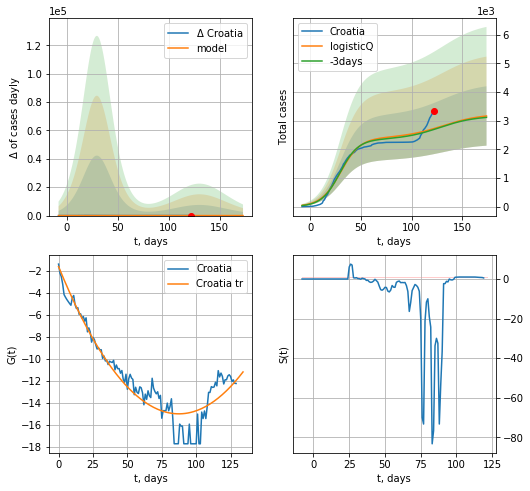

Croatia data at: 2020-07-08
+3 day model MAPE: 0.011028
model: logisticQ
coeffs: [ 2.39580076e+03  1.56240043e-07  3.00003079e+01 -6.66128163e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.327531
forecast at the end of period: +52 days
	 deltaDaycases: 3
	 total cases: 3164 ± 1036
	 total death: 108 ± 106
trend coefficient of determination: 0.892980
 intercept_: -1.6079085229480636
 coeffs_: [ 0.         -0.30673493  0.00175491]


In [315]:
x = forecastRRR("Croatia",dfCT[:],d1,22*7-dT,addpred=True,xcoef=koreaCoeffs)

EG
           date  cases  active   death
120 2020-07-04  74035   50652  3280.0
121 2020-07-05  75253   51184  3343.0
122 2020-07-06  76222   51562  3422.0
123 2020-07-07  77279   52072  3489.0
124 2020-07-08  78304   52499  3564.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


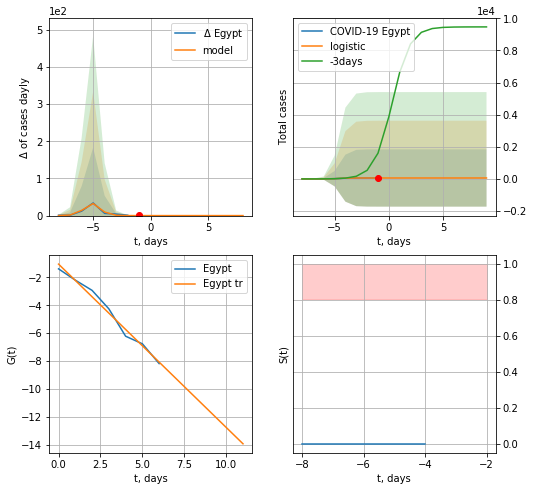

Egypt data at: 2020-07-08
+3 day model MAPE: 0.9848657964650105
model: logistic
coeffs:  [58.57021122  2.53530653 -4.60228222]
rational stdev:  30.428321363178444
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  58 ± 1782
	 total death:  2 ± 182
trend coefficient of determination: 0.982412
 intercept: -1.045837
 slope: -1.172929


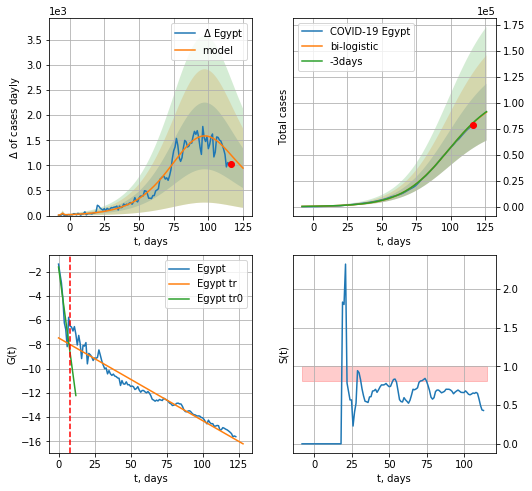

Egypt data at: 2020-07-08
+3 day model MAPE: 0.0035491230970125234
model: bi-logistic
coeffs:  [1.04527017e+05 5.97029054e-02 9.73096591e+01] [58.57021122  2.53530653 -4.60228222]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.300620953259618
forecast at the end of period: +10 days
	 deltaDaycases:  945
	 total cases:  90882 ± 27321
	 total death:  4136 ± 3730
bi-logistic approximation splitting point: 8
trend0 coefficient of determination: 0.807637
 intercept: -1.627174
 slope: -0.882261
trend coefficient of determination: 0.955525
 intercept: -7.466316
 slope: -0.068190


In [316]:
dfEG = read_df(pd.DataFrame(),"EG")
x = forecast("Egypt",dfEG[:8],d1,7*16-dT)
xx = forecast2("Egypt",dfEG[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=8)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


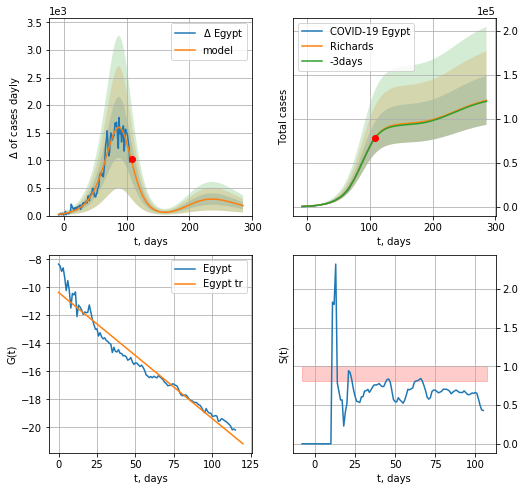

Egypt data at: 2020-07-08
+3 day model MAPE: 0.004314
model: Richards
coeffs: [9.49211610e+04 5.37647741e-02 9.27383210e+01 1.40673362e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.230194
forecast at the end of period: +178 days
	 deltaDaycases: 180
	 total cases: 121179 ± 27894
	 total death: 5515 ± 3808
trend coefficient of determination: 0.959372
 intercept: -10.368277
 slope: -0.090079


In [317]:
x = forecastRR("Egypt",dfEG[8:],d1,40*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


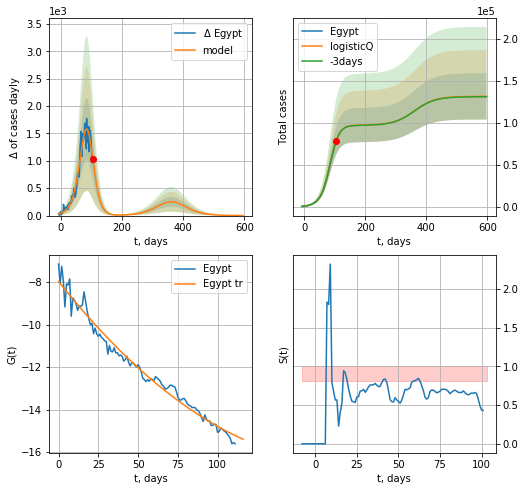

Egypt data at: 2020-07-08
+3 day model MAPE: 0.000981
model: logisticQ
coeffs: [ 9.70543990e+04  1.02811123e-04  8.27747513e+01 -5.50631118e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.209765
forecast at the end of period: +493 days
	 deltaDaycases: 0
	 total cases: 131399 ± 27563
	 total death: 5980 ± 3763
trend coefficient of determination: 0.978207
 intercept_: -7.9727941665886455
 coeffs_: [ 0.         -0.09407631  0.00025978]


In [318]:
x = forecastRRR("Egypt",dfEG[12:],d1,85*7-dT,addpred=True,xcoef=koreaCoeffs)

IQ
           date  cases   active   death
123 2020-07-04  58354  24909.0  2368.0
124 2020-07-05  60479  24989.0  2473.0
125 2020-07-06  62275  24967.0  2567.0
126 2020-07-07  64701  25764.0  2685.0
127 2020-07-08  67442  26784.0  2779.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


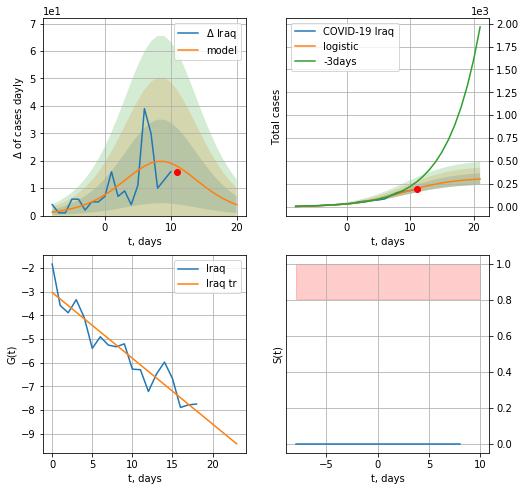

Iraq data at: 2020-07-08
+3 day model MAPE: 0.3447403684117319
model: logistic
coeffs:  [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.20777406895257303
forecast at the end of period: +10 days
	 deltaDaycases:  3
	 total cases:  302 ± 62
	 total death:  12 ± 7
trend coefficient of determination: 0.889033
 intercept: -3.031672
 slope: -0.278416


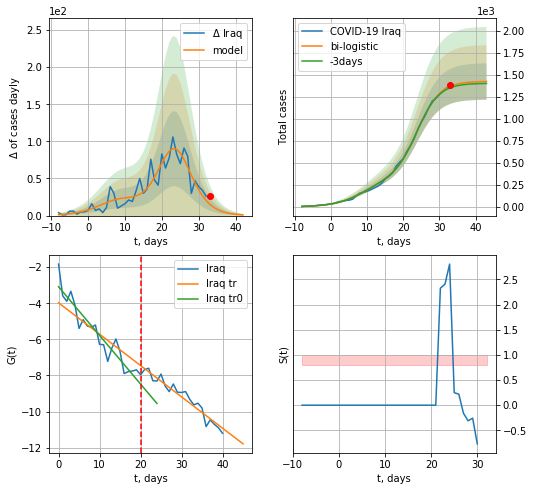

Iraq data at: 2020-07-08
+3 day model MAPE: 0.012548655608678476
model: bi-logistic
coeffs:  [1.10877596e+03 3.20225975e-01 2.39035989e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.14537179336300032
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  1423 ± 206
	 total death:  58 ± 25
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend coefficient of determination: 0.928562
 intercept: -3.976586
 slope: -0.173518


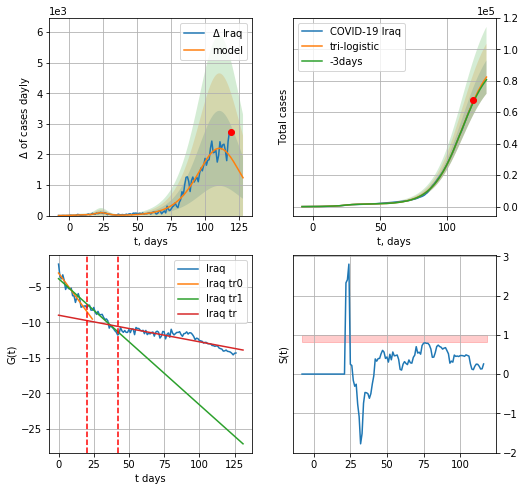

Iraq data at: 2020-07-08
+3 day model MAPE: 0.010982832164879521
model: tri-logistic
coeffs:  [9.66493958e+04 9.10072454e-02 1.11031751e+02] [3.17081296e+02 2.50431387e-01 8.98163530e+00 1.10877596e+03
 3.20225975e-01 2.39035989e+01]
forecast rational stdev:  0.12908805743337928
forecast at the end of period: +10 days
	 deltaDaycases:  1237
	 total cases:  82310 ± 10625
	 total death:  3391 ± 1313
tri-logistic approximation splitting points: 20,42
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend1 coefficient of determination: 0.937217
 intercept: -3.879636
 slope: -0.177153
trend coefficient of determination: 0.759312
 intercept: -9.013050
 slope: -0.037366


In [319]:
vL=20
vL1=42
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIQ = dfIQ.fillna(0)
x = forecast("Iraq",dfIQ[:vL],d1,16*7-dT)
xx = forecast2("Iraq",dfIQ[:vL1],d1,16*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Iraq",dfIQ[:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


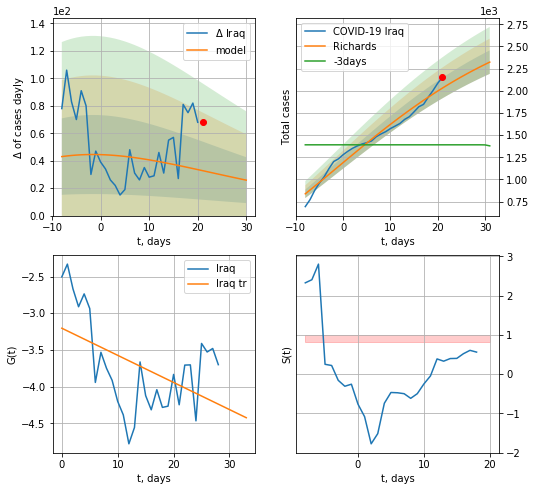

Iraq data at: 2020-07-08
+3 day model MAPE: 0.483696
model: Richards
coeffs: [ 3.05374051e+03  1.25736108e+00 -8.65808580e+01  3.20212773e-02]
rational stdev: 0.056950
forecast at the end of period: +10 days
	 deltaDaycases: 25
	 total cases: 2323 ± 132
	 total death: 95 ± 16
trend coefficient of determination: 0.238101
 intercept: -3.204366
 slope: -0.036947


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


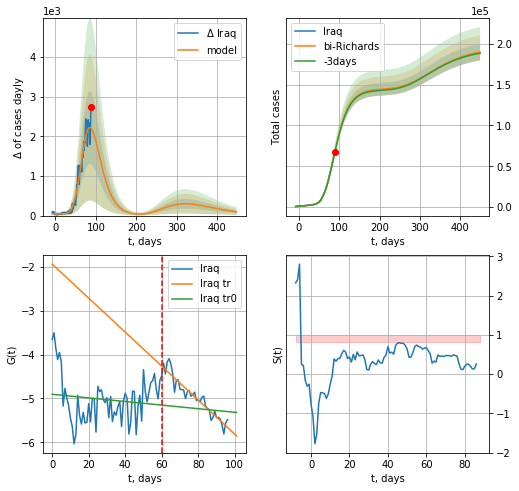

Iraq data at: 2020-07-08
+3 day model MAPE: 0.000118
model: bi-Richards
coeffs: [1.41746692e+05 2.28269670e-01 5.20199132e+01 2.05209291e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.053956
forecast at the end of period: +360 days
	 deltaDaycases: 93
	 total cases: 189940 ± 10248
	 total death: 7826 ± 1266
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.017701
 intercept: -4.906696
 slope: -0.004102
trend coefficient of determination: 0.897933
 intercept: -1.938401
 slope: -0.038777


In [320]:
vL=60+30#25+10
x = forecastRR("Iraq",dfIQ[30:vL-30],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iraq",dfIQ[30:],d1,66*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL-30)

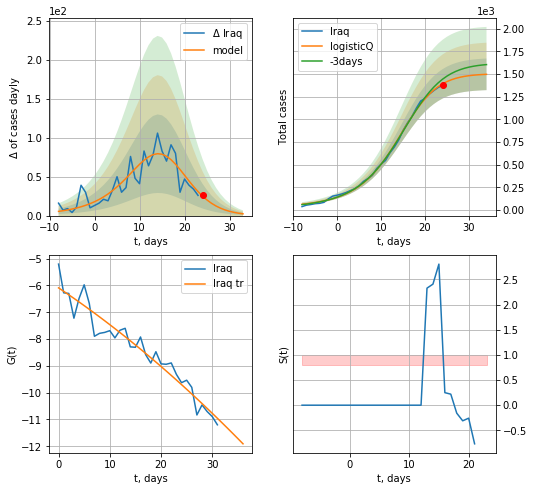

Iraq data at: 2020-07-08
+3 day model MAPE: 0.041008
model: logisticQ
coeffs: [ 1.50291916e+03  2.94853860e-03  1.34415511e+01 -5.72228334e+01]
rational stdev: 0.116469
forecast at the end of period: +10 days
	 deltaDaycases: 2
	 total cases: 1496 ± 174
	 total death: 61 ± 21
trend coefficient of determination: 0.930646
 intercept_: -6.090644942877015
 coeffs_: [ 0.         -0.12791486 -0.00093535]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


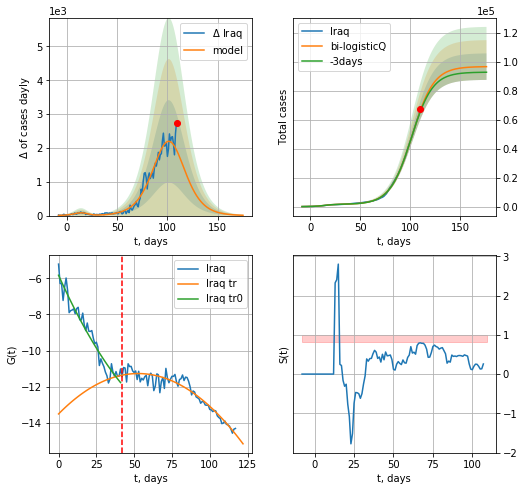

Iraq data at: 2020-07-08
+3 day model MAPE: 0.012795
model: bi-logisticQ
coeffs: [ 9.53410479e+04  1.02031512e-05  1.01753468e+02 -8.93095287e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.094649
forecast at the end of period: +66 days
	 deltaDaycases: 9
	 total cases: 96748 ± 9157
	 total death: 3986 ± 1131
bi-logisticQ approximation splitting point: 42
trend coefficient of determination: 0.941003
 intercept_: -5.824005146615983
 coeffs_: [ 0.         -0.18682641  0.00101526]
trend coefficient of determination: 0.912153
 intercept_: -13.51778752450825
 coeffs_: [ 0.          0.08520492 -0.00080974]


In [321]:
x = forecastRRR("Iraq",dfIQ[9:42],d1,16*7-dT,addpred=False,xcoef=[0.35,.5,4.,1])
xx = forecast2RRR("Iraq",dfIQ[9:],d1,24*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=42)

In [322]:
#len(dfAR)

AR
           date    cases  active  death
122 2020-07-04  15500.0  3373.0  946.0
123 2020-07-05  15941.0  3497.0  952.0
124 2020-07-06  16404.0  3561.0  959.0
125 2020-07-07  16879.0  3817.0  968.0
126 2020-07-08  17348.0  4041.0  978.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


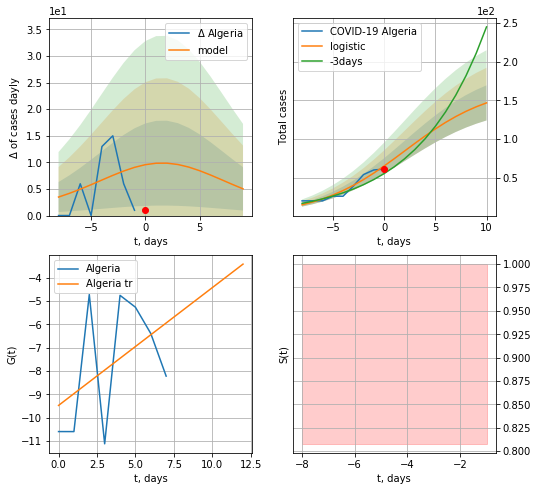

Algeria data at: 2020-07-08
+3 day model MAPE: 0.16392556519478307
model: logistic
coeffs:  [169.67177645   0.23328983   2.04237406]
rational stdev:  0.15467845008978148
forecast at the end of period: +10 days
	 deltaDaycases:  5
	 total cases:  146 ± 22
	 total death:  8 ± 3
trend coefficient of determination: 0.198482
 intercept: -9.477734
 slope: 0.504434


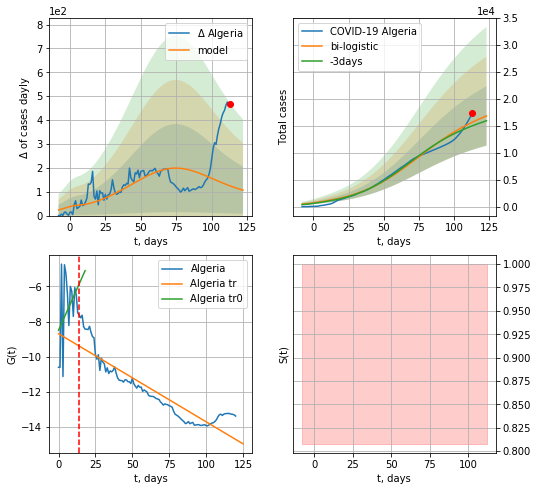

Algeria data at: 2020-07-08
+3 day model MAPE: 0.045863169759612105
model: bi-logistic
coeffs:  [1.73003102e+04 4.43414444e-02 7.35223656e+01] [169.67177645   0.23328983   2.04237406]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.32706159973547305
forecast at the end of period: +10 days
	 deltaDaycases:  106
	 total cases:  16842 ± 5508
	 total death:  949 ± 931
bi-logistic approximation splitting point: 14
trend0 coefficient of determination: 0.134003
 intercept: -8.492024
 slope: 0.188486
trend coefficient of determination: 0.829671
 intercept: -8.687581
 slope: -0.050102


In [323]:
dfAR = read_df(pd.DataFrame(),"AR")
x = forecast("Algeria",dfAR[5:14],d1,7*16-dT)
xx = forecast2("Algeria",dfAR[5:],d1,7*16-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=14)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


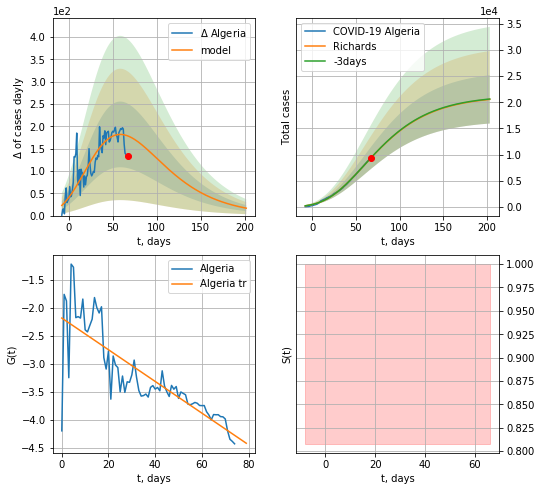

Algeria data at: 2020-07-08
+3 day model MAPE: 0.002676
model: Richards
coeffs: [ 2.12814905e+04  1.20319901e+00 -1.08693333e+02  1.95061272e-02]
rational stdev: 0.224506
forecast at the end of period: +136 days
	 deltaDaycases: 16
	 total cases: 20568 ± 4617
	 total death: 1159 ± 780
trend coefficient of determination: 0.678514
 intercept: -2.184065
 slope: -0.028199


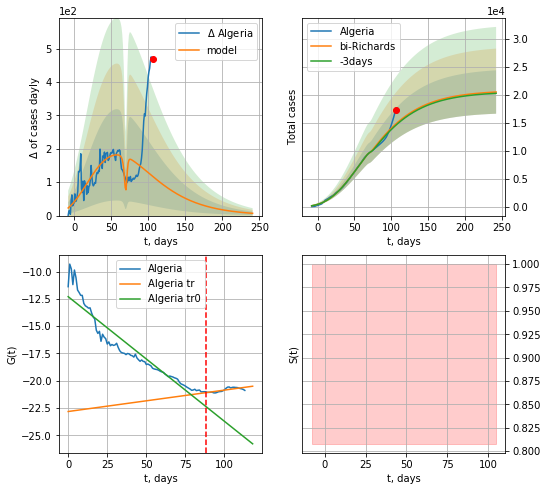

Algeria data at: 2020-07-08
+3 day model MAPE: 0.015832
model: bi-Richards
coeffs: [-486.38643665    0.58660141   70.74809231    1.77033835]
rational stdev: 0.188797
forecast at the end of period: +136 days
	 deltaDaycases: 6
	 total cases: 20506 ± 3871
	 total death: 1156 ± 654
bi-Richards approximation splitting point: 88
trend coefficient of determination: 0.900054
 intercept: -12.303276
 slope: -0.114252
trend coefficient of determination: 0.579191
 intercept: -22.825601
 slope: 0.019622


In [324]:
vL = 88+12
x = forecastRR("Algeria",dfAR[12:vL-12],d1,34*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Algeria",dfAR[12:],d1,34*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


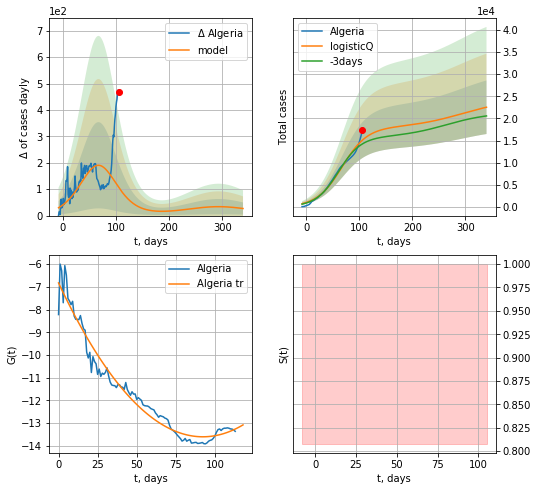

Algeria data at: 2020-07-08
+3 day model MAPE: 0.062194
model: logisticQ
coeffs: [ 1.79053181e+04  2.43224189e-07  6.73477004e+01 -1.73903591e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.268749
forecast at the end of period: +234 days
	 deltaDaycases: 26
	 total cases: 22527 ± 6054
	 total death: 1269 ± 1023
trend coefficient of determination: 0.962106
 intercept_: -6.8263007523661265
 coeffs_: [ 0.         -0.14699718  0.0007961 ]


In [325]:
x = forecastRRR("Algeria",dfAR[12:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

CP
           date   cases  active  death
114 2020-07-04  1002.0   144.0   19.0
115 2020-07-05  1003.0   145.0   19.0
116 2020-07-06  1004.0   146.0   19.0
117 2020-07-07  1005.0   147.0   19.0
118 2020-07-08  1008.0   150.0   19.0


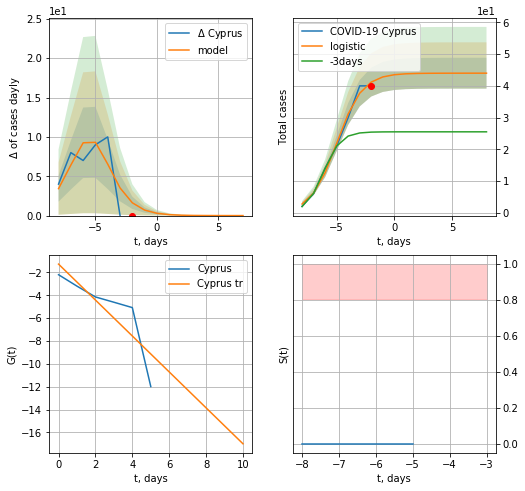

Cyprus data at: 2020-07-08
+3 day model MAPE: 0.6804910041763989
model: logistic
coeffs:  [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.11057143078785021
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  44 ± 4
	 total death:  0 ± 0
trend coefficient of determination: 0.714597
 intercept: -1.270285
 slope: -1.572073


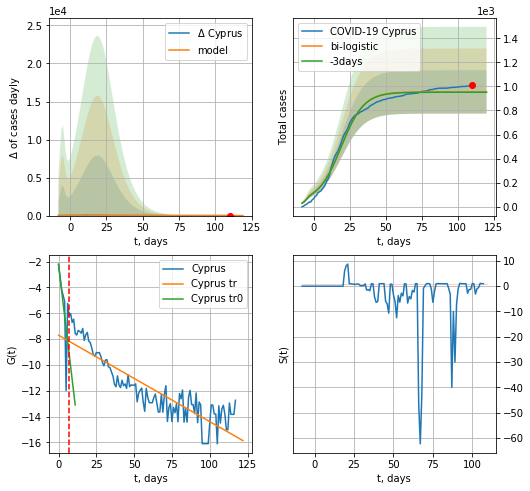

Cyprus data at: 2020-07-08
+3 day model MAPE: 0.0029775304562722578
model: bi-logistic
coeffs:  [9.10287751e+02 1.26784111e-01 1.92097350e+01] [44.00930084  0.89972657 -4.98223467]
rational stdev:  0.18849914572727586
forecast at the end of period: +10 days
	 deltaDaycases:  0
	 total cases:  954 ± 179
	 total death:  17 ± 9
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.449603
 intercept: -2.247366
 slope: -0.985825
trend coefficient of determination: 0.776464
 intercept: -7.700067
 slope: -0.066853


In [326]:
try:
    dfCP = read_df(pd.DataFrame(),"CP")
    dfCP = dfCP.fillna(0)
    x = forecast("Cyprus",dfCP[:7],d1,7*16-dT)
    xx = forecast2("Cyprus",dfCP[:],d1,16*7-dT,x,addpred=False,xcoef=[0.25,1.,2.3],vL=7)
except:
    print ("Exception occurs")

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


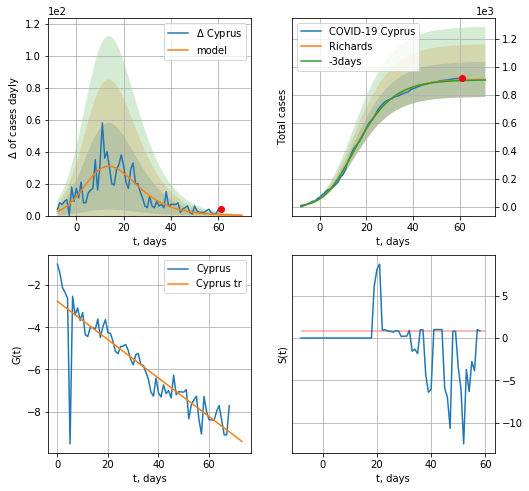

Cyprus data at: 2020-07-08
+3 day model MAPE: 0.004368
model: Richards
coeffs: [9.11933822e+02 3.20830854e-01 3.99756256e+00 3.34642778e-01]
rational stdev: 0.137523
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 909 ± 125
	 total death: 17 ± 7
trend coefficient of determination: 0.787995
 intercept: -2.772129
 slope: -0.090979


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


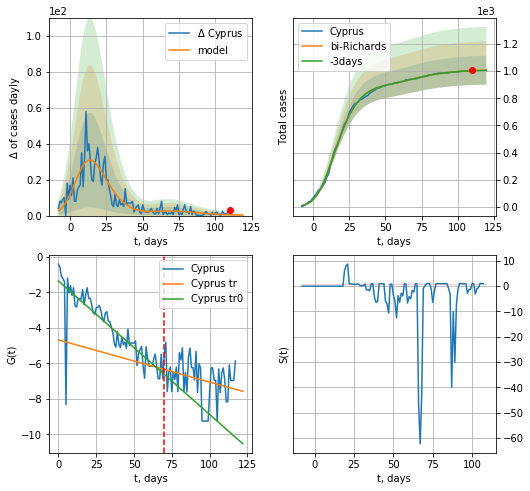

Cyprus data at: 2020-07-08
+3 day model MAPE: 0.001276
model: bi-Richards
coeffs: [ 9.88880516e+01  8.77256899e+00 -6.05013134e+00  7.30034208e-03]
rational stdev: 0.105437
forecast at the end of period: +10 days
	 deltaDaycases: 0
	 total cases: 1006 ± 106
	 total death: 18 ± 5
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.728408
 intercept: -1.365635
 slope: -0.075096
trend coefficient of determination: 0.077110
 intercept: -4.682327
 slope: -0.023737


In [327]:
vL=70
x = forecastRR("Cyprus",dfCP[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
x = forecast2RR("Cyprus",dfCP[:],d1,16*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


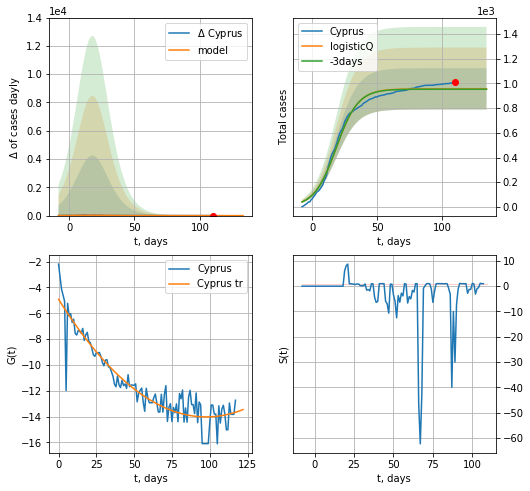

Cyprus data at: 2020-07-08
+3 day model MAPE: 0.002886
model: logisticQ
coeffs: [ 9.56427805e+02  3.24108837e-07  1.83162197e+01 -3.65776299e+05]
rational stdev: 0.174996
forecast at the end of period: +24 days
	 deltaDaycases: 0
	 total cases: 956 ± 167
	 total death: 18 ± 9
trend coefficient of determination: 0.873610
 intercept_: -4.922785587545928
 coeffs_: [ 0.         -0.18635891  0.00095444]


In [328]:
vL=33
x = forecastRRR("Cyprus",dfCP[:],d1,18*7-dT,addpred=False,xcoef=koreaCoeffs)
#xx = forecast2RRR("Cyprus",dfCP[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,4,1],vL=vL)

PU
           date   cases   active    death
118 2020-07-03  295599  99521.0  10226.0
119 2020-07-04  299080  99047.0  10412.0
120 2020-07-05  302718  98172.0  10589.0
121 2020-07-06  305703  97312.0  10772.0
122 2020-07-07  309278  97388.0  10952.0


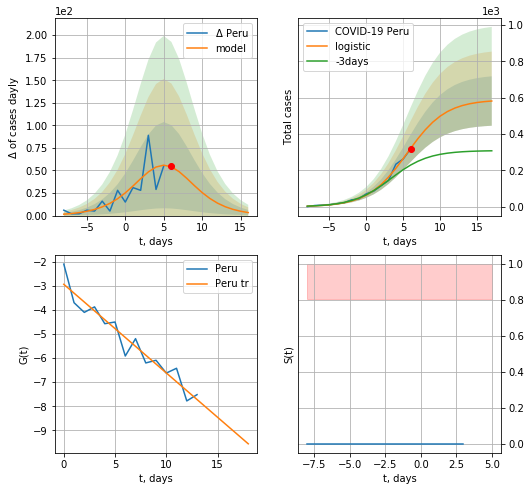

Peru data at: 2020-07-07
+3 day model MAPE: 0.4976759510371563
model: logistic
coeffs:  [5.88914141e+02 3.80777382e-01 5.52424877e+00]
rational stdev:  0.23355774891059702
forecast at the end of period: +11 days
	 deltaDaycases:  3
	 total cases:  581 ± 135
	 total death:  20 ± 14
trend coefficient of determination: 0.924015
 intercept: -2.937528
 slope: -0.367722


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:231: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


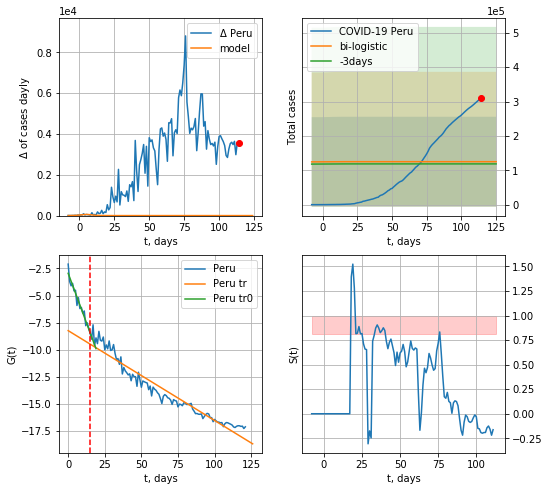

Peru data at: 2020-07-07
+3 day model MAPE: 0.0542362424000865
model: bi-logistic
coeffs:  [ 9.95281706e+04 -1.28281176e+01  3.17426602e+02] [5.88914141e+02 3.80777382e-01 5.52424877e+00]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  1.0455010386900907
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  124999 ± 130686
	 total death:  4426 ± 13882
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.936345
 intercept: -2.948740
 slope: -0.365135
trend coefficient of determination: 0.936166
 intercept: -8.233813
 slope: -0.082817


In [325]:
dfPU = read_df(pd.DataFrame(),"PU")
dfPU = dfPU.fillna(0)
x = forecast("Peru",dfPU[:15],d1,7*16-dT)
xx = forecast2("Peru",dfPU[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=15)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


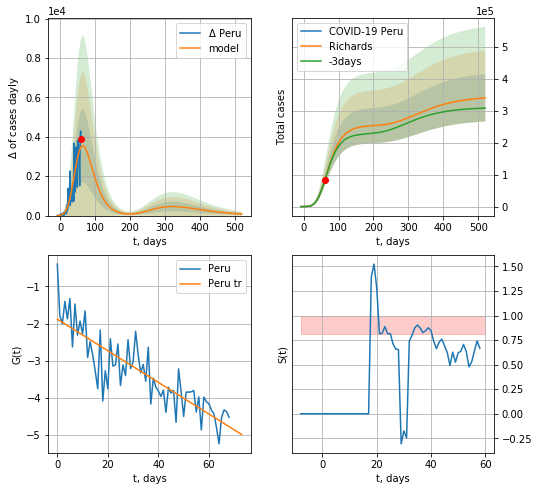

Peru data at: 2020-07-07
+3 day model MAPE: 0.004153
model: Richards
coeffs: [2.53867581e+05 3.16869248e-01 1.42807064e+01 1.27501600e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.217547
forecast at the end of period: +459 days
	 deltaDaycases: 77
	 total cases: 340089 ± 73985
	 total death: 12043 ± 7859
trend coefficient of determination: 0.729622
 intercept: -1.882679
 slope: -0.042523


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:154: RuntimeWarning: overflow encountered in power


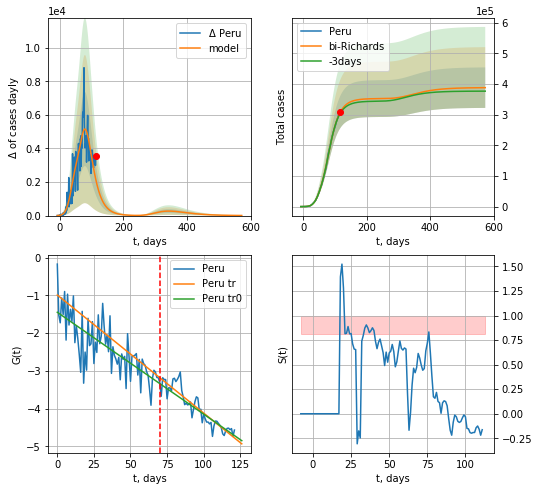

Peru data at: 2020-07-07
+3 day model MAPE: 0.011598
model: bi-Richards
coeffs: [9.87332377e+04 7.21085559e+00 5.13060307e+00 8.29396898e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.170298
forecast at the end of period: +459 days
	 deltaDaycases: 6
	 total cases: 388059 ± 66085
	 total death: 13741 ± 7020
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.546288
 intercept: -1.445631
 slope: -0.026991
trend coefficient of determination: 0.836565
 intercept: -0.989548
 slope: -0.031273


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


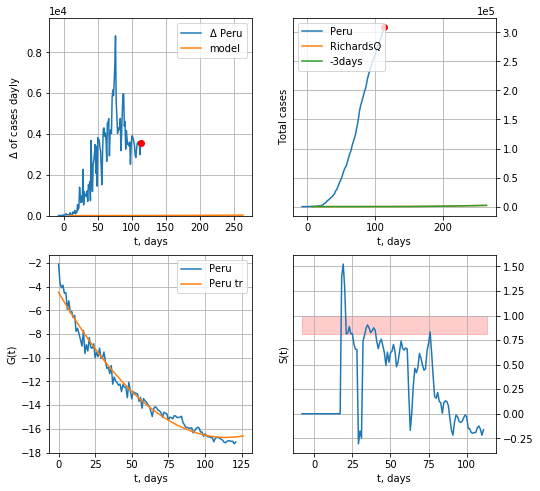

Peru data at: 2020-07-07
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 5.50045829e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +151 days
	 deltaDaycases: 22


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [326]:
vL = 70
x = forecastRR("Peru",dfPU[:vL],d1,80*7-dT,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR("Peru",dfPU[:],d1,80*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastQR("Peru",dfPU[:],d1,36*7-dT)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


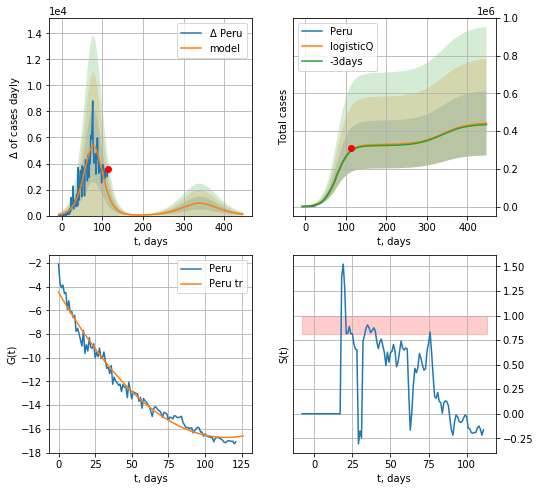

Peru data at: 2020-07-07
+3 day model MAPE: 0.011147
model: logisticQ
coeffs: [ 3.28415224e+05  7.41749381e-07  7.79392274e+01 -8.81094275e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.385243
forecast at the end of period: +333 days
	 deltaDaycases: 107
	 total cases: 441415 ± 170052
	 total death: 15631 ± 18065
trend coefficient of determination: 0.978907
 intercept_: -4.471629921798343
 coeffs_: [ 0.         -0.21399322  0.00093476]


In [327]:
x = forecastRRR("Peru",dfPU[:].fillna(0),d1,62*7-dT,addpred=True,xcoef=koreaCoeffs)

ID
           date   cases    active    death
125 2020-07-03  649889  236901.0  18669.0
126 2020-07-04  673904  245542.0  19279.0
127 2020-07-05  699402  254625.0  19707.0
128 2020-07-06  721310  260897.0  20184.0
129 2020-07-07  744006  266295.0  20653.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


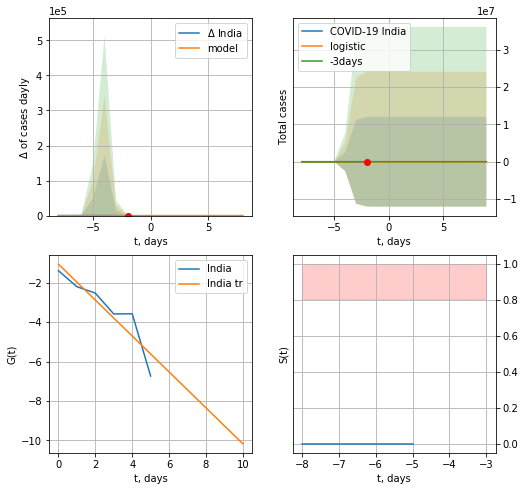

India data at: 2020-07-07
+3 day model MAPE: 0.19485949734745373
model: logistic
coeffs:  [29.40035511  4.01433678 -3.67575724]
rational stdev:  409363.3184161478
forecast at the end of period: +11 days
	 deltaDaycases:  0
	 total cases:  29 ± 12035426
	 total death:  0 ± 0
trend coefficient of determination: 0.835838
 intercept: -1.052904
 slope: -0.912220


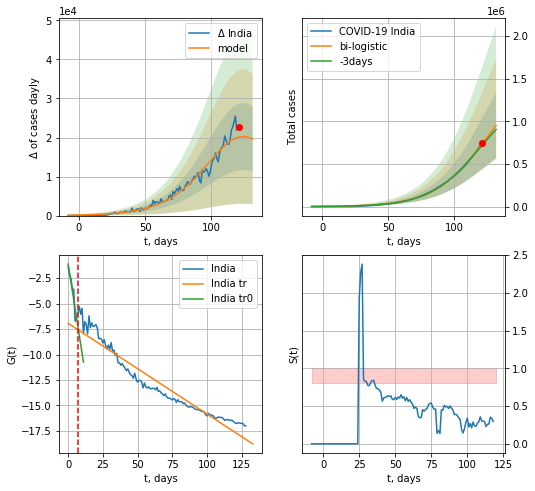

India data at: 2020-07-07
+3 day model MAPE: 0.02699793075565948
model: bi-logistic
coeffs:  [1.58012967e+06 5.08808283e-02 1.24066660e+02] [29.40035511  4.01433678 -3.67575724]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.4055986489404923
forecast at the end of period: +11 days
	 deltaDaycases:  19581
	 total cases:  951175 ± 385795
	 total death:  26403 ± 32127
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.879788
 intercept: -1.115653
 slope: -0.874570
trend coefficient of determination: 0.924753
 intercept: -6.932693
 slope: -0.088984


In [328]:
dfID = read_df(pd.DataFrame(),"ID")
dfID = dfID.fillna(0)
x = forecast("India",dfID[:7],d1,7*16-dT)
xx = forecast2("India",dfID[:],d1,16*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=7)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


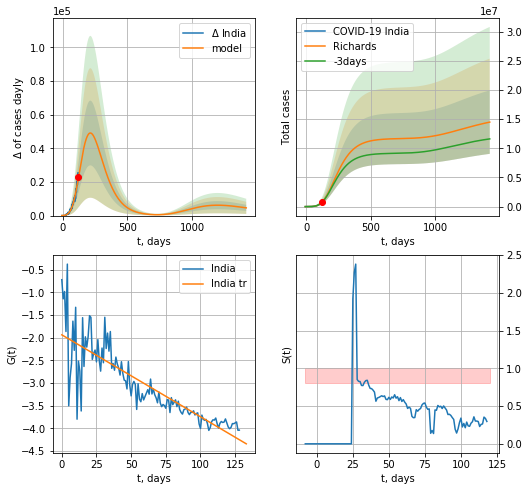

India data at: 2020-07-07
+3 day model MAPE: 0.012537
model: Richards
coeffs: [ 1.16911734e+07  2.85405530e-01 -6.12429289e+01  4.08258208e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.375557
forecast at the end of period: +1299 days
	 deltaDaycases: 4599
	 total cases: 14497724 ± 5444724
	 total death: 402445 ± 453423
trend coefficient of determination: 0.720072
 intercept: -1.938212
 slope: -0.018088


In [329]:
x = forecastRR("India",dfID[:],d1,200*7-dT,addpred=True,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


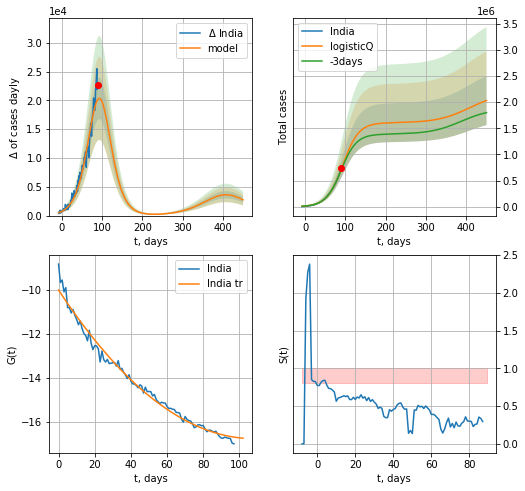

India data at: 2020-07-07
+3 day model MAPE: 0.026603
model: logisticQ
coeffs: [ 1.60579796e+06  2.72285951e-06  9.36199761e+01 -1.85215009e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.231175
forecast at the end of period: +361 days
	 deltaDaycases: 2736
	 total cases: 2031542 ± 469642
	 total death: 56393 ± 39110
trend coefficient of determination: 0.984904
 intercept_: -10.004910945254691
 coeffs_: [ 0.         -0.12537609  0.00058062]


In [330]:
x = forecastRRR("India",dfID[31:].fillna(0),d1,66*7-dT,addpred=True,xcoef=koreaCoeffs)

AG
           date    cases   active   death
121 2020-07-03  72786.0  46125.0  1437.0
122 2020-07-04  75376.0  47965.0  1481.0
123 2020-07-05  77815.0  48711.0  1507.0
124 2020-07-06  80447.0  50334.0  1582.0
125 2020-07-07  83426.0  51687.0  1644.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


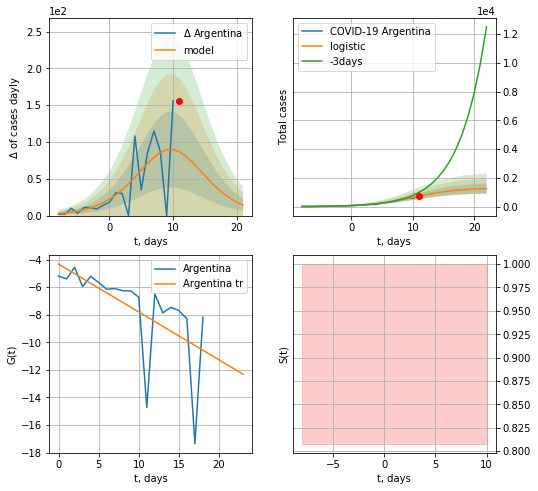

Argentina data at: 2020-07-07
+3 day model MAPE: 0.3427791439688051
model: logistic
coeffs:  [1.30607344e+03 2.75914265e-01 1.01155997e+01]
rational stdev:  0.2777261346981541
forecast at the end of period: +11 days
	 deltaDaycases:  14
	 total cases:  1258 ± 349
	 total death:  24 ± 19
trend coefficient of determination: 0.364190
 intercept: -4.325611
 slope: -0.347113


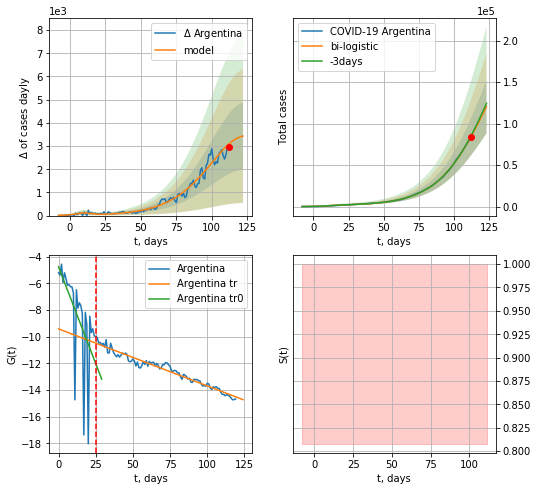

Argentina data at: 2020-07-07
+3 day model MAPE: 0.014243361217172883
model: bi-logistic
coeffs:  [2.47350175e+05 5.55377003e-02 1.24365961e+02] [1.30607344e+03 2.75914265e-01 1.01155997e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.26613031833569833
forecast at the end of period: +11 days
	 deltaDaycases:  3427
	 total cases:  120349 ± 32028
	 total death:  2371 ± 1892
bi-logistic approximation splitting point: 25
trend0 coefficient of determination: 0.360462
 intercept: -4.766843
 slope: -0.290012
trend coefficient of determination: 0.954492
 intercept: -9.417305
 slope: -0.042719


In [331]:
vL = 25
#vL1 = 40
dfAG = read_df(pd.DataFrame(),"AG")
x = forecast('Argentina',dfAG[5:vL],d1,7*16-dT,1.0)
xx = forecast2('Argentina',dfAG[5:],d1,16*7-dT,x,1.0,vL=vL,addpred=True,xcoef=[.25,1.,2.0])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Argentina",dfAG[5:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

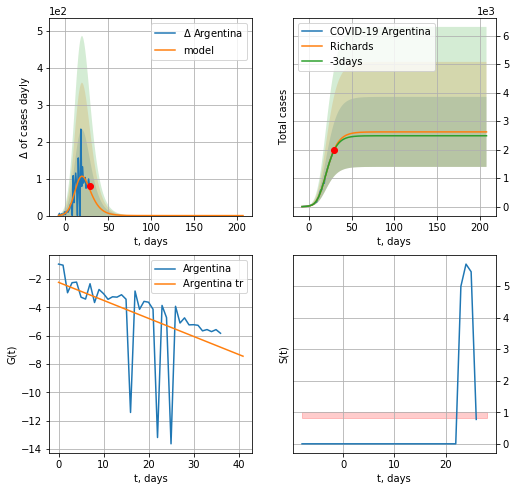

Argentina data at: 2020-07-07
+3 day model MAPE: 0.013138
model: Richards
coeffs: [2.62031748e+03 3.73236918e-01 1.15845148e+01 3.46306259e-01]
rational stdev: 0.468281
forecast at the end of period: +179 days
	 deltaDaycases: 0
	 total cases: 2620 ± 1227
	 total death: 51 ± 71
trend coefficient of determination: 0.244505
 intercept: -2.222432
 slope: -0.127357


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


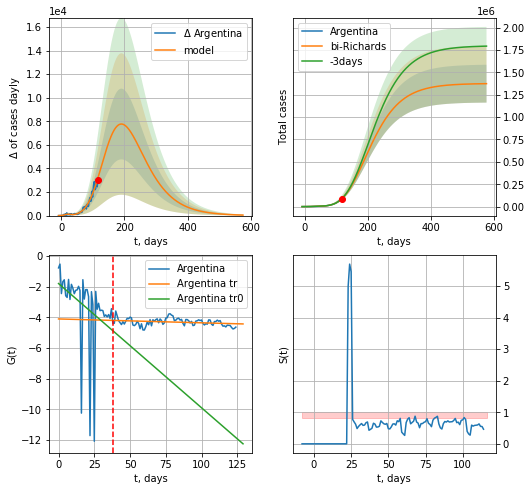

Argentina data at: 2020-07-07
+3 day model MAPE: 0.012587
model: bi-Richards
coeffs: [1.37323630e+06 1.41139478e-01 5.81776198e+01 1.15234799e-01]
rational stdev: 0.153882
forecast at the end of period: +459 days
	 deltaDaycases: 42
	 total cases: 1373237 ± 211316
	 total death: 27061 ± 12492
bi-Richards approximation splitting point: 38
trend coefficient of determination: 0.124580
 intercept: -1.795615
 slope: -0.081071
trend coefficient of determination: 0.068892
 intercept: -4.105299
 slope: -0.002522


In [332]:
vL = 38
x = forecastRR('Argentina',dfAG[:vL].fillna(0),d1,40*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Argentina',dfAG[:].fillna(0),d1,80*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


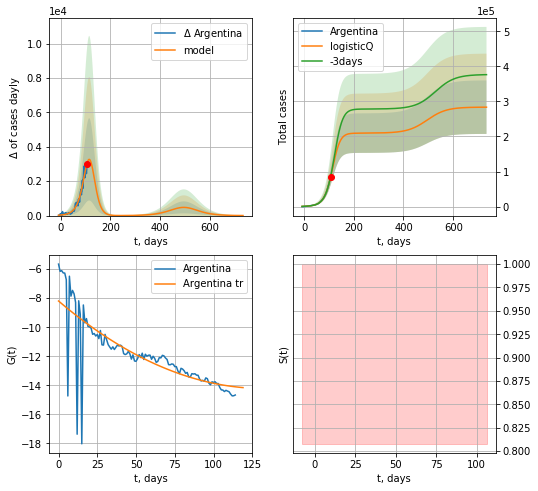

Argentina data at: 2020-07-07
+3 day model MAPE: 0.021335
model: logisticQ
coeffs: [ 2.09495250e+05  1.25292919e-04  1.13502969e+02 -3.82487575e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.269035
forecast at the end of period: +627 days
	 deltaDaycases: 3
	 total cases: 283561 ± 76288
	 total death: 5587 ± 4509
trend coefficient of determination: 0.603551
 intercept_: -8.191621276742792
 coeffs_: [ 0.         -0.09104851  0.00034409]


In [333]:
x = forecastRRR('Argentina',dfAG[10:],d1,104*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


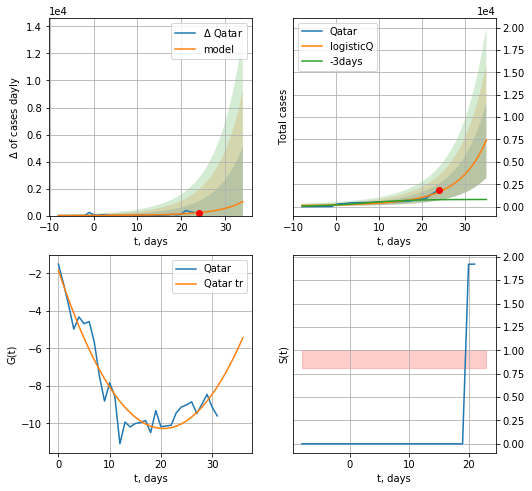

Qatar data at: 2020-07-07
+3 day model MAPE: 1.403655
model: logisticQ
coeffs: [ 4.67633524e+06  1.32940266e-03  6.79779167e+01 -1.11960120e+02]
rational stdev: 0.567221
forecast at the end of period: +11 days
	 deltaDaycases: 1035
	 total cases: 7432 ± 4215
	 total death: 9 ± 15
trend coefficient of determination: 0.904406
 intercept_: -1.8341916285683908
 coeffs_: [ 0.         -0.82373816  0.02011068]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


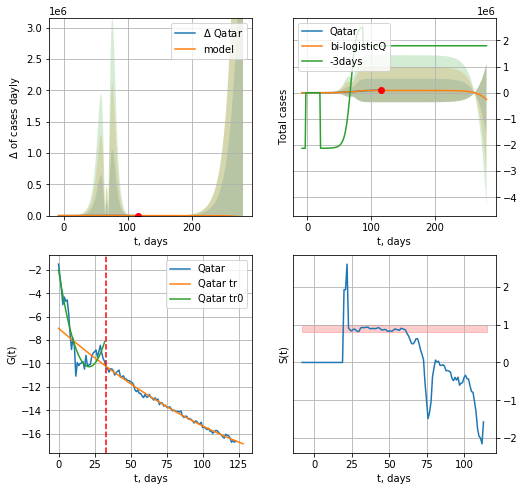

Qatar data at: 2020-07-07
+3 day model MAPE: 0.951935
model: bi-logisticQ
coeffs: [-4.58994776e+06  1.39497707e-03  6.79505414e+01 -1.07346647e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 5.202822
forecast at the end of period: +165 days
	 deltaDaycases: -22711
	 total cases: -262361 ± -1365022
	 total death: -348 ± -5431
bi-logisticQ approximation splitting point: 33
trend coefficient of determination: 0.887233
 intercept_: -1.9921673153050232
 coeffs_: [ 0.         -0.78114612  0.01840466]
trend coefficient of determination: 0.992037
 intercept_: -6.995445219772419
 coeffs_: [ 0.         -0.10616814  0.00022661]


In [334]:
vL=33
x = forecastRRR('Qatar',dfQR[:vL].fillna(0),d1,7*16-dT,1.0,addpred=False,xcoef=[.35,.5,4.0,1])
xx = forecast2RRR('Qatar',dfQR[:].fillna(0),d1,38*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


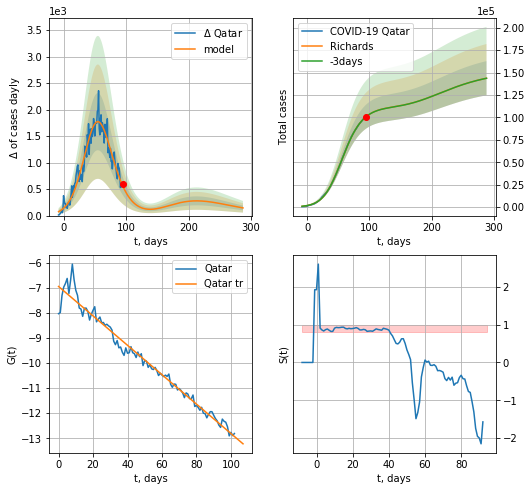

Qatar data at: 2020-07-07
+3 day model MAPE: 0.000419
model: Richards
coeffs: [1.11582673e+05 8.53892186e-02 4.81969411e+01 6.66987858e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.132740
forecast at the end of period: +193 days
	 deltaDaycases: 144
	 total cases: 143622 ± 19064
	 total death: 190 ± 75
trend coefficient of determination: 0.972801
 intercept: -6.946309
 slope: -0.058648


In [335]:
iL = 21
vL = 99 + iL
x = forecastRR('Qatar',dfQR[iL:].fillna(0),d1,42*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Qatar',dfQR[iL:].fillna(0),d1,60*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-iL)

In [336]:
#x = forecast('Qatar',dfQR[:],d1,18*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

UAE
           date    cases  active  death
139 2020-07-03  50141.0   10670  318.0
140 2020-07-04  50857.0   10679  321.0
141 2020-07-05  51540.0   10920  323.0
142 2020-07-06  52068.0   11023  324.0
143 2020-07-07  52600.0   10560  326.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


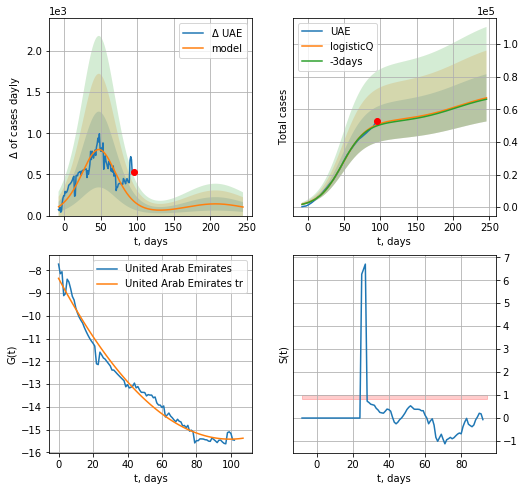

UAE data at: 2020-07-07
+3 day model MAPE: 0.013675
model: logisticQ
coeffs: [ 5.27822764e+04  6.47720497e-07  4.76707381e+01 -9.33705097e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.216258
forecast at the end of period: +151 days
	 deltaDaycases: 104
	 total cases: 67025 ± 14494
	 total death: 415 ± 269
trend coefficient of determination: 0.981757
 intercept_: -8.356132407963301
 coeffs_: [ 0.         -0.14214722  0.00071498]


In [337]:
dfUAE = read_df(pd.DataFrame(),"UAE")
x = forecastRRR('UAE',dfUAE[40:],d1,36*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


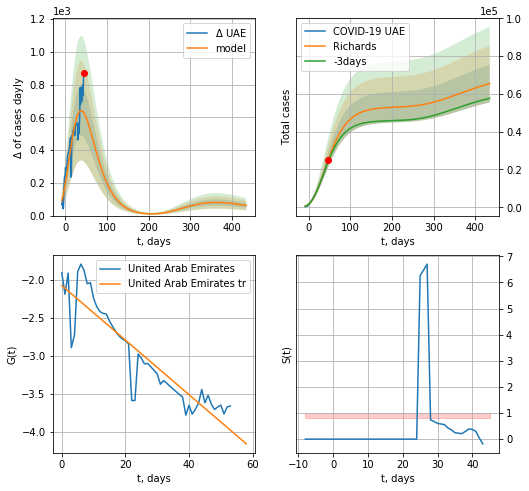

UAE data at: 2020-07-07
+3 day model MAPE: 0.028798
model: Richards
coeffs: [ 5.30737629e+04  1.10412183e+00 -6.62067699e+01  3.01726179e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.152521
forecast at the end of period: +389 days
	 deltaDaycases: 62
	 total cases: 65482 ± 9987
	 total death: 405 ± 185
trend coefficient of determination: 0.830554
 intercept: -2.075527
 slope: -0.035953


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


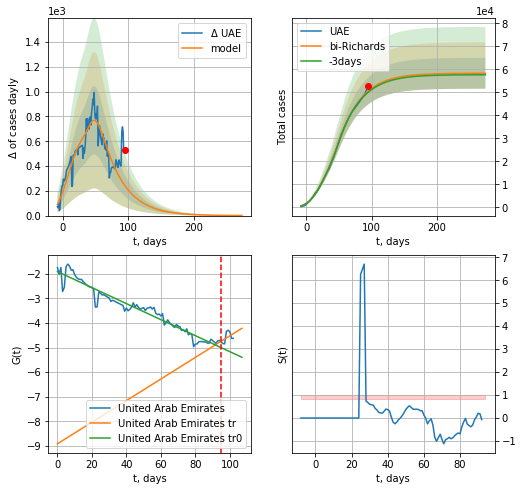

UAE data at: 2020-07-07
+3 day model MAPE: 0.010816
model: bi-Richards
coeffs: [ 5.29452911e+03  3.18835063e+01 -1.67770554e+01  2.68599769e-03]
rational stdev: 0.115158
forecast at the end of period: +179 days
	 deltaDaycases: 0
	 total cases: 58347 ± 6719
	 total death: 361 ± 124
bi-Richards approximation splitting point: 95
trend coefficient of determination: 0.941328
 intercept: -1.906752
 slope: -0.032576
trend coefficient of determination: 0.219199
 intercept: -8.912336
 slope: 0.043921


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


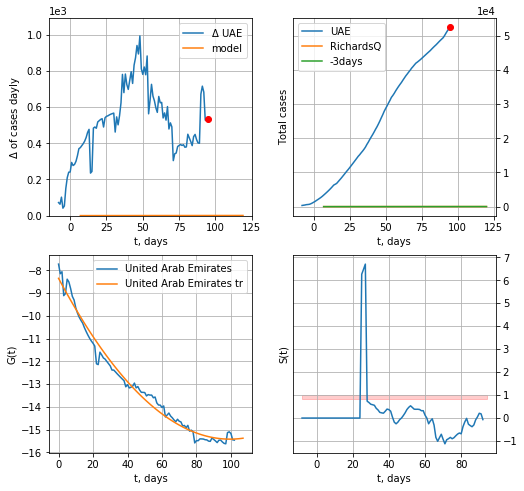

UAE data at: 2020-07-07
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 1.64994494e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +25 days
	 deltaDaycases: 0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [338]:
iL = 40
vL = 95 + iL
x = forecastRR('UAE',dfUAE[iL:vL-iL],d1,70*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR('UAE',dfUAE[iL:],d1,40*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
x = forecastQR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [339]:
#plt.plot(range(len(dfUAE[45:])-1),np.log(np.log(np.log(np.diff(dfUAE[45:].cases)))))

SA
           date     cases  active   death
122 2020-07-03  201801.0   59385  1802.0
123 2020-07-04  205929.0   60815  1858.0
124 2020-07-05  209509.0   62357  1916.0
125 2020-07-06  213716.0   62114  1968.0
126 2020-07-07  217108.0   60252  2017.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


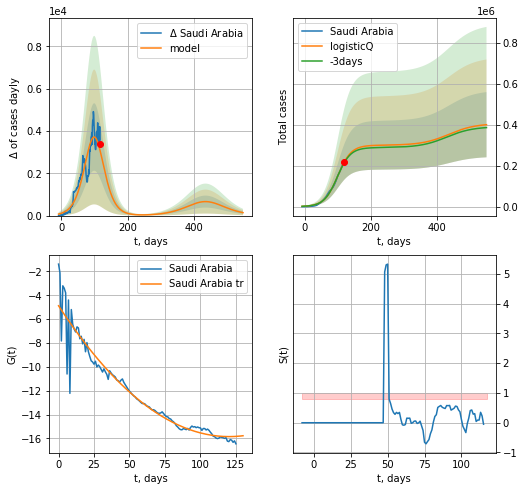

Saudi Arabia data at: 2020-07-07
+3 day model MAPE: 0.013465
model: logisticQ
coeffs: [ 2.99411009e+05  6.02393796e-07  9.98549483e+01 -8.23591751e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.397943
forecast at the end of period: +431 days
	 deltaDaycases: 139
	 total cases: 399604 ± 159019
	 total death: 3712 ± 4431
trend coefficient of determination: 0.923734
 intercept_: -4.876681948264024
 coeffs_: [ 0.         -0.1825007   0.00075923]


In [340]:
dfSA = read_df(pd.DataFrame(),"SA")
x = forecastRRR('Saudi Arabia',dfSA[:],d1,76*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


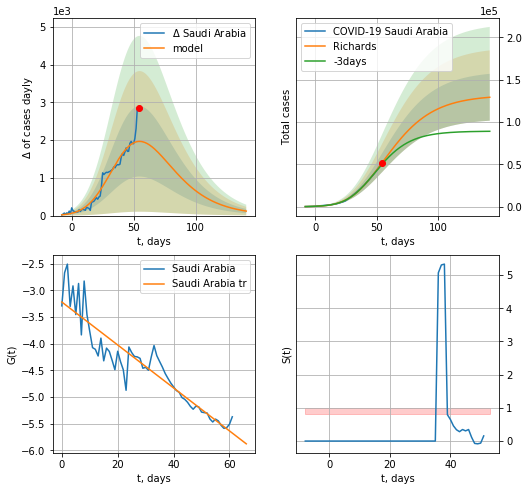

Saudi Arabia data at: 2020-07-07
+3 day model MAPE: 0.035873
model: Richards
coeffs: [1.31816759e+05 1.98591474e-01 2.23762356e+01 2.26895132e-01]
rational stdev: 0.214319
forecast at the end of period: +88 days
	 deltaDaycases: 119
	 total cases: 129199 ± 27689
	 total death: 1200 ± 771
trend coefficient of determination: 0.862734
 intercept: -3.219420
 slope: -0.040287


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


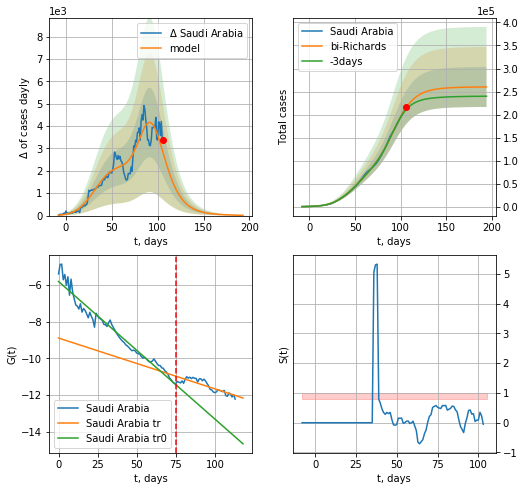

Saudi Arabia data at: 2020-07-07
+3 day model MAPE: 0.022685
model: bi-Richards
coeffs: [1.28451957e+05 1.39222818e-01 8.89771817e+01 6.55771064e-01]
rational stdev: 0.167153
forecast at the end of period: +88 days
	 deltaDaycases: 12
	 total cases: 260001 ± 43459
	 total death: 2415 ± 1211
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.960146
 intercept: -5.805195
 slope: -0.075023
trend coefficient of determination: 0.728014
 intercept: -8.888560
 slope: -0.027719


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


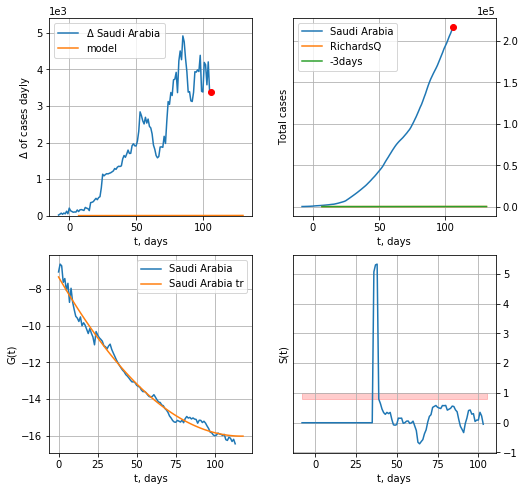

Saudi Arabia data at: 2020-07-07
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 5.80774879e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +25 days
	 deltaDaycases: 3


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [341]:
x = forecastRR('Saudi Arabia',dfSA[12:75],d1,27*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Saudi Arabia',dfSA[12:],d1,27*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=75)
x = forecastQR('Saudi Arabia',dfSA[12:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

Sri
           date   cases  active  death
115 2020-07-03  2069.0     195   11.0
116 2020-07-04  2074.0     178   11.0
117 2020-07-05  2076.0     162   11.0
118 2020-07-06  2078.0     150   11.0
119 2020-07-07  2081.0     115   11.0


/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


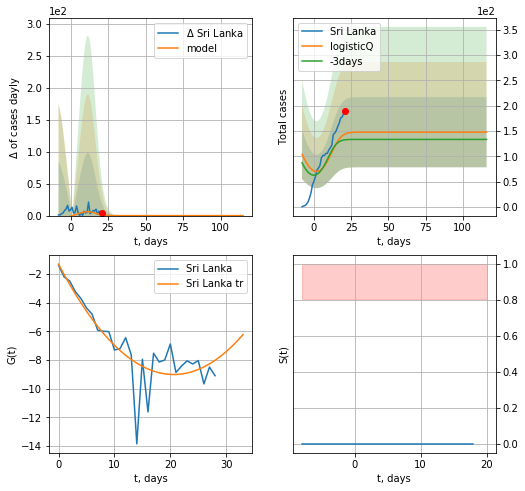

Sri Lanka data at: 2020-07-07
+3 day model MAPE: 0.092819
model: logisticQ
coeffs: [ 1.47873470e+02  1.02179685e-02  4.75701897e+00 -1.32324113e+00]
rational stdev: 0.468203
forecast at the end of period: +95 days
	 deltaDaycases: 0
	 total cases: 147 ± 69
	 total death: 0 ± 0
trend coefficient of determination: 0.737116
 intercept_: -1.300425972375204
 coeffs_: [ 0.         -0.74879164  0.01816974]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:294: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:333: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


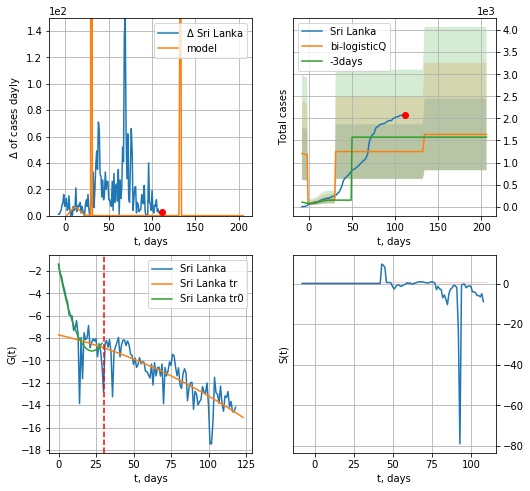

Sri Lanka data at: 2020-07-07
+3 day model MAPE: 0.207584
model: bi-logisticQ
coeffs: [1099.56863502    5.11099531   30.51915621   -1.6812872 ]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.495878
forecast at the end of period: +95 days
	 deltaDaycases: 0
	 total cases: 1636 ± 811
	 total death: 8 ± 11
bi-logisticQ approximation splitting point: 30
trend coefficient of determination: 0.725855
 intercept_: -1.5084890363019623
 coeffs_: [ 0.         -0.68634546  0.01540158]
trend coefficient of determination: 0.646775
 intercept_: -7.715728968576764
 coeffs_: [ 0.         -0.03147108 -0.00023195]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [342]:
dfSri = read_df(pd.DataFrame(),"Sri")
vL= 30
x = forecastRRR('Sri Lanka',dfSri[:vL],d1,28*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Sri Lanka',dfSri[:],d1,28*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

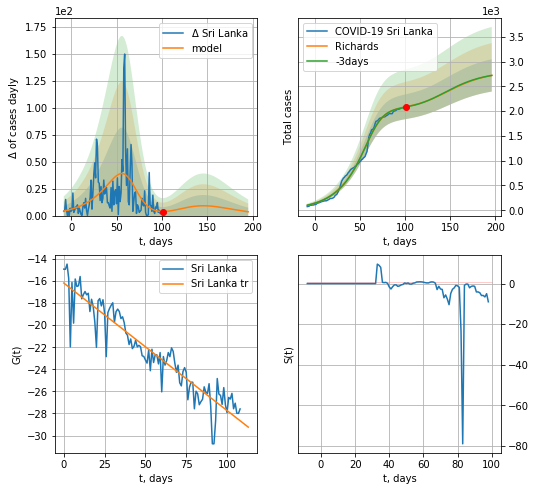

Sri Lanka data at: 2020-07-07
+3 day model MAPE: 0.003634
model: Richards
coeffs: [2.07051730e+03 4.15080698e-02 6.51914813e+01 2.75459103e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.119919
forecast at the end of period: +95 days
	 deltaDaycases: 3
	 total cases: 2723 ± 326
	 total death: 14 ± 5
trend coefficient of determination: 0.877174
 intercept: -16.184143
 slope: -0.115477


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


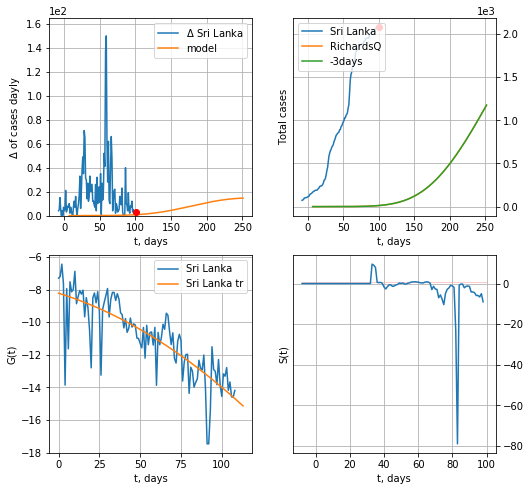

Sri Lanka data at: 2020-07-07
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 3.57221899e+03  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +151 days
	 deltaDaycases: 14


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [343]:
vL=52
x = forecastRR('Sri Lanka',dfSri[10:],d1,28*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Sri Lanka',dfSri[10:],d1,30*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastQR('Sri Lanka',dfSri[10:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

PS
           date     cases  active   death
127 2020-07-03  225283.0   95570  4619.0
128 2020-07-04  228474.0   93932  4712.0
129 2020-07-05  231818.0   95407  4762.0
130 2020-07-06  234509.0   94713  4839.0
131 2020-07-07  237489.0   91602  4922.0


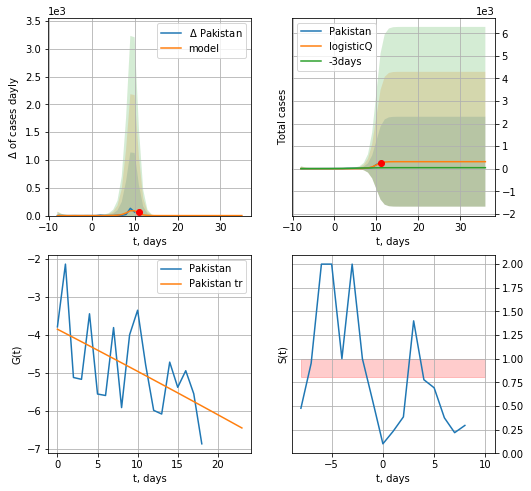

Pakistan data at: 2020-07-07
+3 day model MAPE: 5.954391
model: logisticQ
coeffs: [ 3.10300107e+02  5.80299152e-02  9.88962591e+00 -1.18245381e+01]
rational stdev: 6.420495
forecast at the end of period: +25 days
	 deltaDaycases: 0
	 total cases: 310 ± 1992
	 total death: 6 ± 115
trend coefficient of determination: 0.293073
 intercept_: -3.8498114630651457
 coeffs_: [ 0.         -0.10964083 -0.00016191]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


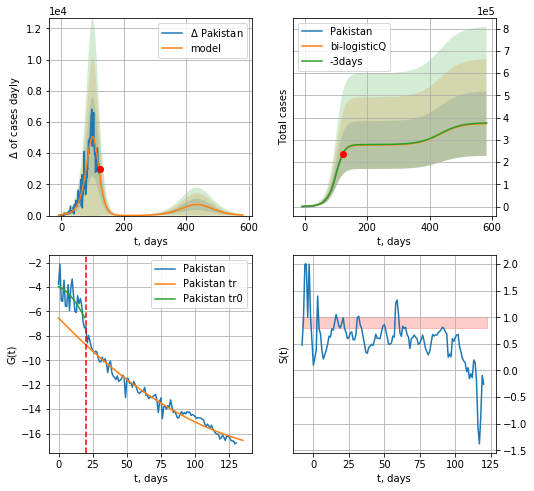

Pakistan data at: 2020-07-07
+3 day model MAPE: 0.003563
model: bi-logisticQ
coeffs: [ 2.76207550e+05  1.90766302e-04  9.93611650e+01 -2.82251763e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.388332
forecast at the end of period: +459 days
	 deltaDaycases: 34
	 total cases: 373229 ± 144937
	 total death: 7735 ± 9011
bi-logisticQ approximation splitting point: 20
trend coefficient of determination: 0.391568
 intercept_: -3.9808806978581046
 coeffs_: [ 0.         -0.04620278 -0.00453428]
trend coefficient of determination: 0.966668
 intercept_: -6.532504708657138
 coeffs_: [ 0.         -0.11652441  0.00031328]


In [344]:
dfPS = read_df(pd.DataFrame(),"PS")
vL= 20
x = forecastRRR('Pakistan',dfPS[:vL],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Pakistan',dfPS[:],d1,80*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


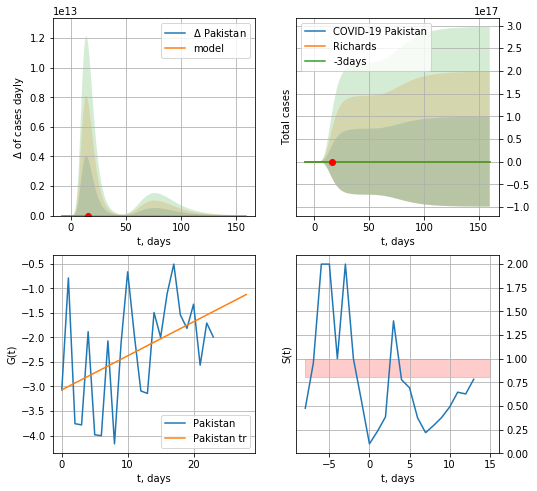

Pakistan data at: 2020-07-07
+3 day model MAPE: 0.118161
model: Richards
coeffs: [ 1.63793589e+03  6.01089634e+00 -3.06352612e+00  3.22292207e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 44401640452651.890625
forecast at the end of period: +144 days
	 deltaDaycases: 0
	 total cases: 2229 ± 98978249728909232
	 total death: 46 ± 6127426382465961
trend coefficient of determination: 0.194246
 intercept: -3.069579
 slope: 0.069356


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


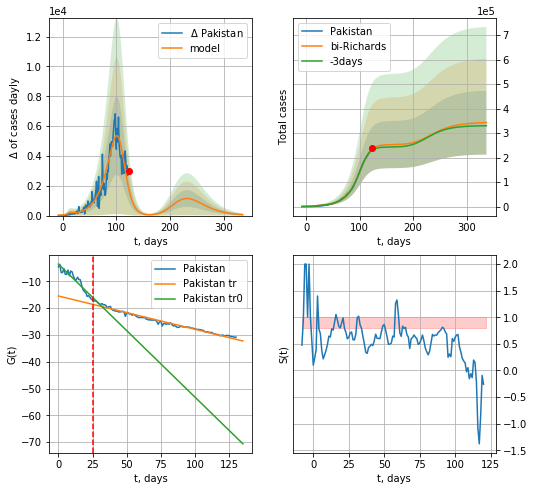

Pakistan data at: 2020-07-07
+3 day model MAPE: 0.018369
model: bi-Richards
coeffs: [2.51634136e+05 5.33887553e-02 1.08028831e+02 2.13781430e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.379900
forecast at the end of period: +214 days
	 deltaDaycases: 59
	 total cases: 342964 ± 130292
	 total death: 7108 ± 8100
bi-Richards approximation splitting point: 25
trend coefficient of determination: 0.887252
 intercept: -3.620720
 slope: -0.496168
trend coefficient of determination: 0.975522
 intercept: -15.500044
 slope: -0.124237


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


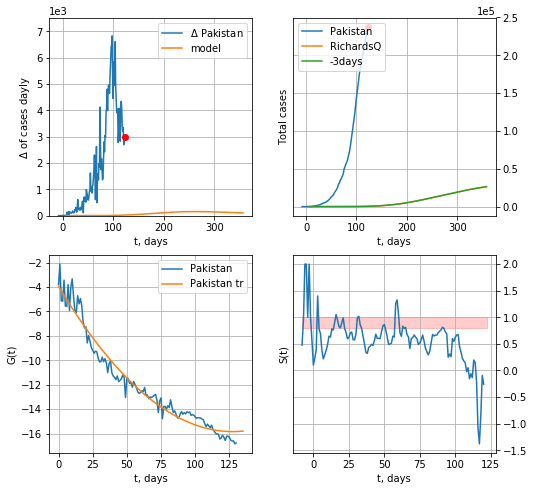

Pakistan data at: 2020-07-07
+3 day model MAPE: 0.000000
model: RichardsQ
coeffs: [ 3.68498873e+04  2.30000000e-01  6.31714688e+00 -1.00000000e-04
  5.00000000e-02]
rational stdev: nan
forecast at the end of period: +235 days
	 deltaDaycases: 101


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in sqrt
  from ipykernel import kernelapp as app


ValueError: cannot convert float NaN to integer

In [345]:
vL = 25
x = forecastRR('Pakistan',dfPS[:vL],d1,35*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR('Pakistan',dfPS[:],d1,45*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastQR('Pakistan',dfPS[:],d1,48*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

BN
           date     cases  active   death
117 2020-07-03  156391.0   86375  1968.0
118 2020-07-04  159679.0   86961  1997.0
119 2020-07-05  165618.0   87373  2096.0
120 2020-07-06  168645.0   88392  2151.0
121 2020-07-07  168645.0   88392  2151.0


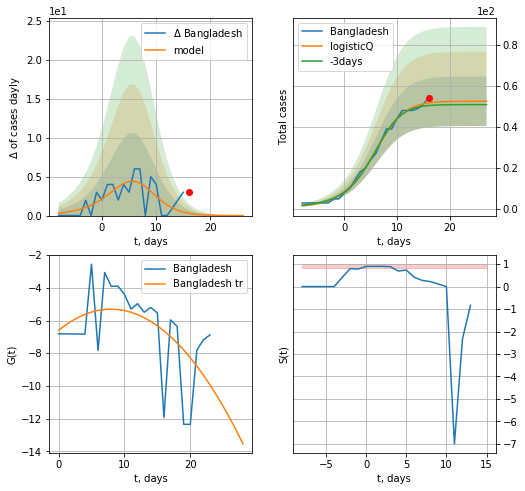

Bangladesh data at: 2020-07-07
+3 day model MAPE: 0.027574
model: logisticQ
coeffs: [ 5.24923176e+01  5.83632898e-03  5.49442770e+00 -5.18799455e+01]
rational stdev: 0.229670
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 52 ± 12
	 total death: 0 ± 0
trend coefficient of determination: 0.276192
 intercept_: -6.599187027141191
 coeffs_: [ 0.          0.32583568 -0.02049035]


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:571: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

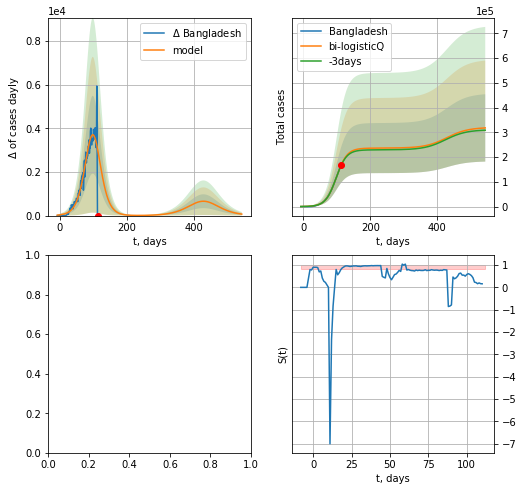

In [346]:
dfBN = read_df(pd.DataFrame(),"BN")
vL= 25
x = forecastRRR('Bangladesh',dfBN[:vL],d1,16*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Bangladesh',dfBN[:],d1,76*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


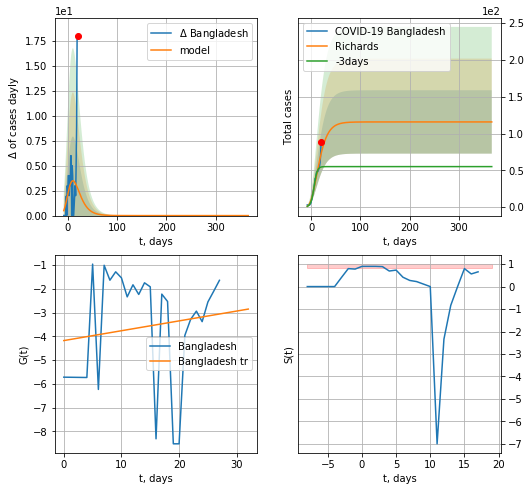

Bangladesh data at: 2020-07-07
+3 day model MAPE: 0.373626
model: Richards
coeffs: [ 1.15736925e+02  6.45824667e+00 -4.20178539e+01  1.27654554e-02]
rational stdev: 0.371727
forecast at the end of period: +347 days
	 deltaDaycases: 0
	 total cases: 115 ± 43
	 total death: 1 ± 1
trend coefficient of determination: 0.020746
 intercept: -4.180817
 slope: 0.041430


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:647: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

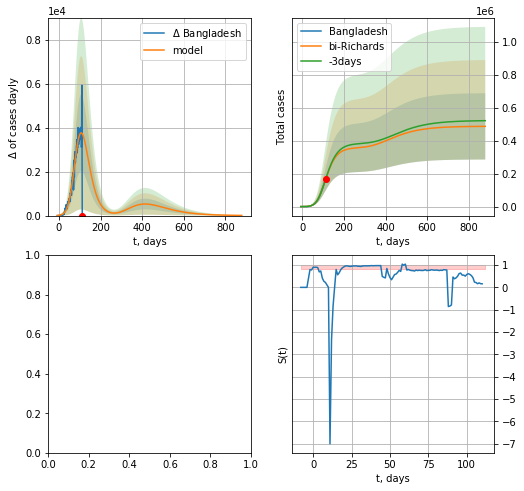

In [347]:
vL=29
x = forecastRR('Bangladesh',dfBN[:vL],d1,64*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bangladesh',dfBN[:],d1,124*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastQR('Bangladesh',dfBN[:],d1,16*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

KW
           date    cases  active  death
130 2020-07-03  48672.0    9036  360.0
131 2020-07-04  49303.0    8995  365.0
132 2020-07-05  49941.0    9110  368.0
133 2020-07-06  50644.0    9270  373.0
134 2020-07-07  51245.0    9353  377.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


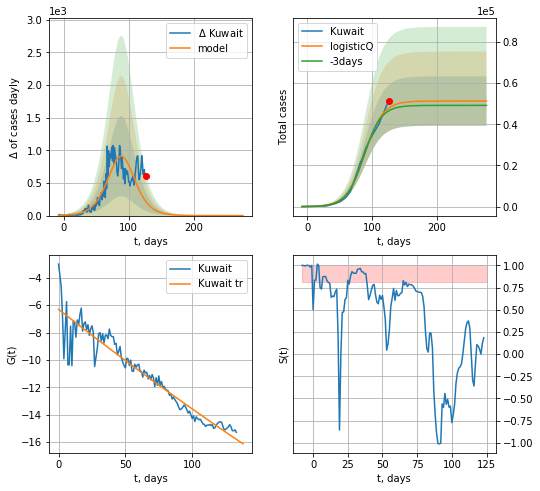

Kuwait data at: 2020-07-07
+3 day model MAPE: 0.028410
model: logisticQ
coeffs: [ 5.12890566e+04  5.27789307e-07  8.89367023e+01 -1.34366737e+05]
rational stdev: 0.234027
forecast at the end of period: +151 days
	 deltaDaycases: 0
	 total cases: 51288 ± 12003
	 total death: 377 ± 264
trend coefficient of determination: 0.907611
 intercept_: -6.305859618007783
 coeffs_: [ 0.00000000e+00 -7.68423816e-02  4.09758155e-05]


In [348]:
dfKW = read_df(pd.DataFrame(),"KW")
x = forecastRRR('Kuwait',dfKW[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


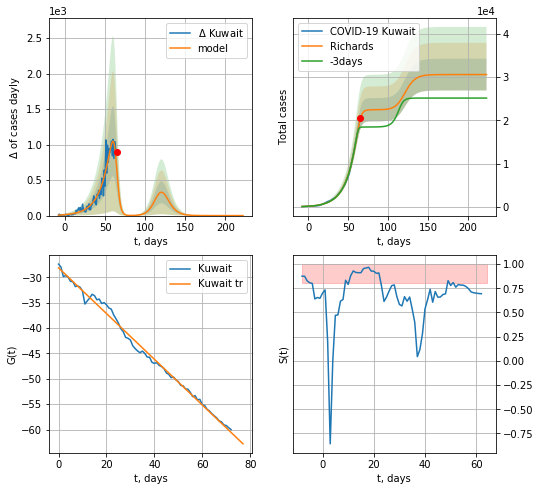

Kuwait data at: 2020-07-07
+3 day model MAPE: 0.136559
model: Richards
coeffs: [2.24365721e+04 7.66634185e-02 6.43548410e+01 5.72971743e+00]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.119998
forecast at the end of period: +158 days
	 deltaDaycases: 0
	 total cases: 30568 ± 3668
	 total death: 224 ± 80
trend coefficient of determination: 0.993036
 intercept: -28.143718
 slope: -0.450232


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


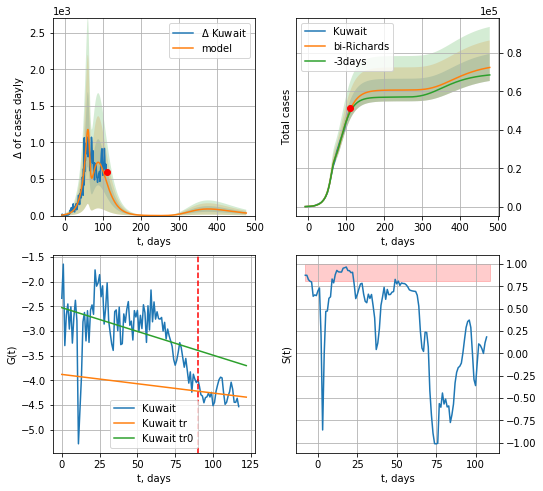

Kuwait data at: 2020-07-07
+3 day model MAPE: 0.020228
model: bi-Richards
coeffs: [ 3.82100085e+04  6.83088460e+00 -5.48977599e+00  7.62290216e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.097071
forecast at the end of period: +368 days
	 deltaDaycases: 35
	 total cases: 72358 ± 7023
	 total death: 532 ± 154
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.163848
 intercept: -2.525587
 slope: -0.009616
trend coefficient of determination: 0.030380
 intercept: -3.877123
 slope: -0.003770


In [350]:
iL= 16
vL = 90 + iL
x = forecastRR('Kuwait',dfKW[iL:vL-iL],d1,37*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR('Kuwait',dfKW[iL:],d1,67*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-iL)

DM
           date    cases  active  death
124 2020-07-03  35148.0   15981  775.0
125 2020-07-04  36184.0   16796  786.0
126 2020-07-05  37425.0   17688  794.0
127 2020-07-06  38128.0   17835  804.0
128 2020-07-07  38430.0   18045  821.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


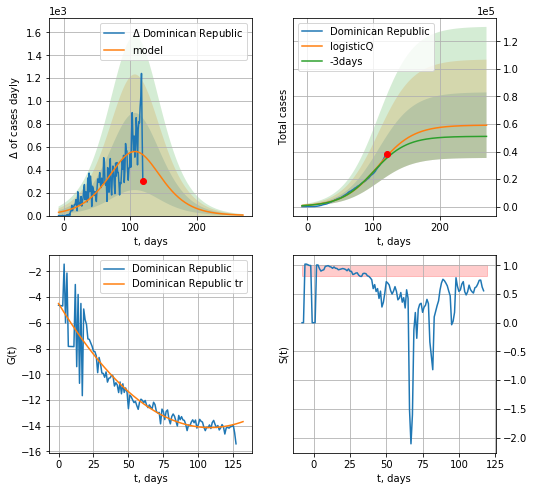

Dominican Republic data at: 2020-07-07
+3 day model MAPE: 0.041650
model: logisticQ
coeffs: [ 5.92331856e+04  3.19429762e-07  1.07427718e+02 -1.18174798e+05]
rational stdev: 0.402612
forecast at the end of period: +151 days
	 deltaDaycases: 4
	 total cases: 59111 ± 23799
	 total death: 1262 ± 1524
trend coefficient of determination: 0.882219
 intercept_: -4.494214341780586
 coeffs_: [ 0.         -0.1782161   0.00082308]


In [351]:
dfDM = read_df(pd.DataFrame(),"DM")
x = forecastRRR('Dominican Republic',dfDM[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


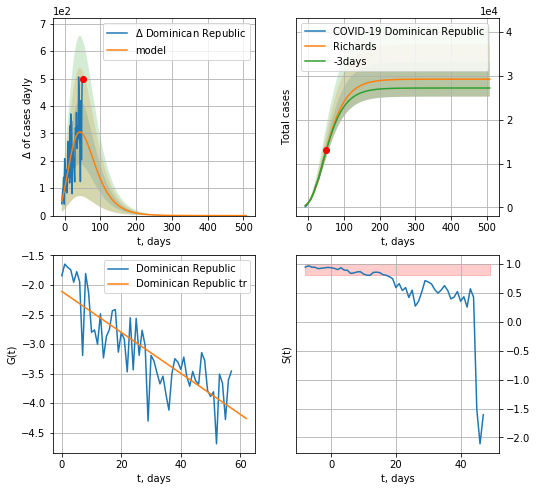

Dominican Republic data at: 2020-07-07
+3 day model MAPE: 0.011985
model: Richards
coeffs: [ 2.92637494e+04  1.52418321e+00 -9.56908405e+01  1.87788232e-02]
rational stdev: 0.135750
forecast at the end of period: +459 days
	 deltaDaycases: 0
	 total cases: 29263 ± 3972
	 total death: 625 ± 254
trend coefficient of determination: 0.671300
 intercept: -2.108308
 slope: -0.034707


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


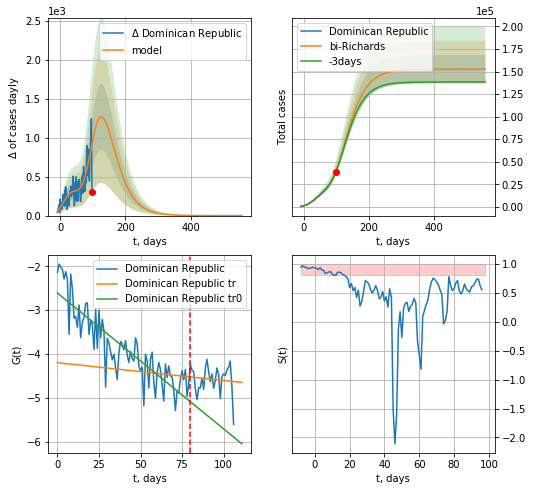

Dominican Republic data at: 2020-07-07
+3 day model MAPE: 0.004322
model: bi-Richards
coeffs: [1.23312997e+05 3.82218796e-01 3.28074361e+01 7.16021827e-02]
rational stdev: 0.102556
forecast at the end of period: +459 days
	 deltaDaycases: 0
	 total cases: 152575 ± 15647
	 total death: 3259 ± 1002
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.754717
 intercept: -2.609326
 slope: -0.030978
trend coefficient of determination: 0.010258
 intercept: -4.197728
 slope: -0.004047


In [354]:
vL = 80+21
x = forecastRR('Dominican Republic',dfDM[21:vL-21],d1,80*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Dominican Republic',dfDM[21:],d1,80*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-21)

MD
           date    cases  active  death
118 2020-07-03  17445.0    6780  572.0
119 2020-07-04  17672.0    6696  580.0
120 2020-07-05  17814.0    6511  585.0
121 2020-07-06  17906.0    6267  592.0
122 2020-07-07  18141.0    6297  603.0


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


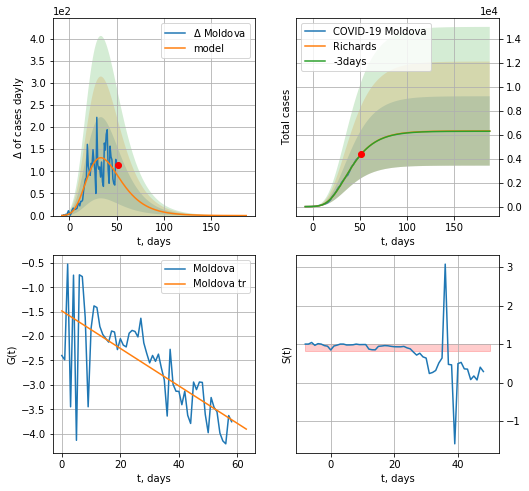

Moldova data at: 2020-07-07
+3 day model MAPE: 0.000788
model: Richards
coeffs: [ 6.30547574e+03  3.98849226e+00 -4.11476415e+01  1.42380272e-02]
rational stdev: 0.458349
forecast at the end of period: +137 days
	 deltaDaycases: 0
	 total cases: 6304 ± 2889
	 total death: 209 ± 287
trend coefficient of determination: 0.512179
 intercept: -1.485671
 slope: -0.038427


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


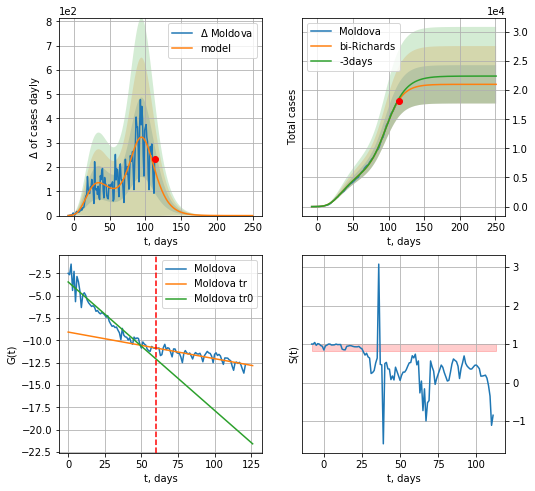

Moldova data at: 2020-07-07
+3 day model MAPE: 0.013025
model: bi-Richards
coeffs: [1.46880294e+04 9.49272349e-02 9.35865816e+01 8.57490844e-01]
rational stdev: 0.156557
forecast at the end of period: +137 days
	 deltaDaycases: 0
	 total cases: 20993 ± 3286
	 total death: 697 ± 327
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.924040
 intercept: -3.451432
 slope: -0.143913
trend coefficient of determination: 0.626598
 intercept: -9.065798
 slope: -0.029802


In [355]:
dfMD = read_df(pd.DataFrame(),"MD")
dfMD = dfMD.fillna(0)
try:
    vL = 60
    x = forecastRR("Moldova",dfMD[:vL],d1,34*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Moldova",dfMD[:],d1,34*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

In [356]:
#np.diff(dfAF["cases"])

AF
           date     cases  active   death
120 2020-07-03  177124.0   87874  2952.0
121 2020-07-04  187977.0   93724  3026.0
122 2020-07-05  196750.0  100236  3199.0
123 2020-07-06  205721.0  104563  3310.0
124 2020-07-07  215855.0  110054  3502.0


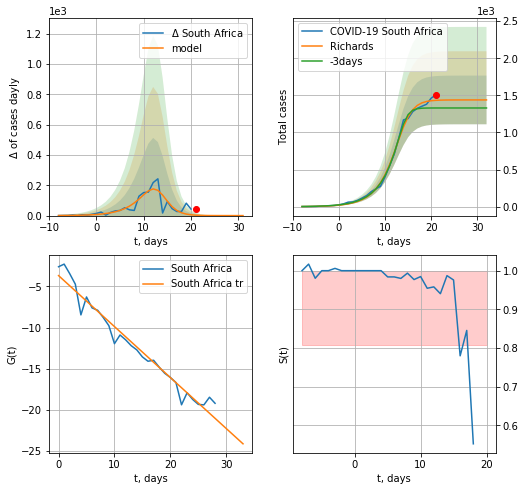

South Africa data at: 2020-07-07
+3 day model MAPE: 0.079443
model: Richards
coeffs: [1.43832007e+03 3.09188728e-01 1.37785508e+01 2.13840807e+00]
rational stdev: 0.227967
forecast at the end of period: +11 days
	 deltaDaycases: 0
	 total cases: 1438 ± 327
	 total death: 23 ± 15
trend coefficient of determination: 0.961533
 intercept: -3.675972
 slope: -0.619731


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.5/dist-packages/scipy/optimize/minpack.py:454: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


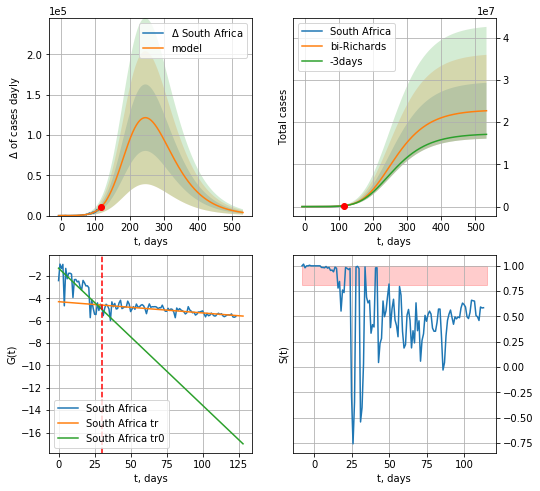

South Africa data at: 2020-07-07
+3 day model MAPE: 0.013359
model: bi-Richards
coeffs: [2.29468914e+07 7.58074455e-02 1.48077326e+02 2.09318339e-01]
rational stdev: 0.291516
forecast at the end of period: +417 days
	 deltaDaycases: 3851
	 total cases: 22705948 ± 6619143
	 total death: 368377 ± 322163
bi-Richards approximation splitting point: 30
trend coefficient of determination: 0.588397
 intercept: -1.306311
 slope: -0.122648
trend coefficient of determination: 0.506817
 intercept: -4.302450
 slope: -0.010041


In [357]:
dfAF = read_df(pd.DataFrame(),"AF").fillna(0)
#dfAF = dfAF.fillna(0)
try:
    vL = 30
    x = forecastRR("South Africa",dfAF[:vL],d1,16*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("South Africa",dfAF[:],d1,74*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

In [350]:
cD = {
    "Romania": ["RM",5,4*7],
    #"Finland":"FI",
    "India":["ID",5,6*7],
    "Ecuador":["ED",5,4*7],
    "Philippines":["PH",5,4*7],
    #"Pakistan":"PK",
#    "Luxembourg":"LX",
#    "Saudi Arabia":["SA",5,4*7],
    "Thailand":["TH",5,4*7],
    "Indonesia":["IE",5,16*7],
    "Mexico":["MX",5,8*7],
    "Panama":["PM",12,12*7],
    "Peru":["PU",5,4*7],
    "Serbia":["SB",5,4*7],
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":["UAE",5,8*7],
    "Argentina":["AG",5,8*7],
    "Iceland":["IC",5,4*7],
    "Colombia":["CB",10,16*7],
    "Qatar":["QR",5,6*7],
    "Algeria":["AR",5,16*7],
    "Croatia":["CT",0,12*7],
    "Egypt":["EG",5,4*7],
    "Slovenia":["SV",12,6*7],
    "Morocco":["MR",5,4*7],
    "Iraq":["IQ",2,8*7]
#    "Hong Kong":"HK"
}

dfArray = [dfRM,dfID,dfED,dfPH,dfTH,dfIE,dfMX,dfPM,dfPU,dfSB,dfAG,dfIC,dfCB,dfQR,dfAG,dfCT,dfEG,dfSV,dfMR,dfIQ]
for c,adf in zip(cD,dfArray):
    if c in ["Qatar","Peru","Argentina","Iraq","India","Philippines","Indonesia","Finland","Luxembourg","Ecuador","Thailand","Morocco","Romania","Iceland","Panama","Colombia","Mexico","Algeria", "Croatia","Slovenia","Egypt","Serbia"]:
        continue
    print (c)
    idS = cD[c][1]
    ipd = cD[c][2]
    x = forecast(c,adf[idS:],d1,ipd-dT)
    #xx = forecast2(c,adf[:],d1,ipd-dT,x)

In [4]:
import requests
import lxml.html as lh
#url='https://www.worldometers.info/coronavirus/#countries'#Create a handle, page, to handle the contents of the website
url='https://www.worldometers.info/coronavirus/#nav-today'
page = requests.get(url)#Store the contents of the website under doc
doc = lh.fromstring(page.content)#Parse data that are stored between <tr>..</tr> of HTML
tr_elements = doc.xpath('//tr')
#Check the length of the first 12 rows
print ([len(T) for T in tr_elements[:12]])
tr_elements = doc.xpath('//tr')#Create empty list
col=[]
i=0#For each row, store each first element (header) and an empty list
for t in tr_elements[0]:
    i+=1
    name=t.text_content()
    print ('%d:"%s"'%(i,name))
    col.append((name,[]))
    
#Since out first row is the header, data is stored on the second row onwards
for j in range(1,len(tr_elements)):
    #T is our j'th row
    T=tr_elements[j]
    #print (len(T))
    #If row is not of size 10, the //tr data is not from our table 
    if len(T)!=19:
        break
    
    #i is the index of our column
    i=0
    
    #Iterate through each element of the row
    for t in T.iterchildren():
        data=t.text_content() 
        #Check if row is empty
        if i>0:
        #Convert any numerical value to integers
            try:
                data=int(data)
            except:
                pass
        #Append the data to the empty list of the i'th column
        col[i][1].append(data)
        #Increment i for the next column
        i+=1
    
print ([len(C) for (title,C) in col])
Dict={title:column for (title,column) in col}
df=pd.DataFrame(Dict)

[19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19]
1:"#"
2:"Country,Other"
3:"TotalCases"
4:"NewCases"
5:"TotalDeaths"
6:"NewDeaths"
7:"TotalRecovered"
8:"NewRecovered"
9:"ActiveCases"
10:"Serious,Critical"
11:"Tot Cases/1M pop"
12:"Deaths/1M pop"
13:"TotalTests"
14:"Tests/
1M pop
"
15:"Population"
16:"Continent"
17:"1 Caseevery X ppl"
18:"1 Deathevery X ppl"
19:"1 Testevery X ppl"
[695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695]


In [5]:
df.head(10)
#df.columns[18]

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,"Country,Other",Deaths/1M pop,NewCases,NewDeaths,NewRecovered,Population,"Serious,Critical",Tests/ 1M pop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,Tot Cases/1M pop
0,,\n,,,"1,828,572",North America,\nNorth America\n,,"+7,610",814,"+4,396",,"18,703",,"3,701,165","180,463","1,692,130",,
1,,\n,,,"805,321",South America,\nSouth America\n,,"+1,439",47,"+35,030",,"13,628",,"2,672,044","98,611","1,768,112",,
2,,\n,,,"798,216",Asia,\nAsia\n,,"+6,011",76,"+4,531",,"19,590",,"2,741,795","65,592","1,877,987",,
3,,\n,,,"857,147",Europe,\nEurope\n,,,,900,,"5,395",,"2,518,507","195,050","1,466,310",,
4,,\n,,,"257,762",Africa,\nAfrica\n,,2,,5,,964,,"525,894","12,270","255,862",,
5,,\n,,,"1,412",Australia/Oceania,\nOceania\n,,176,,88,,10,,"10,714",128,"9,174",,
6,,\n,,,55,,\n\n,,,,,,4,,721,15,651,,
7,,\n,,,"4,548,485",All,World,70.8,"+15,238",937,"+44,950",,"58,294",,"12,170,840","552,129","7,070,226",,"1,561"
8,1,105,"2,455",8,"1,631,391",North America,USA,407,,,,"331,044,624","15,457","119,257","3,158,932","134,862","1,392,679","39,479,437","9,542"
9,2,124,"3,124",48,"495,674",South America,Brazil,320,,,"+34,545","212,591,154","8,318","21,021","1,716,196","68,055","1,152,467","4,468,829","8,073"


In [6]:
#df.rename(columns={"Country,Other":"Country",df.columns[9]:"TotDeathsper1Mpop"})
df=df.rename(columns={"Country,Other":"Country",'Deaths/1M pop':"Deathsper1Mpop","Serious,Critical":"Serious_Critical",'Tests/\n1M pop\n':"Testsper1Mpop",'Tot\xa0Cases/1M pop':"TotCasesper1Mpop"})
df.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,"1,828,572",North America,\nNorth America\n,,"+7,610",814,"+4,396",,"18,703",,"3,701,165","180,463","1,692,130",,
1,,\n,,,"805,321",South America,\nSouth America\n,,"+1,439",47,"+35,030",,"13,628",,"2,672,044","98,611","1,768,112",,
2,,\n,,,"798,216",Asia,\nAsia\n,,"+6,011",76,"+4,531",,"19,590",,"2,741,795","65,592","1,877,987",,
3,,\n,,,"857,147",Europe,\nEurope\n,,,,900,,"5,395",,"2,518,507","195,050","1,466,310",,
4,,\n,,,"257,762",Africa,\nAfrica\n,,2,,5,,964,,"525,894","12,270","255,862",,


In [7]:
df[df["Country"]=="Lithuania"]

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
122,115,"1,468","34,444",6,223,Europe,Lithuania,29,,,,"2,721,108",15,"164,637","1,854",79,"1,552","447,994",681
355,116,"1,468","34,444",6,223,Europe,Lithuania,29,10,,5,"2,721,108",15,"164,637","1,854",79,"1,552","447,994",681
586,115,"1,476","34,444",6,218,Europe,Lithuania,29,3,,,"2,721,108",15,"163,318","1,844",79,"1,547","444,407",678


In [8]:
totIdx = np.where(df['ActiveCases']=='ActiveCases')[0][0]
print(totIdx)

231


In [9]:
df.head(45)

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,"1,828,572",North America,\nNorth America\n,,"+7,610",814,"+4,396",,"18,703",,"3,701,165","180,463","1,692,130",,
1,,\n,,,"805,321",South America,\nSouth America\n,,"+1,439",47,"+35,030",,"13,628",,"2,672,044","98,611","1,768,112",,
2,,\n,,,"798,216",Asia,\nAsia\n,,"+6,011",76,"+4,531",,"19,590",,"2,741,795","65,592","1,877,987",,
3,,\n,,,"857,147",Europe,\nEurope\n,,,,900,,"5,395",,"2,518,507","195,050","1,466,310",,
4,,\n,,,"257,762",Africa,\nAfrica\n,,2,,5,,964,,"525,894","12,270","255,862",,
5,,\n,,,"1,412",Australia/Oceania,\nOceania\n,,176,,88,,10,,"10,714",128,"9,174",,
6,,\n,,,55,,\n\n,,,,,,4,,721,15,651,,
7,,\n,,,"4,548,485",All,World,70.8,"+15,238",937,"+44,950",,"58,294",,"12,170,840","552,129","7,070,226",,"1,561"
8,1,105,"2,455",8,"1,631,391",North America,USA,407,,,,"331,044,624","15,457","119,257","3,158,932","134,862","1,392,679","39,479,437","9,542"
9,2,124,"3,124",48,"495,674",South America,Brazil,320,,,"+34,545","212,591,154","8,318","21,021","1,716,196","68,055","1,152,467","4,468,829","8,073"


In [10]:
df.at[15, 'TotalRecovered'] = 0
df.at[14, 'TotalRecovered'] = 0
df.at[31, 'TotalRecovered'] = 0
df.at[40, 'TotalRecovered'] = 0
df.at[15,"ActiveCases"] = 0
df.at[14,"ActiveCases"] = 0
df.at[31,"ActiveCases"] = 0
df.at[40,"ActiveCases"] = 0
#df.at[12, 'TotalRecovered'] = 0
df = df.fillna(0)

In [11]:
import lxml
def sanitize(data):
    #print (type(data))
    if type(data) == lxml.etree._ElementUnicodeResult:
        data=str(data).strip()
    if str(data).find(',') != -1:
        data = data.replace(',','')
    #print(str(data).find(',') != -1)
    return data
df=df[df.index<totIdx-1]
df["ActiveCases"] = pd.to_numeric(df["ActiveCases"].apply(sanitize))
df["Deathsper1Mpop"] = pd.to_numeric(df["Deathsper1Mpop"].apply(sanitize))
df["NewCases"] = pd.to_numeric(df["NewCases"].apply(sanitize))
df["NewDeaths"] = pd.to_numeric(df["NewDeaths"].apply(sanitize))
df["Serious_Critical"] = pd.to_numeric(df["Serious_Critical"].apply(sanitize))
df["TotalCases"] = pd.to_numeric(df["TotalCases"].apply(sanitize))
df["TotalDeaths"] = pd.to_numeric(df["TotalDeaths"].apply(sanitize))
df["TotalRecovered"] = pd.to_numeric(df["TotalRecovered"].apply(sanitize))
df["TotCasesper1Mpop"] = pd.to_numeric(df["TotCasesper1Mpop"].apply(sanitize))
df["TotalTests"] = pd.to_numeric(df["TotalTests"].apply(sanitize))
df["Testsper1Mpop"] = pd.to_numeric(df["Testsper1Mpop"].apply(sanitize))
df.head(15)

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,1828572,North America,\nNorth America\n,NaN,7610.0,814.0,"+4,396",,18703.0,NaN,3701165,180463.0,1692130.0,NaN,NaN
1,,\n,,,805321,South America,\nSouth America\n,NaN,1439.0,47.0,"+35,030",,13628.0,NaN,2672044,98611.0,1768112.0,NaN,NaN
2,,\n,,,798216,Asia,\nAsia\n,NaN,6011.0,76.0,"+4,531",,19590.0,NaN,2741795,65592.0,1877987.0,NaN,NaN
3,,\n,,,857147,Europe,\nEurope\n,NaN,NaN,NaN,900,,5395.0,NaN,2518507,195050.0,1466310.0,NaN,NaN
4,,\n,,,257762,Africa,\nAfrica\n,NaN,2.0,NaN,5,,964.0,NaN,525894,12270.0,255862.0,NaN,NaN
5,,\n,,,1412,Australia/Oceania,\nOceania\n,NaN,176.0,NaN,88,,10.0,NaN,10714,128.0,9174.0,NaN,NaN
6,,\n,,,55,,\n\n,NaN,NaN,NaN,,,4.0,NaN,721,15.0,651.0,NaN,NaN
7,,\n,,,4548485,All,World,70.8,15238.0,937.0,"+44,950",,58294.0,NaN,12170840,552129.0,7070226.0,NaN,1561.0
8,1,105,"2,455",8,1631391,North America,USA,407.0,NaN,NaN,,"331,044,624",15457.0,119257.0,3158932,134862.0,1392679.0,39479437.0,9542.0
9,2,124,"3,124",48,495674,South America,Brazil,320.0,NaN,NaN,"+34,545","212,591,154",8318.0,21021.0,1716196,68055.0,1152467.0,4468829.0,8073.0


In [12]:
cLst = countriesEU
ActiveCasesEU = sum([ w for w in df[df['Country'].isin(cLst)].ActiveCases if w>0])
CountryEU = "European Union" 
Deathsper1MpopEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])/445.250514
NewCasesEU = sum([w for w in df[df['Country'].isin(cLst)].NewCases if w>0 ])
NewDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].NewDeaths if w>0])
Serious_CriticalEU = sum([w for w in df[df['Country'].isin(cLst)].Serious_Critical if w>0])
Testsper1MpopEU = sum([ w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])/445.250514
TotalCasesEu = sum([w for w in df[df['Country'].isin(cLst)].TotalCases if w>0])
TotalDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])
TotalRecoveredEU = sum([w for w in df[df['Country'].isin(cLst)].TotalRecovered if w>0] )
TotalTestsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])
TotCasesper1MpopEU = TotalCasesEu/445.250514

rowEU = {"ActiveCases":ActiveCasesEU,"Continent":"Europe","Country": CountryEU,"Deathsper1Mpop": Deathsper1MpopEU,"NewCases": NewCasesEU,"NewDeaths": NewDeathsEU,"Serious_Critical": Serious_CriticalEU,"Testsper1Mpop": Testsper1MpopEU,"TotalCases": TotalCasesEu,"TotalDeaths": TotalDeathsEU,"TotalRecovered": TotalRecoveredEU,"TotalTests": TotalTestsEU,"TotCasesper1Mpop": TotCasesper1MpopEU }
df = df.append(rowEU, ignore_index=True)
df.tail()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
226,,,,,857147,Europe,Total:,NaN,NaN,NaN,,,5395.0,NaN,2518507,195050.0,1466310.0,NaN,NaN
227,,,,,257762,Africa,Total:,NaN,2.0,NaN,,,964.0,NaN,525894,12270.0,255862.0,NaN,NaN
228,,,,,1412,Australia/Oceania,Total:,NaN,176.0,NaN,,,10.0,NaN,10714,128.0,9174.0,NaN,NaN
229,,,,,55,,Total:,NaN,NaN,NaN,,,4.0,NaN,721,15.0,651.0,NaN,NaN
230,NaN,NaN,NaN,NaN,162308,Europe,European Union,301.2147,0.0,0.0,NaN,NaN,2121.0,70147.08129,1317853,134116.0,637245.0,31233024.0,2959.801187


In [13]:
#df['Reported1st case'] = df['Reported1st case'].map(lambda x: x.lstrip('\n'))
df["Country"] = df["Country"].str.strip('\n')
df.head()

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,1828572,North America,North America,NaN,7610.0,814.0,"+4,396",,18703.0,NaN,3701165,180463.0,1692130.0,NaN,NaN
1,,\n,,,805321,South America,South America,NaN,1439.0,47.0,"+35,030",,13628.0,NaN,2672044,98611.0,1768112.0,NaN,NaN
2,,\n,,,798216,Asia,Asia,NaN,6011.0,76.0,"+4,531",,19590.0,NaN,2741795,65592.0,1877987.0,NaN,NaN
3,,\n,,,857147,Europe,Europe,NaN,NaN,NaN,900,,5395.0,NaN,2518507,195050.0,1466310.0,NaN,NaN
4,,\n,,,257762,Africa,Africa,NaN,2.0,NaN,5,,964.0,NaN,525894,12270.0,255862.0,NaN,NaN


In [14]:
#totIdx0 = np.where(df['Country']=='Total:')[0][0]
#df.at[totIdx0,'Country'] = 'World'

In [15]:
#df

In [16]:
#df[df['Country'].isnull()]
#df['Country']=df['Country'].dropna()
##for idx in df['Country'].isnull():
##    #print(idx)
##    if idx == True:
##        ind = df[df['Country'].isnull()].index[0]
##        df = df.drop(df.index[ind])
df = df.drop(df.index[6])
df.head(10)

,#,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl,ActiveCases,Continent,Country,Deathsper1Mpop,NewCases,NewDeaths,NewRecovered,Population,Serious_Critical,Testsper1Mpop,TotalCases,TotalDeaths,TotalRecovered,TotalTests,TotCasesper1Mpop
0,,\n,,,1828572,North America,North America,NaN,7610.0,814.0,"+4,396",,18703.0,NaN,3701165,180463.0,1692130.0,NaN,NaN
1,,\n,,,805321,South America,South America,NaN,1439.0,47.0,"+35,030",,13628.0,NaN,2672044,98611.0,1768112.0,NaN,NaN
2,,\n,,,798216,Asia,Asia,NaN,6011.0,76.0,"+4,531",,19590.0,NaN,2741795,65592.0,1877987.0,NaN,NaN
3,,\n,,,857147,Europe,Europe,NaN,NaN,NaN,900,,5395.0,NaN,2518507,195050.0,1466310.0,NaN,NaN
4,,\n,,,257762,Africa,Africa,NaN,2.0,NaN,5,,964.0,NaN,525894,12270.0,255862.0,NaN,NaN
5,,\n,,,1412,Australia/Oceania,Oceania,NaN,176.0,NaN,88,,10.0,NaN,10714,128.0,9174.0,NaN,NaN
7,,\n,,,4548485,All,World,70.8,15238.0,937.0,"+44,950",,58294.0,NaN,12170840,552129.0,7070226.0,NaN,1561.0
8,1,105,"2,455",8,1631391,North America,USA,407.0,NaN,NaN,,"331,044,624",15457.0,119257.0,3158932,134862.0,1392679.0,39479437.0,9542.0
9,2,124,"3,124",48,495674,South America,Brazil,320.0,NaN,NaN,"+34,545","212,591,154",8318.0,21021.0,1716196,68055.0,1152467.0,4468829.0,8073.0
10,3,"1,795","65,258",129,271434,Asia,India,15.0,98.0,7.0,11,"1,380,270,828",8944.0,7782.0,769150,21151.0,476565.0,10740832.0,557.0


In [17]:
df.to_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)), index=False)

In [18]:
countryDic = {
  "USA": "US",
"Italy":"IT",
"Spain":"SP",
"Germany":"GR",
"France":"FR",
"Iran":"IN",
"UK":"GB",
"Switzerland":"SZ",
"S. Korea":"KR",
"Norway":"NG",
"Sweden":"SW",
"Israel":"IS",
"Denmark":"DK",
"Poland":"PL",
"Estonia":"ES",
"Ukraine":"Ukr",
"Latvia":"LV",
    "Lithuania":"LT",
    "China":"CN",
    "USA":"US",
    "Russia":"RS",
    "Japan":"JP",
    "Netherlands":"NL",
    "Belgium":"BG",
    "Singapore":"SG",
    "Austria":"AT",
    "Turkey":"TR",
    "Canada":"CA",
    "Portugal":"PT",
    "World":"World",
    "Australia":"AS",
    "Brazil":"BZ",
    "Malaysia":"ML",
    "New Zealand":"ZL",
    "Belarus":"BR",
    "Ireland":"IR",
    "Chile":"CL",
    "Czechia":"CH",
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
#    "Pakistan":"PK",
    "Luxembourg":"LX",
    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
    "South Africa":"AF",
    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "European Union":"EU",
    "Bulgaria":"BL",
    "Hungary":"HG",
    "Malta":"MT",
    "Slovakia":"SL",
    "Cyprus":"CP",
    "Greece":"GC",
    "Dominican Republic":"DM",
    "Kuwait":"KW",
    "Bangladesh":"BN",
    "Sri Lanka":"Sri",
    "Pakistan":"PS",
    "Moldova":"MD"
#    "Hong Kong":"HK"
}
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)

for c in countryDic:
    print (c,countryDic[c])

Cyprus CP
Lithuania LT
UK GB
Qatar QR
Italy IT
Canada CA
Panama PM
Belgium BG
Portugal PT
Peru PU
Indonesia IE
Bangladesh BN
Hungary HG
Dominican Republic DM
European Union EU
Kuwait KW
Ecuador ED
Latvia LV
Czechia CH
Slovakia SL
USA US
Malta MT
Ukraine Ukr
Ireland IR
Brazil BZ
Finland FI
Poland PL
Switzerland SZ
Chile CL
Pakistan PS
Spain SP
Algeria AR
Germany GR
Slovenia SV
China CN
Iraq IQ
Egypt EG
Singapore SG
France FR
Argentina AG
Saudi Arabia SA
Colombia CB
World World
Iceland IC
Turkey TR
Australia AS
Croatia CT
Morocco MR
Bulgaria BL
Serbia SB
Thailand TH
Moldova MD
Israel IS
Romania RM
Sri Lanka Sri
Russia RS
Malaysia ML
Austria AT
Netherlands NL
Sweden SW
S. Korea KR
Greece GC
Estonia ES
New Zealand ZL
India ID
South Africa AF
Japan JP
Philippines PH
Luxembourg LX
Belarus BR
Norway NG
Denmark DK
Iran IN
Mexico MX
UAE UAE


In [19]:
len(countryDic)

75

In [20]:
df = pd.read_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)),',')
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)
from datetime import date, timedelta
for c in df.Country: 
    #if c!='European Union':
    #    continue
    f = open("data/tmp/corona%sOneRaw.csv"%(c),'w')
    #print ("corona%sOneRaw.csv"%(c),date.today()- timedelta(days=1),c,df[df.Country == c].TotalCases.values[0])
    print(c)
    if c!='World':
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    else:
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    f.close()

North America
North America 2020-07-08,3701165,1828572,180463.0
South America
South America 2020-07-08,2672044,805321,98611.0
Asia
Asia 2020-07-08,2741795,798216,65592.0
Europe
Europe 2020-07-08,2518507,857147,195050.0
Africa
Africa 2020-07-08,525894,257762,12270.0
Oceania
Oceania 2020-07-08,10714,1412,128.0
World
World 2020-07-08,12170840,4548485,552129.0
USA
USA 2020-07-08,3158932,1631391,134862.0
Brazil
Brazil 2020-07-08,1716196,495674,68055.0
India
India 2020-07-08,769150,271434,21151.0
Russia
Russia 2020-07-08,700792,217614,10667.0
Peru
Peru 2020-07-08,312911,97030,11133.0
Chile
Chile 2020-07-08,303083,24807,6573.0
Spain
Spain 2020-07-08,299593,0,28396.0
UK
UK 2020-07-08,286979,0,44517.0
Mexico
Mexico 2020-07-08,275003,74412,32796.0
Iran
Iran 2020-07-08,248379,26832,12084.0
Italy
Italy 2020-07-08,242149,13595,34914.0
Pakistan
Pakistan 2020-07-08,240848,90554,4983.0
South Africa
South Africa 2020-07-08,224665,114221,3602.0
Saudi Arabia
Saudi Arabia 2020-07-08,220144,60035,2059.0
Tu

Vatican City
Vatican City 2020-07-08,12,0,nan
Montserrat
Montserrat 2020-07-08,11,0,1.0
Papua New Guinea
Papua New Guinea 2020-07-08,11,3,nan
Western Sahara
Western Sahara 2020-07-08,10,1,1.0
MS Zaandam
MS Zaandam 2020-07-08,9,7,2.0
British Virgin Islands
British Virgin Islands 2020-07-08,8,0,1.0
Caribbean Netherlands
Caribbean Netherlands 2020-07-08,7,0,nan
St. Barth
St. Barth 2020-07-08,6,0,nan
Anguilla
Anguilla 2020-07-08,3,0,nan
Saint Pierre Miquelon
Saint Pierre Miquelon 2020-07-08,1,0,nan
China
China 2020-07-08,83581,357,4634.0
Total:
Total: 2020-07-08,3701165,1828572,180463.0
Total:
Total: 2020-07-08,3701165,1828572,180463.0
Total:
Total: 2020-07-08,3701165,1828572,180463.0
Total:
Total: 2020-07-08,3701165,1828572,180463.0
Total:
Total: 2020-07-08,3701165,1828572,180463.0
Total:
Total: 2020-07-08,3701165,1828572,180463.0
Total:
Total: 2020-07-08,3701165,1828572,180463.0
European Union
European Union 2020-07-08,1317853,162308,134116.0


In [21]:
#c='World'
#print(c,"%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0]))

In [22]:
for c in countryDic: 
    #if c not in ['European Union']:
    #    continue
    ff = open("data/tmp/corona%sOneRaw.csv"%(c),'r')
    fff = open("data/corona%s.csv"%(countryDic[c]),'a')
    for l in ff:
        #print(c,l)
        print("append data/corona%s.csv"%(countryDic[c]),"%s"%(l))
        fff.write(l)
    ff.close()
    fff.close()

append data/coronaCP.csv 2020-07-08,1008,150,19.0

append data/coronaLT.csv 2020-07-08,1854,223,79.0

append data/coronaGB.csv 2020-07-08,286979,0,44517.0

append data/coronaQR.csv 2020-07-08,101553,5308,138.0

append data/coronaIT.csv 2020-07-08,242149,13595,34914.0

append data/coronaCA.csv 2020-07-08,106434,27450,8737.0

append data/coronaPM.csv 2020-07-08,41251,20963,819.0

append data/coronaBG.csv 2020-07-08,62123,35209,9776.0

append data/coronaPT.csv 2020-07-08,44859,13514,1631.0

append data/coronaPU.csv 2020-07-08,312911,97030,11133.0

append data/coronaIE.csv 2020-07-08,68079,33135,3359.0

append data/coronaBN.csv 2020-07-08,172134,89099,2197.0

append data/coronaHG.csv 2020-07-08,4210,736,589.0

append data/coronaDM.csv 2020-07-08,39588,18703,829.0

append data/coronaEU.csv 2020-07-08,1317853,162308,134116.0

append data/coronaKW.csv 2020-07-08,52007,9520,379.0

append data/coronaED.csv 2020-07-08,63245,29301,4873.0

append data/coronaLV.csv 2020-07-08,1141,103,30.0

append 

In [32]:
import pandas as pd
import io
import requests
url="https://opendata.ecdc.europa.eu/covid19/casedistribution/csv"
s=requests.get(url).content
#print (s)
dfc=pd.read_csv(io.StringIO(s.decode(encoding='windows-1252')))
dfc.to_csv("data/europa_corona.csv", index=False)

In [ ]:
countryDic1 = {
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "Bulgaria":"BL"
#    "Hong Kong":"HK"
}
countryDic2 = {
    "Austria":"AT",
    "Italy":"IT",
    "Belgium":"BG",
    "Latvia":"LV",
    "Bulgaria":"BL",
    "Lithuania":"LT",
    "Croatia":"CT",
    "Luxembourg":"LX",
    "Cyprus":"CP",
    "Malta":"MT",
    "Czechia":"CH",
    "Netherlands":"NL",
    "Denmark":"DK",
    "Poland":"PL",
    "Estonia":"ES",
    "Portugal":"PT",
    "Finland":"FI",
    "Romania":"RM",
    "France":"FR",
    "Slovakia":"SL",
    "Germany":"GR",
    "Slovenia":"SV",
    "Greece":"GC",
    "Spain":"SP",
    "Hungary":"HG",
    "Sweden":"SW",
    "Ireland":"IR"      
}
cD3 = {"Malta":"MT","Slovakia":"SL","Greece":"GC","Hungary":"HG","Cyprus":"CP","South Africa":"SAF"}
    
for  c in cD3:#countryDic1:
    if c != "South Africa":
        continue
    dfc = pd.read_csv("europa_corona.csv",",")
    dfc = dfc[dfc['countriesAndTerritories']==c].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
    print(c,sum(dfc["cases"].values))
    dfc=dfc.rename(columns={"dateRep":"date"})
    dfc = dfc[dfc["cases"]>0]
    dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
    #dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
    dfc["cases"]=np.cumsum(dfc["cases"].values)
    dfc[['date', 'cases']].to_csv('data/corona%s.csv'%(cD3[c]), index=False)#countryDic1

In [ ]:
#dfRM = read_df(pd.DataFrame(),"RM")

In [ ]:
dfc.head()#[['date', 'cases']]

In [ ]:
date(2012, 3, 16)

In [ ]:
len(countriesEU)

In [ ]:
dfc = pd.read_csv("europa_corona.csv",",")
cLst = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania","Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands","Denmark","Poland","Estonia","Portugal","Finland","Romania","France","Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
dfc = dfc[dfc['countriesAndTerritories'].isin(cLst)].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
print(c,sum(dfc["cases"].values))
dfc=dfc.rename(columns={"dateRep":"date"})
dfc = dfc[dfc["cases"]>0]
dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
#dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
dfc["cases"]=np.cumsum(dfc["cases"].values)
dfc[['date', 'cases']].to_csv('/home/algiz/Desktop/corona%s.csv'%("EU"), index=False)

In [ ]:
#subsetDataFrame = dfObj[dfObj['Product'].isin(['Mangos', 'Grapes']) ]

#dfD = dfAll[dfAll['Country'].isin(cLst)].TotalTests


In [ ]:
#dfD

In [ ]:
#dfAll[dfAll['Country'].isin(cLst)]

In [122]:
TT = sum(dfAll[dfAll.TotalTests>0].TotalTests) - dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]
print(TT,TT/7.7776e3)

87759686.0 11283.646111911128


In [123]:
TT/7.7776e3

11283.646111911128

In [124]:
dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]/(popEU/1e6)

46659.02305954441

In [367]:
sum(dfp.Population)/1e6

16014.157998

In [ ]:
dfAll[dfAll.TotalTests>0]

In [ ]:
cDicEU = {
    "Austria":["AT",dfAT],
    "Italy":["IT",dfIT],
    "Belgium":["BG",dfBG],
    "Latvia":["LV",dfLV],
    "Bulgaria":["BL",dfBL],
    "Lithuania":["LT",dfLT],
    "Croatia":["CT",dfCT],
    "Luxembourg":["LX",dfLX],
    "Cyprus":["CP",dfCP],
    "Malta":["MT",dfMT],
    "Czechia":["CH",dfCH],
    "Netherlands":["NL",dfNL],
    "Denmark":["DK",dfDK],
    "Poland":["PL",dfPL],
    "Estonia":["ES",dfES],
    "Portugal":["PT",dfPT],
    "Finland":["FI",dfFI],
    "Romania":["RM",dfRM],
    "France":["FR",dfFR],
    "Slovakia":["SL",dfSL],
    "Germany":["GR",dfGR],
    "Slovenia":["SV",dfSV],
    "Greece":["GC",dfGC],
    "Spain":["SP",dfSP],
    "Hungary":["HG",dfHG],
    "Sweden":["SW",dfSW],
    "Ireland":["IR",dfIR],
}

In [ ]:
def addDataFrames(f_arg, *argv):
    dfTotal = f_arg
    for arg in argv:
        dfTotal = dfTotal.set_index('date').add(arg.set_index('date'), fill_value = 0)
        dfTotal['date'] = dfTotal.index
    return dfTotal
dfTot = cDicEU["Austria"][1]
for cD in cDicEU:
    if cD == "Austria":
        continue
    dfTot = addDataFrames(dfTot, cDicEU[cD][1])
    
dfTot.to_csv("~/Documents/coronaEU1.csv")

In [ ]:
#cDicEU["Ireland"][1]

In [397]:
dfAll[df["Country"]=="European Union"].TotalTests.values[0]/445.250514

53138.63826331259

In [398]:
dfAll[df["Country"]=="Total:"].TotalTests.values[0]/445

0.0

In [399]:
#dfAll

In [400]:
(sum(dfAll.TotalTests)-dfAll[df["Country"]=="European Union"].TotalTests.values[0])/(7.777e3-445.250514)

14872.243140359802

In [467]:
CList = ["USA",
"Spain", "Italy", "UK", "France", "Germany", "Turkey", "Russia", "Iran", "Brazil", "Canada", "Belgium",
"Peru", "Netherlands", "India", "Switzerland", "Ecuador", "Portugal", "Saudi Arabia", "Sweden", "Ireland",
"Mexico", "Pakistan", "Singapore", "Chile", "Israel", "Austria", "Belarus", "Japan", "Qatar", "Poland",
"UAE", "Romania", "Ukraine", "South_Korea", "Indonesia", "Denmark", "Serbia", "Philippines", "Norway", "Czechia",
"Colombia", "Australia", "Malaysia", "Egypt", "Finland", "Morocco", "Argentina", "Algeria", "Moldova", 
"Luxembourg", "Thailand", "Hungary", "Greece", "Iraq", "Croatia", "Iceland", "Estonia", "Bulgaria",
"New_Zealand", "Slovenia", "Slovakia", "Lithuania", "Latvia", "Cyprus", "Malta","Bangladesh","Kuwait",
"Dominican Republic","Moldova","South Africa","China"         
]

In [468]:
len(CList)

72

In [469]:
popModelled = sum(dfp[dfp["Country (or dependency)"].isin(CList) ].Population)
popModelled

5577035987

In [ ]:
for CItem in CList:
    a = """
    %s
    <br />
    <img src="pictures/covidcases%s35_Q.png" alt="hi" class="inline"/><br /> 

      {%% include_relative _includes/covidcases%s35_Q.txt %%}
          <br /> 
    """%(CItem,CItem,CItem)
    print (a)

In [ ]:
R = (dfLT[:].cases.values/0.9240855762594893).astype(int)+1 -dfLT[:].active.values+dfLT[:].death.values
I = dfLT[:].active.values
S = 1700-R[:]-I
plt.plot(range(len(dfLT)),R,label="R")
plt.plot(range(len(dfLT)),I,label="I")
plt.plot(range(len(dfLT)),S,label="S")
plt.legend()
plt.grid()

In [ ]:
plt.plot(np.multiply(I,S)[1:]/1700,-np.diff(S[:]))
plt.grid()

In [ ]:
plt.plot(np.diff(R[:]),I[1:]/950)
plt.grid()

In [ ]:
plt.plot(np.diff(R[:])+np.diff(I)+np.diff(S))
plt.grid()

In [ ]:
def fS(x0,u):
    return x0*u
def fI(gamma,beta,x0,C1,u):
    return gamma*np.log(u)/beta-x0*u-C1/beta
def fR(gamma,beta,u):
    return -gamma*np.log(u)/beta
def fT(C1,gamma,x0,beta,u,u0):
    from scipy.integrate import quad
    def integrand(x, C1,gamma,x0,beta):
        return 1/(beta*x*(C1/beta-gamma*np.log(x)/beta+x0*x)) 
    return quad(integrand, u0, u, args=(C1,gamma,x0,beta),epsrel=1e-12)
vfS = np.vectorize(fS)
vfI = np.vectorize(fI)
vfR = np.vectorize(fR)
vfT = np.vectorize(fT)

In [ ]:
import scipy.optimize as optimize

T = np.linspace(.00001, 55., num=len(dfLT))
#U = np.linspace(1.0, 10*len(dfLT), num=len(dfLT))

def f(params):
    # print(params)  # <-- you'll see that params is a NumPy array
    gamma, norm = params # <-- for readability you may wish to assign names to the component variables
    C1 = -N*beta
    minT = np.min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
    sumT = np.sum((T[:]-(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm)**2)
    sumS = np.sum((S[:]-vfS(x0,U[:]))**2)
    sumI = np.sum((I[:]-vfI(gamma,beta,x0,C1,U[:]))**2)
    sumR = np.sum((R[:]-vfR(gamma,beta,U[:]))**2)
    return sumR+sumI+sumS+sumT
N = 1700
x0 = N*0.98
gamma = 4.18201705e+01
beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
norma = 55*2
initial_guess = [gamma, norma]
result = optimize.minimize(f, initial_guess)
if result.success:
    fitted_params = result.x
    print(fitted_params)
else:
    fitted_params = result.x
    print(fitted_params)
    raise ValueError(result.message)

In [ ]:
55*19

In [ ]:
N = 1700
#x0 = N*0.995
gamma =  fitted_params[0]
#beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02*0.13
norm = fitted_params[1]
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
minT = min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
plt.plot(U[:-1],(np.diff(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT))*norm)
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfS(x0,U[:]))
plt.plot(range(len(dfLT)),S,label="S")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfI(gamma,beta,x0,C1,U[:]))
plt.plot(range(len(dfLT)),I,label="I")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfR(gamma,beta,U[:]))
plt.plot(range(len(dfLT)),R,label="R")
plt.grid()

In [ ]:
#T = np.linspace(1.0, len(dfLT), num=len(dfLT))

In [ ]:
#u0 = [1,0.01]
#vfS(x0,u0),vfI(gamma,beta,x0,C1,u0),vfR(gamma,beta,u0)

In [ ]:
gamma/(beta*x0)*55*4

In [ ]:
np.logspace(0.1,0.9,num=9-2+1,dtype='float64')/10

In [ ]:
10**0.1

In [ ]:
np.multiply(I,S)[1:].shape

In [ ]:
np.diff(S).shape

In [ ]:
50./400